<a href="https://colab.research.google.com/github/TheJJL/Proyecto-Final-TG/blob/main/Reconocimiento1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Primer sistema de reconocimiento de rostros con Deep Learning
----

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
path = '/content/drive/MyDrive/Universidad - Ingeniería Electrónica/10 Semestre/Trabajo de Grado II/'
#path = '/content/drive/MyDrive/Trabajo de Grado II/'

Mounted at /content/drive


In [ ]:
import os
import shutil
import numpy as np
import random
import seaborn
import pandas as pd
from os import listdir
from PIL import Image 
from numpy import asarray

from numpy import expand_dims
from numpy import eye
from numpy import load
from numpy import savez_compressed
from random import choice
from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam, Adamax, SGD
from keras.models import load_model 
from keras.callbacks import ModelCheckpoint
from keras.models import Model, Sequential
from keras.layers import Conv2D, MaxPooling2D, ZeroPadding2D, BatchNormalization, LocallyConnected2D, GlobalAveragePooling2D, Flatten, Dense, Dropout, Input, Concatenate, add, Activation, Lambda 
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, classification_report  

%matplotlib inline

## 2. Preparación de datos utilizando el detector de rostros MTCNN

In [ ]:
# Función para aplicar data augmentation en caso de ser necesario
data_gen = ImageDataGenerator(
    rescale = .1, #Escalar aleatoriamente el múltiplo de la imagen RGB
    rotation_range = 0.15, #Rotar aleatoriamente el rango de la imagen
    zoom_range = 0.1, #Escalar aleatoriamente el rango de tamaño de la imagen
    width_shift_range = 0.2, #Cambiar aleatoriamente la imagen horizontalmente (fracción del ancho total)
    height_shift_range = 0.2, #Cambiar aleatoriamente la imagen verticalmente (fracción de la altura total)
    horizontal_flip = True,)

# Ejecutar directamente para obtener un iterador de imagen, que lee una imagen de la ruta cada vez y edita la imagen de acuerdo con las reglas del potenciador de datos.
dataflow_generator = data_gen.flow_from_directory(
    path + 'datasets/datasetROF1/',
    target_size = (152, 152),
    batch_size = 3,
    color_mode = 'rgb',
    class_mode = 'categorical')

print(dataflow_generator.filenames)

Found 2420 images belonging to 2 classes.
['test/anne_hathaway/000003_KN95.jpg', 'test/anne_hathaway/000007_KN95.jpg', 'test/anne_hathaway/000009.jpg', 'test/anne_hathaway/000012_surgical.jpg', 'test/anne_hathaway/000013.jpg', 'test/anne_hathaway/000013_cloth.jpg', 'test/anne_hathaway/000014_inpaint.jpg', 'test/anne_hathaway/000022_KN95.jpg', 'test/anne_hathaway/000023_KN95.jpg', 'test/anne_hathaway/000026_cloth.jpg', 'test/anne_hathaway/000027_empty.jpg', 'test/anne_hathaway/000028.jpg', 'test/anne_hathaway/000030_surgical_blue.jpg', 'test/anne_hathaway/000031.jpg', 'test/anne_hathaway/000034.jpg', 'test/ben_mendelsohn/000008.jpg', 'test/ben_mendelsohn/000013_gas.jpg', 'test/ben_mendelsohn/000014_gas.jpg', 'test/ben_mendelsohn/000019_surgical_blue.jpg', 'test/ben_mendelsohn/000026.jpg', 'test/ben_mendelsohn/000029_surgical.jpg', 'test/ben_mendelsohn/000034_surgical_blue.jpg', 'test/ben_mendelsohn/000042_empty.jpg', 'test/ben_mendelsohn/000062_KN95.jpg', 'test/ben_mendelsohn/000064_KN9

In [ ]:
# Función para extraer las imágenes
def extract_image(image):
  img = Image.open(image)            
  img = img.convert('RGB')          
  #pixels = asarray(img)  # Conversión a un arreglo
  #detector = MTCNN() #Creación del detector MTCNN
  #result = detector.detect_faces(pixels)
  #x1, y1, w, h = result[0]['box'] #Extración del cuadro delimitador del primer rostro         
  #x1, y1 = abs(x1), abs(y1)
  #x2, y2 = abs(x1 + w), abs(y1 + h)
  #face = pixels[y1:y2,x1:x2] #Extración del rostro
  #img = Image.fromarray(face,'RGB')  
  img = img.resize((160,160))  
  face_array = asarray(img)  
  return face_array

# Etiquetas Base de datos Yale (No existe el sujeto 14).
#name_dict = {'yaleB01':1,'yaleB02':2,'yaleB03':3,'yaleB04':4,'yaleB05':5,'yaleB06':6,'yaleB07':7,'yaleB08':8,'yaleB09':9,'yaleB10':10,
#             'yaleB11':11,'yaleB12':12,'yaleB13':13,'yaleB15':15,'yaleB16':16,'yaleB17':17,'yaleB18':18,'yaleB19':19,'yaleB20':20,
#             'yaleB21':21,'yaleB22':22,'yaleB23':23,'yaleB24':24,'yaleB25':25,'yaleB26':26,'yaleB27':27,'yaleB28':28,'yaleB29':29,'yaleB30':30,
#             'yaleB31':31,'yaleB32':32,'yaleB33':33,'yaleB34':34,'yaleB35':35,'yaleB36':36,'yaleB37':37,'yaleB38':38,'yaleB39':39} 

# Etiquetas Base de datos Celebrity.
'''
name_dict = {'anne_hathaway':1,'ben_mendelsohn':2,'benedict_cumberbatch':3,'brad_pitt':4,'brie_larson':5,'chris_evans':6,'chris_hemsworth':7,'chris_pratt':8,
             'colin_farell':9,'colin_firth':10,'dave_bautista':11,'don_cheadle':12,'donnie_yen':13,'dwayne_johnson':14,'ed_skrein':15,'elizabeth_olsen':16,
             'emilia_clarke':17,'emily_blunt':18,'evangeline_lilly':19,'gwyneth_paltrow':20,'jack_black':21,'james_mcavoy':22,'jamie_lee_curtis':23,'jason_statham':24,
             'jennifer_lawrence':25,'jeremy_renner':26,'josh_brolin':27,'karen_gillan':28,'laurence_fishburne':29,'leonardo_dicaprio':30,'liam_neeson':31,'mahershala_ali':32,
             'margot_robbie':33,'mark_ruffalo':34,'meryl_streep':35,'michael_b_jordan':36,'paul_bettany':37,'paul_rudd':38,'robert_downey_jr':39,'samuel_l._jackson':40,
             'scarlett_johansson':41,'sebastian_stan':42,'simon_pegg':43,'woody_harrelson':44}
'''
# Etiquetas Base de datos ROF

name_dict = {'ben_mendelsohn':1,'benedict_cumberbatch':2,'brad_pitt':3,'chris_evans':4,'chris_pratt':5,
             'colin_farell':6,'don_cheadle':7,'donnie_yen':8,'dwayne_johnson':9,'ed_skrein':10}

# Etiquetas Base de datos African
'''
name_dict = {'african_001':1,'african_002':2,'african_003':3,'african_004':4,'african_005':5,'african_006':6,'african_007':7,'african_008':8,'african_009':9,'african_010':10,
             'african_011':11,'african_012':12,'african_013':13,'african_014':14,'african_015':15,'african_016':16,'african_017':17,'african_018':18,'african_019':19,'african_020':20}
'''
# Etiquetas Base de datos Asian
'''
name_dict = {'asian_001':1,'asian_002':2,'asian_003':3,'asian_004':4,'asian_005':5,'asian_006':6,'asian_007':7,'asian_008':8,'asian_009':9,'asian_010':10,
             'asian_011':11,'asian_012':12,'asian_013':13,'asian_014':14,'asian_015':15,'asian_016':16,'asian_017':17,'asian_018':18,'asian_019':19,'asian_020':20}
'''
# Etiquetas Base de datos Latin
'''
name_dict = {'latin_001':1,'latin_002':2,'latin_003':3,'latin_004':4,'latin_005':5,'latin_006':6,'latin_007':7,'latin_008':8,'latin_009':9,'latin_010':10,
             'latin_011':11,'latin_012':12,'latin_013':13,'latin_014':14,'latin_015':15,'latin_016':16,'latin_017':17,'latin_018':18,'latin_019':19,'latin_020':20}
'''
# Etiquetas Base de datos Indian
'''
name_dict = {'indian_001':1,'indian_002':2,'indian_003':3,'indian_004':4,'indian_005':5,'indian_006':6,'indian_007':7,'indian_008':8,'indian_009':9,'indian_010':10,
             'indian_011':11,'indian_012':12,'indian_013':13,'indian_014':14,'indian_015':15,'indian_016':16,'indian_017':17,'indian_018':18,'indian_019':19,'indian_020':20}
'''
# Función para obtener datos faciales y sus etiquetas 
def load_dataset(directory, augment_times=2, is_train=True):
  x, y = [],[]
  for subdir in listdir(directory):
    path = directory + subdir + '/'
    for filename in listdir(path):
      path_file = path + filename
      faces = extract_image(path_file)
      #labels = [subdir for _ in range(len(faces))] #Creación de etiquetas
      x.append(faces)
      #y.append(labels)
      y.append(name_dict[subdir])
      if is_train:
        for _ in range(augment_times):
          faces_aug = data_gen.random_transform(faces)
          x.append(faces_aug)
          #y.append(labels)
          y.append(name_dict[subdir])

  return asarray(x), asarray(y)  

In [ ]:
#Cargar datos de entrenamiento
trainX, trainY = load_dataset(path + 'datasets/datasetROF2/train/', augment_times=0, is_train=False)
print('Cargando dataset train:')
print('Hay %d imágenes' %trainX.shape[0])  
print('Tamaño de imágenes: %d x %d pixeles' %(trainX.shape[1], trainX.shape[2]))

#Cargar datos de test
testX, testY = load_dataset(path + 'datasets/datasetROF2/test/sunglasses/', is_train=False)
print('Cargando dataset test:')
print('Hay %d imágenes' %testX.shape[0])  
print('Tamaño de imágenes: %d x %d pixeles' %(testX.shape[1], testX.shape[2]))

#Guardar datos en un archivo en formato comprimido 
savez_compressed('faces-dataset-ROF2_sunglasses.npz', trainX, trainY, testX, testY)
shutil.copy('faces-dataset-ROF2_sunglasses.npz', path + 'data_reconocimiento1') 

Cargando dataset train:
Hay 1601 imágenes
Tamaño de imágenes: 160 x 160 pixeles
Cargando dataset test:
Hay 200 imágenes
Tamaño de imágenes: 160 x 160 pixeles


'/content/drive/MyDrive/Universidad - Ingeniería Electrónica/10 Semestre/Trabajo de Grado II/data_reconocimiento1/faces-dataset-ROF2_sunglasses.npz'

## 3. Modelo de Deep Learning: Facenet (InceptionResNetV2)
----

In [ ]:
# Carga del conjunto de datos comprimido
data = load(path + 'data_reconocimiento1/faces-dataset-VGG_indian.npz')
trainX, trainY, testX, testY = data['arr_0'], data['arr_1'], data['arr_2'], data['arr_3']
print('Tamaño de data train:', trainX.shape)
print('Tamaño de data test:', testX.shape)

Tamaño de data train: (2696, 160, 160, 3)
Tamaño de data test: (1000, 160, 160, 3)


In [ ]:
# Estandarización de los datos de entrenamiento y test
trainX = trainX/255
testX = testX/255
trainY = to_categorical(trainY)
testY = to_categorical(testY)
random.seed(10)

Sujeto #[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


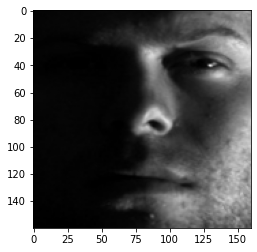

In [ ]:
# Ejemplo
print('Sujeto #{}'.format(trainY[20]))
plt.imshow(trainX[20])

### 3.1 Modelo base de Facenet (InceptionResNetV2)


In [ ]:
# Función para definir el InceptionResNetV2
def scaling(x, scale):
	return x * scale

def InceptionResNetV2(dimension = 128):
	inputs = Input(shape=(160, 160, 3))
	x = Conv2D(32, 3, strides=2, padding='valid', use_bias=False, name= 'Conv2d_1a_3x3') (inputs)
	x = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Conv2d_1a_3x3_BatchNorm')(x)
	x = Activation('relu', name='Conv2d_1a_3x3_Activation')(x)
	x = Conv2D(32, 3, strides=1, padding='valid', use_bias=False, name= 'Conv2d_2a_3x3') (x)
	x = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Conv2d_2a_3x3_BatchNorm')(x)
	x = Activation('relu', name='Conv2d_2a_3x3_Activation')(x)
	x = Conv2D(64, 3, strides=1, padding='same', use_bias=False, name= 'Conv2d_2b_3x3') (x)
	x = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Conv2d_2b_3x3_BatchNorm')(x)
	x = Activation('relu', name='Conv2d_2b_3x3_Activation')(x)
	x = MaxPooling2D(3, strides=2, name='MaxPool_3a_3x3')(x)
	x = Conv2D(80, 1, strides=1, padding='valid', use_bias=False, name= 'Conv2d_3b_1x1') (x)
	x = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Conv2d_3b_1x1_BatchNorm')(x)
	x = Activation('relu', name='Conv2d_3b_1x1_Activation')(x)
	x = Conv2D(192, 3, strides=1, padding='valid', use_bias=False, name= 'Conv2d_4a_3x3') (x)
	x = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Conv2d_4a_3x3_BatchNorm')(x)
	x = Activation('relu', name='Conv2d_4a_3x3_Activation')(x)
	x = Conv2D(256, 3, strides=2, padding='valid', use_bias=False, name= 'Conv2d_4b_3x3') (x)
	x = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Conv2d_4b_3x3_BatchNorm')(x)
	x = Activation('relu', name='Conv2d_4b_3x3_Activation')(x)

	# 5x Block35 (Inception-ResNet-A block):
	branch_0 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_1_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_1_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block35_1_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_1_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_1_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_1_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_1_Branch_1_Conv2d_0b_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_1_Branch_1_Conv2d_0b_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_1_Branch_1_Conv2d_0b_3x3_Activation')(branch_1)
	branch_2 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_1_Branch_2_Conv2d_0a_1x1') (x)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_1_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_1_Branch_2_Conv2d_0a_1x1_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_1_Branch_2_Conv2d_0b_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_1_Branch_2_Conv2d_0b_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_1_Branch_2_Conv2d_0b_3x3_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_1_Branch_2_Conv2d_0c_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_1_Branch_2_Conv2d_0c_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_1_Branch_2_Conv2d_0c_3x3_Activation')(branch_2)
	branches = [branch_0, branch_1, branch_2]
	mixed = Concatenate(axis=3, name='Block35_1_Concatenate')(branches)
	up = Conv2D(256, 1, strides=1, padding='same', use_bias=True, name= 'Block35_1_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.17})(up)
	x = add([x, up])
	x = Activation('relu', name='Block35_1_Activation')(x)

	branch_0 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_2_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_2_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block35_2_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_2_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_2_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_2_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_2_Branch_1_Conv2d_0b_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_2_Branch_1_Conv2d_0b_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_2_Branch_1_Conv2d_0b_3x3_Activation')(branch_1)
	branch_2 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_2_Branch_2_Conv2d_0a_1x1') (x)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_2_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_2_Branch_2_Conv2d_0a_1x1_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_2_Branch_2_Conv2d_0b_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_2_Branch_2_Conv2d_0b_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_2_Branch_2_Conv2d_0b_3x3_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_2_Branch_2_Conv2d_0c_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_2_Branch_2_Conv2d_0c_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_2_Branch_2_Conv2d_0c_3x3_Activation')(branch_2)
	branches = [branch_0, branch_1, branch_2]
	mixed = Concatenate(axis=3, name='Block35_2_Concatenate')(branches)
	up = Conv2D(256, 1, strides=1, padding='same', use_bias=True, name= 'Block35_2_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.17})(up)
	x = add([x, up])
	x = Activation('relu', name='Block35_2_Activation')(x)

	branch_0 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_3_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_3_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block35_3_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_3_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_3_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_3_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_3_Branch_1_Conv2d_0b_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_3_Branch_1_Conv2d_0b_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_3_Branch_1_Conv2d_0b_3x3_Activation')(branch_1)
	branch_2 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_3_Branch_2_Conv2d_0a_1x1') (x)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_3_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_3_Branch_2_Conv2d_0a_1x1_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_3_Branch_2_Conv2d_0b_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_3_Branch_2_Conv2d_0b_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_3_Branch_2_Conv2d_0b_3x3_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_3_Branch_2_Conv2d_0c_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_3_Branch_2_Conv2d_0c_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_3_Branch_2_Conv2d_0c_3x3_Activation')(branch_2)
	branches = [branch_0, branch_1, branch_2]
	mixed = Concatenate(axis=3, name='Block35_3_Concatenate')(branches)
	up = Conv2D(256, 1, strides=1, padding='same', use_bias=True, name= 'Block35_3_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.17})(up)
	x = add([x, up])
	x = Activation('relu', name='Block35_3_Activation')(x)

	branch_0 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_4_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_4_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block35_4_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_4_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_4_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_4_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_4_Branch_1_Conv2d_0b_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_4_Branch_1_Conv2d_0b_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_4_Branch_1_Conv2d_0b_3x3_Activation')(branch_1)
	branch_2 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_4_Branch_2_Conv2d_0a_1x1') (x)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_4_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_4_Branch_2_Conv2d_0a_1x1_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_4_Branch_2_Conv2d_0b_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_4_Branch_2_Conv2d_0b_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_4_Branch_2_Conv2d_0b_3x3_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_4_Branch_2_Conv2d_0c_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_4_Branch_2_Conv2d_0c_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_4_Branch_2_Conv2d_0c_3x3_Activation')(branch_2)
	branches = [branch_0, branch_1, branch_2]
	mixed = Concatenate(axis=3, name='Block35_4_Concatenate')(branches)
	up = Conv2D(256, 1, strides=1, padding='same', use_bias=True, name= 'Block35_4_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.17})(up)
	x = add([x, up])
	x = Activation('relu', name='Block35_4_Activation')(x)

	branch_0 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_5_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_5_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block35_5_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_5_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_5_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_5_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_5_Branch_1_Conv2d_0b_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_5_Branch_1_Conv2d_0b_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block35_5_Branch_1_Conv2d_0b_3x3_Activation')(branch_1)
	branch_2 = Conv2D(32, 1, strides=1, padding='same', use_bias=False, name= 'Block35_5_Branch_2_Conv2d_0a_1x1') (x)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_5_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_5_Branch_2_Conv2d_0a_1x1_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_5_Branch_2_Conv2d_0b_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_5_Branch_2_Conv2d_0b_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_5_Branch_2_Conv2d_0b_3x3_Activation')(branch_2)
	branch_2 = Conv2D(32, 3, strides=1, padding='same', use_bias=False, name= 'Block35_5_Branch_2_Conv2d_0c_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block35_5_Branch_2_Conv2d_0c_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Block35_5_Branch_2_Conv2d_0c_3x3_Activation')(branch_2)
	branches = [branch_0, branch_1, branch_2]
	mixed = Concatenate(axis=3, name='Block35_5_Concatenate')(branches)
	up = Conv2D(256, 1, strides=1, padding='same', use_bias=True, name= 'Block35_5_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.17})(up)
	x = add([x, up])
	x = Activation('relu', name='Block35_5_Activation')(x)

	# Mixed 6a (Reduction-A block):
	branch_0 = Conv2D(384, 3, strides=2, padding='valid', use_bias=False, name= 'Mixed_6a_Branch_0_Conv2d_1a_3x3') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_6a_Branch_0_Conv2d_1a_3x3_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Mixed_6a_Branch_0_Conv2d_1a_3x3_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Mixed_6a_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_6a_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Mixed_6a_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, 3, strides=1, padding='same', use_bias=False, name= 'Mixed_6a_Branch_1_Conv2d_0b_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_6a_Branch_1_Conv2d_0b_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Mixed_6a_Branch_1_Conv2d_0b_3x3_Activation')(branch_1)
	branch_1 = Conv2D(256, 3, strides=2, padding='valid', use_bias=False, name= 'Mixed_6a_Branch_1_Conv2d_1a_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_6a_Branch_1_Conv2d_1a_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Mixed_6a_Branch_1_Conv2d_1a_3x3_Activation')(branch_1)
	branch_pool = MaxPooling2D(3, strides=2, padding='valid', name='Mixed_6a_Branch_2_MaxPool_1a_3x3')(x)
	branches = [branch_0, branch_1, branch_pool]
	x = Concatenate(axis=3, name='Mixed_6a')(branches)

	# 10x Block17 (Inception-ResNet-B block):
	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_1_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_1_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_1_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_1_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_1_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_1_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_1_Branch_1_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_1_Branch_1_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_1_Branch_1_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_1_Branch_1_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_1_Branch_1_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_1_Branch_1_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_1_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_1_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_1_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_2_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_2_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_2_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_2_Branch_2_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_2_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_2_Branch_2_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_2_Branch_2_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_2_Branch_2_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_2_Branch_2_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_2_Branch_2_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_2_Branch_2_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_2_Branch_2_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_2_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_2_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_2_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_3_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_3_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_3_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_3_Branch_3_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_3_Branch_3_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_3_Branch_3_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_3_Branch_3_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_3_Branch_3_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_3_Branch_3_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_3_Branch_3_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_3_Branch_3_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_3_Branch_3_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_3_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_3_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_3_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_4_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_4_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_4_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_4_Branch_4_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_4_Branch_4_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_4_Branch_4_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_4_Branch_4_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_4_Branch_4_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_4_Branch_4_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_4_Branch_4_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_4_Branch_4_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_4_Branch_4_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_4_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_4_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_4_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_5_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_5_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_5_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_5_Branch_5_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_5_Branch_5_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_5_Branch_5_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_5_Branch_5_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_5_Branch_5_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_5_Branch_5_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_5_Branch_5_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_5_Branch_5_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_5_Branch_5_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_5_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_5_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_5_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_6_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_6_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_6_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_6_Branch_6_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_6_Branch_6_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_6_Branch_6_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_6_Branch_6_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_6_Branch_6_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_6_Branch_6_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_6_Branch_6_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_6_Branch_6_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_6_Branch_6_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_6_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_6_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_6_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_7_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_7_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_7_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_7_Branch_7_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_7_Branch_7_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_7_Branch_7_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_7_Branch_7_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_7_Branch_7_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_7_Branch_7_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_7_Branch_7_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_7_Branch_7_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_7_Branch_7_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_7_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_7_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_7_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_8_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_8_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_8_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_8_Branch_8_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_8_Branch_8_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_8_Branch_8_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_8_Branch_8_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_8_Branch_8_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_8_Branch_8_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_8_Branch_8_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_8_Branch_8_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_8_Branch_8_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_8_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_8_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_8_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_9_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_9_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_9_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_9_Branch_9_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_9_Branch_9_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_9_Branch_9_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_9_Branch_9_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_9_Branch_9_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_9_Branch_9_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_9_Branch_9_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_9_Branch_9_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_9_Branch_9_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_9_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_9_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_9_Activation')(x)

	branch_0 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_10_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_10_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block17_10_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(128, 1, strides=1, padding='same', use_bias=False, name= 'Block17_10_Branch_10_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_10_Branch_10_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_10_Branch_10_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(128, [1, 7], strides=1, padding='same', use_bias=False, name= 'Block17_10_Branch_10_Conv2d_0b_1x7') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_10_Branch_10_Conv2d_0b_1x7_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_10_Branch_10_Conv2d_0b_1x7_Activation')(branch_1)
	branch_1 = Conv2D(128, [7, 1], strides=1, padding='same', use_bias=False, name= 'Block17_10_Branch_10_Conv2d_0c_7x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block17_10_Branch_10_Conv2d_0c_7x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block17_10_Branch_10_Conv2d_0c_7x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block17_10_Concatenate')(branches)
	up = Conv2D(896, 1, strides=1, padding='same', use_bias=True, name= 'Block17_10_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.1})(up)
	x = add([x, up])
	x = Activation('relu', name='Block17_10_Activation')(x)

	# Mixed 7a (Reduction-B block): 8 x 8 x 2080
	branch_0 = Conv2D(256, 1, strides=1, padding='same', use_bias=False, name= 'Mixed_7a_Branch_0_Conv2d_0a_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_0_Conv2d_0a_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Mixed_7a_Branch_0_Conv2d_0a_1x1_Activation')(branch_0)
	branch_0 = Conv2D(384, 3, strides=2, padding='valid', use_bias=False, name= 'Mixed_7a_Branch_0_Conv2d_1a_3x3') (branch_0)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_0_Conv2d_1a_3x3_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Mixed_7a_Branch_0_Conv2d_1a_3x3_Activation')(branch_0)
	branch_1 = Conv2D(256, 1, strides=1, padding='same', use_bias=False, name= 'Mixed_7a_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Mixed_7a_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(256, 3, strides=2, padding='valid', use_bias=False, name= 'Mixed_7a_Branch_1_Conv2d_1a_3x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_1_Conv2d_1a_3x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Mixed_7a_Branch_1_Conv2d_1a_3x3_Activation')(branch_1)
	branch_2 = Conv2D(256, 1, strides=1, padding='same', use_bias=False, name= 'Mixed_7a_Branch_2_Conv2d_0a_1x1') (x)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Mixed_7a_Branch_2_Conv2d_0a_1x1_Activation')(branch_2)
	branch_2 = Conv2D(256, 3, strides=1, padding='same', use_bias=False, name= 'Mixed_7a_Branch_2_Conv2d_0b_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_2_Conv2d_0b_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Mixed_7a_Branch_2_Conv2d_0b_3x3_Activation')(branch_2)
	branch_2 = Conv2D(256, 3, strides=2, padding='valid', use_bias=False, name= 'Mixed_7a_Branch_2_Conv2d_1a_3x3') (branch_2)
	branch_2 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Mixed_7a_Branch_2_Conv2d_1a_3x3_BatchNorm')(branch_2)
	branch_2 = Activation('relu', name='Mixed_7a_Branch_2_Conv2d_1a_3x3_Activation')(branch_2)
	branch_pool = MaxPooling2D(3, strides=2, padding='valid', name='Mixed_7a_Branch_3_MaxPool_1a_3x3')(x)
	branches = [branch_0, branch_1, branch_2, branch_pool]
	x = Concatenate(axis=3, name='Mixed_7a')(branches)

	# 5x Block8 (Inception-ResNet-C block):

	branch_0 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_1_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_1_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block8_1_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_1_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_1_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_1_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, [1, 3], strides=1, padding='same', use_bias=False, name= 'Block8_1_Branch_1_Conv2d_0b_1x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_1_Branch_1_Conv2d_0b_1x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_1_Branch_1_Conv2d_0b_1x3_Activation')(branch_1)
	branch_1 = Conv2D(192, [3, 1], strides=1, padding='same', use_bias=False, name= 'Block8_1_Branch_1_Conv2d_0c_3x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_1_Branch_1_Conv2d_0c_3x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_1_Branch_1_Conv2d_0c_3x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block8_1_Concatenate')(branches)
	up = Conv2D(1792, 1, strides=1, padding='same', use_bias=True, name= 'Block8_1_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.2})(up)
	x = add([x, up])
	x = Activation('relu', name='Block8_1_Activation')(x)

	branch_0 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_2_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_2_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block8_2_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_2_Branch_2_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_2_Branch_2_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_2_Branch_2_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, [1, 3], strides=1, padding='same', use_bias=False, name= 'Block8_2_Branch_2_Conv2d_0b_1x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_2_Branch_2_Conv2d_0b_1x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_2_Branch_2_Conv2d_0b_1x3_Activation')(branch_1)
	branch_1 = Conv2D(192, [3, 1], strides=1, padding='same', use_bias=False, name= 'Block8_2_Branch_2_Conv2d_0c_3x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_2_Branch_2_Conv2d_0c_3x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_2_Branch_2_Conv2d_0c_3x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block8_2_Concatenate')(branches)
	up = Conv2D(1792, 1, strides=1, padding='same', use_bias=True, name= 'Block8_2_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.2})(up)
	x = add([x, up])
	x = Activation('relu', name='Block8_2_Activation')(x)

	branch_0 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_3_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_3_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block8_3_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_3_Branch_3_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_3_Branch_3_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_3_Branch_3_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, [1, 3], strides=1, padding='same', use_bias=False, name= 'Block8_3_Branch_3_Conv2d_0b_1x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_3_Branch_3_Conv2d_0b_1x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_3_Branch_3_Conv2d_0b_1x3_Activation')(branch_1)
	branch_1 = Conv2D(192, [3, 1], strides=1, padding='same', use_bias=False, name= 'Block8_3_Branch_3_Conv2d_0c_3x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_3_Branch_3_Conv2d_0c_3x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_3_Branch_3_Conv2d_0c_3x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block8_3_Concatenate')(branches)
	up = Conv2D(1792, 1, strides=1, padding='same', use_bias=True, name= 'Block8_3_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.2})(up)
	x = add([x, up])
	x = Activation('relu', name='Block8_3_Activation')(x)

	branch_0 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_4_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_4_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block8_4_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_4_Branch_4_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_4_Branch_4_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_4_Branch_4_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, [1, 3], strides=1, padding='same', use_bias=False, name= 'Block8_4_Branch_4_Conv2d_0b_1x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_4_Branch_4_Conv2d_0b_1x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_4_Branch_4_Conv2d_0b_1x3_Activation')(branch_1)
	branch_1 = Conv2D(192, [3, 1], strides=1, padding='same', use_bias=False, name= 'Block8_4_Branch_4_Conv2d_0c_3x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_4_Branch_4_Conv2d_0c_3x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_4_Branch_4_Conv2d_0c_3x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block8_4_Concatenate')(branches)
	up = Conv2D(1792, 1, strides=1, padding='same', use_bias=True, name= 'Block8_4_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.2})(up)
	x = add([x, up])
	x = Activation('relu', name='Block8_4_Activation')(x)

	branch_0 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_5_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_5_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block8_5_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_5_Branch_5_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_5_Branch_5_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_5_Branch_5_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, [1, 3], strides=1, padding='same', use_bias=False, name= 'Block8_5_Branch_5_Conv2d_0b_1x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_5_Branch_5_Conv2d_0b_1x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_5_Branch_5_Conv2d_0b_1x3_Activation')(branch_1)
	branch_1 = Conv2D(192, [3, 1], strides=1, padding='same', use_bias=False, name= 'Block8_5_Branch_5_Conv2d_0c_3x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_5_Branch_5_Conv2d_0c_3x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_5_Branch_5_Conv2d_0c_3x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block8_5_Concatenate')(branches)
	up = Conv2D(1792, 1, strides=1, padding='same', use_bias=True, name= 'Block8_5_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 0.2})(up)
	x = add([x, up])
	x = Activation('relu', name='Block8_5_Activation')(x)

	branch_0 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_6_Branch_0_Conv2d_1x1') (x)
	branch_0 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_6_Branch_0_Conv2d_1x1_BatchNorm')(branch_0)
	branch_0 = Activation('relu', name='Block8_6_Branch_0_Conv2d_1x1_Activation')(branch_0)
	branch_1 = Conv2D(192, 1, strides=1, padding='same', use_bias=False, name= 'Block8_6_Branch_1_Conv2d_0a_1x1') (x)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_6_Branch_1_Conv2d_0a_1x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_6_Branch_1_Conv2d_0a_1x1_Activation')(branch_1)
	branch_1 = Conv2D(192, [1, 3], strides=1, padding='same', use_bias=False, name= 'Block8_6_Branch_1_Conv2d_0b_1x3') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_6_Branch_1_Conv2d_0b_1x3_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_6_Branch_1_Conv2d_0b_1x3_Activation')(branch_1)
	branch_1 = Conv2D(192, [3, 1], strides=1, padding='same', use_bias=False, name= 'Block8_6_Branch_1_Conv2d_0c_3x1') (branch_1)
	branch_1 = BatchNormalization(axis=3, momentum=0.995, epsilon=0.001, scale=False, name='Block8_6_Branch_1_Conv2d_0c_3x1_BatchNorm')(branch_1)
	branch_1 = Activation('relu', name='Block8_6_Branch_1_Conv2d_0c_3x1_Activation')(branch_1)
	branches = [branch_0, branch_1]
	mixed = Concatenate(axis=3, name='Block8_6_Concatenate')(branches)
	up = Conv2D(1792, 1, strides=1, padding='same', use_bias=True, name= 'Block8_6_Conv2d_1x1') (mixed)
	up = Lambda(scaling, output_shape=K.int_shape(up)[1:], arguments={'scale': 1})(up)
	x = add([x, up])

	# Classification block
	x = GlobalAveragePooling2D(name='AvgPool')(x)
	x = Dropout(1.0 - 0.8, name='Dropout')(x)
	# Bottleneck
	x = Dense(dimension, use_bias=False, name='Bottleneck')(x)
	x = BatchNormalization(momentum=0.995, epsilon=0.001, scale=False, name='Bottleneck_BatchNorm')(x)

	# Create model
	model = Model(inputs, x, name='inception_resnet_v1')

	return model

In [ ]:
facenet_model = InceptionResNetV2()
facenet_model.summary()

Model: "inception_resnet_v1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                

In [ ]:
#Carga de los pesos de un modelo pre-entrenado
#facenet_model.load_weights(path + 'data_models/facenet_weights.h5')

## 4. Modelos con base de datos Yale para condiciones de iluminación

#### Modelo 1: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adama[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale1 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale1)
facenet_model_yale1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale1)
facenet_model_yale1.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_YALE1/facenet_model_yale1_1.h5', monitor="val_loss", save_best_only=True)
hist_model_yale1 = facenet_model_yale1.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 34s 197ms/step - loss: 4.0396 - accuracy: 0.1397 - val_loss: 4.6907 - val_accuracy: 0.0298
Epoch 2/60
74/74 [==============================] - 9s 120ms/step - loss: 1.9993 - accuracy: 0.6515 - val_loss: 5.2072 - val_accuracy: 0.0325
Epoch 3/60
74/74 [==============================] - 9s 120ms/step - loss: 0.8650 - accuracy: 0.9464 - val_loss: 5.1852 - val_accuracy: 0.0108
Epoch 4/60
74/74 [==============================] - 9s 121ms/step - loss: 0.6286 - accuracy: 0.9898 - val_loss: 4.9657 - val_accuracy: 0.0217
Epoch 5/60
74/74 [==============================] - 9s 123ms/step - loss: 0.5289 - accuracy: 0.9966 - val_loss: 5.0094 - val_accuracy: 0.0244
Epoch 6/60
74/74 [==============================] - 9s 121ms/step - loss: 0.4687 - accuracy: 0.9986 - val_loss: 4.8073 - val_accuracy: 0.0379
Epoch 7/60
74/74 [==============================] - 9s 120ms/step - loss: 0.3999 - accuracy: 0.9986 - val_loss: 4.9508 - val_accuracy: 0.0217
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale1 = load_model(path + 'data_reconocimiento1/models_YALE1/facenet_model_yale1_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale1.evaluate(testX, testY)

18/18 [==============================] - 2s 86ms/step - loss: 0.2194 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

18/18 [==============================] - 2s 49ms/step


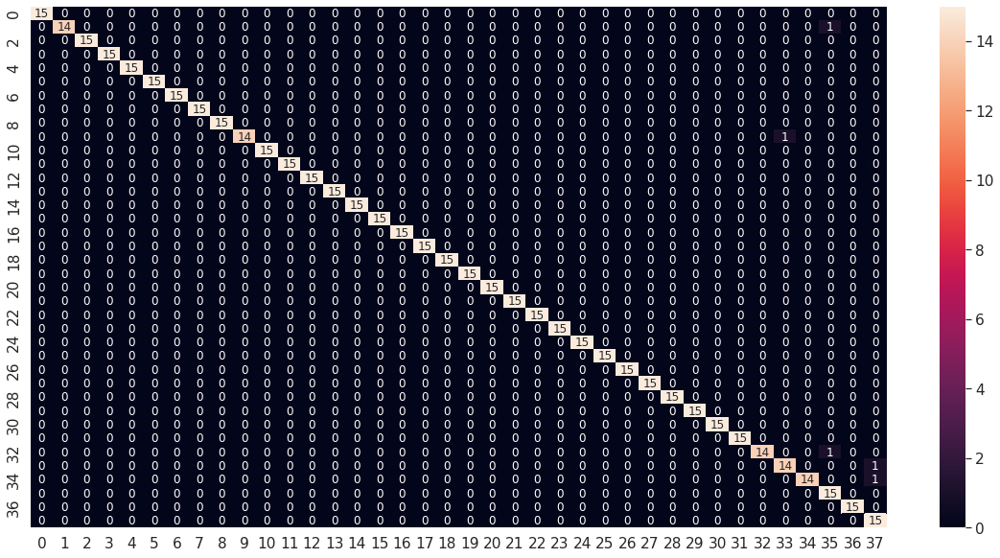

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale1_df_CM = pd.DataFrame(facenet_model_yale1_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale1_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale2 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale2 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale2)
facenet_model_yale2 = keras.Model(facenet_model.get_layer('input_2').get_output_at(node_index=0), facenet_model_yale2)
facenet_model_yale2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_2[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale2.h5', monitor="val_loss", save_best_only=True)
hist_model_yale2 = facenet_model_yale2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
50/50 [==============================] - 29s 185ms/step - loss: 5.0986 - accuracy: 0.0488 - val_loss: 4.6086 - val_accuracy: 0.0217
Epoch 2/80
50/50 [==============================] - 5s 105ms/step - loss: 4.3036 - accuracy: 0.0915 - val_loss: 4.6904 - val_accuracy: 0.0298
Epoch 3/80
50/50 [==============================] - 5s 105ms/step - loss: 3.8050 - accuracy: 0.1871 - val_loss: 4.8858 - val_accuracy: 0.0244
Epoch 4/80
50/50 [==============================] - 5s 105ms/step - loss: 2.6848 - accuracy: 0.4061 - val_loss: 5.7955 - val_accuracy: 0.0108
Epoch 5/80
50/50 [==============================] - 5s 104ms/step - loss: 1.7953 - accuracy: 0.6597 - val_loss: 7.3939 - val_accuracy: 0.0352
Epoch 6/80
50/50 [==============================] - 5s 104ms/step - loss: 1.2476 - accuracy: 0.8115 - val_loss: 8.6104 - val_accuracy: 0.0298
Epoch 7/80
50/50 [==============================] - 5s 104ms/step - loss: 0.7792 - accuracy: 0.9546 - val_loss: 5.5812 - val_accuracy: 0.0298
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale2 = load_model(path + 'data_reconocimiento1/facenet_model_yale2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale2.evaluate(testX, testY)

18/18 [==============================] - 1s 46ms/step - loss: 0.2321 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

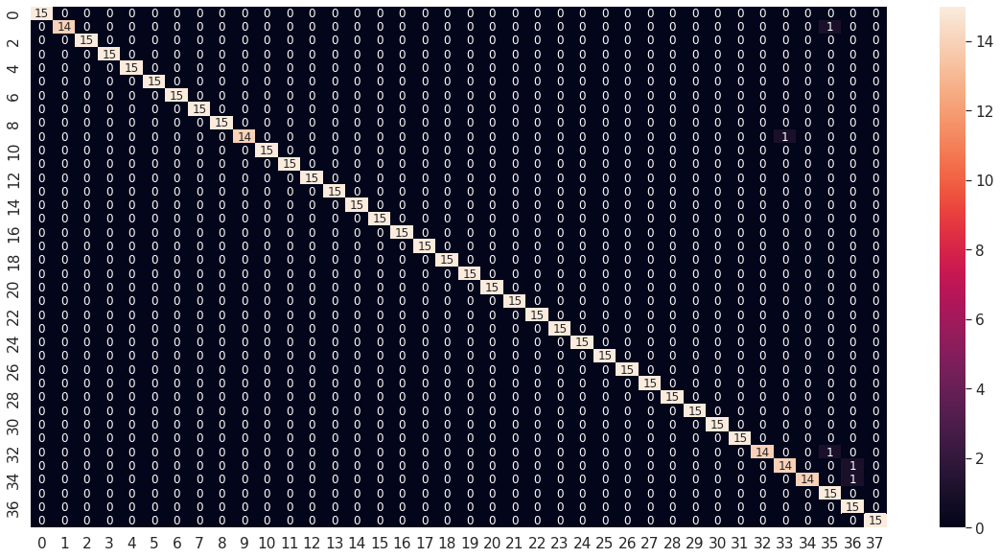

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale2_df_CM = pd.DataFrame(facenet_model_yale2_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale2_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale3 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale3 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale3)
facenet_model_yale3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale3)
facenet_model_yale3.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale3.h5', monitor="val_loss", save_best_only=True)
hist_model_yale3 = facenet_model_yale3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 36s 212ms/step - loss: 5.0530 - accuracy: 0.0481 - val_loss: 4.6713 - val_accuracy: 0.0352
Epoch 2/50
50/50 [==============================] - 6s 115ms/step - loss: 4.1147 - accuracy: 0.1458 - val_loss: 4.6744 - val_accuracy: 0.0244
Epoch 3/50
50/50 [==============================] - 6s 113ms/step - loss: 2.9407 - accuracy: 0.3647 - val_loss: 5.0874 - val_accuracy: 0.0217
Epoch 4/50
50/50 [==============================] - 5s 110ms/step - loss: 1.7425 - accuracy: 0.6719 - val_loss: 5.2516 - val_accuracy: 0.0298
Epoch 5/50
50/50 [==============================] - 5s 108ms/step - loss: 0.9878 - accuracy: 0.8956 - val_loss: 5.3647 - val_accuracy: 0.0325
Epoch 6/50
50/50 [==============================] - 5s 109ms/step - loss: 0.7512 - accuracy: 0.9559 - val_loss: 5.1044 - val_accuracy: 0.0325
Epoch 7/50
50/50 [==============================] - 5s 109ms/step - loss: 0.6255 - accuracy: 0.9885 - val_loss: 4.9211 - val_accuracy: 0.0244
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale3 = load_model(path + 'data_reconocimiento1/facenet_model_yale3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale3.evaluate(testX, testY)

18/18 [==============================] - 1s 50ms/step - loss: 0.2307 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

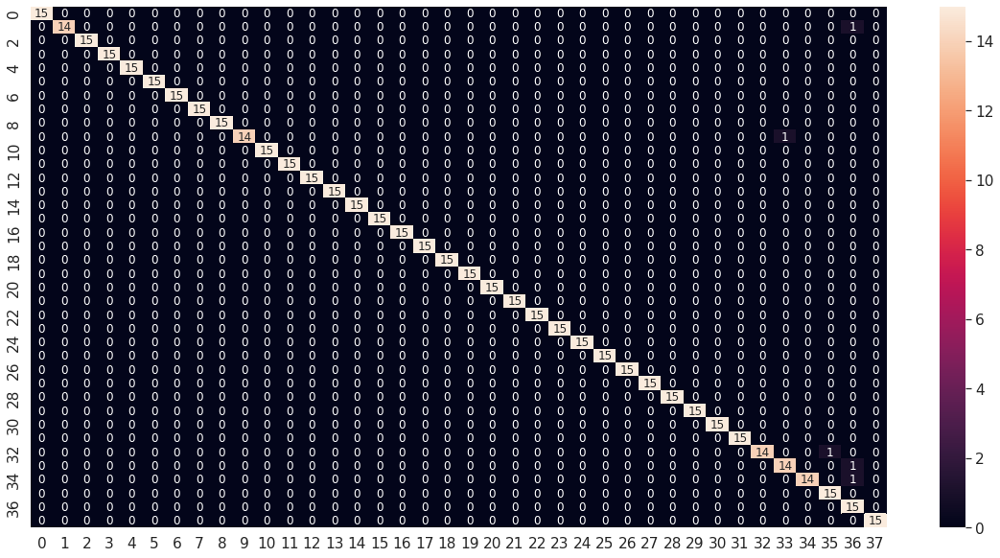

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale3_df_CM = pd.DataFrame(facenet_model_yale3_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale3_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 4: (BTH = 20, EHS = 100, ValidSplit = 0.2, INI = HeNormal, Dropout=0 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale4 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale4 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale4)
facenet_model_yale4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale4)
facenet_model_yale4.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_YALE1/facenet_model_yale1_4.h5', monitor="val_loss", save_best_only=True)
hist_model_yale4 = facenet_model_yale4.fit(new_trainX, new_trainY, batch_size=20, epochs=100, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/100
74/74 [==============================] - 23s 175ms/step - loss: 1.0741 - accuracy: 0.9254 - val_loss: 1.3214 - val_accuracy: 0.8509
Epoch 2/100
74/74 [==============================] - 11s 151ms/step - loss: 0.6468 - accuracy: 0.9871 - val_loss: 0.7199 - val_accuracy: 0.9593
Epoch 3/100
74/74 [==============================] - 11s 148ms/step - loss: 0.4609 - accuracy: 0.9986 - val_loss: 0.4712 - val_accuracy: 0.9837
Epoch 4/100
74/74 [==============================] - 11s 148ms/step - loss: 0.3370 - accuracy: 1.0000 - val_loss: 0.3051 - val_accuracy: 0.9946
Epoch 5/100
74/74 [==============================] - 12s 160ms/step - loss: 0.2630 - accuracy: 1.0000 - val_loss: 0.2483 - val_accuracy: 0.9946
Epoch 6/100
74/74 [==============================] - 12s 156ms/step - loss: 0.2259 - accuracy: 1.0000 - val_loss: 0.2231 - val_accuracy: 0.9946
Epoch 7/100
74/74 [==============================] - 11s 148ms/step - loss: 0.2096 - accuracy: 1.0000 - val_loss: 0.2127 - val_accuracy:

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale4 = load_model(path + 'data_reconocimiento1/models_YALE1/facenet_model_yale1_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale4.evaluate(testX, testY)

18/18 [==============================] - 1s 52ms/step - loss: 0.2103 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

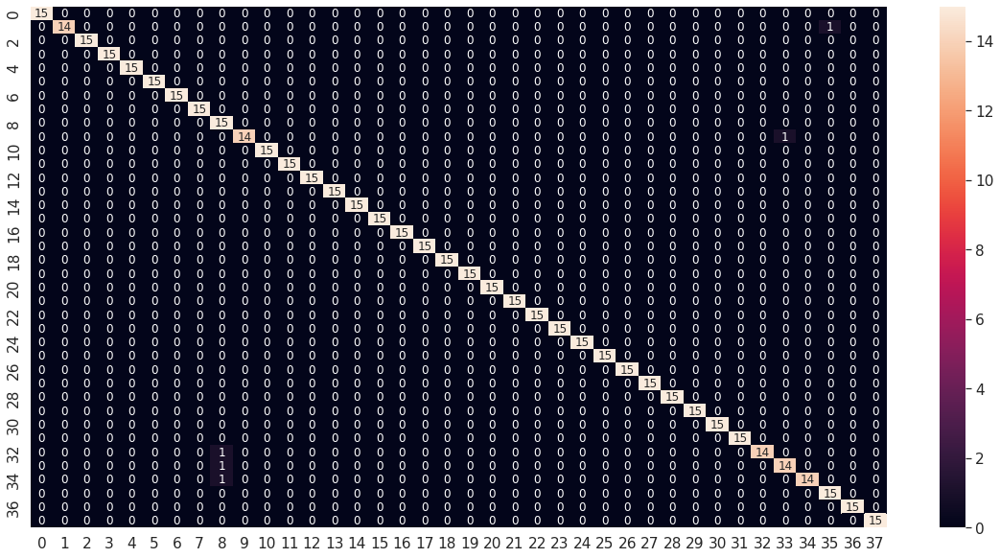

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale4_df_CM = pd.DataFrame(facenet_model_yale4_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale4_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       0.83      1.00      0.91        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 5: (BTH = 20, EHS = 60, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale5 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale5)
facenet_model_yale5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale5)
facenet_model_yale5.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale5.h5', monitor="val_loss", save_best_only=True)
hist_model_yale5 = facenet_model_yale5.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 36s 181ms/step - loss: 5.0013 - accuracy: 0.0536 - val_loss: 4.7045 - val_accuracy: 0.0244
Epoch 2/60
74/74 [==============================] - 8s 112ms/step - loss: 4.0516 - accuracy: 0.1586 - val_loss: 4.9418 - val_accuracy: 0.0379
Epoch 3/60
74/74 [==============================] - 8s 113ms/step - loss: 2.3587 - accuracy: 0.5132 - val_loss: 5.0820 - val_accuracy: 0.0379
Epoch 4/60
74/74 [==============================] - 8s 113ms/step - loss: 1.1264 - accuracy: 0.8583 - val_loss: 5.2877 - val_accuracy: 0.0325
Epoch 5/60
74/74 [==============================] - 8s 114ms/step - loss: 0.7800 - accuracy: 0.9532 - val_loss: 5.1828 - val_accuracy: 0.0136
Epoch 6/60
74/74 [==============================] - 9s 115ms/step - loss: 0.6394 - accuracy: 0.9871 - val_loss: 5.1375 - val_accuracy: 0.0325
Epoch 7/60
74/74 [==============================] - 9s 116ms/step - loss: 0.5342 - accuracy: 0.9973 - val_loss: 5.1506 - val_accuracy: 0.0244
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale5 = load_model(path + 'data_reconocimiento1/facenet_model_yale5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale5.evaluate(testX, testY)

18/18 [==============================] - 2s 88ms/step - loss: 0.2213 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

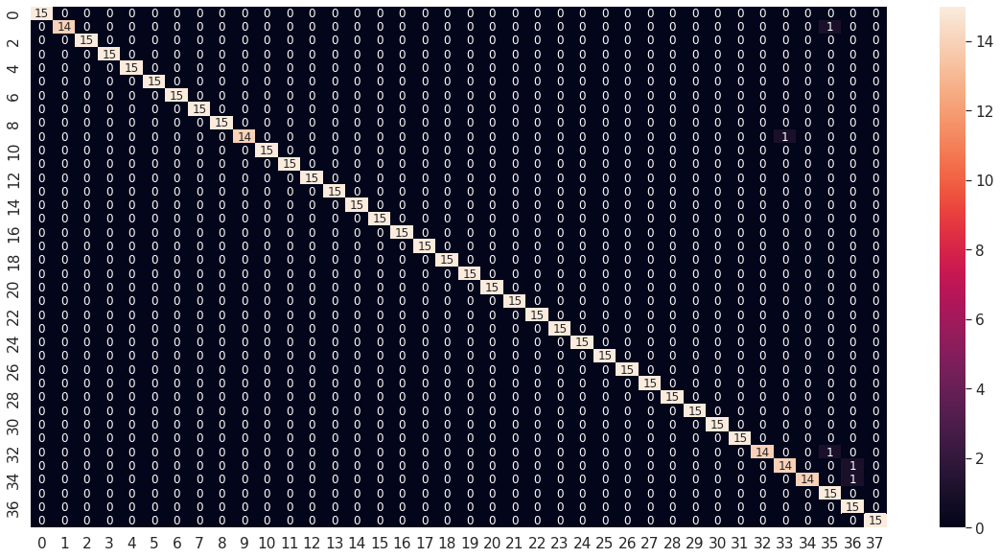

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale5_df_CM = pd.DataFrame(facenet_model_yale5_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale5_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale6 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale6 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale6)
facenet_model_yale6 = keras.Model(facenet_model.get_layer('input_2').get_output_at(node_index=0), facenet_model_yale6)
facenet_model_yale6.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_2[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale6.h5', monitor="val_loss", save_best_only=True)
hist_model_yale6 = facenet_model_yale6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
37/37 [==============================] - 26s 328ms/step - loss: 5.0411 - accuracy: 0.0590 - val_loss: 4.6735 - val_accuracy: 0.0190
Epoch 2/60
37/37 [==============================] - 8s 228ms/step - loss: 3.8690 - accuracy: 0.2088 - val_loss: 4.5260 - val_accuracy: 0.0217
Epoch 3/60
37/37 [==============================] - 5s 137ms/step - loss: 2.4858 - accuracy: 0.4902 - val_loss: 5.1200 - val_accuracy: 0.0379
Epoch 4/60
37/37 [==============================] - 5s 133ms/step - loss: 1.3662 - accuracy: 0.7993 - val_loss: 4.7933 - val_accuracy: 0.0244
Epoch 5/60
37/37 [==============================] - 5s 133ms/step - loss: 0.8515 - accuracy: 0.9532 - val_loss: 4.8392 - val_accuracy: 0.0271
Epoch 6/60
37/37 [==============================] - 5s 131ms/step - loss: 0.6760 - accuracy: 0.9858 - val_loss: 5.5077 - val_accuracy: 0.0271
Epoch 7/60
37/37 [==============================] - 5s 131ms/step - loss: 0.5956 - accuracy: 0.9973 - val_loss: 5.0573 - val_accuracy: 0.0271
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale6 = load_model(path + 'data_reconocimiento1/facenet_model_yale6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale6.evaluate(testX, testY)

18/18 [==============================] - 1s 43ms/step - loss: 0.2204 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

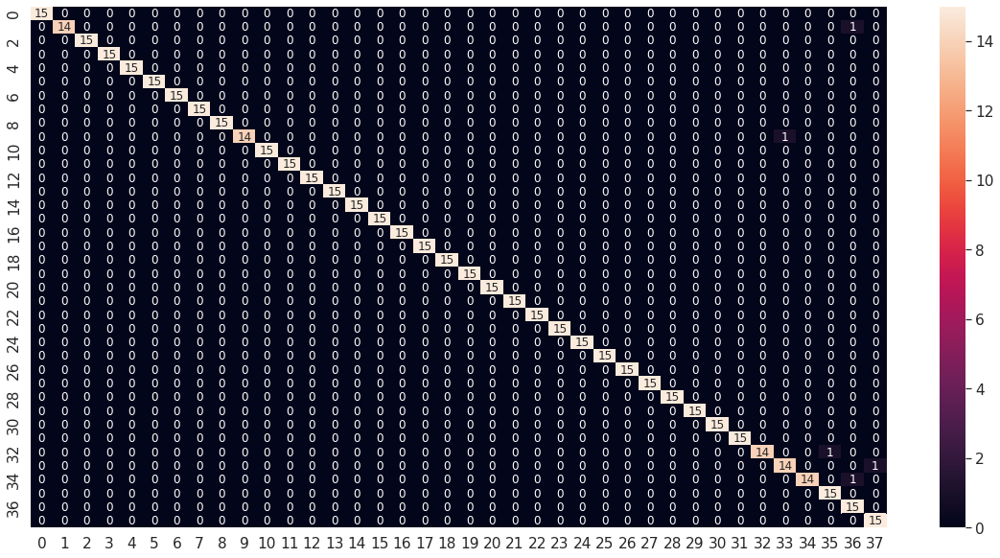

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale6_df_CM = pd.DataFrame(facenet_model_yale6_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale6_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 7: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale7 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale7 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale7)
facenet_model_yale7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale7)
facenet_model_yale7.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_YALE1/facenet_model_yale1_7.h5', monitor="val_loss", save_best_only=True)
hist_model_yale7 = facenet_model_yale7.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 25s 262ms/step - loss: 1.4177 - accuracy: 0.8759 - val_loss: 0.7824 - val_accuracy: 0.9973
Epoch 2/50
50/50 [==============================] - 10s 205ms/step - loss: 0.7012 - accuracy: 0.9993 - val_loss: 0.6466 - val_accuracy: 0.9973
Epoch 3/50
50/50 [==============================] - 10s 203ms/step - loss: 0.5805 - accuracy: 0.9993 - val_loss: 0.5358 - val_accuracy: 0.9973
Epoch 4/50
50/50 [==============================] - 10s 203ms/step - loss: 0.4724 - accuracy: 0.9993 - val_loss: 0.4497 - val_accuracy: 0.9973
Epoch 5/50
50/50 [==============================] - 10s 203ms/step - loss: 0.3885 - accuracy: 1.0000 - val_loss: 0.3855 - val_accuracy: 0.9973
Epoch 6/50
50/50 [==============================] - 8s 162ms/step - loss: 0.3636 - accuracy: 0.9953 - val_loss: 1.5270 - val_accuracy: 0.7317
Epoch 7/50
50/50 [==============================] - 8s 161ms/step - loss: 0.3125 - accuracy: 0.9959 - val_loss: 0.4067 - val_accuracy: 0.9919
E

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale7 = load_model(path + 'data_reconocimiento1/models_YALE1/facenet_model_yale1_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale7.evaluate(testX, testY)

18/18 [==============================] - 1s 51ms/step - loss: 0.2227 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

18/18 [==============================] - 2s 48ms/step


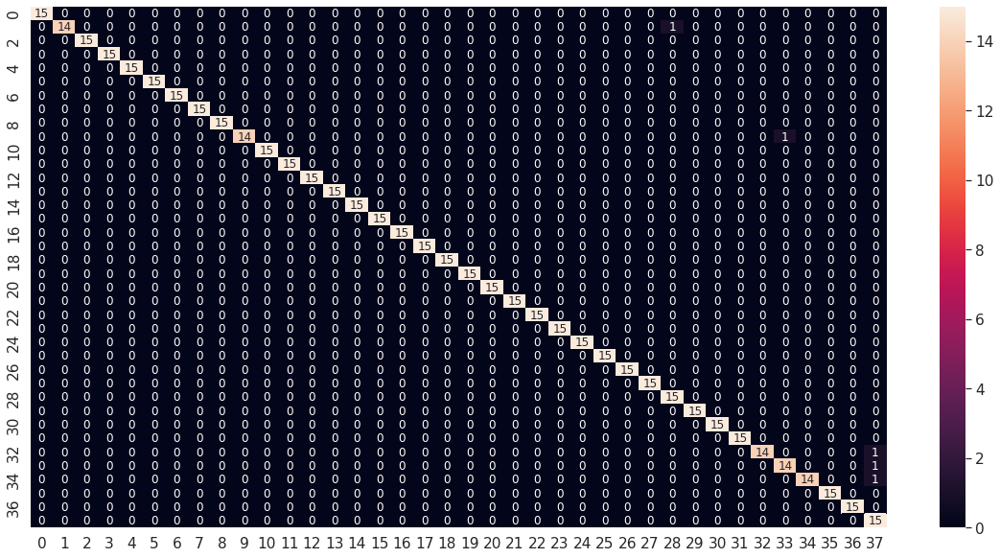

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale7_df_CM = pd.DataFrame(facenet_model_yale7_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale7_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 8: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0,2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale8 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale8 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale8)
facenet_model_yale8 = keras.Model(facenet_model.get_layer('input_2').get_output_at(node_index=0), facenet_model_yale8)
facenet_model_yale8.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_2[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_yale8.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale8.h5', monitor="val_loss", save_best_only=True)
hist_model_yale8 = facenet_model_yale8.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 25s 168ms/step - loss: 4.2154 - accuracy: 0.1410 - val_loss: 4.8155 - val_accuracy: 0.0244
Epoch 2/60
74/74 [==============================] - 7s 92ms/step - loss: 2.3548 - accuracy: 0.5695 - val_loss: 4.9465 - val_accuracy: 0.0217
Epoch 3/60
74/74 [==============================] - 7s 96ms/step - loss: 1.4406 - accuracy: 0.8251 - val_loss: 4.8367 - val_accuracy: 0.0217
Epoch 4/60
74/74 [==============================] - 7s 95ms/step - loss: 1.0418 - accuracy: 0.9281 - val_loss: 4.9043 - val_accuracy: 0.0271
Epoch 5/60
74/74 [==============================] - 7s 93ms/step - loss: 0.8490 - accuracy: 0.9654 - val_loss: 5.3099 - val_accuracy: 0.0217
Epoch 6/60
74/74 [==============================] - 7s 91ms/step - loss: 0.7596 - accuracy: 0.9864 - val_loss: 5.3145 - val_accuracy: 0.0217
Epoch 7/60
74/74 [==============================] - 7s 91ms/step - loss: 0.6930 - accuracy: 0.9939 - val_loss: 5.0859 - val_accuracy: 0.0379
Epoch 8/60


In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale8 = load_model(path + 'data_reconocimiento1/facenet_model_yale8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale8.evaluate(testX, testY)

18/18 [==============================] - 1s 38ms/step - loss: 0.2526 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

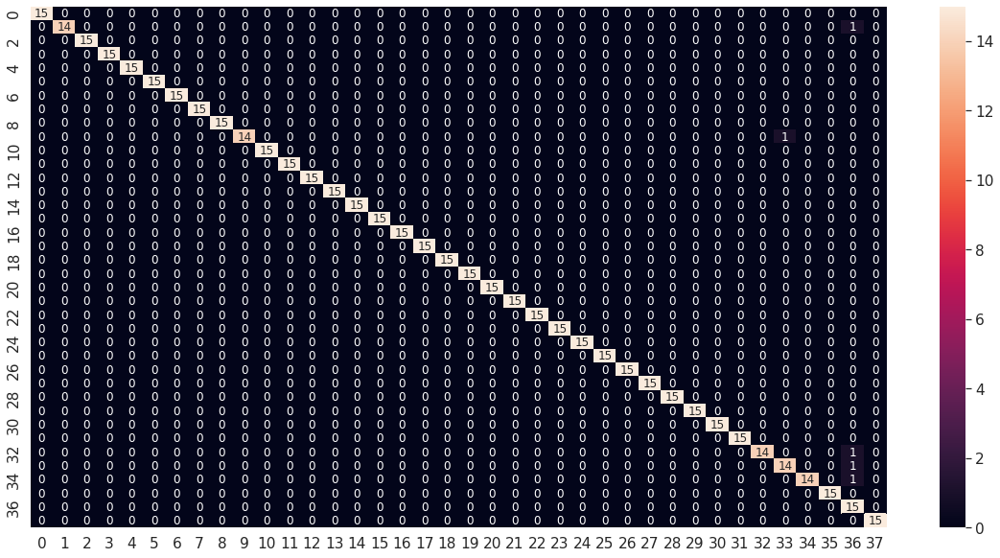

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale8_df_CM = pd.DataFrame(facenet_model_yale8_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale8_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 9: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale9 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale9 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale9)
facenet_model_yale9 = keras.Model(facenet_model.get_layer('input_3').get_output_at(node_index=0), facenet_model_yale9)
facenet_model_yale9.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_3[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale9.h5', monitor="val_loss", save_best_only=True)
hist_model_yale9 = facenet_model_yale9.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 23s 149ms/step - loss: 4.3843 - accuracy: 0.0949 - val_loss: 4.7633 - val_accuracy: 0.0217
Epoch 2/60
74/74 [==============================] - 7s 89ms/step - loss: 2.5728 - accuracy: 0.4800 - val_loss: 5.0238 - val_accuracy: 0.0352
Epoch 3/60
74/74 [==============================] - 7s 94ms/step - loss: 1.1117 - accuracy: 0.8725 - val_loss: 5.7756 - val_accuracy: 0.0379
Epoch 4/60
74/74 [==============================] - 7s 89ms/step - loss: 0.6891 - accuracy: 0.9864 - val_loss: 5.2253 - val_accuracy: 0.0298
Epoch 5/60
74/74 [==============================] - 7s 89ms/step - loss: 0.5762 - accuracy: 0.9966 - val_loss: 5.9998 - val_accuracy: 0.0298
Epoch 6/60
74/74 [==============================] - 7s 89ms/step - loss: 0.5044 - accuracy: 0.9980 - val_loss: 5.3072 - val_accuracy: 0.0298
Epoch 7/60
74/74 [==============================] - 7s 89ms/step - loss: 0.4442 - accuracy: 0.9986 - val_loss: 5.0594 - val_accuracy: 0.0217
Epoch 8/60


In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale9 = load_model(path + 'data_reconocimiento1/facenet_model_yale9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale9.evaluate(testX, testY)

18/18 [==============================] - 2s 86ms/step - loss: 0.2145 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

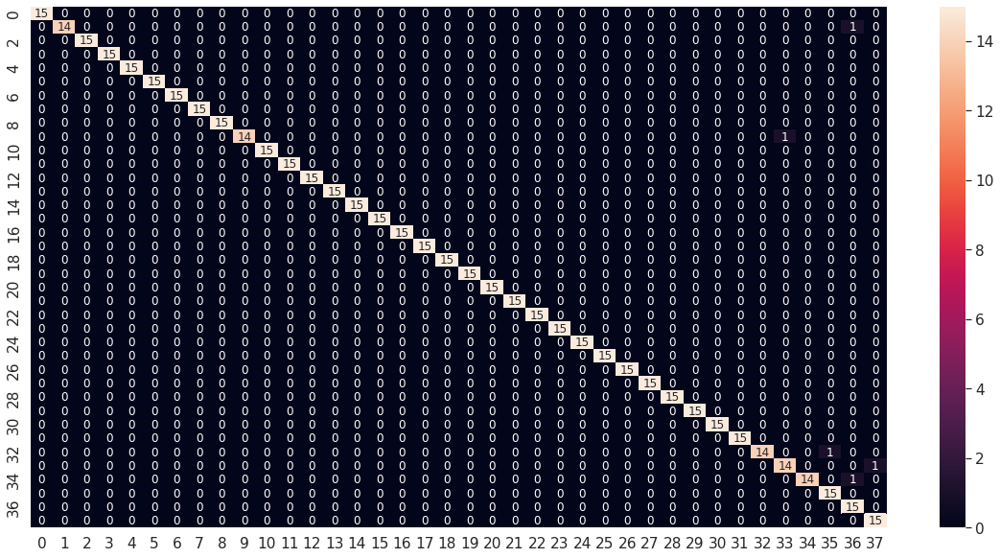

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale9_df_CM = pd.DataFrame(facenet_model_yale9_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale9_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 10: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale10 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale10 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale10)
facenet_model_yale10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale10)
facenet_model_yale10.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_yale10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale10.h5', monitor="val_loss", save_best_only=True)
hist_model_yale10 = facenet_model_yale10.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 25s 263ms/step - loss: 4.2402 - accuracy: 0.1539 - val_loss: 4.7481 - val_accuracy: 0.0298
Epoch 2/50
50/50 [==============================] - 8s 161ms/step - loss: 2.4429 - accuracy: 0.5532 - val_loss: 4.9299 - val_accuracy: 0.0217
Epoch 3/50
50/50 [==============================] - 8s 167ms/step - loss: 1.4202 - accuracy: 0.8393 - val_loss: 5.0671 - val_accuracy: 0.0217
Epoch 4/50
50/50 [==============================] - 8s 170ms/step - loss: 1.0437 - accuracy: 0.9376 - val_loss: 5.1889 - val_accuracy: 0.0217
Epoch 5/50
50/50 [==============================] - 9s 171ms/step - loss: 0.8947 - accuracy: 0.9736 - val_loss: 5.0478 - val_accuracy: 0.0407
Epoch 6/50
50/50 [==============================] - 9s 171ms/step - loss: 0.8074 - accuracy: 0.9824 - val_loss: 5.4235 - val_accuracy: 0.0217
Epoch 7/50
50/50 [==============================] - 8s 168ms/step - loss: 0.7797 - accuracy: 0.9810 - val_loss: 5.4232 - val_accuracy: 0.0217
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale10 = load_model(path + 'data_reconocimiento1/facenet_model_yale10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale10.evaluate(testX, testY)

18/18 [==============================] - 1s 56ms/step - loss: 0.4030 - accuracy: 0.9842


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

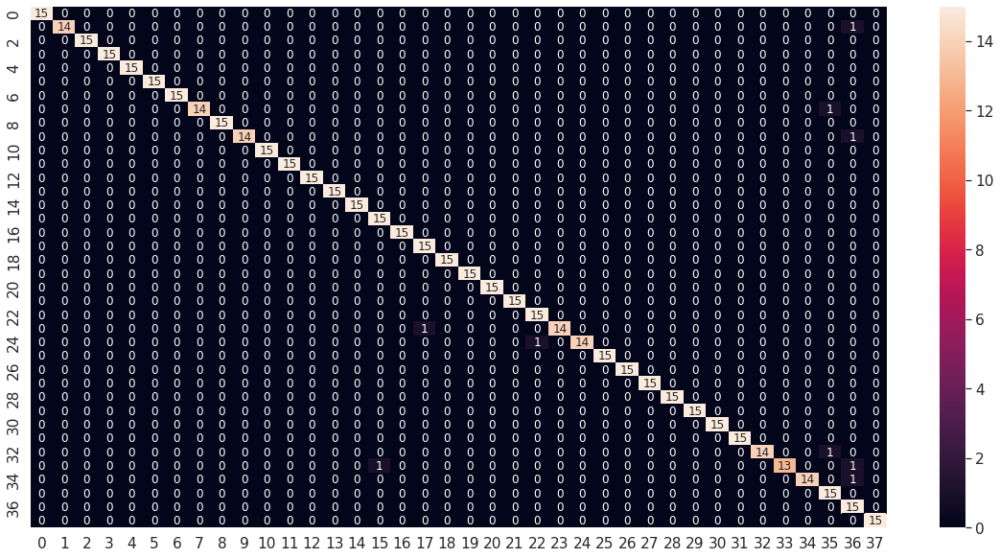

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale10_df_CM = pd.DataFrame(facenet_model_yale10_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale10_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      0.93      0.97        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       0.94      1.00      0.97        15
          18       1.00      1.00      1.00        15
          19       0.94    

#### Modelo 11: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale11 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale11 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale11)
facenet_model_yale11 = keras.Model(facenet_model.get_layer('input_2').get_output_at(node_index=0), facenet_model_yale11)
facenet_model_yale11.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_2[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_yale11.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale11.h5', monitor="val_loss", save_best_only=True)
hist_model_yale11 = facenet_model_yale11.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 21s 235ms/step - loss: 6.0217 - accuracy: 0.0549 - val_loss: 4.9404 - val_accuracy: 0.0163
Epoch 2/50
50/50 [==============================] - 8s 168ms/step - loss: 5.1842 - accuracy: 0.0847 - val_loss: 5.1089 - val_accuracy: 0.0244
Epoch 3/50
50/50 [==============================] - 12s 237ms/step - loss: 4.4251 - accuracy: 0.1492 - val_loss: 4.9351 - val_accuracy: 0.0298
Epoch 4/50
50/50 [==============================] - 9s 172ms/step - loss: 3.6381 - accuracy: 0.2705 - val_loss: 5.4633 - val_accuracy: 0.0217
Epoch 5/50
50/50 [==============================] - 9s 172ms/step - loss: 2.7295 - accuracy: 0.4766 - val_loss: 5.5952 - val_accuracy: 0.0298
Epoch 6/50
50/50 [==============================] - 8s 170ms/step - loss: 2.0846 - accuracy: 0.6305 - val_loss: 5.6830 - val_accuracy: 0.0298
Epoch 7/50
50/50 [==============================] - 8s 169ms/step - loss: 1.6389 - accuracy: 0.7410 - val_loss: 5.4727 - val_accuracy: 0.0298
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale11 = load_model(path + 'data_reconocimiento1/facenet_model_yale11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale11.evaluate(testX, testY)

18/18 [==============================] - 1s 56ms/step - loss: 0.4480 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

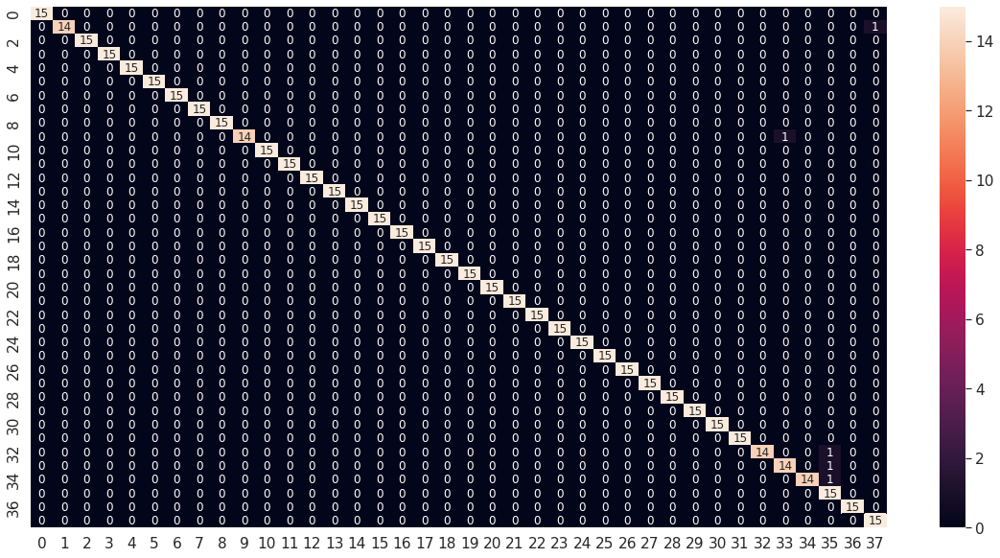

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale11_df_CM = pd.DataFrame(facenet_model_yale11_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale11_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 12: (BTH = 20, EHS = 46, ValidSplit = 0.2, Dropout = 0.7, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale12 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale12 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale12)
facenet_model_yale12 = keras.Model(facenet_model.get_layer('input_3').get_output_at(node_index=0), facenet_model_yale12)
facenet_model_yale12.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_3[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale12.h5', monitor="val_loss", save_best_only=True)
hist_model_yale12 = facenet_model_yale12.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 24s 188ms/step - loss: 5.6412 - accuracy: 0.0393 - val_loss: 15.5772 - val_accuracy: 0.0190
Epoch 2/60
74/74 [==============================] - 11s 148ms/step - loss: 4.9761 - accuracy: 0.0407 - val_loss: 7.7444 - val_accuracy: 0.0407
Epoch 3/60
74/74 [==============================] - 11s 150ms/step - loss: 4.8597 - accuracy: 0.0325 - val_loss: 4.4351 - val_accuracy: 0.0488
Epoch 4/60
74/74 [==============================] - 9s 124ms/step - loss: 4.9666 - accuracy: 0.0420 - val_loss: 4.7930 - val_accuracy: 0.0271
Epoch 5/60
74/74 [==============================] - 9s 122ms/step - loss: 4.9067 - accuracy: 0.0515 - val_loss: 4.5485 - val_accuracy: 0.0271
Epoch 6/60
74/74 [==============================] - 9s 121ms/step - loss: 4.6400 - accuracy: 0.0556 - val_loss: 4.5940 - val_accuracy: 0.0244
Epoch 7/60
74/74 [==============================] - 11s 149ms/step - loss: 4.5855 - accuracy: 0.0692 - val_loss: 4.1994 - val_accuracy: 0.0732
E

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale12 = load_model(path + 'data_reconocimiento1/facenet_model_yale12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale12.evaluate(testX, testY)

18/18 [==============================] - 1s 56ms/step - loss: 0.2920 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

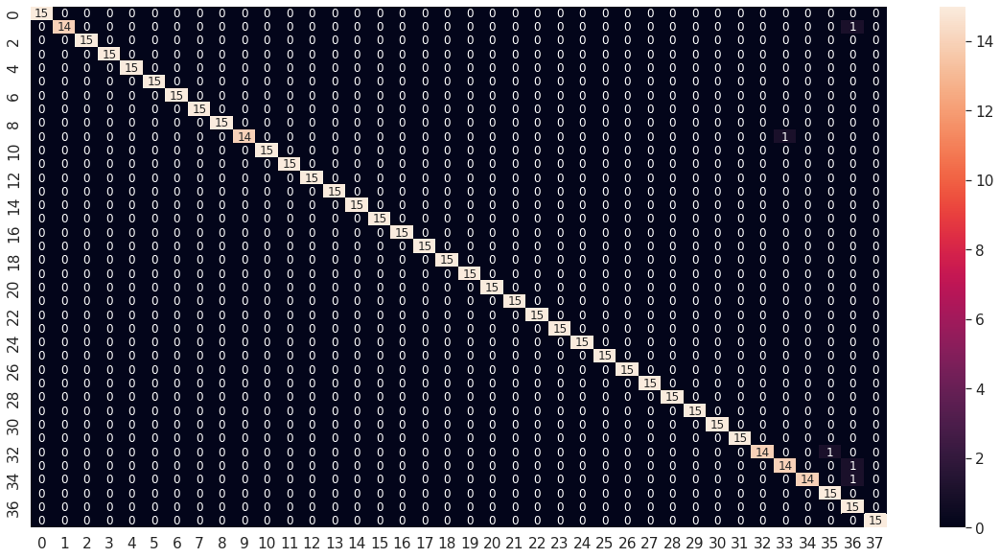

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale12_df_CM = pd.DataFrame(facenet_model_yale12_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale12_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 13: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale13 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale13 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale13)
facenet_model_yale13 = keras.Model(facenet_model.get_layer('input_4').get_output_at(node_index=0), facenet_model_yale13)
facenet_model_yale13.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_4[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/ facenet_model_yale13.h5', monitor="val_loss", save_best_only=True)
hist_model_yale13 = facenet_model_yale13.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 22s 260ms/step - loss: 5.6239 - accuracy: 0.0488 - val_loss: 4.5110 - val_accuracy: 0.0298
Epoch 2/50
50/50 [==============================] - 9s 172ms/step - loss: 5.0654 - accuracy: 0.0461 - val_loss: 441.2949 - val_accuracy: 0.0163
Epoch 3/50
50/50 [==============================] - 9s 172ms/step - loss: 5.0597 - accuracy: 0.0536 - val_loss: 4.6234 - val_accuracy: 0.0217
Epoch 4/50
50/50 [==============================] - 9s 173ms/step - loss: 4.9487 - accuracy: 0.0481 - val_loss: 3254.1294 - val_accuracy: 0.0542
Epoch 5/50
50/50 [==============================] - 8s 170ms/step - loss: 4.8046 - accuracy: 0.0468 - val_loss: 156.1310 - val_accuracy: 0.0325
Epoch 6/50
50/50 [==============================] - 8s 168ms/step - loss: 4.5587 - accuracy: 0.0508 - val_loss: 4.5205 - val_accuracy: 0.0298
Epoch 7/50
50/50 [==============================] - 15s 296ms/step - loss: 4.3662 - accuracy: 0.0631 - val_loss: 4.4308 - val_accuracy: 0.02

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale13 = load_model(path + 'data_reconocimiento1/ facenet_model_yale13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale13.evaluate(testX, testY)

18/18 [==============================] - 1s 56ms/step - loss: 0.3780 - accuracy: 0.9877


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

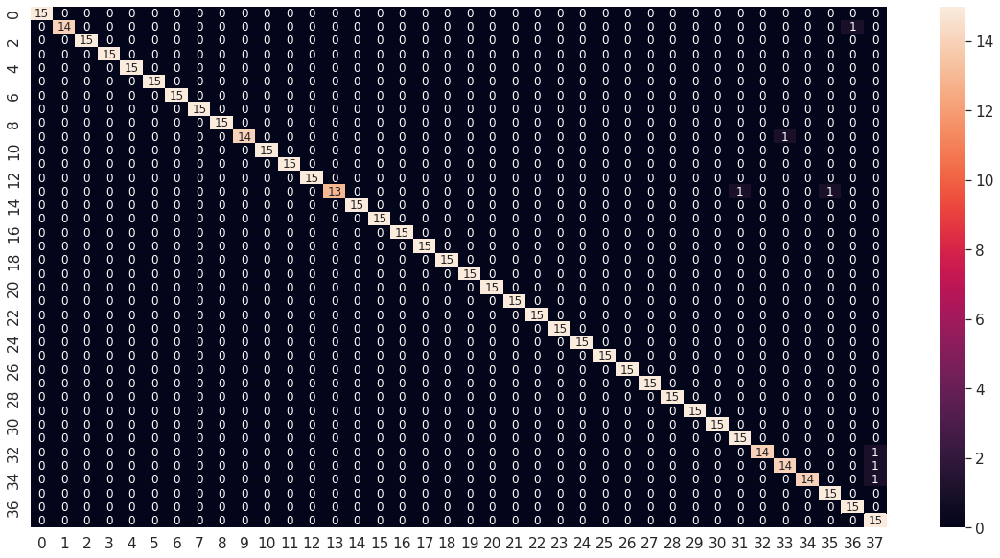

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale13_df_CM = pd.DataFrame(facenet_model_yale13_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale13_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      0.87      0.93        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 14: (BTH = 30, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.4, REG = L2, OPT = adamax[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale14 = Dropout(rate=0.4, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale14 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale14)
facenet_model_yale14 = keras.Model(facenet_model.get_layer('input_5').get_output_at(node_index=0), facenet_model_yale14)
facenet_model_yale14.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_5[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_yale14.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale14.h5', monitor="val_loss", save_best_only=True)
hist_model_yale14 = facenet_model_yale14.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 23s 273ms/step - loss: 4.9052 - accuracy: 0.0739 - val_loss: 4.7385 - val_accuracy: 0.0190
Epoch 2/50
50/50 [==============================] - 8s 166ms/step - loss: 3.5187 - accuracy: 0.2576 - val_loss: 4.9659 - val_accuracy: 0.0271
Epoch 3/50
50/50 [==============================] - 8s 166ms/step - loss: 2.2146 - accuracy: 0.5986 - val_loss: 5.1831 - val_accuracy: 0.0217
Epoch 4/50
50/50 [==============================] - 8s 166ms/step - loss: 1.4825 - accuracy: 0.8047 - val_loss: 5.3164 - val_accuracy: 0.0217
Epoch 5/50
50/50 [==============================] - 8s 166ms/step - loss: 1.1172 - accuracy: 0.9105 - val_loss: 5.1129 - val_accuracy: 0.0271
Epoch 6/50
50/50 [==============================] - 8s 167ms/step - loss: 0.9876 - accuracy: 0.9492 - val_loss: 5.2684 - val_accuracy: 0.0217
Epoch 7/50
50/50 [==============================] - 8s 167ms/step - loss: 0.8750 - accuracy: 0.9675 - val_loss: 5.0861 - val_accuracy: 0.0434
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale14 = load_model(path + 'data_reconocimiento1/facenet_model_yale14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale14.evaluate(testX, testY)

18/18 [==============================] - 1s 55ms/step - loss: 0.4127 - accuracy: 0.9825


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

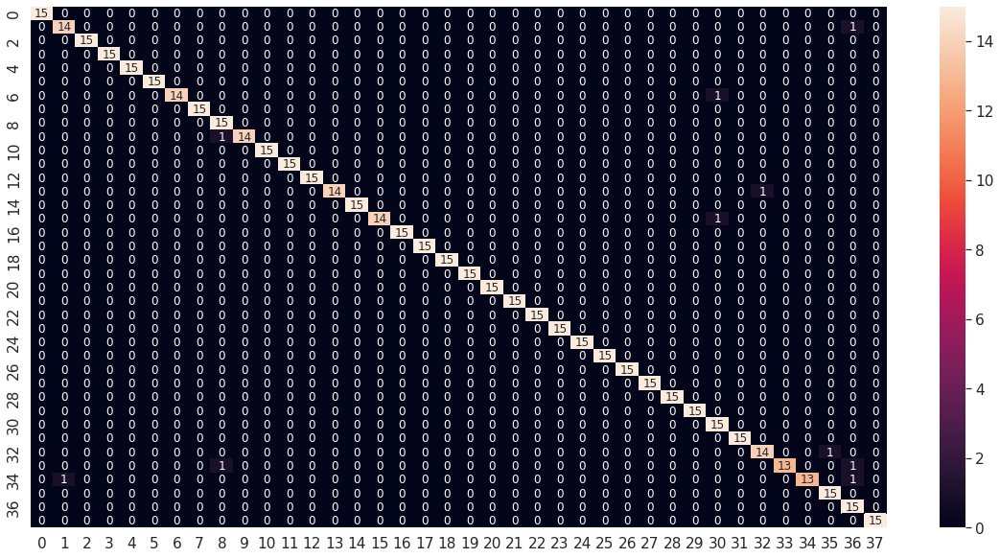

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale14_df_CM = pd.DataFrame(facenet_model_yale14_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale14_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       0.93      0.93      0.93        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      0.93      0.97        15
           8       1.00      1.00      1.00        15
           9       0.88      1.00      0.94        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      0.93      0.97        15
          16       1.00      1.00      1.00        15
          17       1.00      0.93      0.97        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 15: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0.4, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale15 = Dropout(rate=0.4, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale15 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale15)
facenet_model_yale15 = keras.Model(facenet_model.get_layer('input_6').get_output_at(node_index=0), facenet_model_yale15)
facenet_model_yale15.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_6[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale15.h5', monitor="val_loss", save_best_only=True)
hist_model_yale15 = facenet_model_yale15.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 22s 171ms/step - loss: 4.8733 - accuracy: 0.0495 - val_loss: 4.6672 - val_accuracy: 0.0190
Epoch 2/60
74/74 [==============================] - 9s 121ms/step - loss: 3.9810 - accuracy: 0.1634 - val_loss: 4.7016 - val_accuracy: 0.0217
Epoch 3/60
74/74 [==============================] - 9s 123ms/step - loss: 2.3558 - accuracy: 0.5003 - val_loss: 5.7263 - val_accuracy: 0.0190
Epoch 4/60
74/74 [==============================] - 9s 124ms/step - loss: 1.0382 - accuracy: 0.8854 - val_loss: 4.9834 - val_accuracy: 0.0379
Epoch 5/60
74/74 [==============================] - 9s 125ms/step - loss: 0.7068 - accuracy: 0.9681 - val_loss: 4.7866 - val_accuracy: 0.0298
Epoch 6/60
74/74 [==============================] - 9s 125ms/step - loss: 0.5810 - accuracy: 0.9925 - val_loss: 5.4163 - val_accuracy: 0.0244
Epoch 7/60
74/74 [==============================] - 9s 122ms/step - loss: 0.5064 - accuracy: 0.9973 - val_loss: 5.9798 - val_accuracy: 0.0271
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale15 = load_model(path + 'data_reconocimiento1/facenet_model_yale15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale15.evaluate(testX, testY)

18/18 [==============================] - 1s 49ms/step - loss: 0.2260 - accuracy: 0.9930


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

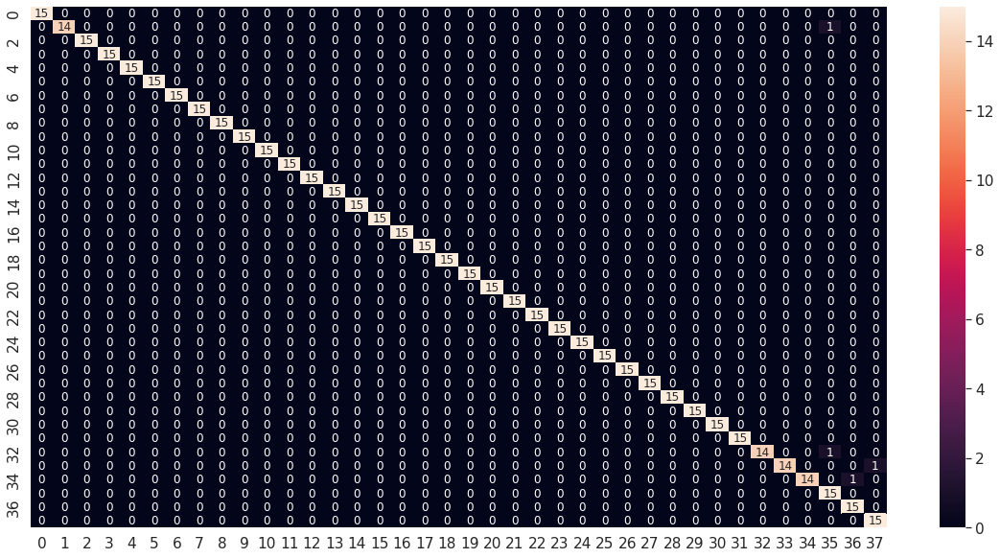

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale15_df_CM = pd.DataFrame(facenet_model_yale15_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale15_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      1.00      1.00        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 16: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.4, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale16 = Dropout(rate=0.4, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale16 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale16)
facenet_model_yale16 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_yale16)
facenet_model_yale16.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale16.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale16.h5', monitor="val_loss", save_best_only=True)
hist_model_yale16 = facenet_model_yale16.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 21s 190ms/step - loss: 4.9039 - accuracy: 0.0597 - val_loss: 4.6346 - val_accuracy: 0.0108
Epoch 2/50
50/50 [==============================] - 7s 143ms/step - loss: 4.0520 - accuracy: 0.1485 - val_loss: 4.5764 - val_accuracy: 0.0244
Epoch 3/50
50/50 [==============================] - 5s 106ms/step - loss: 2.8137 - accuracy: 0.4190 - val_loss: 5.2332 - val_accuracy: 0.0244
Epoch 4/50
50/50 [==============================] - 5s 107ms/step - loss: 1.7369 - accuracy: 0.6746 - val_loss: 4.7306 - val_accuracy: 0.0244
Epoch 5/50
50/50 [==============================] - 5s 107ms/step - loss: 0.8987 - accuracy: 0.9261 - val_loss: 4.6864 - val_accuracy: 0.0352
Epoch 6/50
50/50 [==============================] - 5s 106ms/step - loss: 0.6834 - accuracy: 0.9878 - val_loss: 5.1697 - val_accuracy: 0.0217
Epoch 7/50
50/50 [==============================] - 5s 107ms/step - loss: 0.5851 - accuracy: 0.9959 - val_loss: 5.0325 - val_accuracy: 0.0217
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale16 = load_model(path + 'data_reconocimiento1/facenet_model_yale16.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale16.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale16.evaluate(testX, testY)

18/18 [==============================] - 1s 42ms/step - loss: 0.2333 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale16.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale16_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

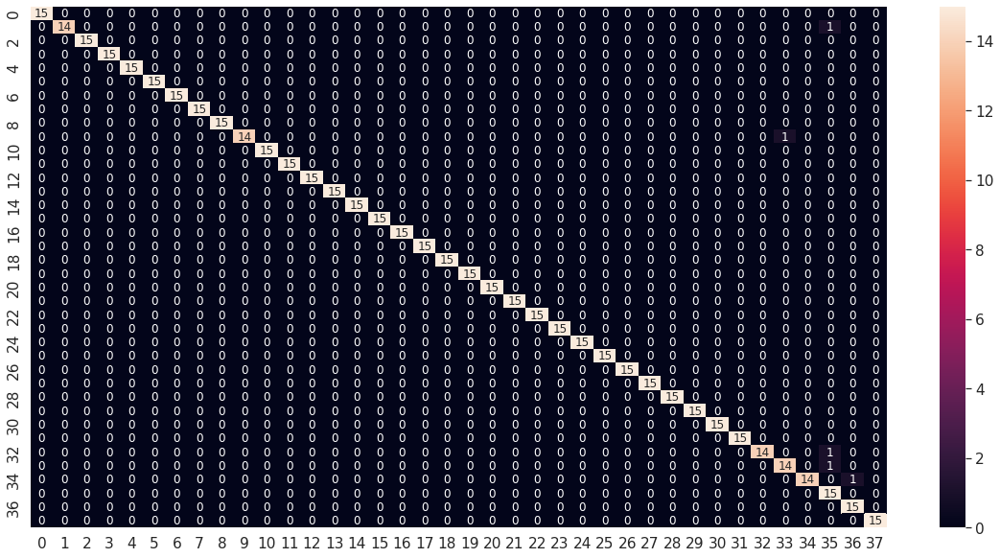

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale16_df_CM = pd.DataFrame(facenet_model_yale16_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale16_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale16_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale16_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 17: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0.3, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale17 = Dropout(rate=0.3, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale17 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale17)
facenet_model_yale17 = keras.Model(facenet_model.get_layer('input_2').get_output_at(node_index=0), facenet_model_yale17)
facenet_model_yale17.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_2[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_yale17.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale17.h5', monitor="val_loss", save_best_only=True)
hist_model_yale17 = facenet_model_yale17.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
50/50 [==============================] - 19s 183ms/step - loss: 4.6301 - accuracy: 0.0854 - val_loss: 4.7444 - val_accuracy: 0.0271
Epoch 2/50
50/50 [==============================] - 5s 109ms/step - loss: 3.0488 - accuracy: 0.3905 - val_loss: 4.9012 - val_accuracy: 0.0352
Epoch 3/50
50/50 [==============================] - 5s 109ms/step - loss: 1.7277 - accuracy: 0.7519 - val_loss: 4.9054 - val_accuracy: 0.0217
Epoch 4/50
50/50 [==============================] - 5s 109ms/step - loss: 1.2002 - accuracy: 0.9003 - val_loss: 5.0366 - val_accuracy: 0.0244
Epoch 5/50
50/50 [==============================] - 5s 109ms/step - loss: 0.9375 - accuracy: 0.9566 - val_loss: 5.1915 - val_accuracy: 0.0136
Epoch 6/50
50/50 [==============================] - 5s 108ms/step - loss: 0.8105 - accuracy: 0.9851 - val_loss: 5.3332 - val_accuracy: 0.0298
Epoch 7/50
50/50 [==============================] - 5s 109ms/step - loss: 0.7684 - accuracy: 0.9878 - val_loss: 5.2258 - val_accuracy: 0.0298
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale17 = load_model(path + 'data_reconocimiento1/facenet_model_yale17.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale17.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale17.evaluate(testX, testY)

18/18 [==============================] - 1s 40ms/step - loss: 0.3095 - accuracy: 0.9912


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale17.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale17_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

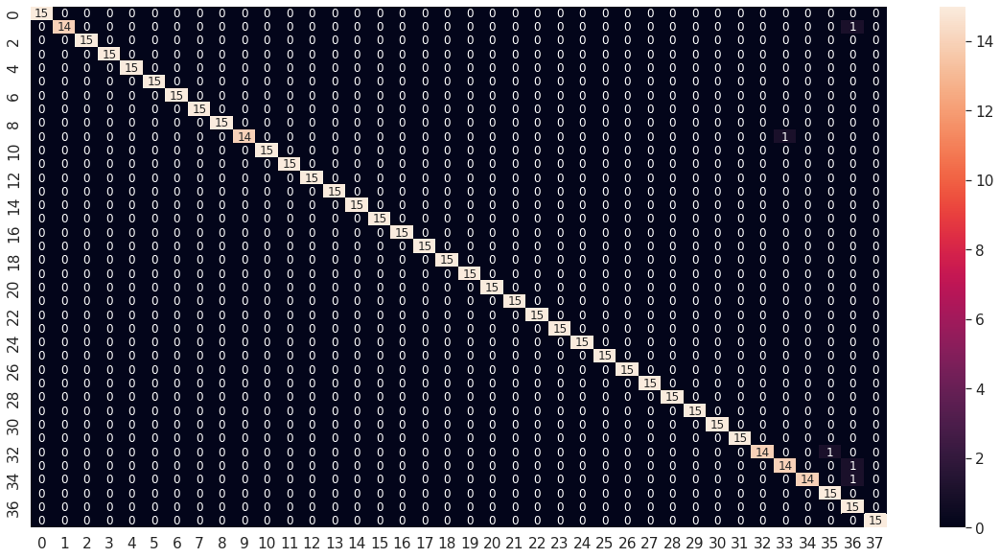

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale17_df_CM = pd.DataFrame(facenet_model_yale17_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale17_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale17_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale17_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        15
           2       1.00      0.93      0.97        15
           3       1.00      1.00      1.00        15
           4       1.00      1.00      1.00        15
           5       1.00      1.00      1.00        15
           6       1.00      1.00      1.00        15
           7       1.00      1.00      1.00        15
           8       1.00      1.00      1.00        15
           9       1.00      1.00      1.00        15
          10       1.00      0.93      0.97        15
          11       1.00      1.00      1.00        15
          12       1.00      1.00      1.00        15
          13       1.00      1.00      1.00        15
          15       1.00      1.00      1.00        15
          16       1.00      1.00      1.00        15
          17       1.00      1.00      1.00        15
          18       1.00      1.00      1.00        15
          19       1.00    

#### Modelo 18: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout=0.3, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_yale18 = Dropout(rate=0.3, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_yale18 = Dense(40, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_yale18)
facenet_model_yale18 = keras.Model(facenet_model.get_layer('input_3').get_output_at(node_index=0), facenet_model_yale18)
facenet_model_yale18.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_3[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_yale18.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/facenet_model_yale18.h5', monitor="val_loss", save_best_only=True)
hist_model_yale18 = facenet_model_yale18.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
74/74 [==============================] - 20s 141ms/step - loss: 4.5889 - accuracy: 0.0786 - val_loss: 4.7558 - val_accuracy: 0.0190
Epoch 2/60
74/74 [==============================] - 8s 111ms/step - loss: 3.3113 - accuracy: 0.3037 - val_loss: 4.7400 - val_accuracy: 0.0163
Epoch 3/60
74/74 [==============================] - 6s 86ms/step - loss: 1.5985 - accuracy: 0.7342 - val_loss: 5.1377 - val_accuracy: 0.0136
Epoch 4/60
74/74 [==============================] - 6s 86ms/step - loss: 0.8296 - accuracy: 0.9593 - val_loss: 5.6054 - val_accuracy: 0.0244
Epoch 5/60
74/74 [==============================] - 6s 86ms/step - loss: 0.6243 - accuracy: 0.9905 - val_loss: 5.3289 - val_accuracy: 0.0271
Epoch 6/60
74/74 [==============================] - 6s 85ms/step - loss: 0.5364 - accuracy: 0.9966 - val_loss: 5.5896 - val_accuracy: 0.0271
Epoch 7/60
74/74 [==============================] - 6s 86ms/step - loss: 0.4957 - accuracy: 0.9953 - val_loss: 4.9474 - val_accuracy: 0.0623
Epoch 8/60

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_yale18 = load_model(path + 'data_reconocimiento1/facenet_model_yale18.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_yale18.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_yale18.evaluate(testX, testY)

18/18 [==============================] - 1s 79ms/step - loss: 0.6134 - accuracy: 0.8737


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_yale18.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_yale18_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

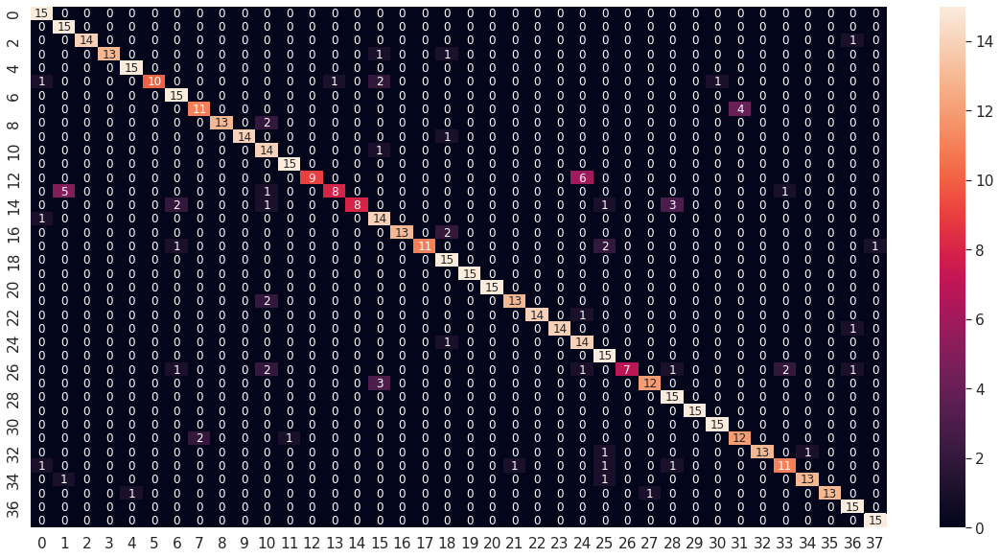

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_yale18_df_CM = pd.DataFrame(facenet_model_yale18_CM, range(38), range(38))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_yale18_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_yale18_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_yale18_report)

              precision    recall  f1-score   support

           1       0.83      1.00      0.91        15
           2       0.71      1.00      0.83        15
           3       1.00      0.93      0.97        15
           4       1.00      0.87      0.93        15
           5       0.94      1.00      0.97        15
           6       1.00      0.67      0.80        15
           7       0.79      1.00      0.88        15
           8       0.85      0.73      0.79        15
           9       1.00      0.87      0.93        15
          10       1.00      0.93      0.97        15
          11       0.64      0.93      0.76        15
          12       0.94      1.00      0.97        15
          13       1.00      0.60      0.75        15
          15       0.89      0.53      0.67        15
          16       1.00      0.53      0.70        15
          17       0.67      0.93      0.78        15
          18       1.00      0.87      0.93        15
          19       1.00    

## 5. Modelos con base de datos ROF 1 para condiciones de oclusion

#### Modelo 1: (BTH = 30, EHS = 30, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_1 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_1)
facenet_model_oclu1_1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_1)
facenet_model_oclu1_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_1.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_1 = facenet_model_oclu1_1.fit(new_trainX, new_trainY, batch_size=30, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
27/27 [==============================] - 27s 235ms/step - loss: 2.5548 - accuracy: 0.2812 - val_loss: 2.8505 - val_accuracy: 0.1450
Epoch 2/30
27/27 [==============================] - 2s 70ms/step - loss: 1.8216 - accuracy: 0.4800 - val_loss: 3.1795 - val_accuracy: 0.1450
Epoch 3/30
27/27 [==============================] - 2s 69ms/step - loss: 1.3372 - accuracy: 0.6300 - val_loss: 3.4991 - val_accuracy: 0.0900
Epoch 4/30
27/27 [==============================] - 2s 71ms/step - loss: 1.0189 - accuracy: 0.7425 - val_loss: 3.4168 - val_accuracy: 0.1000
Epoch 5/30
27/27 [==============================] - 2s 70ms/step - loss: 0.8379 - accuracy: 0.7987 - val_loss: 3.0888 - val_accuracy: 0.1000
Epoch 6/30
27/27 [==============================] - 2s 71ms/step - loss: 0.6040 - accuracy: 0.8650 - val_loss: 4.8779 - val_accuracy: 0.0900
Epoch 7/30
27/27 [==============================] - 2s 78ms/step - loss: 0.4081 - accuracy: 0.9212 - val_loss: 4.0851 - val_accuracy: 0.0900
Epoch 8/30


In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_1 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_1.evaluate(testX, testY)

7/7 [==============================] - 0s 23ms/step - loss: 1.6496 - accuracy: 0.4300


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 21ms/step


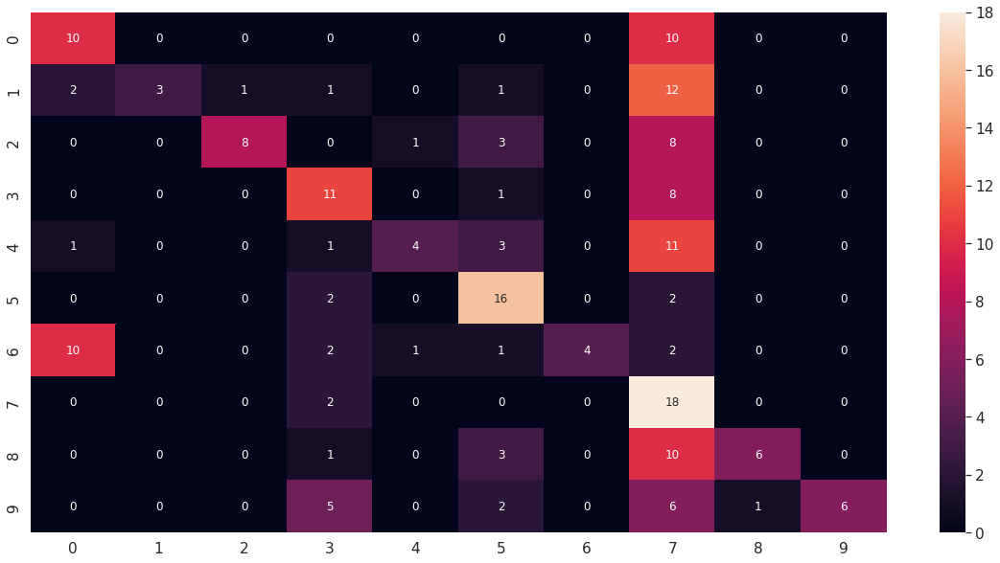

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_1_df_CM = pd.DataFrame(facenet_model_oclu1_1_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_1_report)

              precision    recall  f1-score   support

           1       0.43      0.50      0.47        20
           2       1.00      0.15      0.26        20
           3       0.89      0.40      0.55        20
           4       0.44      0.55      0.49        20
           5       0.67      0.20      0.31        20
           6       0.53      0.80      0.64        20
           7       1.00      0.20      0.33        20
           8       0.21      0.90      0.34        20
           9       0.86      0.30      0.44        20
          10       1.00      0.30      0.46        20

    accuracy                           0.43       200
   macro avg       0.70      0.43      0.43       200
weighted avg       0.70      0.43      0.43       200



#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_2 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_2 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_2)
facenet_model_oclu1_2 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_2)
facenet_model_oclu1_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_2.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_2 = facenet_model_oclu1_2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
27/27 [==============================] - 16s 232ms/step - loss: 0.6685 - accuracy: 0.8687 - val_loss: 6.8631 - val_accuracy: 0.2050
Epoch 2/80
27/27 [==============================] - 2s 72ms/step - loss: 0.4709 - accuracy: 0.9212 - val_loss: 8.1224 - val_accuracy: 0.2600
Epoch 3/80
27/27 [==============================] - 4s 146ms/step - loss: 0.3933 - accuracy: 0.9425 - val_loss: 3.4443 - val_accuracy: 0.4550
Epoch 4/80
27/27 [==============================] - 2s 75ms/step - loss: 0.2765 - accuracy: 0.9812 - val_loss: 6.4963 - val_accuracy: 0.3500
Epoch 5/80
27/27 [==============================] - 4s 146ms/step - loss: 0.2364 - accuracy: 0.9800 - val_loss: 3.0913 - val_accuracy: 0.5400
Epoch 6/80
27/27 [==============================] - 4s 146ms/step - loss: 0.2044 - accuracy: 0.9887 - val_loss: 2.7882 - val_accuracy: 0.5800
Epoch 7/80
27/27 [==============================] - 4s 146ms/step - loss: 0.1803 - accuracy: 0.9962 - val_loss: 1.0573 - val_accuracy: 0.7900
Epoch 8

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_2 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_2.evaluate(testX, testY)

7/7 [==============================] - 0s 25ms/step - loss: 0.4259 - accuracy: 0.8500


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 23ms/step


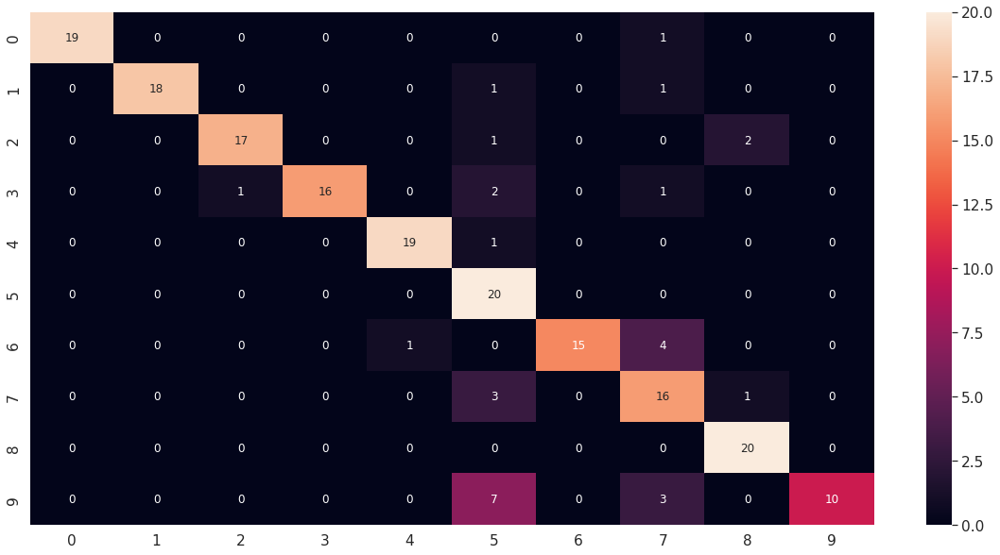

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_2_df_CM = pd.DataFrame(facenet_model_oclu1_2_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_2_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       1.00      0.90      0.95        20
           3       0.94      0.85      0.89        20
           4       1.00      0.80      0.89        20
           5       0.95      0.95      0.95        20
           6       0.57      1.00      0.73        20
           7       1.00      0.75      0.86        20
           8       0.62      0.80      0.70        20
           9       0.87      1.00      0.93        20
          10       1.00      0.50      0.67        20

    accuracy                           0.85       200
   macro avg       0.90      0.85      0.85       200
weighted avg       0.90      0.85      0.85       200



#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_3 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_3 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_3)
facenet_model_oclu1_3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_3)
facenet_model_oclu1_3.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_3.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_3 = facenet_model_oclu1_3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
27/27 [==============================] - 16s 219ms/step - loss: 0.5462 - accuracy: 0.9200 - val_loss: 2.6763 - val_accuracy: 0.5150
Epoch 2/50
27/27 [==============================] - 2s 71ms/step - loss: 0.3775 - accuracy: 0.9438 - val_loss: 5.3431 - val_accuracy: 0.3350
Epoch 3/50
27/27 [==============================] - 2s 71ms/step - loss: 0.3041 - accuracy: 0.9688 - val_loss: 3.7224 - val_accuracy: 0.4700
Epoch 4/50
27/27 [==============================] - 2s 71ms/step - loss: 0.2618 - accuracy: 0.9850 - val_loss: 3.0256 - val_accuracy: 0.5800
Epoch 5/50
27/27 [==============================] - 4s 145ms/step - loss: 0.2004 - accuracy: 0.9962 - val_loss: 1.6468 - val_accuracy: 0.6500
Epoch 6/50
27/27 [==============================] - 2s 73ms/step - loss: 0.1992 - accuracy: 0.9925 - val_loss: 1.7204 - val_accuracy: 0.6800
Epoch 7/50
27/27 [==============================] - 4s 144ms/step - loss: 0.1816 - accuracy: 0.9937 - val_loss: 0.8370 - val_accuracy: 0.8200
Epoch 8/5

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_3 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_3.evaluate(testX, testY)

7/7 [==============================] - 0s 22ms/step - loss: 0.4429 - accuracy: 0.8750


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 21ms/step


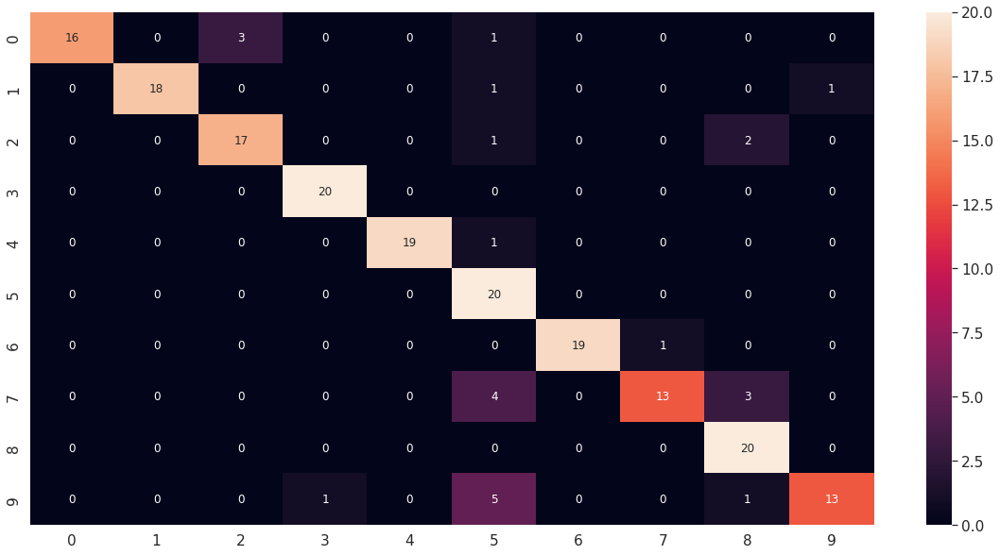

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_3_df_CM = pd.DataFrame(facenet_model_oclu1_3_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_3_report)

              precision    recall  f1-score   support

           1       1.00      0.80      0.89        20
           2       1.00      0.90      0.95        20
           3       0.85      0.85      0.85        20
           4       0.95      1.00      0.98        20
           5       1.00      0.95      0.97        20
           6       0.61      1.00      0.75        20
           7       1.00      0.95      0.97        20
           8       0.93      0.65      0.76        20
           9       0.77      1.00      0.87        20
          10       0.93      0.65      0.76        20

    accuracy                           0.88       200
   macro avg       0.90      0.88      0.88       200
weighted avg       0.90      0.88      0.88       200



#### Modelo 4: (BTH = 20, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.5 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_4 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_4 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_4)
facenet_model_oclu1_4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_4)
facenet_model_oclu1_4.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_4.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_4 = facenet_model_oclu1_4.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
40/40 [==============================] - 16s 156ms/step - loss: 0.8092 - accuracy: 0.8388 - val_loss: 4.3099 - val_accuracy: 0.5250
Epoch 2/30
40/40 [==============================] - 3s 65ms/step - loss: 0.4365 - accuracy: 0.9400 - val_loss: 6.5338 - val_accuracy: 0.3400
Epoch 3/30
40/40 [==============================] - 3s 63ms/step - loss: 0.3745 - accuracy: 0.9450 - val_loss: 7.5490 - val_accuracy: 0.3400
Epoch 4/30
40/40 [==============================] - 4s 110ms/step - loss: 0.3307 - accuracy: 0.9613 - val_loss: 1.8316 - val_accuracy: 0.6950
Epoch 5/30
40/40 [==============================] - 4s 110ms/step - loss: 0.2548 - accuracy: 0.9775 - val_loss: 1.0090 - val_accuracy: 0.7750
Epoch 6/30
40/40 [==============================] - 4s 111ms/step - loss: 0.2025 - accuracy: 0.9912 - val_loss: 0.6448 - val_accuracy: 0.8650
Epoch 7/30
40/40 [==============================] - 3s 64ms/step - loss: 0.1802 - accuracy: 0.9962 - val_loss: 1.0679 - val_accuracy: 0.8000
Epoch 8/

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_4 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_4.evaluate(testX, testY)

7/7 [==============================] - 0s 46ms/step - loss: 2.7300 - accuracy: 0.3250


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 60ms/step


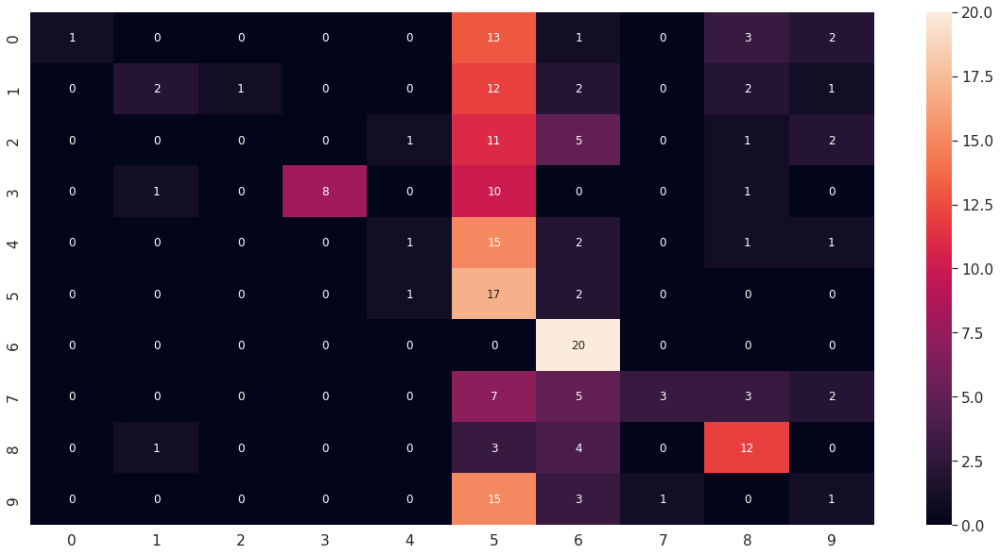

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_4_df_CM = pd.DataFrame(facenet_model_oclu1_4_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_4_report)

              precision    recall  f1-score   support

           1       1.00      0.05      0.10        20
           2       0.50      0.10      0.17        20
           3       0.00      0.00      0.00        20
           4       1.00      0.40      0.57        20
           5       0.33      0.05      0.09        20
           6       0.17      0.85      0.28        20
           7       0.45      1.00      0.62        20
           8       0.75      0.15      0.25        20
           9       0.52      0.60      0.56        20
          10       0.11      0.05      0.07        20

    accuracy                           0.33       200
   macro avg       0.48      0.32      0.27       200
weighted avg       0.48      0.33      0.27       200



#### Modelo 5: (BTH = 20, EHS = 60, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.5, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_5 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_5)
facenet_model_oclu1_5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_5)
facenet_model_oclu1_5.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_5.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_5 = facenet_model_oclu1_5.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
40/40 [==============================] - 28s 227ms/step - loss: 3.1304 - accuracy: 0.2113 - val_loss: 2.7964 - val_accuracy: 0.1150
Epoch 2/60
40/40 [==============================] - 5s 125ms/step - loss: 2.4035 - accuracy: 0.3400 - val_loss: 3.3472 - val_accuracy: 0.0900
Epoch 3/60
40/40 [==============================] - 5s 114ms/step - loss: 2.1252 - accuracy: 0.4050 - val_loss: 4.9317 - val_accuracy: 0.0900
Epoch 4/60
40/40 [==============================] - 5s 123ms/step - loss: 1.8809 - accuracy: 0.4675 - val_loss: 6.0613 - val_accuracy: 0.0900
Epoch 5/60
40/40 [==============================] - 5s 115ms/step - loss: 1.5666 - accuracy: 0.5625 - val_loss: 10.7534 - val_accuracy: 0.0900
Epoch 6/60
40/40 [==============================] - 5s 115ms/step - loss: 1.1734 - accuracy: 0.6775 - val_loss: 12.3944 - val_accuracy: 0.0900
Epoch 7/60
40/40 [==============================] - 5s 114ms/step - loss: 0.9494 - accuracy: 0.7638 - val_loss: 5.4583 - val_accuracy: 0.0900
Epo

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_5 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_5.evaluate(testX, testY)

7/7 [==============================] - 0s 47ms/step - loss: 0.7950 - accuracy: 0.8150


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 59ms/step


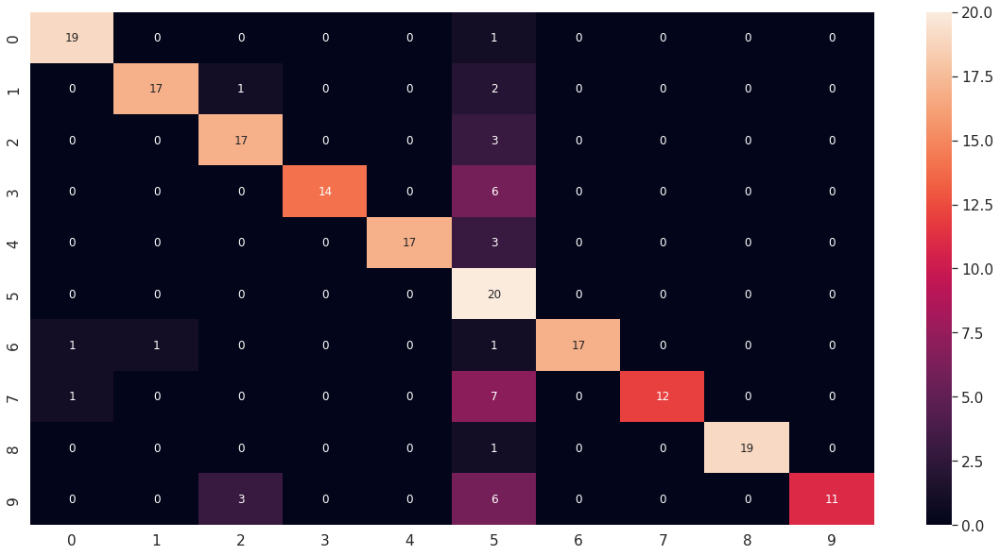

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_5_df_CM = pd.DataFrame(facenet_model_oclu1_5_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_5_report)

              precision    recall  f1-score   support

           1       0.90      0.95      0.93        20
           2       0.94      0.85      0.89        20
           3       0.81      0.85      0.83        20
           4       1.00      0.70      0.82        20
           5       1.00      0.85      0.92        20
           6       0.40      1.00      0.57        20
           7       1.00      0.85      0.92        20
           8       1.00      0.60      0.75        20
           9       1.00      0.95      0.97        20
          10       1.00      0.55      0.71        20

    accuracy                           0.81       200
   macro avg       0.91      0.82      0.83       200
weighted avg       0.91      0.81      0.83       200



#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_6 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_6 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_6)
facenet_model_oclu1_6 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_6)
facenet_model_oclu1_6.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_6.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_6 = facenet_model_oclu1_6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
20/20 [==============================] - 20s 401ms/step - loss: 0.6951 - accuracy: 0.8600 - val_loss: 2.8846 - val_accuracy: 0.5000
Epoch 2/60
20/20 [==============================] - 4s 191ms/step - loss: 0.3034 - accuracy: 0.9762 - val_loss: 4.4489 - val_accuracy: 0.4700
Epoch 3/60
20/20 [==============================] - 4s 192ms/step - loss: 0.2812 - accuracy: 0.9787 - val_loss: 5.6163 - val_accuracy: 0.4450
Epoch 4/60
20/20 [==============================] - 4s 194ms/step - loss: 0.2458 - accuracy: 0.9850 - val_loss: 5.8466 - val_accuracy: 0.4700
Epoch 5/60
20/20 [==============================] - 8s 411ms/step - loss: 0.2090 - accuracy: 0.9950 - val_loss: 2.6525 - val_accuracy: 0.5800
Epoch 6/60
20/20 [==============================] - 4s 196ms/step - loss: 0.2046 - accuracy: 0.9912 - val_loss: 3.8565 - val_accuracy: 0.4900
Epoch 7/60
20/20 [==============================] - 4s 193ms/step - loss: 0.2163 - accuracy: 0.9887 - val_loss: 3.3962 - val_accuracy: 0.5350
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_6 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_6.evaluate(testX, testY)

7/7 [==============================] - 0s 48ms/step - loss: 0.6762 - accuracy: 0.8150


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 46ms/step


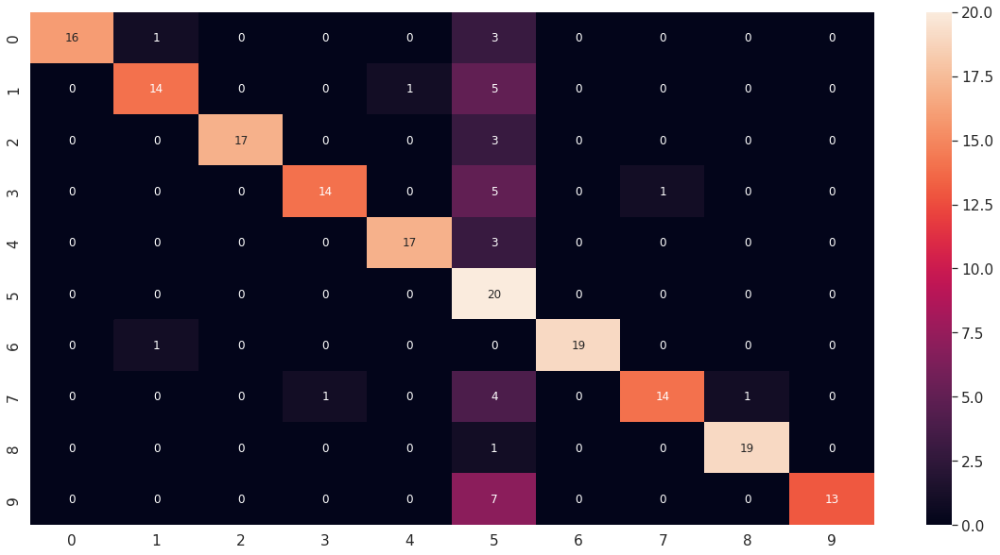

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_6_df_CM = pd.DataFrame(facenet_model_oclu1_6_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_6_report)

              precision    recall  f1-score   support

           1       1.00      0.80      0.89        20
           2       0.88      0.70      0.78        20
           3       1.00      0.85      0.92        20
           4       0.93      0.70      0.80        20
           5       0.94      0.85      0.89        20
           6       0.39      1.00      0.56        20
           7       1.00      0.95      0.97        20
           8       0.93      0.70      0.80        20
           9       0.95      0.95      0.95        20
          10       1.00      0.65      0.79        20

    accuracy                           0.81       200
   macro avg       0.90      0.82      0.84       200
weighted avg       0.90      0.81      0.84       200



#### Modelo 7: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_7 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_7 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_7)
facenet_model_oclu1_7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_7)
facenet_model_oclu1_7.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_7.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_7 = facenet_model_oclu1_7.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
27/27 [==============================] - 18s 277ms/step - loss: 0.6068 - accuracy: 0.8938 - val_loss: 3.4647 - val_accuracy: 0.5050
Epoch 2/50
27/27 [==============================] - 4s 148ms/step - loss: 0.3058 - accuracy: 0.9762 - val_loss: 8.0033 - val_accuracy: 0.2450
Epoch 3/50
27/27 [==============================] - 6s 218ms/step - loss: 0.3079 - accuracy: 0.9725 - val_loss: 3.3186 - val_accuracy: 0.4500
Epoch 4/50
27/27 [==============================] - 6s 217ms/step - loss: 0.2872 - accuracy: 0.9762 - val_loss: 2.1590 - val_accuracy: 0.5950
Epoch 5/50
27/27 [==============================] - 4s 149ms/step - loss: 0.2553 - accuracy: 0.9800 - val_loss: 2.3515 - val_accuracy: 0.4900
Epoch 6/50
27/27 [==============================] - 6s 232ms/step - loss: 0.2267 - accuracy: 0.9900 - val_loss: 1.4925 - val_accuracy: 0.6300
Epoch 7/50
27/27 [==============================] - 4s 153ms/step - loss: 0.2165 - accuracy: 0.9862 - val_loss: 4.3291 - val_accuracy: 0.3250
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_7 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_7.evaluate(testX, testY)

7/7 [==============================] - 0s 51ms/step - loss: 0.7681 - accuracy: 0.7800


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 3s 62ms/step


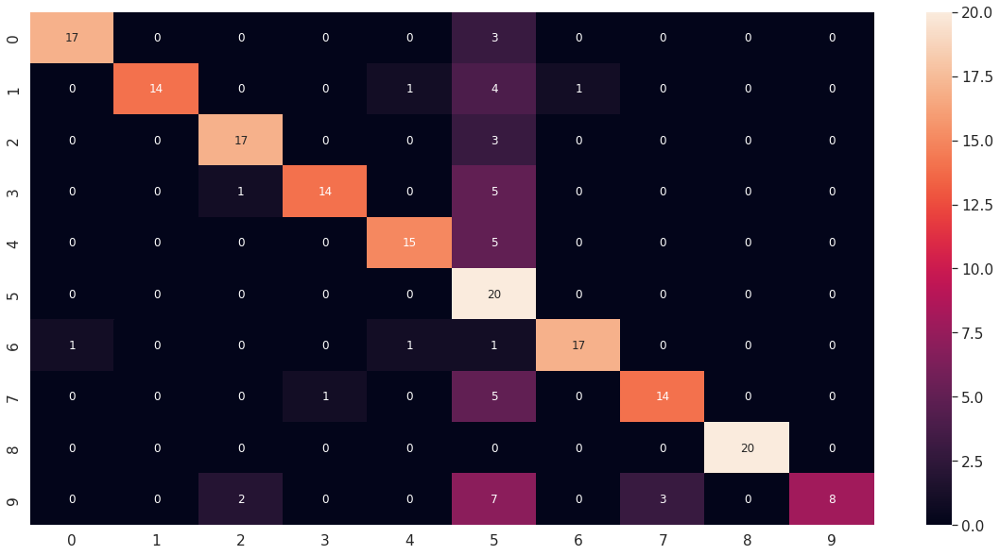

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_7_df_CM = pd.DataFrame(facenet_model_oclu1_7_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_7_report)

              precision    recall  f1-score   support

           1       0.94      0.85      0.89        20
           2       1.00      0.70      0.82        20
           3       0.85      0.85      0.85        20
           4       0.93      0.70      0.80        20
           5       0.88      0.75      0.81        20
           6       0.38      1.00      0.55        20
           7       0.94      0.85      0.89        20
           8       0.82      0.70      0.76        20
           9       1.00      1.00      1.00        20
          10       1.00      0.40      0.57        20

    accuracy                           0.78       200
   macro avg       0.88      0.78      0.79       200
weighted avg       0.88      0.78      0.79       200



#### Modelo 8: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_8 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_8 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_8)
facenet_model_oclu1_8 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_8)
facenet_model_oclu1_8.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu1_8.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_8.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_8 = facenet_model_oclu1_8.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
40/40 [==============================] - 19s 215ms/step - loss: 0.4817 - accuracy: 0.9425 - val_loss: 0.7081 - val_accuracy: 0.8600
Epoch 2/60
40/40 [==============================] - 7s 175ms/step - loss: 0.2278 - accuracy: 1.0000 - val_loss: 0.6437 - val_accuracy: 0.8900
Epoch 3/60
40/40 [==============================] - 7s 174ms/step - loss: 0.2198 - accuracy: 0.9987 - val_loss: 0.6246 - val_accuracy: 0.8850
Epoch 4/60
40/40 [==============================] - 7s 175ms/step - loss: 0.2146 - accuracy: 0.9987 - val_loss: 0.5810 - val_accuracy: 0.8950
Epoch 5/60
40/40 [==============================] - 7s 176ms/step - loss: 0.2112 - accuracy: 0.9987 - val_loss: 0.5667 - val_accuracy: 0.8950
Epoch 6/60
40/40 [==============================] - 7s 170ms/step - loss: 0.2029 - accuracy: 1.0000 - val_loss: 0.5453 - val_accuracy: 0.9000
Epoch 7/60
40/40 [==============================] - 7s 183ms/step - loss: 0.1969 - accuracy: 1.0000 - val_loss: 0.5156 - val_accuracy: 0.9050
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_8 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_8.evaluate(testX, testY)

7/7 [==============================] - 0s 50ms/step - loss: 0.6369 - accuracy: 0.8200


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 3s 66ms/step


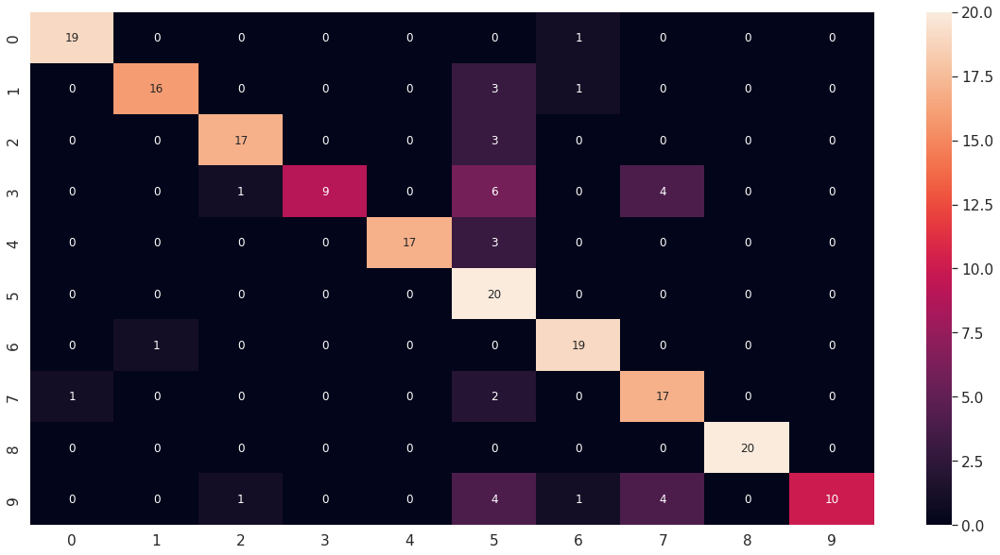

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_8_df_CM = pd.DataFrame(facenet_model_oclu1_8_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_8_report)

              precision    recall  f1-score   support

           1       0.95      0.95      0.95        20
           2       0.94      0.80      0.86        20
           3       0.89      0.85      0.87        20
           4       1.00      0.45      0.62        20
           5       1.00      0.85      0.92        20
           6       0.49      1.00      0.66        20
           7       0.86      0.95      0.90        20
           8       0.68      0.85      0.76        20
           9       1.00      1.00      1.00        20
          10       1.00      0.50      0.67        20

    accuracy                           0.82       200
   macro avg       0.88      0.82      0.82       200
weighted avg       0.88      0.82      0.82       200



#### Modelo 9: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_9 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_9 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_9)
facenet_model_oclu1_9 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_9)
facenet_model_oclu1_9.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_9.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_9 = facenet_model_oclu1_9.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
40/40 [==============================] - 23s 354ms/step - loss: 0.5228 - accuracy: 0.9162 - val_loss: 3.0537 - val_accuracy: 0.5350
Epoch 2/60
40/40 [==============================] - 5s 114ms/step - loss: 0.3363 - accuracy: 0.9600 - val_loss: 3.3376 - val_accuracy: 0.4500
Epoch 3/60
40/40 [==============================] - 7s 165ms/step - loss: 0.2656 - accuracy: 0.9762 - val_loss: 1.6667 - val_accuracy: 0.7000
Epoch 4/60
40/40 [==============================] - 5s 114ms/step - loss: 0.2414 - accuracy: 0.9787 - val_loss: 2.2085 - val_accuracy: 0.6400
Epoch 5/60
40/40 [==============================] - 5s 114ms/step - loss: 0.2511 - accuracy: 0.9750 - val_loss: 2.7240 - val_accuracy: 0.5650
Epoch 6/60
40/40 [==============================] - 5s 115ms/step - loss: 0.2112 - accuracy: 0.9837 - val_loss: 1.7145 - val_accuracy: 0.6400
Epoch 7/60
40/40 [==============================] - 5s 114ms/step - loss: 0.2119 - accuracy: 0.9775 - val_loss: 2.1482 - val_accuracy: 0.6350
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_9 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_9.evaluate(testX, testY)

7/7 [==============================] - 0s 52ms/step - loss: 0.6373 - accuracy: 0.8200


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 3s 62ms/step


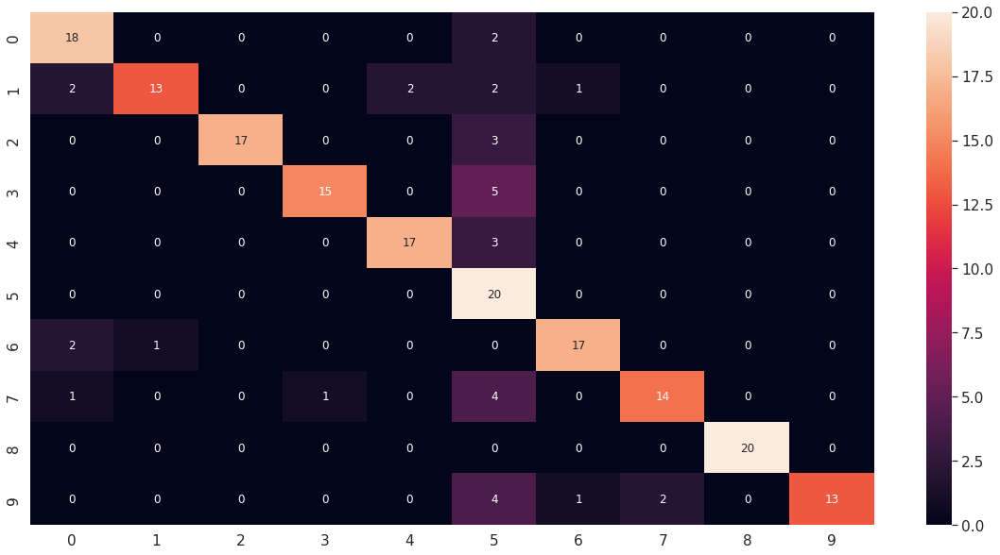

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_9_df_CM = pd.DataFrame(facenet_model_oclu1_9_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_9_report)

              precision    recall  f1-score   support

           1       0.78      0.90      0.84        20
           2       0.93      0.65      0.76        20
           3       1.00      0.85      0.92        20
           4       0.94      0.75      0.83        20
           5       0.89      0.85      0.87        20
           6       0.47      1.00      0.63        20
           7       0.89      0.85      0.87        20
           8       0.88      0.70      0.78        20
           9       1.00      1.00      1.00        20
          10       1.00      0.65      0.79        20

    accuracy                           0.82       200
   macro avg       0.88      0.82      0.83       200
weighted avg       0.88      0.82      0.83       200



#### Modelo 10: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_10 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_10 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_10)
facenet_model_oclu1_10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_10)
facenet_model_oclu1_10.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu1_10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_10.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_10 = facenet_model_oclu1_10.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
27/27 [==============================] - 17s 288ms/step - loss: 0.7432 - accuracy: 0.8788 - val_loss: 0.9134 - val_accuracy: 0.7850
Epoch 2/50
27/27 [==============================] - 6s 220ms/step - loss: 0.2371 - accuracy: 1.0000 - val_loss: 0.6772 - val_accuracy: 0.8850
Epoch 3/50
27/27 [==============================] - 6s 224ms/step - loss: 0.2272 - accuracy: 1.0000 - val_loss: 0.6291 - val_accuracy: 0.9050
Epoch 4/50
27/27 [==============================] - 6s 223ms/step - loss: 0.2215 - accuracy: 1.0000 - val_loss: 0.5919 - val_accuracy: 0.9100
Epoch 5/50
27/27 [==============================] - 6s 233ms/step - loss: 0.2200 - accuracy: 1.0000 - val_loss: 0.5609 - val_accuracy: 0.9200
Epoch 6/50
27/27 [==============================] - 6s 230ms/step - loss: 0.2144 - accuracy: 1.0000 - val_loss: 0.5421 - val_accuracy: 0.9200
Epoch 7/50
27/27 [==============================] - 6s 233ms/step - loss: 0.2117 - accuracy: 1.0000 - val_loss: 0.5347 - val_accuracy: 0.9200
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_10 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_10.evaluate(testX, testY)

7/7 [==============================] - 0s 52ms/step - loss: 0.8581 - accuracy: 0.7850


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 3s 67ms/step


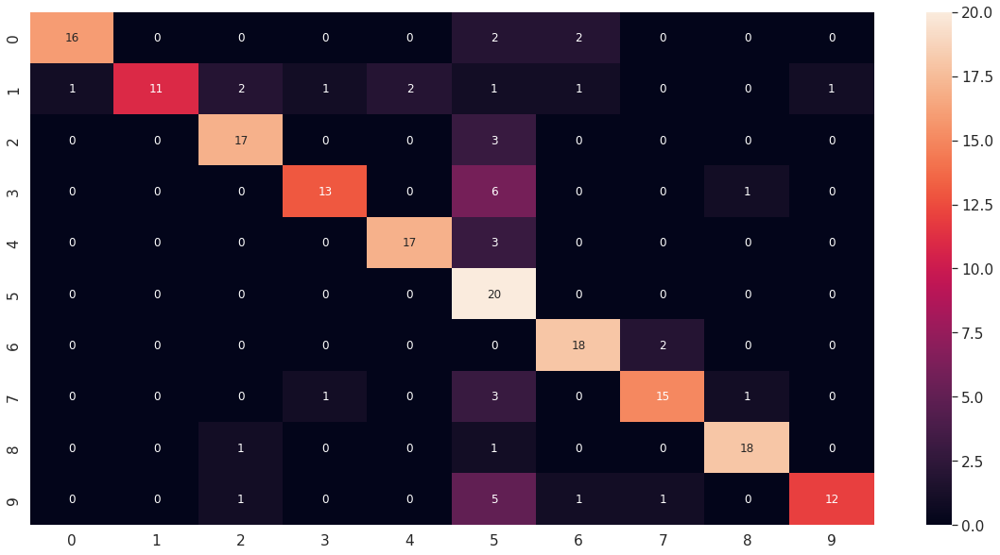

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_10_df_CM = pd.DataFrame(facenet_model_oclu1_10_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_10_report)

              precision    recall  f1-score   support

           1       0.94      0.80      0.86        20
           2       1.00      0.55      0.71        20
           3       0.81      0.85      0.83        20
           4       0.87      0.65      0.74        20
           5       0.89      0.85      0.87        20
           6       0.45      1.00      0.62        20
           7       0.82      0.90      0.86        20
           8       0.83      0.75      0.79        20
           9       0.90      0.90      0.90        20
          10       0.92      0.60      0.73        20

    accuracy                           0.79       200
   macro avg       0.84      0.78      0.79       200
weighted avg       0.84      0.79      0.79       200



#### Modelo 11: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_11 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_11 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_11)
facenet_model_oclu1_11 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_11)
facenet_model_oclu1_11.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu1_11.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_11.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_11 = facenet_model_oclu1_11.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
27/27 [==============================] - 17s 299ms/step - loss: 1.1507 - accuracy: 0.7175 - val_loss: 0.7030 - val_accuracy: 0.9000
Epoch 2/50
27/27 [==============================] - 4s 154ms/step - loss: 0.3176 - accuracy: 0.9712 - val_loss: 0.8306 - val_accuracy: 0.8650
Epoch 3/50
27/27 [==============================] - 5s 170ms/step - loss: 0.2711 - accuracy: 0.9862 - val_loss: 0.7640 - val_accuracy: 0.8850
Epoch 4/50
27/27 [==============================] - 6s 243ms/step - loss: 0.2339 - accuracy: 0.9950 - val_loss: 0.6629 - val_accuracy: 0.9000
Epoch 5/50
27/27 [==============================] - 7s 278ms/step - loss: 0.2379 - accuracy: 0.9925 - val_loss: 0.5746 - val_accuracy: 0.9200
Epoch 6/50
27/27 [==============================] - 7s 267ms/step - loss: 0.2195 - accuracy: 0.9987 - val_loss: 0.5372 - val_accuracy: 0.9250
Epoch 7/50
27/27 [==============================] - 4s 156ms/step - loss: 0.2143 - accuracy: 0.9975 - val_loss: 0.5405 - val_accuracy: 0.9150
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_11 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_11.evaluate(testX, testY)

7/7 [==============================] - 0s 45ms/step - loss: 1.1979 - accuracy: 0.7600


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 62ms/step


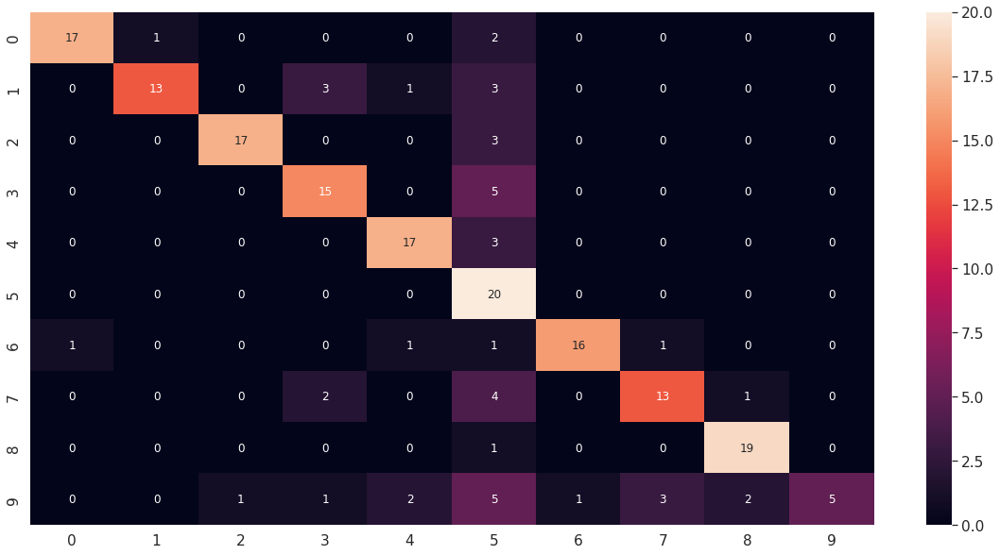

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_11_df_CM = pd.DataFrame(facenet_model_oclu1_11_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_11_report)

              precision    recall  f1-score   support

           1       0.94      0.85      0.89        20
           2       0.93      0.65      0.76        20
           3       0.94      0.85      0.89        20
           4       0.71      0.75      0.73        20
           5       0.81      0.85      0.83        20
           6       0.43      1.00      0.60        20
           7       0.94      0.80      0.86        20
           8       0.76      0.65      0.70        20
           9       0.86      0.95      0.90        20
          10       1.00      0.25      0.40        20

    accuracy                           0.76       200
   macro avg       0.83      0.76      0.76       200
weighted avg       0.83      0.76      0.76       200



#### Modelo 12: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_12 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_12 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_12)
facenet_model_oclu1_12 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_12)
facenet_model_oclu1_12.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_12.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_12 = facenet_model_oclu1_12.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
40/40 [==============================] - 18s 211ms/step - loss: 0.4568 - accuracy: 0.9375 - val_loss: 2.0770 - val_accuracy: 0.6350
Epoch 2/60
40/40 [==============================] - 5s 112ms/step - loss: 0.2757 - accuracy: 0.9762 - val_loss: 2.6114 - val_accuracy: 0.7250
Epoch 3/60
40/40 [==============================] - 5s 115ms/step - loss: 0.2213 - accuracy: 0.9925 - val_loss: 2.9193 - val_accuracy: 0.5900
Epoch 4/60
40/40 [==============================] - 5s 124ms/step - loss: 0.2437 - accuracy: 0.9762 - val_loss: 3.0761 - val_accuracy: 0.4950
Epoch 5/60
40/40 [==============================] - 5s 123ms/step - loss: 0.1919 - accuracy: 0.9850 - val_loss: 2.4800 - val_accuracy: 0.6550
Epoch 6/60
40/40 [==============================] - 9s 234ms/step - loss: 0.1713 - accuracy: 0.9900 - val_loss: 1.6781 - val_accuracy: 0.6900
Epoch 7/60
40/40 [==============================] - 7s 186ms/step - loss: 0.1554 - accuracy: 0.9950 - val_loss: 1.2984 - val_accuracy: 0.7150
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_12 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_12.evaluate(testX, testY)

7/7 [==============================] - 0s 49ms/step - loss: 0.9240 - accuracy: 0.7450


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 46ms/step


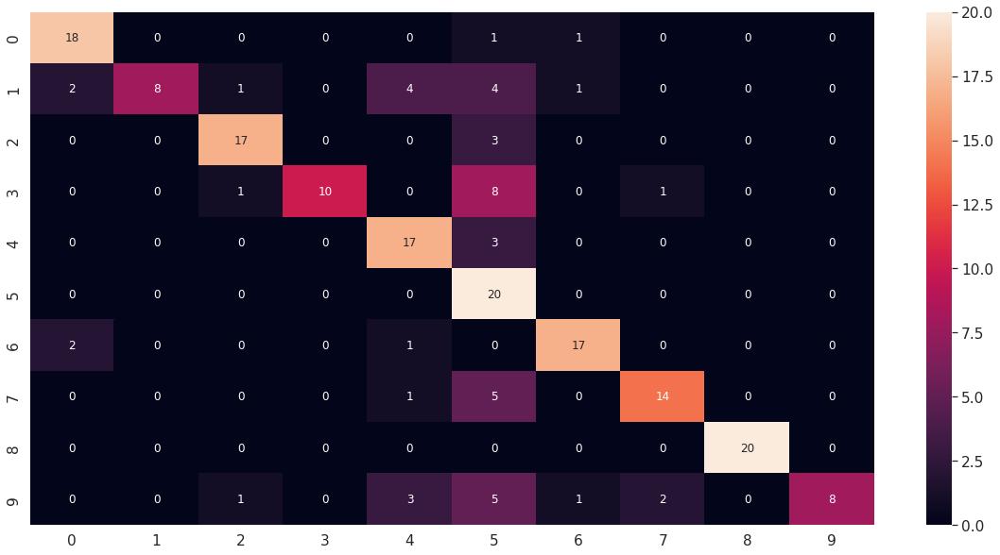

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_12_df_CM = pd.DataFrame(facenet_model_oclu1_12_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_12_report)

              precision    recall  f1-score   support

           1       0.82      0.90      0.86        20
           2       1.00      0.40      0.57        20
           3       0.85      0.85      0.85        20
           4       1.00      0.50      0.67        20
           5       0.65      0.85      0.74        20
           6       0.41      1.00      0.58        20
           7       0.85      0.85      0.85        20
           8       0.82      0.70      0.76        20
           9       1.00      1.00      1.00        20
          10       1.00      0.40      0.57        20

    accuracy                           0.74       200
   macro avg       0.84      0.75      0.74       200
weighted avg       0.84      0.74      0.74       200



#### Modelo 13: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_13 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_13 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_13)
facenet_model_oclu1_13 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_13)
facenet_model_oclu1_13.summary()

Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_13.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_13 = facenet_model_oclu1_13.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
20/20 [==============================] - 18s 436ms/step - loss: 1.2199 - accuracy: 0.7275 - val_loss: 1.7910 - val_accuracy: 0.6950
Epoch 2/60
20/20 [==============================] - 4s 194ms/step - loss: 0.2871 - accuracy: 0.9862 - val_loss: 1.7934 - val_accuracy: 0.7400
Epoch 3/60
20/20 [==============================] - 4s 194ms/step - loss: 0.2352 - accuracy: 0.9962 - val_loss: 1.8365 - val_accuracy: 0.7700
Epoch 4/60
20/20 [==============================] - 6s 321ms/step - loss: 0.2234 - accuracy: 0.9987 - val_loss: 1.0336 - val_accuracy: 0.8550
Epoch 5/60
20/20 [==============================] - 6s 315ms/step - loss: 0.2168 - accuracy: 0.9987 - val_loss: 0.7714 - val_accuracy: 0.8900
Epoch 6/60
20/20 [==============================] - 4s 194ms/step - loss: 0.2067 - accuracy: 0.9987 - val_loss: 1.1648 - val_accuracy: 0.8000
Epoch 7/60
20/20 [==============================] - 4s 203ms/step - loss: 0.1978 - accuracy: 1.0000 - val_loss: 1.7361 - val_accuracy: 0.7750
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_13 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_13.evaluate(testX, testY)

7/7 [==============================] - 0s 50ms/step - loss: 1.0272 - accuracy: 0.7050


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 59ms/step


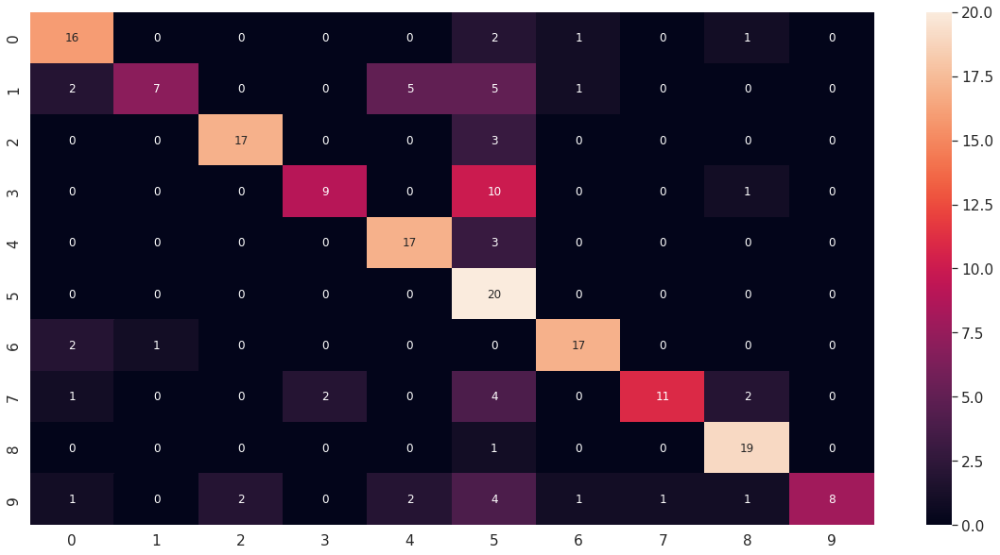

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_13_df_CM = pd.DataFrame(facenet_model_oclu1_13_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_13_report)

              precision    recall  f1-score   support

           1       0.73      0.80      0.76        20
           2       0.88      0.35      0.50        20
           3       0.89      0.85      0.87        20
           4       0.82      0.45      0.58        20
           5       0.71      0.85      0.77        20
           6       0.38      1.00      0.56        20
           7       0.85      0.85      0.85        20
           8       0.92      0.55      0.69        20
           9       0.79      0.95      0.86        20
          10       1.00      0.40      0.57        20

    accuracy                           0.70       200
   macro avg       0.80      0.71      0.70       200
weighted avg       0.80      0.70      0.70       200



#### Modelo 14: (BTH = 50, EHS = 50, ValidSplit = 0.2, INI = HeNormal, Dropout=0, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_14 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_14 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_14)
facenet_model_oclu1_14 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_14)
facenet_model_oclu1_14.summary()

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_14.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_14.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_14 = facenet_model_oclu1_14.fit(new_trainX, new_trainY, batch_size=50, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
16/16 [==============================] - 19s 497ms/step - loss: 0.8747 - accuracy: 0.8462 - val_loss: 1.4142 - val_accuracy: 0.7300
Epoch 2/50
16/16 [==============================] - 6s 372ms/step - loss: 0.2370 - accuracy: 0.9987 - val_loss: 1.1808 - val_accuracy: 0.7950
Epoch 3/50
16/16 [==============================] - 4s 227ms/step - loss: 0.2376 - accuracy: 0.9962 - val_loss: 1.5486 - val_accuracy: 0.7200
Epoch 4/50
16/16 [==============================] - 6s 362ms/step - loss: 0.2633 - accuracy: 0.9912 - val_loss: 0.9066 - val_accuracy: 0.8350
Epoch 5/50
16/16 [==============================] - 4s 227ms/step - loss: 0.2218 - accuracy: 0.9962 - val_loss: 1.1287 - val_accuracy: 0.8200
Epoch 6/50
16/16 [==============================] - 4s 227ms/step - loss: 0.2056 - accuracy: 1.0000 - val_loss: 1.0341 - val_accuracy: 0.8100
Epoch 7/50
16/16 [==============================] - 4s 227ms/step - loss: 0.1954 - accuracy: 1.0000 - val_loss: 1.5581 - val_accuracy: 0.7100
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_14 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_14.evaluate(testX, testY)

7/7 [==============================] - 0s 45ms/step - loss: 0.8540 - accuracy: 0.7800


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 45ms/step


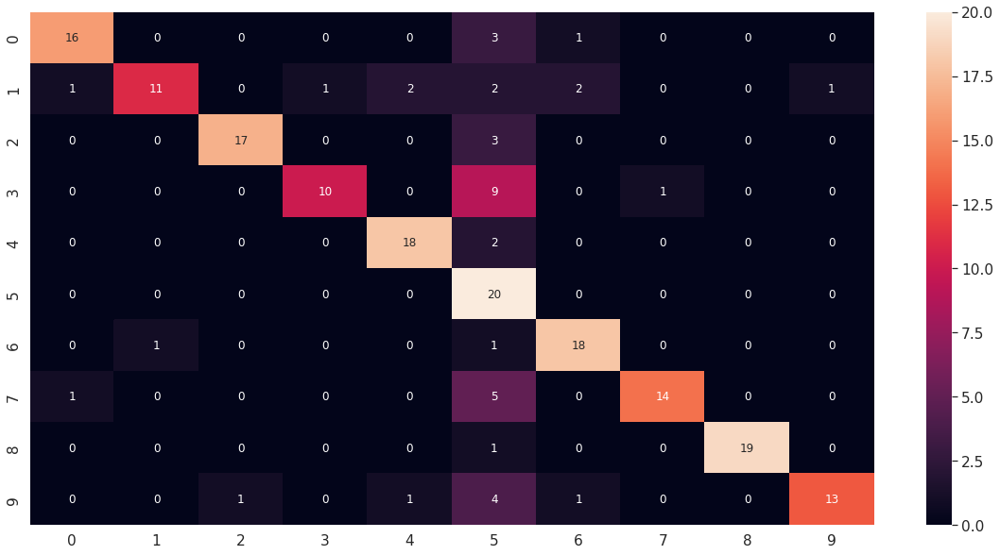

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_14_df_CM = pd.DataFrame(facenet_model_oclu1_14_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_14_report)

              precision    recall  f1-score   support

           1       0.89      0.80      0.84        20
           2       0.92      0.55      0.69        20
           3       0.94      0.85      0.89        20
           4       0.91      0.50      0.65        20
           5       0.86      0.90      0.88        20
           6       0.40      1.00      0.57        20
           7       0.82      0.90      0.86        20
           8       0.93      0.70      0.80        20
           9       1.00      0.95      0.97        20
          10       0.93      0.65      0.76        20

    accuracy                           0.78       200
   macro avg       0.86      0.78      0.79       200
weighted avg       0.86      0.78      0.79       200



#### Modelo 15: (BTH = 10, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu1_15 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu1_15 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu1_15)
facenet_model_oclu1_15 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu1_15)
facenet_model_oclu1_15.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                           

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu1_15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_15.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu1_15 = facenet_model_oclu1_15.fit(new_trainX, new_trainY, batch_size=10, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
80/80 [==============================] - 20s 116ms/step - loss: 0.6728 - accuracy: 0.8813 - val_loss: 1.5118 - val_accuracy: 0.7200
Epoch 2/60
80/80 [==============================] - 8s 94ms/step - loss: 0.3392 - accuracy: 0.9625 - val_loss: 1.2801 - val_accuracy: 0.7500
Epoch 3/60
80/80 [==============================] - 7s 93ms/step - loss: 0.3767 - accuracy: 0.9538 - val_loss: 1.0871 - val_accuracy: 0.7750
Epoch 4/60
80/80 [==============================] - 8s 94ms/step - loss: 0.3228 - accuracy: 0.9638 - val_loss: 1.0482 - val_accuracy: 0.8100
Epoch 5/60
80/80 [==============================] - 6s 70ms/step - loss: 0.3003 - accuracy: 0.9638 - val_loss: 1.2079 - val_accuracy: 0.7850
Epoch 6/60
80/80 [==============================] - 9s 108ms/step - loss: 0.2243 - accuracy: 0.9800 - val_loss: 1.0421 - val_accuracy: 0.7900
Epoch 7/60
80/80 [==============================] - 6s 76ms/step - loss: 0.1710 - accuracy: 0.9825 - val_loss: 1.4295 - val_accuracy: 0.7100
Epoch 8/60

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu1_15 = load_model(path + 'data_reconocimiento1/models_ROF1/facenet_model_ROF1_15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu1_15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu1_15.evaluate(testX, testY)

7/7 [==============================] - 0s 48ms/step - loss: 0.6199 - accuracy: 0.8250


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu1_15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu1_15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 59ms/step


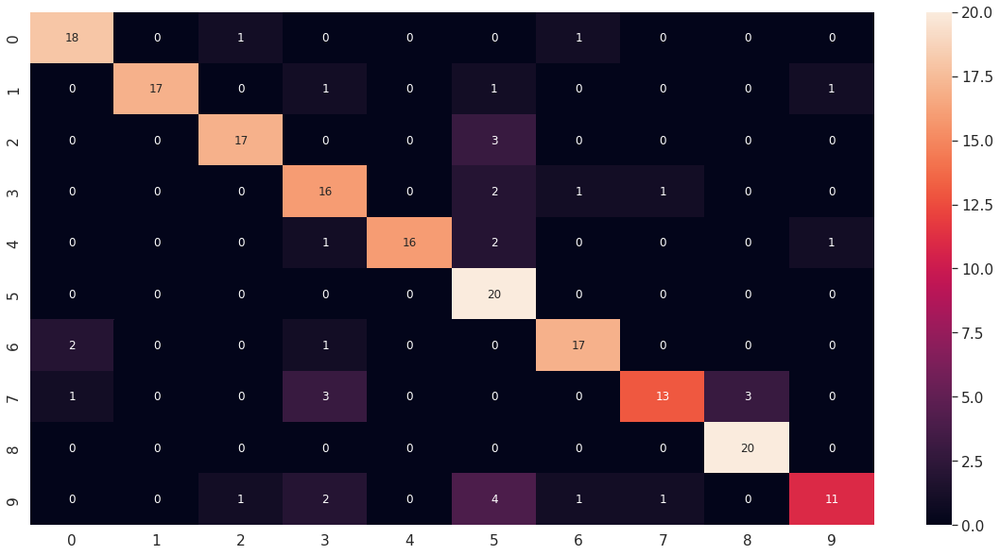

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu1_15_df_CM = pd.DataFrame(facenet_model_oclu1_15_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu1_15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu1_15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu1_15_report)

              precision    recall  f1-score   support

           1       0.86      0.90      0.88        20
           2       1.00      0.85      0.92        20
           3       0.89      0.85      0.87        20
           4       0.67      0.80      0.73        20
           5       1.00      0.80      0.89        20
           6       0.62      1.00      0.77        20
           7       0.85      0.85      0.85        20
           8       0.87      0.65      0.74        20
           9       0.87      1.00      0.93        20
          10       0.85      0.55      0.67        20

    accuracy                           0.82       200
   macro avg       0.85      0.82      0.82       200
weighted avg       0.85      0.82      0.82       200



## 6. Modelos con base de datos ROF 2 para condiciones de oclusion

#### Modelo 1: (BTH = 30, EHS = 30, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_1 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_1)
facenet_model_oclu2_1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_1)
facenet_model_oclu2_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_1.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_1 = facenet_model_oclu2_1.fit(new_trainX, new_trainY, batch_size=30, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
43/43 [==============================] - 33s 288ms/step - loss: 2.5008 - accuracy: 0.2578 - val_loss: 3.5769 - val_accuracy: 0.0966
Epoch 2/30
43/43 [==============================] - 7s 151ms/step - loss: 1.7447 - accuracy: 0.4711 - val_loss: 5.3958 - val_accuracy: 0.0872
Epoch 3/30
43/43 [==============================] - 7s 152ms/step - loss: 1.3786 - accuracy: 0.5977 - val_loss: 4.2699 - val_accuracy: 0.0966
Epoch 4/30
43/43 [==============================] - 6s 151ms/step - loss: 1.1399 - accuracy: 0.6938 - val_loss: 9.9638 - val_accuracy: 0.0592
Epoch 5/30
43/43 [==============================] - 7s 152ms/step - loss: 0.7697 - accuracy: 0.8000 - val_loss: 8.7133 - val_accuracy: 0.0966
Epoch 6/30
43/43 [==============================] - 7s 152ms/step - loss: 0.5671 - accuracy: 0.8734 - val_loss: 4.3485 - val_accuracy: 0.0997
Epoch 7/30
43/43 [==============================] - 7s 153ms/step - loss: 0.4898 - accuracy: 0.8953 - val_loss: 9.1026 - val_accuracy: 0.0966
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_1 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_1.evaluate(testX, testY)

7/7 [==============================] - 1s 112ms/step - loss: 0.1653 - accuracy: 0.9800


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 45ms/step


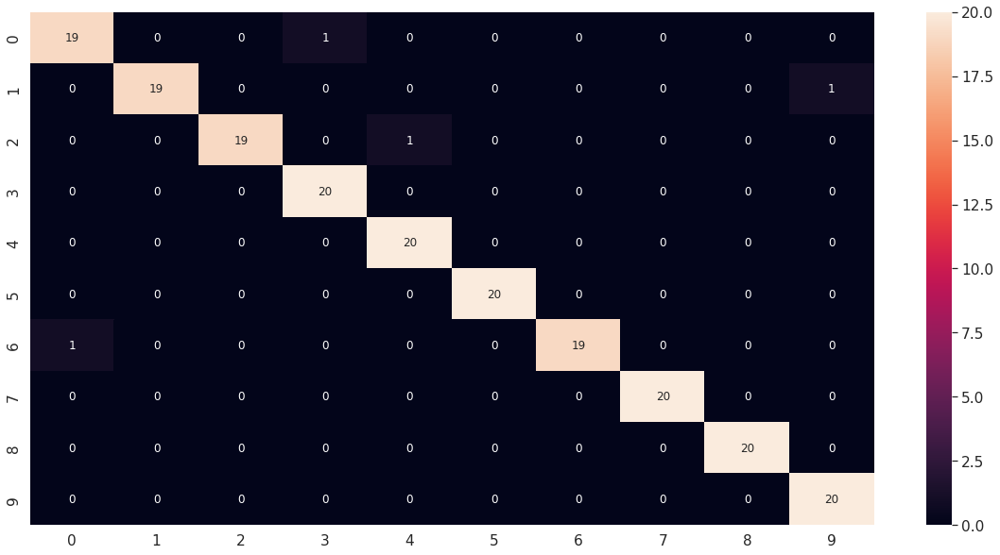

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_1_df_CM = pd.DataFrame(facenet_model_oclu2_1_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_1_report)

              precision    recall  f1-score   support

           1       0.95      0.95      0.95        20
           2       1.00      0.95      0.97        20
           3       1.00      0.95      0.97        20
           4       0.95      1.00      0.98        20
           5       0.95      1.00      0.98        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.95      1.00      0.98        20

    accuracy                           0.98       200
   macro avg       0.98      0.98      0.98       200
weighted avg       0.98      0.98      0.98       200



#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_2 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_2 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_2)
facenet_model_oclu2_2 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_2)
facenet_model_oclu2_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_2.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_2 = facenet_model_oclu2_2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
43/43 [==============================] - 20s 246ms/step - loss: 0.6591 - accuracy: 0.8602 - val_loss: 4.6955 - val_accuracy: 0.3458
Epoch 2/80
43/43 [==============================] - 7s 158ms/step - loss: 0.3711 - accuracy: 0.9438 - val_loss: 6.9245 - val_accuracy: 0.2586
Epoch 3/80
43/43 [==============================] - 9s 202ms/step - loss: 0.2801 - accuracy: 0.9703 - val_loss: 1.9541 - val_accuracy: 0.6168
Epoch 4/80
43/43 [==============================] - 9s 206ms/step - loss: 0.2167 - accuracy: 0.9859 - val_loss: 1.2874 - val_accuracy: 0.7539
Epoch 5/80
43/43 [==============================] - 9s 201ms/step - loss: 0.2275 - accuracy: 0.9781 - val_loss: 1.0740 - val_accuracy: 0.7913
Epoch 6/80
43/43 [==============================] - 7s 154ms/step - loss: 0.1758 - accuracy: 0.9914 - val_loss: 1.1551 - val_accuracy: 0.7601
Epoch 7/80
43/43 [==============================] - 7s 157ms/step - loss: 0.1920 - accuracy: 0.9820 - val_loss: 1.2616 - val_accuracy: 0.7227
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_2 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_2.evaluate(testX, testY)

7/7 [==============================] - 0s 45ms/step - loss: 0.0718 - accuracy: 0.9900


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

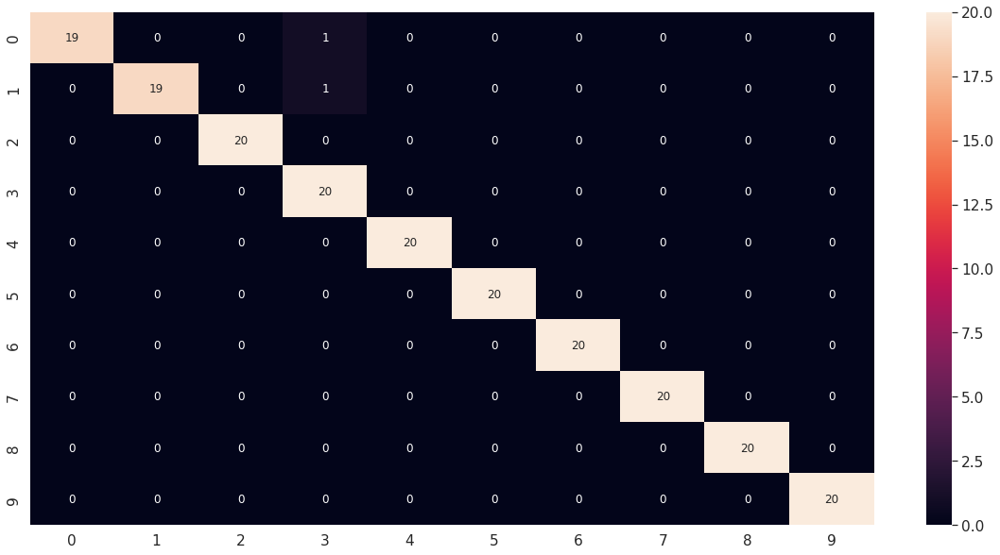

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_2_df_CM = pd.DataFrame(facenet_model_oclu2_2_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_2_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       0.91      1.00      0.95        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      1.00      1.00        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       1.00      1.00      1.00        20

    accuracy                           0.99       200
   macro avg       0.99      0.99      0.99       200
weighted avg       0.99      0.99      0.99       200

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       0.91 

#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_3 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_3 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_3)
facenet_model_oclu2_3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_3)
facenet_model_oclu2_3.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_3.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_3 = facenet_model_oclu2_3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
43/43 [==============================] - 20s 246ms/step - loss: 0.4437 - accuracy: 0.9438 - val_loss: 3.4743 - val_accuracy: 0.4081
Epoch 2/50
43/43 [==============================] - 9s 203ms/step - loss: 0.3632 - accuracy: 0.9484 - val_loss: 1.8283 - val_accuracy: 0.6885
Epoch 3/50
43/43 [==============================] - 7s 158ms/step - loss: 0.2490 - accuracy: 0.9805 - val_loss: 4.5855 - val_accuracy: 0.5109
Epoch 4/50
43/43 [==============================] - 9s 206ms/step - loss: 0.2025 - accuracy: 0.9898 - val_loss: 1.4284 - val_accuracy: 0.7664
Epoch 5/50
43/43 [==============================] - 9s 211ms/step - loss: 0.1701 - accuracy: 0.9953 - val_loss: 1.0242 - val_accuracy: 0.8287
Epoch 6/50
43/43 [==============================] - 9s 207ms/step - loss: 0.1630 - accuracy: 0.9930 - val_loss: 1.0003 - val_accuracy: 0.8162
Epoch 7/50
43/43 [==============================] - 9s 208ms/step - loss: 0.1390 - accuracy: 0.9945 - val_loss: 0.8824 - val_accuracy: 0.8318
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_3 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_3.evaluate(testX, testY)

7/7 [==============================] - 0s 55ms/step - loss: 0.0867 - accuracy: 0.9850


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 58ms/step


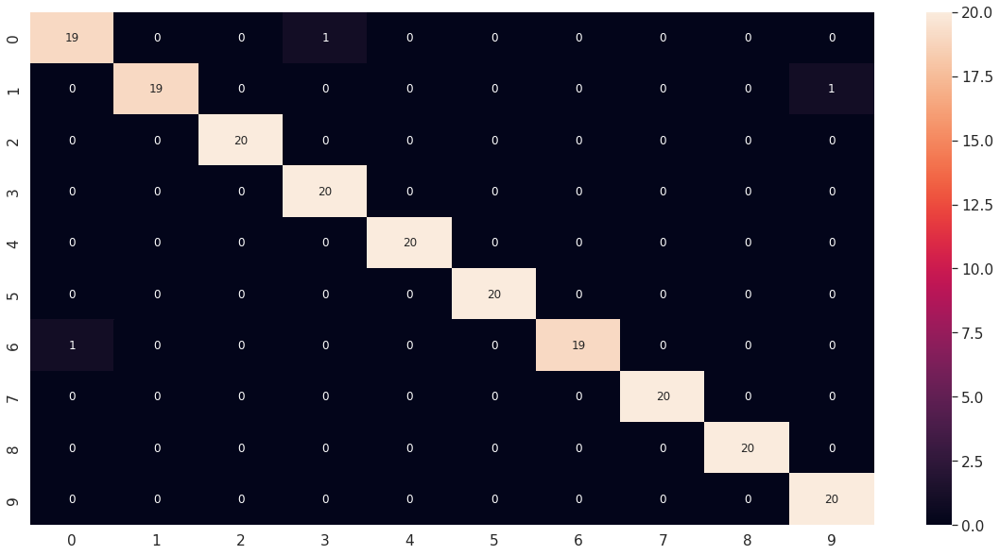

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_3_df_CM = pd.DataFrame(facenet_model_oclu2_3_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_3_report)

              precision    recall  f1-score   support

           1       0.95      0.95      0.95        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       0.95      1.00      0.98        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.95      1.00      0.98        20

    accuracy                           0.98       200
   macro avg       0.99      0.98      0.98       200
weighted avg       0.99      0.98      0.98       200



#### Modelo 4: (BTH = 20, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.5 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_4 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_4 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_4)
facenet_model_oclu2_4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_4)
facenet_model_oclu2_4.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_4.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_4 = facenet_model_oclu2_4.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
64/64 [==============================] - 20s 173ms/step - loss: 0.8607 - accuracy: 0.8141 - val_loss: 0.7653 - val_accuracy: 0.8536
Epoch 2/30
64/64 [==============================] - 7s 115ms/step - loss: 0.3192 - accuracy: 0.9672 - val_loss: 1.8387 - val_accuracy: 0.6947
Epoch 3/30
64/64 [==============================] - 7s 115ms/step - loss: 0.2574 - accuracy: 0.9828 - val_loss: 1.1498 - val_accuracy: 0.7477
Epoch 4/30
64/64 [==============================] - 7s 116ms/step - loss: 0.2426 - accuracy: 0.9828 - val_loss: 1.1742 - val_accuracy: 0.7352
Epoch 5/30
64/64 [==============================] - 12s 184ms/step - loss: 0.2474 - accuracy: 0.9711 - val_loss: 0.6187 - val_accuracy: 0.8847
Epoch 6/30
64/64 [==============================] - 8s 116ms/step - loss: 0.1907 - accuracy: 0.9914 - val_loss: 0.7542 - val_accuracy: 0.8380
Epoch 7/30
64/64 [==============================] - 7s 116ms/step - loss: 0.1650 - accuracy: 0.9930 - val_loss: 0.6334 - val_accuracy: 0.8847
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_4 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_4.evaluate(testX, testY)

7/7 [==============================] - 0s 56ms/step - loss: 0.0858 - accuracy: 0.9900


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 58ms/step


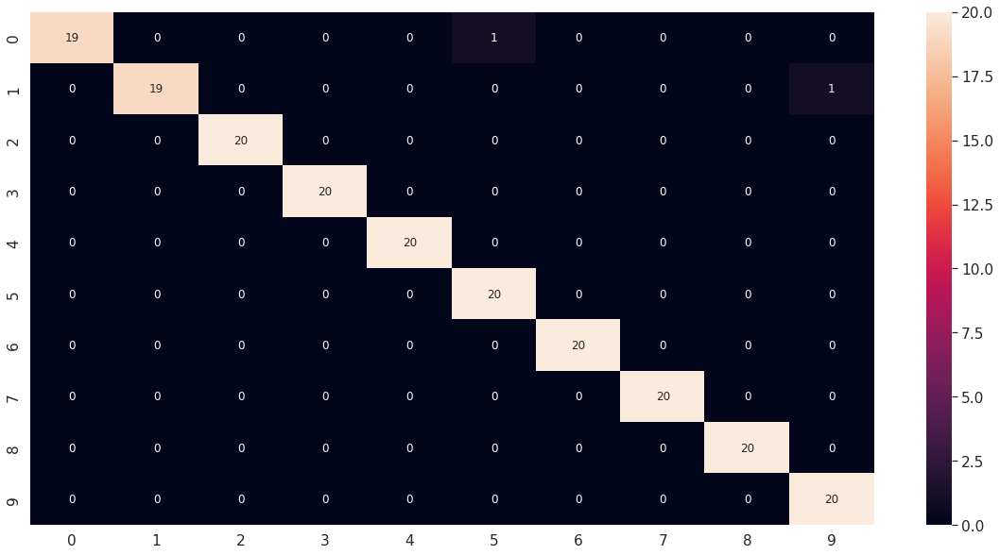

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_4_df_CM = pd.DataFrame(facenet_model_oclu2_4_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_4_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       0.95      1.00      0.98        20
           7       1.00      1.00      1.00        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.95      1.00      0.98        20

    accuracy                           0.99       200
   macro avg       0.99      0.99      0.99       200
weighted avg       0.99      0.99      0.99       200



#### Modelo 5: (BTH = 20, EHS = 60, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.5, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_5 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_5)
facenet_model_oclu2_5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_5)
facenet_model_oclu2_5.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_5.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_5 = facenet_model_oclu2_5.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
64/64 [==============================] - 20s 175ms/step - loss: 0.7345 - accuracy: 0.8531 - val_loss: 0.7092 - val_accuracy: 0.8847
Epoch 2/60
64/64 [==============================] - 9s 148ms/step - loss: 0.2460 - accuracy: 0.9914 - val_loss: 0.6926 - val_accuracy: 0.8754
Epoch 3/60
64/64 [==============================] - 10s 149ms/step - loss: 0.2153 - accuracy: 0.9937 - val_loss: 0.5513 - val_accuracy: 0.8972
Epoch 4/60
64/64 [==============================] - 8s 119ms/step - loss: 0.2032 - accuracy: 0.9914 - val_loss: 0.7143 - val_accuracy: 0.8318
Epoch 5/60
64/64 [==============================] - 8s 120ms/step - loss: 0.2520 - accuracy: 0.9703 - val_loss: 2.1828 - val_accuracy: 0.5545
Epoch 6/60
64/64 [==============================] - 8s 119ms/step - loss: 0.2229 - accuracy: 0.9797 - val_loss: 0.8481 - val_accuracy: 0.8380
Epoch 7/60
64/64 [==============================] - 7s 115ms/step - loss: 0.1680 - accuracy: 0.9898 - val_loss: 0.8206 - val_accuracy: 0.8536
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_5 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_5.evaluate(testX, testY)

7/7 [==============================] - 0s 57ms/step - loss: 0.0785 - accuracy: 0.9900


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 57ms/step


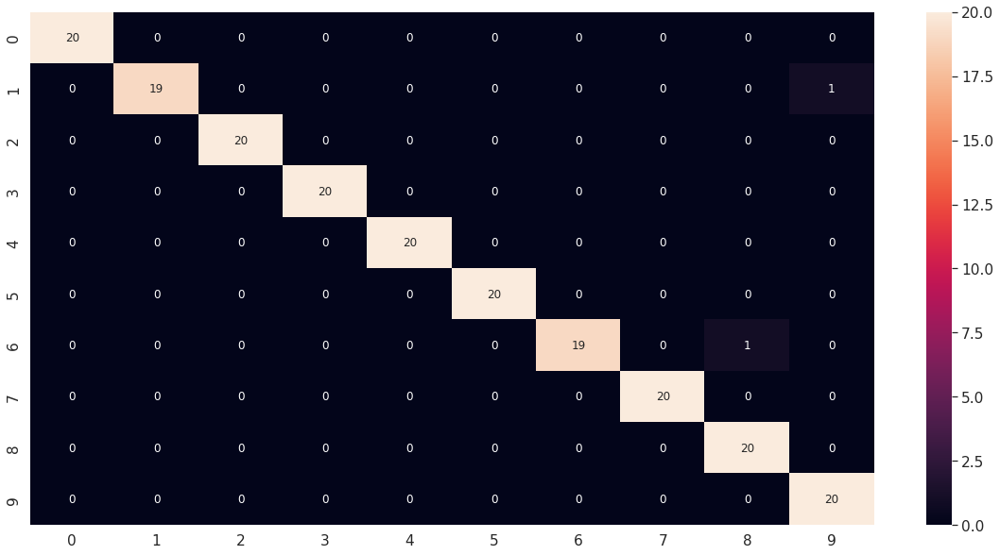

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_5_df_CM = pd.DataFrame(facenet_model_oclu2_5_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_5_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       1.00      1.00      1.00        20
           9       0.95      1.00      0.98        20
          10       0.95      1.00      0.98        20

    accuracy                           0.99       200
   macro avg       0.99      0.99      0.99       200
weighted avg       0.99      0.99      0.99       200



#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_6 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_6 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_6)
facenet_model_oclu2_6 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_6)
facenet_model_oclu2_6.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_6.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_6 = facenet_model_oclu2_6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
32/32 [==============================] - 20s 306ms/step - loss: 1.0080 - accuracy: 0.7891 - val_loss: 0.7552 - val_accuracy: 0.8879
Epoch 2/60
32/32 [==============================] - 8s 260ms/step - loss: 0.2537 - accuracy: 0.9977 - val_loss: 0.6660 - val_accuracy: 0.9034
Epoch 3/60
32/32 [==============================] - 8s 257ms/step - loss: 0.2269 - accuracy: 1.0000 - val_loss: 0.5377 - val_accuracy: 0.9283
Epoch 4/60
32/32 [==============================] - 6s 202ms/step - loss: 0.2142 - accuracy: 1.0000 - val_loss: 0.6716 - val_accuracy: 0.9159
Epoch 5/60
32/32 [==============================] - 8s 260ms/step - loss: 0.1989 - accuracy: 1.0000 - val_loss: 0.5367 - val_accuracy: 0.9221
Epoch 6/60
32/32 [==============================] - 8s 264ms/step - loss: 0.1854 - accuracy: 1.0000 - val_loss: 0.4663 - val_accuracy: 0.9377
Epoch 7/60
32/32 [==============================] - 8s 257ms/step - loss: 0.1738 - accuracy: 1.0000 - val_loss: 0.4195 - val_accuracy: 0.9470
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_6 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_6.evaluate(testX, testY)

7/7 [==============================] - 0s 45ms/step - loss: 0.0857 - accuracy: 0.9950


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 45ms/step


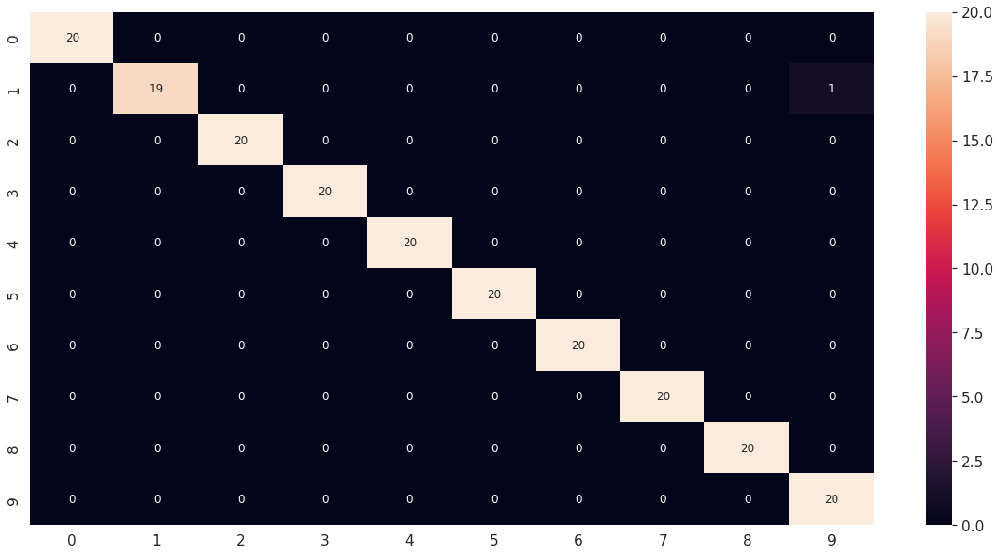

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_6_df_CM = pd.DataFrame(facenet_model_oclu2_6_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_6_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      1.00      1.00        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.95      1.00      0.98        20

    accuracy                           0.99       200
   macro avg       1.00      0.99      0.99       200
weighted avg       1.00      0.99      0.99       200



#### Modelo 7: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_7 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_7 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_7)
facenet_model_oclu2_7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_7)
facenet_model_oclu2_7.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_7.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_7 = facenet_model_oclu2_7.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
43/43 [==============================] - 19s 237ms/step - loss: 0.5111 - accuracy: 0.9266 - val_loss: 0.9195 - val_accuracy: 0.8660
Epoch 2/50
43/43 [==============================] - 7s 156ms/step - loss: 0.2520 - accuracy: 0.9922 - val_loss: 1.0850 - val_accuracy: 0.8255
Epoch 3/50
43/43 [==============================] - 7s 158ms/step - loss: 0.2155 - accuracy: 0.9930 - val_loss: 1.2035 - val_accuracy: 0.8006
Epoch 4/50
43/43 [==============================] - 11s 255ms/step - loss: 0.1866 - accuracy: 0.9961 - val_loss: 0.8867 - val_accuracy: 0.8536
Epoch 5/50
43/43 [==============================] - 9s 202ms/step - loss: 0.1636 - accuracy: 0.9969 - val_loss: 0.5801 - val_accuracy: 0.8910
Epoch 6/50
43/43 [==============================] - 7s 159ms/step - loss: 0.1588 - accuracy: 0.9969 - val_loss: 0.8444 - val_accuracy: 0.8536
Epoch 7/50
43/43 [==============================] - 7s 158ms/step - loss: 0.1531 - accuracy: 0.9930 - val_loss: 0.8321 - val_accuracy: 0.8255
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_7 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_7.evaluate(testX, testY)

7/7 [==============================] - 0s 49ms/step - loss: 0.0728 - accuracy: 0.9850


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 46ms/step


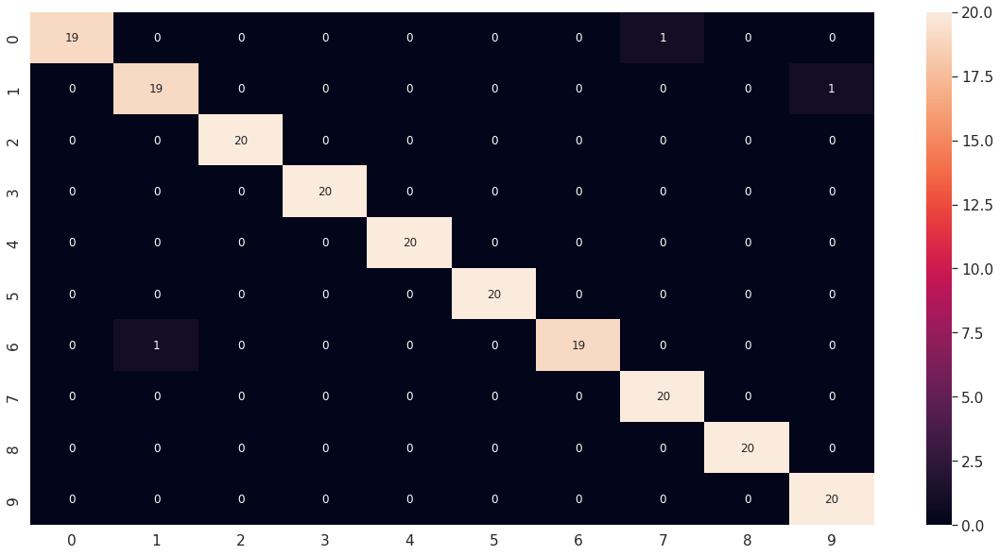

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_7_df_CM = pd.DataFrame(facenet_model_oclu2_7_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_7_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       0.95      0.95      0.95        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       0.95      1.00      0.98        20
           9       1.00      1.00      1.00        20
          10       0.95      1.00      0.98        20

    accuracy                           0.98       200
   macro avg       0.99      0.98      0.98       200
weighted avg       0.99      0.98      0.98       200



#### Modelo 8: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0,2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_8 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_8 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_8)
facenet_model_oclu2_8 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_8)
facenet_model_oclu2_8.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu2_8.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_8.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_8 = facenet_model_oclu2_8.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
64/64 [==============================] - 20s 172ms/step - loss: 0.6816 - accuracy: 0.8961 - val_loss: 0.6286 - val_accuracy: 0.8941
Epoch 2/60
64/64 [==============================] - 9s 146ms/step - loss: 0.2458 - accuracy: 1.0000 - val_loss: 0.5272 - val_accuracy: 0.9221
Epoch 3/60
64/64 [==============================] - 9s 147ms/step - loss: 0.2304 - accuracy: 1.0000 - val_loss: 0.4979 - val_accuracy: 0.9283
Epoch 4/60
64/64 [==============================] - 9s 148ms/step - loss: 0.2223 - accuracy: 1.0000 - val_loss: 0.4614 - val_accuracy: 0.9377
Epoch 5/60
64/64 [==============================] - 10s 148ms/step - loss: 0.2159 - accuracy: 1.0000 - val_loss: 0.4525 - val_accuracy: 0.9408
Epoch 6/60
64/64 [==============================] - 9s 147ms/step - loss: 0.2098 - accuracy: 1.0000 - val_loss: 0.4508 - val_accuracy: 0.9439
Epoch 7/60
64/64 [==============================] - 8s 116ms/step - loss: 0.2035 - accuracy: 1.0000 - val_loss: 0.4535 - val_accuracy: 0.9439
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_8 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_8.evaluate(testX, testY)

7/7 [==============================] - 0s 45ms/step - loss: 0.0838 - accuracy: 0.9850


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 51ms/step


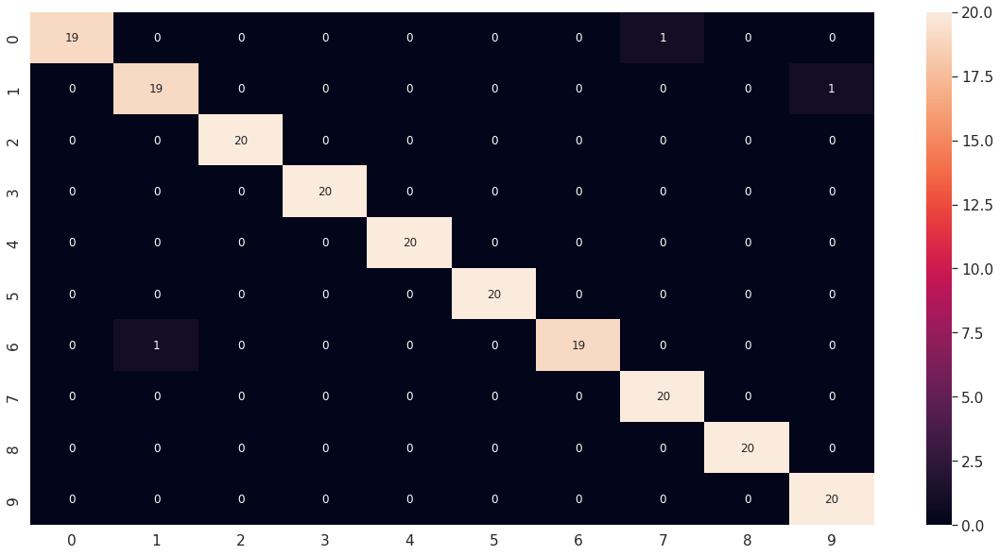

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_8_df_CM = pd.DataFrame(facenet_model_oclu2_8_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_8_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       0.95      0.95      0.95        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       0.95      1.00      0.98        20
           9       1.00      1.00      1.00        20
          10       0.95      1.00      0.98        20

    accuracy                           0.98       200
   macro avg       0.99      0.98      0.98       200
weighted avg       0.99      0.98      0.98       200



#### Modelo 9: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_9 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_9 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_9)
facenet_model_oclu2_9 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_9)
facenet_model_oclu2_9.summary()

Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_9.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_9 = facenet_model_oclu2_9.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
64/64 [==============================] - 20s 175ms/step - loss: 0.4573 - accuracy: 0.9328 - val_loss: 0.8540 - val_accuracy: 0.8816
Epoch 2/60
64/64 [==============================] - 7s 114ms/step - loss: 0.2239 - accuracy: 0.9922 - val_loss: 1.0826 - val_accuracy: 0.8131
Epoch 3/60
64/64 [==============================] - 9s 146ms/step - loss: 0.1658 - accuracy: 0.9992 - val_loss: 0.6416 - val_accuracy: 0.9003
Epoch 4/60
64/64 [==============================] - 9s 145ms/step - loss: 0.1575 - accuracy: 0.9977 - val_loss: 0.4786 - val_accuracy: 0.9283
Epoch 5/60
64/64 [==============================] - 9s 145ms/step - loss: 0.1262 - accuracy: 0.9992 - val_loss: 0.4659 - val_accuracy: 0.9221
Epoch 6/60
64/64 [==============================] - 7s 116ms/step - loss: 0.1155 - accuracy: 0.9953 - val_loss: 0.6078 - val_accuracy: 0.8847
Epoch 7/60
64/64 [==============================] - 7s 115ms/step - loss: 0.0969 - accuracy: 0.9984 - val_loss: 0.5603 - val_accuracy: 0.8941
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_9 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_9.evaluate(testX, testY)

7/7 [==============================] - 0s 46ms/step - loss: 0.0868 - accuracy: 0.9850


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 45ms/step


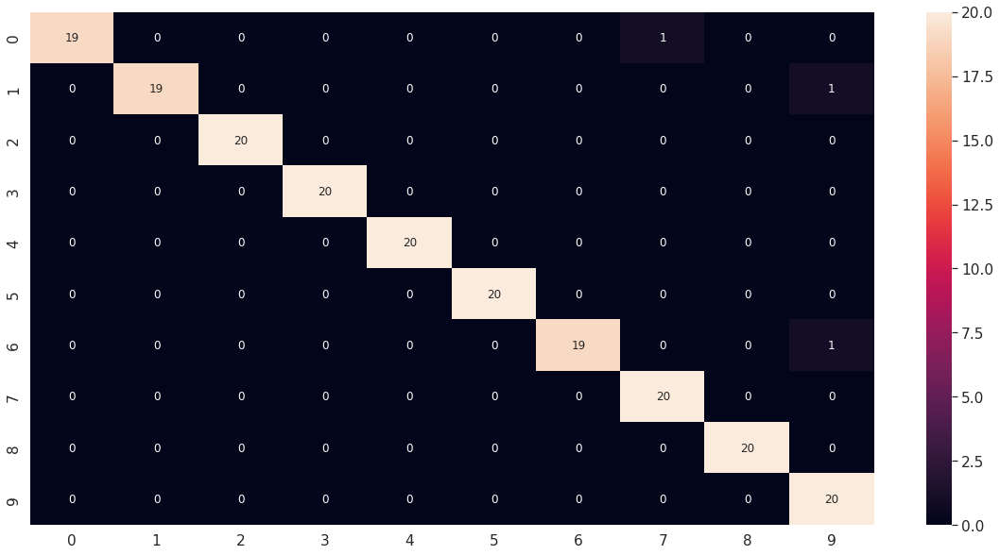

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_9_df_CM = pd.DataFrame(facenet_model_oclu2_9_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_9_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       0.95      1.00      0.98        20
           9       1.00      1.00      1.00        20
          10       0.91      1.00      0.95        20

    accuracy                           0.98       200
   macro avg       0.99      0.98      0.99       200
weighted avg       0.99      0.98      0.99       200



#### Modelo 10: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_10 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_10 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_10)
facenet_model_oclu2_10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_10)
facenet_model_oclu2_10.summary()

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu2_10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_10.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_10 = facenet_model_oclu2_10.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
43/43 [==============================] - 20s 254ms/step - loss: 0.8841 - accuracy: 0.8289 - val_loss: 0.5872 - val_accuracy: 0.9128
Epoch 2/50
43/43 [==============================] - 9s 210ms/step - loss: 0.2539 - accuracy: 1.0000 - val_loss: 0.5511 - val_accuracy: 0.9190
Epoch 3/50
43/43 [==============================] - 9s 211ms/step - loss: 0.2409 - accuracy: 1.0000 - val_loss: 0.5347 - val_accuracy: 0.9159
Epoch 4/50
43/43 [==============================] - 9s 213ms/step - loss: 0.2323 - accuracy: 1.0000 - val_loss: 0.5246 - val_accuracy: 0.9252
Epoch 5/50
43/43 [==============================] - 9s 215ms/step - loss: 0.2273 - accuracy: 1.0000 - val_loss: 0.5121 - val_accuracy: 0.9315
Epoch 6/50
43/43 [==============================] - 9s 209ms/step - loss: 0.2254 - accuracy: 0.9992 - val_loss: 0.5083 - val_accuracy: 0.9315
Epoch 7/50
43/43 [==============================] - 9s 204ms/step - loss: 0.2176 - accuracy: 1.0000 - val_loss: 0.5051 - val_accuracy: 0.9315
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_10 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_10.evaluate(testX, testY)

7/7 [==============================] - 0s 59ms/step - loss: 0.1091 - accuracy: 0.9900


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 45ms/step


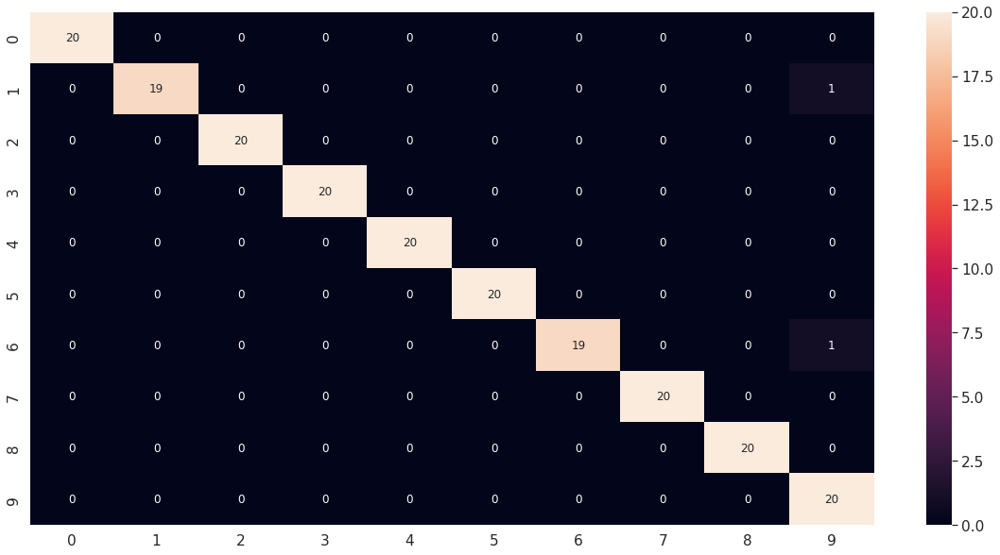

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_10_df_CM = pd.DataFrame(facenet_model_oclu2_10_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_10_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      0.95      0.97        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.91      1.00      0.95        20

    accuracy                           0.99       200
   macro avg       0.99      0.99      0.99       200
weighted avg       0.99      0.99      0.99       200



#### Modelo 11: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_11 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_11 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_11)
facenet_model_oclu2_11 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_11)
facenet_model_oclu2_11.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                           

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu2_11.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_11.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_11 = facenet_model_oclu2_11.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
43/43 [==============================] - 21s 252ms/step - loss: 1.3420 - accuracy: 0.7016 - val_loss: 0.6365 - val_accuracy: 0.8879
Epoch 2/50
43/43 [==============================] - 9s 208ms/step - loss: 0.4110 - accuracy: 0.9492 - val_loss: 0.5750 - val_accuracy: 0.9159
Epoch 3/50
43/43 [==============================] - 9s 211ms/step - loss: 0.3082 - accuracy: 0.9797 - val_loss: 0.5588 - val_accuracy: 0.9221
Epoch 4/50
43/43 [==============================] - 9s 212ms/step - loss: 0.2769 - accuracy: 0.9891 - val_loss: 0.5470 - val_accuracy: 0.9252
Epoch 5/50
43/43 [==============================] - 7s 163ms/step - loss: 0.2601 - accuracy: 0.9930 - val_loss: 0.5506 - val_accuracy: 0.9283
Epoch 6/50
43/43 [==============================] - 7s 164ms/step - loss: 0.2473 - accuracy: 0.9945 - val_loss: 0.5497 - val_accuracy: 0.9346
Epoch 7/50
43/43 [==============================] - 7s 162ms/step - loss: 0.2386 - accuracy: 0.9992 - val_loss: 0.5544 - val_accuracy: 0.9377
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_11 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_11.evaluate(testX, testY)

7/7 [==============================] - 0s 46ms/step - loss: 0.1431 - accuracy: 0.9800


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 58ms/step


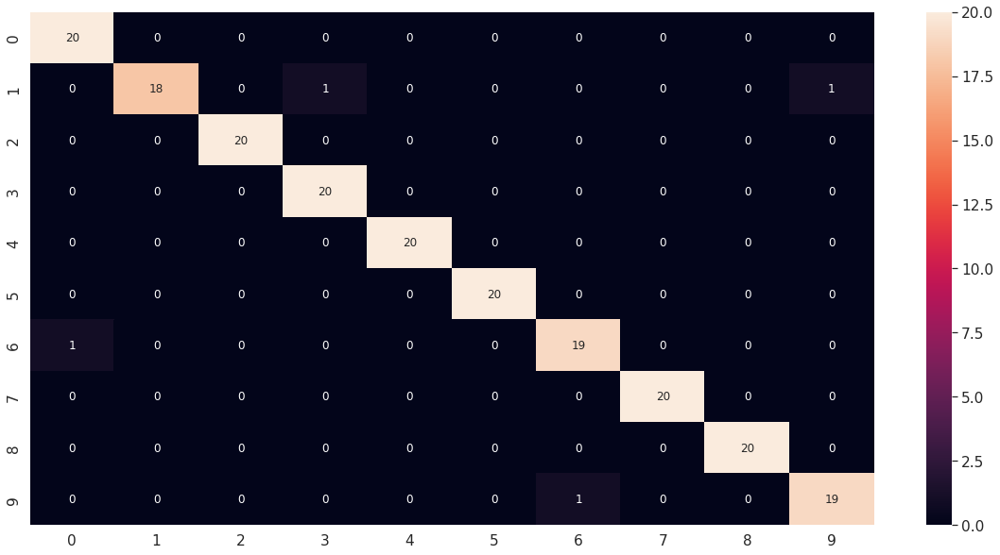

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_11_df_CM = pd.DataFrame(facenet_model_oclu2_11_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_11_report)

              precision    recall  f1-score   support

           1       0.95      1.00      0.98        20
           2       1.00      0.90      0.95        20
           3       1.00      1.00      1.00        20
           4       0.95      1.00      0.98        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       0.95      0.95      0.95        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.95      0.95      0.95        20

    accuracy                           0.98       200
   macro avg       0.98      0.98      0.98       200
weighted avg       0.98      0.98      0.98       200



#### Modelo 12: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_12 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_12 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_12)
facenet_model_oclu2_12 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_12)
facenet_model_oclu2_12.summary()

Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                           

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_12.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_12 = facenet_model_oclu2_12.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
32/32 [==============================] - 20s 332ms/step - loss: 0.4568 - accuracy: 0.9430 - val_loss: 0.8239 - val_accuracy: 0.9003
Epoch 2/60
32/32 [==============================] - 7s 202ms/step - loss: 0.2138 - accuracy: 0.9984 - val_loss: 0.8363 - val_accuracy: 0.8910
Epoch 3/60
32/32 [==============================] - 9s 270ms/step - loss: 0.1905 - accuracy: 1.0000 - val_loss: 0.5758 - val_accuracy: 0.9252
Epoch 4/60
32/32 [==============================] - 7s 205ms/step - loss: 0.1921 - accuracy: 0.9945 - val_loss: 0.7909 - val_accuracy: 0.8723
Epoch 5/60
32/32 [==============================] - 7s 205ms/step - loss: 0.1794 - accuracy: 0.9914 - val_loss: 1.2478 - val_accuracy: 0.8037
Epoch 6/60
32/32 [==============================] - 7s 205ms/step - loss: 0.1642 - accuracy: 0.9922 - val_loss: 0.9519 - val_accuracy: 0.8442
Epoch 7/60
32/32 [==============================] - 11s 337ms/step - loss: 0.1316 - accuracy: 0.9977 - val_loss: 0.5715 - val_accuracy: 0.9159
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_12 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_12.evaluate(testX, testY)

7/7 [==============================] - 0s 57ms/step - loss: 0.1031 - accuracy: 0.9800


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 51ms/step


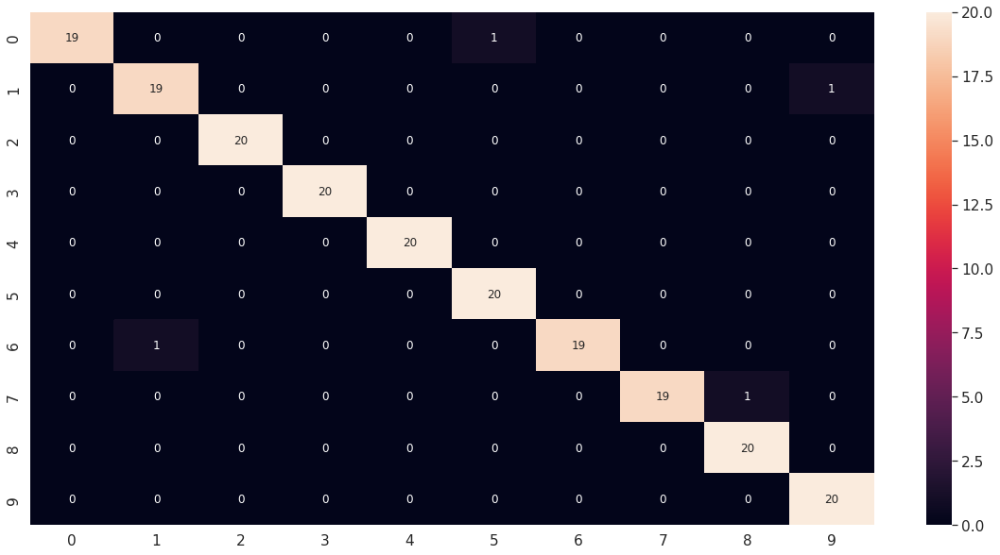

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_12_df_CM = pd.DataFrame(facenet_model_oclu2_12_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_12_report)

              precision    recall  f1-score   support

           1       1.00      0.95      0.97        20
           2       0.95      0.95      0.95        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       0.95      1.00      0.98        20
           7       1.00      0.95      0.97        20
           8       1.00      0.95      0.97        20
           9       0.95      1.00      0.98        20
          10       0.95      1.00      0.98        20

    accuracy                           0.98       200
   macro avg       0.98      0.98      0.98       200
weighted avg       0.98      0.98      0.98       200



#### Modelo 13: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_13 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_13 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_13)
facenet_model_oclu2_13 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_13)
facenet_model_oclu2_13.summary()

Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                           

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_13.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_13 = facenet_model_oclu2_13.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
32/32 [==============================] - 19s 318ms/step - loss: 1.2642 - accuracy: 0.7367 - val_loss: 1.1560 - val_accuracy: 0.8567
Epoch 2/60
32/32 [==============================] - 8s 260ms/step - loss: 0.2740 - accuracy: 0.9891 - val_loss: 0.9626 - val_accuracy: 0.8816
Epoch 3/60
32/32 [==============================] - 8s 260ms/step - loss: 0.2321 - accuracy: 0.9977 - val_loss: 0.7748 - val_accuracy: 0.9003
Epoch 4/60
32/32 [==============================] - 8s 264ms/step - loss: 0.2171 - accuracy: 0.9984 - val_loss: 0.6583 - val_accuracy: 0.9221
Epoch 5/60
32/32 [==============================] - 6s 201ms/step - loss: 0.2544 - accuracy: 0.9906 - val_loss: 0.8091 - val_accuracy: 0.8910
Epoch 6/60
32/32 [==============================] - 6s 202ms/step - loss: 0.2056 - accuracy: 0.9953 - val_loss: 0.7152 - val_accuracy: 0.8972
Epoch 7/60
32/32 [==============================] - 6s 202ms/step - loss: 0.1900 - accuracy: 0.9977 - val_loss: 0.7386 - val_accuracy: 0.9065
Epoch

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_13 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_13.evaluate(testX, testY)

7/7 [==============================] - 0s 47ms/step - loss: 0.1185 - accuracy: 0.9750


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 46ms/step


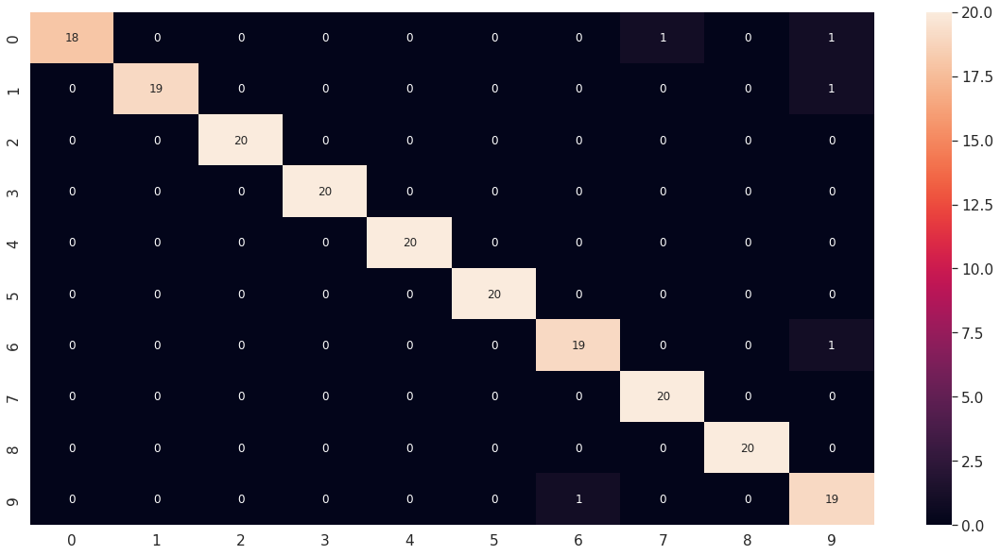

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_13_df_CM = pd.DataFrame(facenet_model_oclu2_13_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_13_report)

              precision    recall  f1-score   support

           1       1.00      0.90      0.95        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       0.95      0.95      0.95        20
           8       0.95      1.00      0.98        20
           9       1.00      1.00      1.00        20
          10       0.86      0.95      0.90        20

    accuracy                           0.97       200
   macro avg       0.98      0.97      0.98       200
weighted avg       0.98      0.97      0.98       200



#### Modelo 14: (BTH = 50, EHS = 50, ValidSplit = 0.2, INI = HeNormal, Dropout=0, REG = L2, OPT = adamax[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_14 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_14 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_14)
facenet_model_oclu2_14 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_14)
facenet_model_oclu2_14.summary()

Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                           

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_oclu2_14.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_14.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_14 = facenet_model_oclu2_14.fit(new_trainX, new_trainY, batch_size=50, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
26/26 [==============================] - 23s 411ms/step - loss: 0.6514 - accuracy: 0.8961 - val_loss: 0.7061 - val_accuracy: 0.8816
Epoch 2/50
26/26 [==============================] - 10s 387ms/step - loss: 0.2223 - accuracy: 0.9992 - val_loss: 0.5947 - val_accuracy: 0.9097
Epoch 3/50
26/26 [==============================] - 8s 323ms/step - loss: 0.2146 - accuracy: 1.0000 - val_loss: 0.5541 - val_accuracy: 0.9190
Epoch 4/50
26/26 [==============================] - 8s 324ms/step - loss: 0.2097 - accuracy: 1.0000 - val_loss: 0.5194 - val_accuracy: 0.9190
Epoch 5/50
26/26 [==============================] - 8s 325ms/step - loss: 0.2059 - accuracy: 1.0000 - val_loss: 0.5010 - val_accuracy: 0.9252
Epoch 6/50
26/26 [==============================] - 8s 322ms/step - loss: 0.2032 - accuracy: 1.0000 - val_loss: 0.4940 - val_accuracy: 0.9315
Epoch 7/50
26/26 [==============================] - 9s 345ms/step - loss: 0.2002 - accuracy: 1.0000 - val_loss: 0.4911 - val_accuracy: 0.9252
Epoc

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_14 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_14.evaluate(testX, testY)

7/7 [==============================] - 0s 46ms/step - loss: 0.2334 - accuracy: 0.9700


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 60ms/step


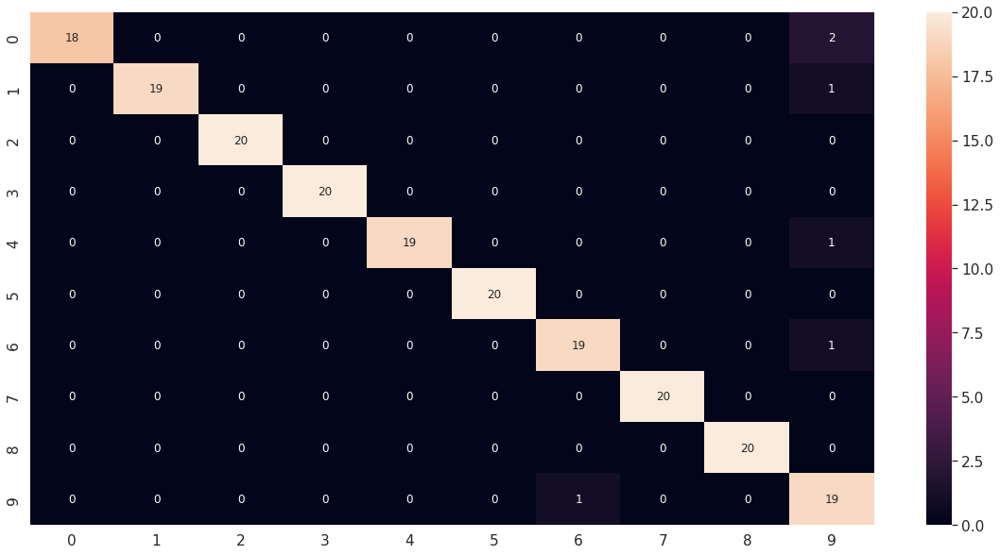

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_14_df_CM = pd.DataFrame(facenet_model_oclu2_14_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_14_report)

              precision    recall  f1-score   support

           1       1.00      0.90      0.95        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      0.95      0.97        20
           6       1.00      1.00      1.00        20
           7       0.95      0.95      0.95        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.79      0.95      0.86        20

    accuracy                           0.97       200
   macro avg       0.97      0.97      0.97       200
weighted avg       0.97      0.97      0.97       200



#### Modelo 15: (BTH = 10, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_oclu2_15 = Dropout(rate=0., name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_oclu2_15 = Dense(11, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_oclu2_15)
facenet_model_oclu2_15 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_oclu2_15)
facenet_model_oclu2_15.summary()

Model: "model_14"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                           

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_oclu2_15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_15.h5', monitor="val_loss", save_best_only=True)
hist_model_oclu2_15 = facenet_model_oclu2_15.fit(new_trainX, new_trainY, batch_size=10, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
128/128 [==============================] - 24s 108ms/step - loss: 0.4673 - accuracy: 0.9352 - val_loss: 0.7553 - val_accuracy: 0.8910
Epoch 2/60
128/128 [==============================] - 10s 74ms/step - loss: 0.3007 - accuracy: 0.9742 - val_loss: 1.3099 - val_accuracy: 0.7882
Epoch 3/60
128/128 [==============================] - 9s 74ms/step - loss: 0.2700 - accuracy: 0.9727 - val_loss: 0.9098 - val_accuracy: 0.8411
Epoch 4/60
128/128 [==============================] - 10s 78ms/step - loss: 0.2106 - accuracy: 0.9820 - val_loss: 1.7534 - val_accuracy: 0.7726
Epoch 5/60
128/128 [==============================] - 10s 75ms/step - loss: 0.1843 - accuracy: 0.9859 - val_loss: 0.7747 - val_accuracy: 0.8660
Epoch 6/60
128/128 [==============================] - 14s 109ms/step - loss: 0.1198 - accuracy: 0.9930 - val_loss: 0.5188 - val_accuracy: 0.9221
Epoch 7/60
128/128 [==============================] - 12s 92ms/step - loss: 0.1231 - accuracy: 0.9937 - val_loss: 0.3887 - val_accuracy

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_oclu2_15 = load_model(path + 'data_reconocimiento1/models_ROF2/facenet_model_ROF2_15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_oclu2_15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_oclu2_15.evaluate(testX, testY)

7/7 [==============================] - 0s 46ms/step - loss: 0.1011 - accuracy: 0.9850


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_oclu2_15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_oclu2_15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

7/7 [==============================] - 2s 45ms/step


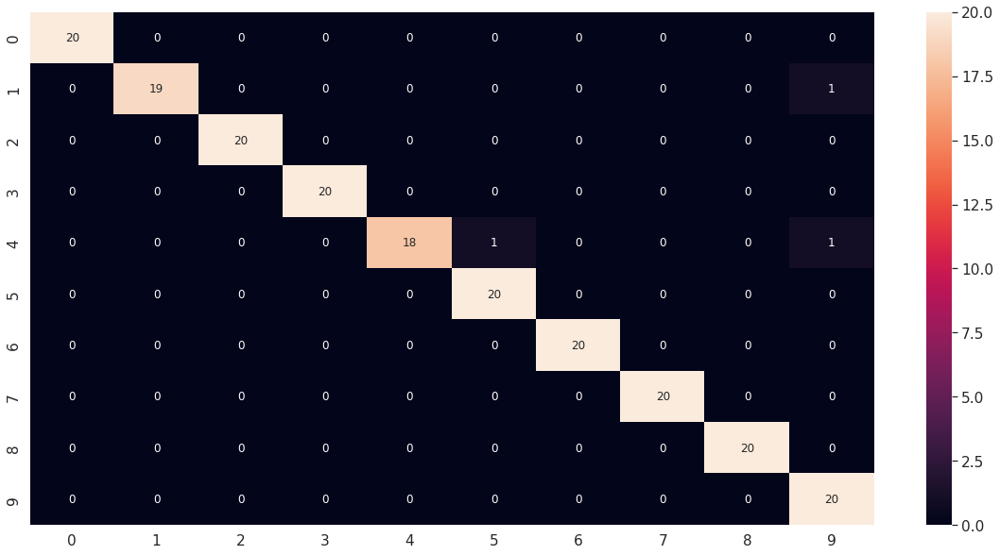

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_oclu2_15_df_CM = pd.DataFrame(facenet_model_oclu2_15_CM, range(10), range(10))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_oclu2_15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_oclu2_15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_oclu2_15_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        20
           2       1.00      0.95      0.97        20
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        20
           5       1.00      0.90      0.95        20
           6       0.95      1.00      0.98        20
           7       1.00      1.00      1.00        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       0.91      1.00      0.95        20

    accuracy                           0.98       200
   macro avg       0.99      0.98      0.98       200
weighted avg       0.99      0.98      0.98       200



## 7. Modelos con base de datos VGG-African para condiciones de etnia

#### Modelo 1: (BTH = 30, EHS = 30, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_1 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_1)
facenet_model_vgg1_1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_1)
facenet_model_vgg1_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_1.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_1 = facenet_model_vgg1_1.fit(new_trainX, new_trainY, batch_size=30, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
70/70 [==============================] - 43s 253ms/step - loss: 2.7845 - accuracy: 0.3269 - val_loss: 5.5662 - val_accuracy: 0.0405
Epoch 2/30
70/70 [==============================] - 11s 163ms/step - loss: 1.5685 - accuracy: 0.6379 - val_loss: 7.9638 - val_accuracy: 0.0405
Epoch 3/30
70/70 [==============================] - 11s 165ms/step - loss: 1.0847 - accuracy: 0.7777 - val_loss: 9.2145 - val_accuracy: 0.0405
Epoch 4/30
70/70 [==============================] - 11s 164ms/step - loss: 0.6422 - accuracy: 0.9132 - val_loss: 6.6341 - val_accuracy: 0.0501
Epoch 5/30
70/70 [==============================] - 11s 159ms/step - loss: 0.4515 - accuracy: 0.9624 - val_loss: 7.2893 - val_accuracy: 0.0405
Epoch 6/30
70/70 [==============================] - 12s 166ms/step - loss: 0.4810 - accuracy: 0.9412 - val_loss: 6.6628 - val_accuracy: 0.0405
Epoch 7/30
70/70 [==============================] - 16s 229ms/step - loss: 0.3212 - accuracy: 0.9894 - val_loss: 4.9435 - val_accuracy: 0.0944

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_1 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_1.evaluate(testX, testY)

32/32 [==============================] - 2s 69ms/step - loss: 0.3312 - accuracy: 0.9430


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


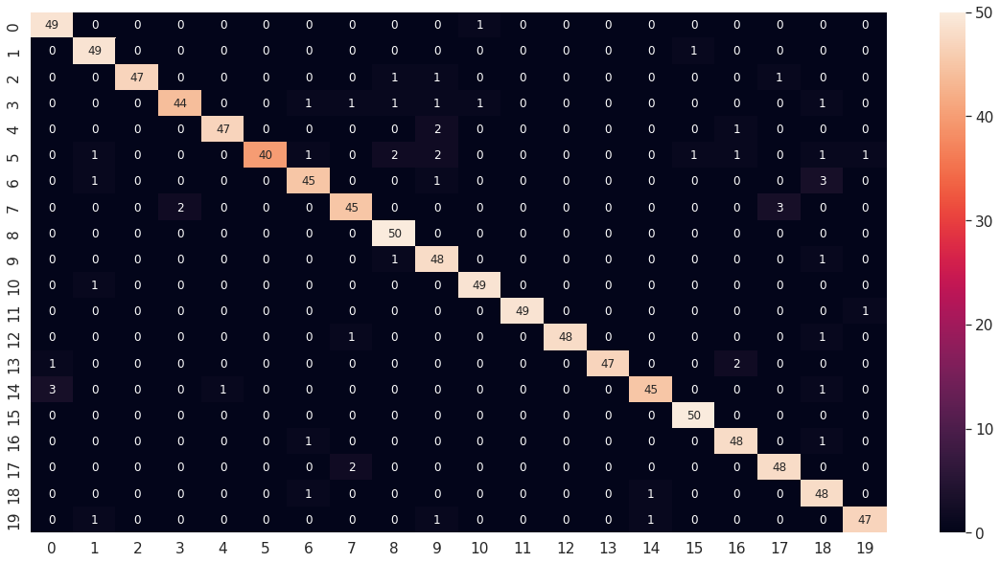

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_1_df_CM = pd.DataFrame(facenet_model_vgg1_1_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_1_report)

              precision    recall  f1-score   support

           1       0.92      0.98      0.95        50
           2       0.92      0.98      0.95        50
           3       1.00      0.94      0.97        50
           4       0.96      0.88      0.92        50
           5       0.98      0.94      0.96        50
           6       1.00      0.80      0.89        50
           7       0.92      0.90      0.91        50
           8       0.92      0.90      0.91        50
           9       0.91      1.00      0.95        50
          10       0.86      0.96      0.91        50
          11       0.96      0.98      0.97        50
          12       1.00      0.98      0.99        50
          13       1.00      0.96      0.98        50
          14       1.00      0.94      0.97        50
          15       0.96      0.90      0.93        50
          16       0.96      1.00      0.98        50
          17       0.92      0.96      0.94        50
          18       0.92    

#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_2 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_2 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_2)
facenet_model_vgg1_2 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_2)
facenet_model_vgg1_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_2.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_2 = facenet_model_vgg1_2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
70/70 [==============================] - 28s 220ms/step - loss: 0.6858 - accuracy: 0.9364 - val_loss: 1.6941 - val_accuracy: 0.6917
Epoch 2/80
70/70 [==============================] - 11s 156ms/step - loss: 0.4416 - accuracy: 0.9735 - val_loss: 2.0921 - val_accuracy: 0.5896
Epoch 3/80
70/70 [==============================] - 15s 213ms/step - loss: 0.3706 - accuracy: 0.9769 - val_loss: 1.3415 - val_accuracy: 0.7187
Epoch 4/80
70/70 [==============================] - 13s 190ms/step - loss: 0.2466 - accuracy: 0.9971 - val_loss: 0.6305 - val_accuracy: 0.8728
Epoch 5/80
70/70 [==============================] - 13s 191ms/step - loss: 0.1905 - accuracy: 0.9995 - val_loss: 0.3795 - val_accuracy: 0.9383
Epoch 6/80
70/70 [==============================] - 13s 191ms/step - loss: 0.1552 - accuracy: 1.0000 - val_loss: 0.3259 - val_accuracy: 0.9461
Epoch 7/80
70/70 [==============================] - 14s 194ms/step - loss: 0.1320 - accuracy: 1.0000 - val_loss: 0.3121 - val_accuracy: 0.9538

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_2 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_2.evaluate(testX, testY)

32/32 [==============================] - 2s 57ms/step - loss: 0.2476 - accuracy: 0.9480


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 4s 53ms/step


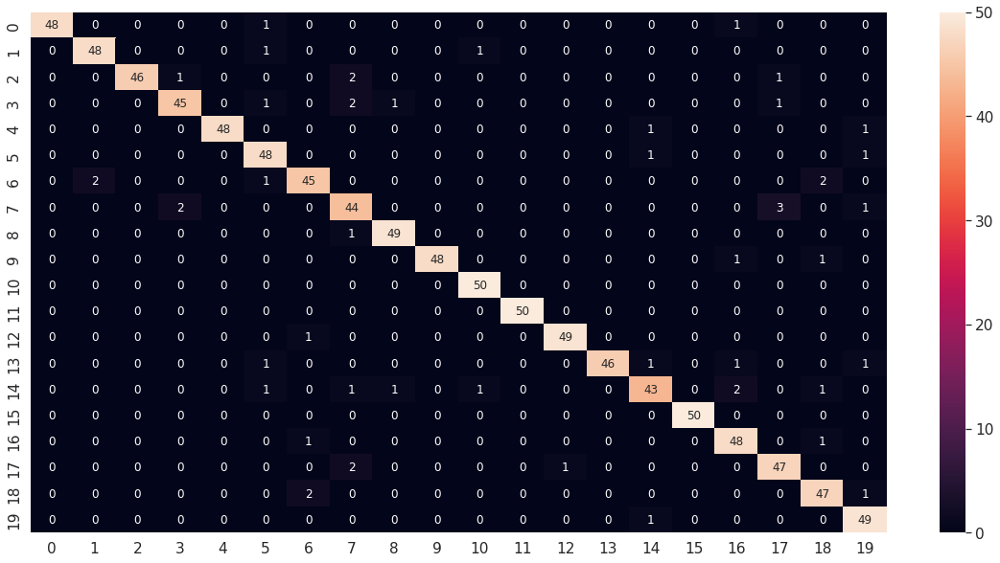

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_2_df_CM = pd.DataFrame(facenet_model_vgg1_2_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_2_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       0.96      0.96      0.96        50
           3       1.00      0.92      0.96        50
           4       0.94      0.90      0.92        50
           5       1.00      0.96      0.98        50
           6       0.89      0.96      0.92        50
           7       0.92      0.90      0.91        50
           8       0.85      0.88      0.86        50
           9       0.96      0.98      0.97        50
          10       1.00      0.96      0.98        50
          11       0.96      1.00      0.98        50
          12       1.00      1.00      1.00        50
          13       0.98      0.98      0.98        50
          14       1.00      0.92      0.96        50
          15       0.91      0.86      0.89        50
          16       1.00      1.00      1.00        50
          17       0.91      0.96      0.93        50
          18       0.90    

#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_3 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_3 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_3)
facenet_model_vgg1_3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_3)
facenet_model_vgg1_3.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_3.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_3 = facenet_model_vgg1_3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
70/70 [==============================] - 28s 236ms/step - loss: 0.7077 - accuracy: 0.9354 - val_loss: 0.8487 - val_accuracy: 0.8902
Epoch 2/50
70/70 [==============================] - 16s 229ms/step - loss: 0.3666 - accuracy: 0.9976 - val_loss: 0.7620 - val_accuracy: 0.9094
Epoch 3/50
70/70 [==============================] - 11s 160ms/step - loss: 0.3303 - accuracy: 0.9894 - val_loss: 0.7710 - val_accuracy: 0.8825
Epoch 4/50
70/70 [==============================] - 15s 222ms/step - loss: 0.2487 - accuracy: 0.9971 - val_loss: 0.6134 - val_accuracy: 0.8902
Epoch 5/50
70/70 [==============================] - 12s 166ms/step - loss: 0.2260 - accuracy: 0.9894 - val_loss: 0.6810 - val_accuracy: 0.8748
Epoch 6/50
70/70 [==============================] - 16s 229ms/step - loss: 0.1690 - accuracy: 0.9990 - val_loss: 0.3774 - val_accuracy: 0.9422
Epoch 7/50
70/70 [==============================] - 15s 215ms/step - loss: 0.1385 - accuracy: 1.0000 - val_loss: 0.2849 - val_accuracy: 0.9499

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_3 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_3.evaluate(testX, testY)

32/32 [==============================] - 2s 57ms/step - loss: 0.2785 - accuracy: 0.9460


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 4s 52ms/step


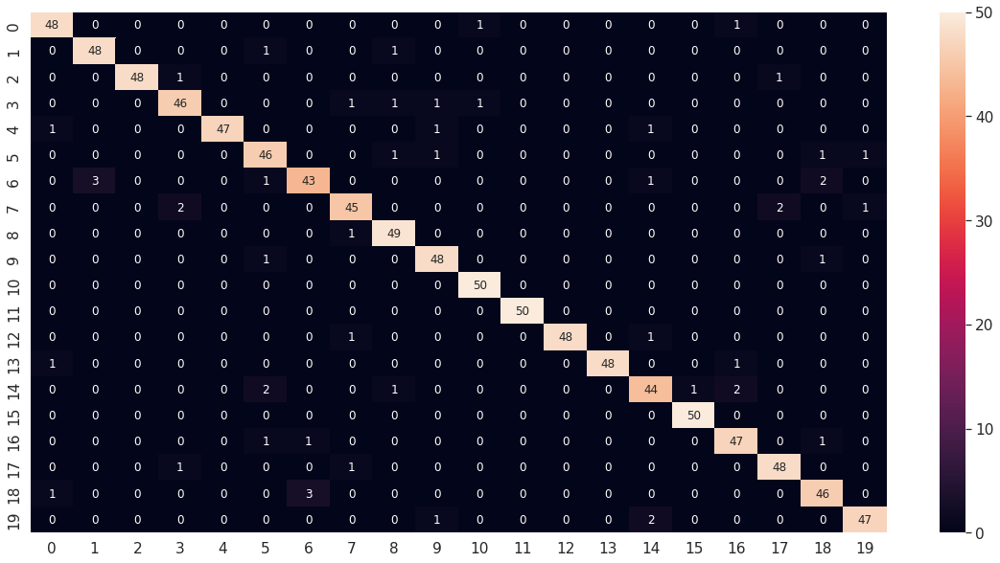

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_3_df_CM = pd.DataFrame(facenet_model_vgg1_3_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_3_report)

              precision    recall  f1-score   support

           1       0.94      0.96      0.95        50
           2       0.94      0.96      0.95        50
           3       1.00      0.96      0.98        50
           4       0.92      0.92      0.92        50
           5       1.00      0.94      0.97        50
           6       0.88      0.92      0.90        50
           7       0.91      0.86      0.89        50
           8       0.92      0.90      0.91        50
           9       0.92      0.98      0.95        50
          10       0.92      0.96      0.94        50
          11       0.96      1.00      0.98        50
          12       1.00      1.00      1.00        50
          13       1.00      0.96      0.98        50
          14       1.00      0.96      0.98        50
          15       0.90      0.88      0.89        50
          16       0.98      1.00      0.99        50
          17       0.92      0.94      0.93        50
          18       0.94    

#### Modelo 4: (BTH = 20, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.5 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_4 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_4 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_4)
facenet_model_vgg1_4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_4)
facenet_model_vgg1_4.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_4.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_4 = facenet_model_vgg1_4.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
104/104 [==============================] - 33s 190ms/step - loss: 1.0621 - accuracy: 0.8433 - val_loss: 0.7910 - val_accuracy: 0.9056
Epoch 2/30
104/104 [==============================] - 17s 160ms/step - loss: 0.3990 - accuracy: 0.9981 - val_loss: 0.7345 - val_accuracy: 0.8998
Epoch 3/30
104/104 [==============================] - 13s 121ms/step - loss: 0.3574 - accuracy: 0.9908 - val_loss: 1.4605 - val_accuracy: 0.7534
Epoch 4/30
104/104 [==============================] - 12s 119ms/step - loss: 0.2890 - accuracy: 0.9957 - val_loss: 0.7490 - val_accuracy: 0.8671
Epoch 5/30
104/104 [==============================] - 16s 158ms/step - loss: 0.2334 - accuracy: 0.9961 - val_loss: 0.6293 - val_accuracy: 0.8844
Epoch 6/30
104/104 [==============================] - 13s 121ms/step - loss: 0.2212 - accuracy: 0.9928 - val_loss: 0.7807 - val_accuracy: 0.8478
Epoch 7/30
104/104 [==============================] - 16s 158ms/step - loss: 0.1760 - accuracy: 0.9971 - val_loss: 0.5033 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_4 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_4.evaluate(testX, testY)

32/32 [==============================] - 2s 53ms/step - loss: 0.2697 - accuracy: 0.9570


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


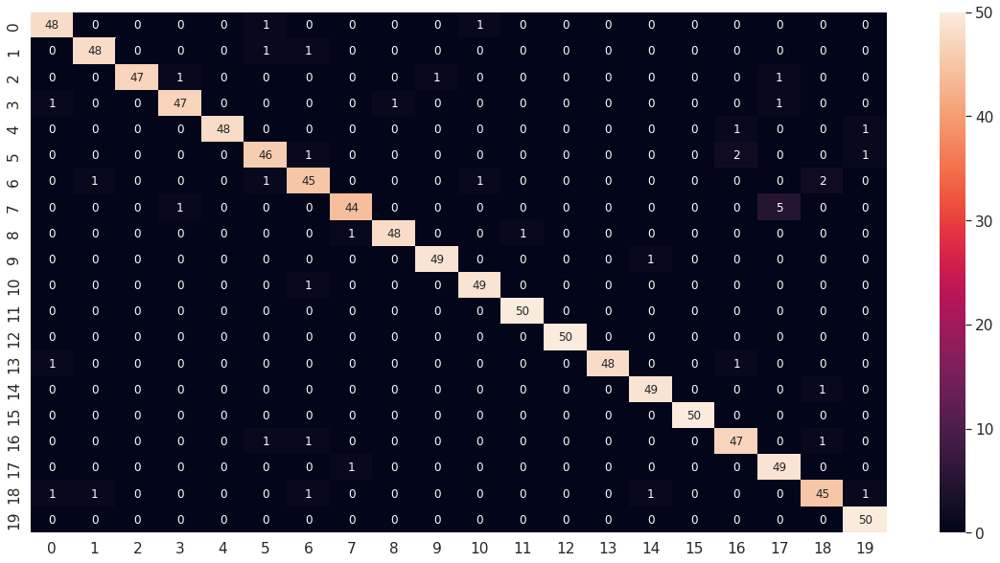

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_4_df_CM = pd.DataFrame(facenet_model_vgg1_4_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_4_report)

              precision    recall  f1-score   support

           1       0.94      0.96      0.95        50
           2       0.96      0.96      0.96        50
           3       1.00      0.94      0.97        50
           4       0.96      0.94      0.95        50
           5       1.00      0.96      0.98        50
           6       0.92      0.92      0.92        50
           7       0.90      0.90      0.90        50
           8       0.96      0.88      0.92        50
           9       0.98      0.96      0.97        50
          10       0.98      0.98      0.98        50
          11       0.96      0.98      0.97        50
          12       0.98      1.00      0.99        50
          13       1.00      1.00      1.00        50
          14       1.00      0.96      0.98        50
          15       0.96      0.98      0.97        50
          16       1.00      1.00      1.00        50
          17       0.92      0.94      0.93        50
          18       0.88    

#### Modelo 5: (BTH = 20, EHS = 60, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_5 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_5)
facenet_model_vgg1_5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_5)
facenet_model_vgg1_5.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_5.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_5 = facenet_model_vgg1_5.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
104/104 [==============================] - 39s 173ms/step - loss: 3.9056 - accuracy: 0.1075 - val_loss: 3.8774 - val_accuracy: 0.0424
Epoch 2/60
104/104 [==============================] - 14s 137ms/step - loss: 3.1139 - accuracy: 0.2527 - val_loss: 3.7955 - val_accuracy: 0.0636
Epoch 3/60
104/104 [==============================] - 12s 119ms/step - loss: 2.3087 - accuracy: 0.4233 - val_loss: 12.8442 - val_accuracy: 0.0424
Epoch 4/60
104/104 [==============================] - 12s 119ms/step - loss: 1.6247 - accuracy: 0.6051 - val_loss: 5.1124 - val_accuracy: 0.0848
Epoch 5/60
104/104 [==============================] - 12s 119ms/step - loss: 1.0993 - accuracy: 0.7531 - val_loss: 4.0727 - val_accuracy: 0.1657
Epoch 6/60
104/104 [==============================] - 16s 151ms/step - loss: 0.8366 - accuracy: 0.8245 - val_loss: 2.9795 - val_accuracy: 0.3006
Epoch 7/60
104/104 [==============================] - 15s 146ms/step - loss: 0.6174 - accuracy: 0.8910 - val_loss: 2.5199 - val_a

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_5 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_5.evaluate(testX, testY)

32/32 [==============================] - 2s 76ms/step - loss: 0.2565 - accuracy: 0.9540


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 4s 52ms/step


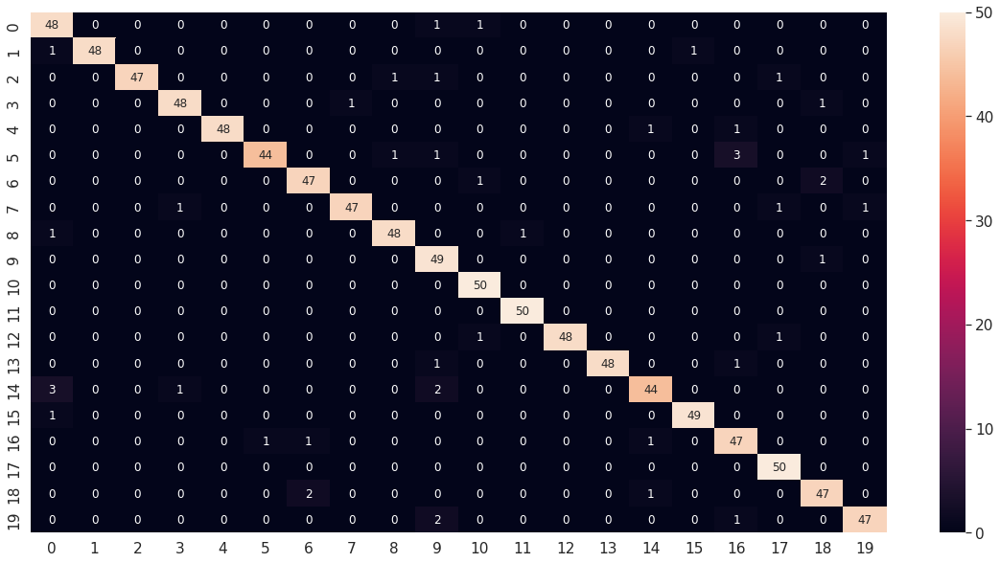

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_5_df_CM = pd.DataFrame(facenet_model_vgg1_5_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_5_report)

              precision    recall  f1-score   support

           1       0.89      0.96      0.92        50
           2       1.00      0.96      0.98        50
           3       1.00      0.94      0.97        50
           4       0.96      0.96      0.96        50
           5       1.00      0.96      0.98        50
           6       0.98      0.88      0.93        50
           7       0.94      0.94      0.94        50
           8       0.98      0.94      0.96        50
           9       0.96      0.96      0.96        50
          10       0.86      0.98      0.92        50
          11       0.94      1.00      0.97        50
          12       0.98      1.00      0.99        50
          13       1.00      0.96      0.98        50
          14       1.00      0.96      0.98        50
          15       0.94      0.88      0.91        50
          16       0.98      0.98      0.98        50
          17       0.89      0.94      0.91        50
          18       0.94    

#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_6 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_6 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_6)
facenet_model_vgg1_6 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_6)
facenet_model_vgg1_6.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_6.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_6 = facenet_model_vgg1_6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
52/52 [==============================] - 33s 342ms/step - loss: 1.0227 - accuracy: 0.8414 - val_loss: 1.0413 - val_accuracy: 0.8555
Epoch 2/60
52/52 [==============================] - 13s 250ms/step - loss: 0.4028 - accuracy: 0.9981 - val_loss: 0.9004 - val_accuracy: 0.8940
Epoch 3/60
52/52 [==============================] - 13s 246ms/step - loss: 0.3699 - accuracy: 0.9966 - val_loss: 0.7376 - val_accuracy: 0.9152
Epoch 4/60
52/52 [==============================] - 11s 204ms/step - loss: 0.3275 - accuracy: 0.9952 - val_loss: 0.8656 - val_accuracy: 0.8516
Epoch 5/60
52/52 [==============================] - 11s 213ms/step - loss: 0.3284 - accuracy: 0.9879 - val_loss: 1.0538 - val_accuracy: 0.8035
Epoch 6/60
52/52 [==============================] - 11s 203ms/step - loss: 0.2608 - accuracy: 0.9937 - val_loss: 0.9343 - val_accuracy: 0.8420
Epoch 7/60
52/52 [==============================] - 14s 268ms/step - loss: 0.2150 - accuracy: 0.9986 - val_loss: 0.6976 - val_accuracy: 0.8671

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_6 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_6.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2599 - accuracy: 0.9530


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

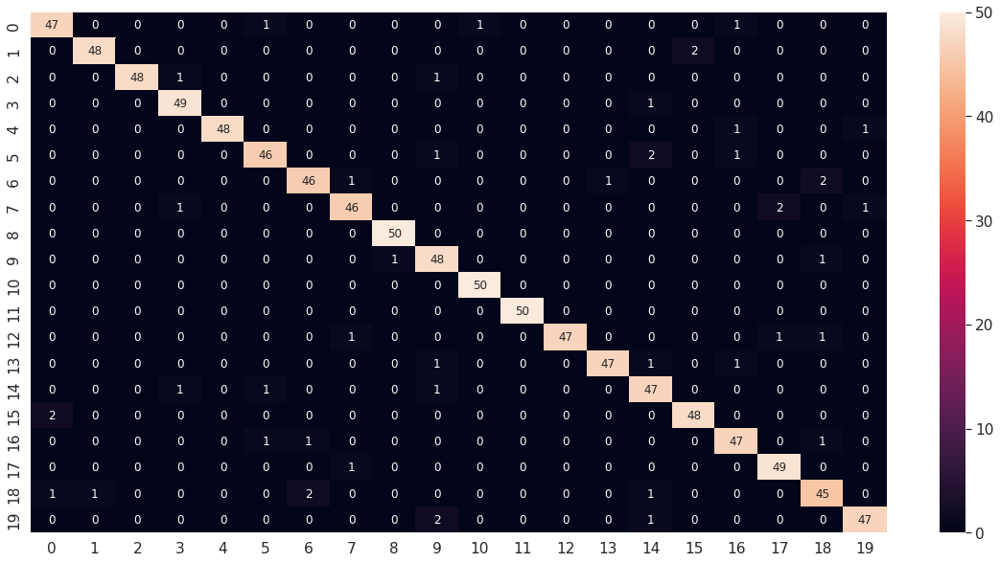

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_6_df_CM = pd.DataFrame(facenet_model_vgg1_6_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_6_report)

              precision    recall  f1-score   support

           1       0.94      0.94      0.94        50
           2       0.98      0.96      0.97        50
           3       1.00      0.96      0.98        50
           4       0.94      0.98      0.96        50
           5       1.00      0.96      0.98        50
           6       0.94      0.92      0.93        50
           7       0.94      0.92      0.93        50
           8       0.94      0.92      0.93        50
           9       0.98      1.00      0.99        50
          10       0.89      0.96      0.92        50
          11       0.98      1.00      0.99        50
          12       1.00      1.00      1.00        50
          13       1.00      0.94      0.97        50
          14       0.98      0.94      0.96        50
          15       0.89      0.94      0.91        50
          16       0.96      0.96      0.96        50
          17       0.92      0.94      0.93        50
          18       0.94    

#### Modelo 7: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_7 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_7 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_7)
facenet_model_vgg1_7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_7)
facenet_model_vgg1_7.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_7.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_7 = facenet_model_vgg1_7.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
70/70 [==============================] - 30s 247ms/step - loss: 0.7998 - accuracy: 0.9151 - val_loss: 0.9976 - val_accuracy: 0.8651
Epoch 2/50
70/70 [==============================] - 14s 196ms/step - loss: 0.4482 - accuracy: 0.9846 - val_loss: 0.8447 - val_accuracy: 0.8825
Epoch 3/50
70/70 [==============================] - 12s 164ms/step - loss: 0.3704 - accuracy: 0.9884 - val_loss: 1.0898 - val_accuracy: 0.8324
Epoch 4/50
70/70 [==============================] - 15s 215ms/step - loss: 0.3070 - accuracy: 0.9913 - val_loss: 0.6870 - val_accuracy: 0.8844
Epoch 5/50
70/70 [==============================] - 14s 193ms/step - loss: 0.2822 - accuracy: 0.9875 - val_loss: 0.6707 - val_accuracy: 0.8805
Epoch 6/50
70/70 [==============================] - 13s 192ms/step - loss: 0.1963 - accuracy: 0.9990 - val_loss: 0.4881 - val_accuracy: 0.9191
Epoch 7/50
70/70 [==============================] - 14s 194ms/step - loss: 0.1697 - accuracy: 0.9961 - val_loss: 0.4555 - val_accuracy: 0.9249

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_7 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_7.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.3245 - accuracy: 0.9380


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


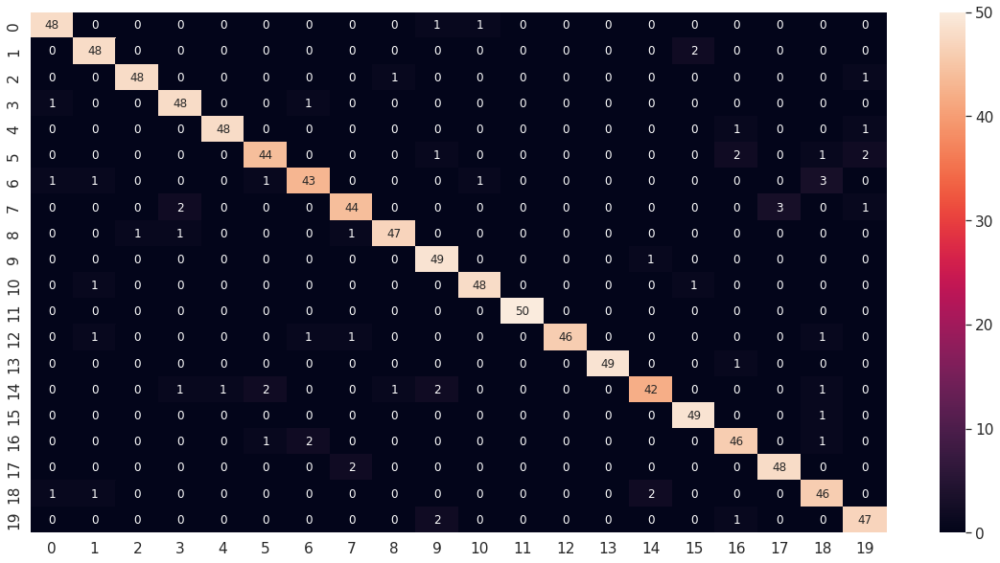

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_7_df_CM = pd.DataFrame(facenet_model_vgg1_7_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_7_report)

              precision    recall  f1-score   support

           1       0.94      0.96      0.95        50
           2       0.92      0.96      0.94        50
           3       0.98      0.96      0.97        50
           4       0.92      0.96      0.94        50
           5       0.98      0.96      0.97        50
           6       0.92      0.88      0.90        50
           7       0.91      0.86      0.89        50
           8       0.92      0.88      0.90        50
           9       0.96      0.94      0.95        50
          10       0.89      0.98      0.93        50
          11       0.96      0.96      0.96        50
          12       1.00      1.00      1.00        50
          13       1.00      0.92      0.96        50
          14       1.00      0.98      0.99        50
          15       0.93      0.84      0.88        50
          16       0.94      0.98      0.96        50
          17       0.90      0.92      0.91        50
          18       0.94    

#### Modelo 8: (BTH = 20, EHS = 30, ValidSplit = 0.2, Dropout = 0,2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_8 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_8 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_8)
facenet_model_vgg1_8 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_8)
facenet_model_vgg1_8.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_8.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_8.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_8 = facenet_model_vgg1_8.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
104/104 [==============================] - 31s 167ms/step - loss: 0.6857 - accuracy: 0.9402 - val_loss: 0.8766 - val_accuracy: 0.8671
Epoch 2/30
104/104 [==============================] - 13s 122ms/step - loss: 0.3899 - accuracy: 0.9846 - val_loss: 0.8855 - val_accuracy: 0.8497
Epoch 3/30
104/104 [==============================] - 16s 154ms/step - loss: 0.3073 - accuracy: 0.9846 - val_loss: 0.7387 - val_accuracy: 0.8786
Epoch 4/30
104/104 [==============================] - 17s 160ms/step - loss: 0.2050 - accuracy: 0.9986 - val_loss: 0.4965 - val_accuracy: 0.9094
Epoch 5/30
104/104 [==============================] - 16s 158ms/step - loss: 0.1537 - accuracy: 1.0000 - val_loss: 0.3845 - val_accuracy: 0.9306
Epoch 6/30
104/104 [==============================] - 16s 152ms/step - loss: 0.1284 - accuracy: 1.0000 - val_loss: 0.3609 - val_accuracy: 0.9306
Epoch 7/30
104/104 [==============================] - 16s 154ms/step - loss: 0.1141 - accuracy: 1.0000 - val_loss: 0.3461 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_8 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_8.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.3093 - accuracy: 0.9520


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


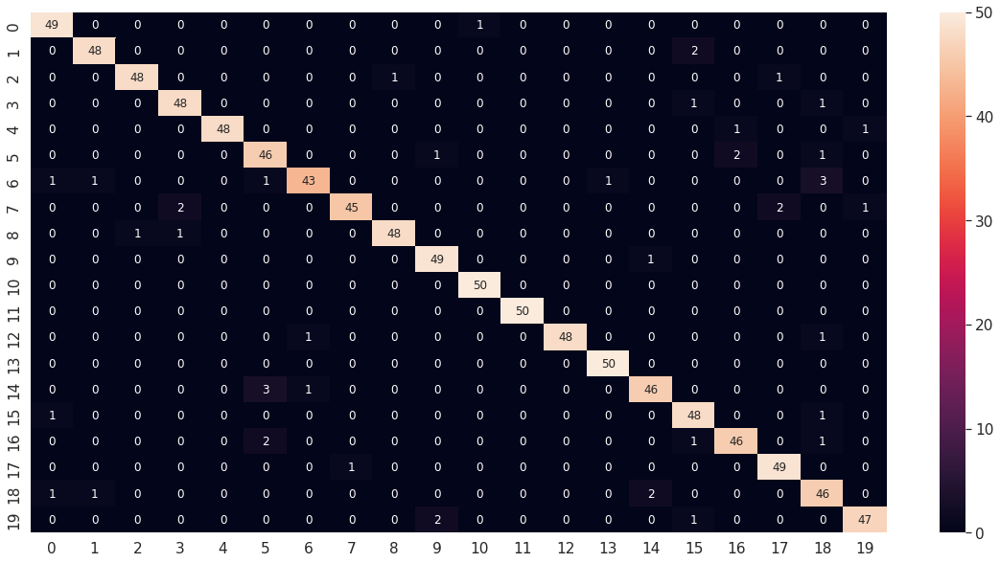

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_8_df_CM = pd.DataFrame(facenet_model_vgg1_8_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_8_report)

              precision    recall  f1-score   support

           1       0.94      0.98      0.96        50
           2       0.96      0.96      0.96        50
           3       0.98      0.96      0.97        50
           4       0.94      0.96      0.95        50
           5       1.00      0.96      0.98        50
           6       0.88      0.92      0.90        50
           7       0.96      0.86      0.91        50
           8       0.98      0.90      0.94        50
           9       0.98      0.96      0.97        50
          10       0.94      0.98      0.96        50
          11       0.98      1.00      0.99        50
          12       1.00      1.00      1.00        50
          13       1.00      0.96      0.98        50
          14       0.98      1.00      0.99        50
          15       0.94      0.92      0.93        50
          16       0.91      0.96      0.93        50
          17       0.94      0.92      0.93        50
          18       0.94    

#### Modelo 9: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_9 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_9 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_9)
facenet_model_vgg1_9 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_9)
facenet_model_vgg1_9.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_9.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_9 = facenet_model_vgg1_9.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
104/104 [==============================] - 26s 155ms/step - loss: 0.7448 - accuracy: 0.9291 - val_loss: 0.8362 - val_accuracy: 0.8921
Epoch 2/60
104/104 [==============================] - 12s 117ms/step - loss: 0.3620 - accuracy: 0.9961 - val_loss: 1.2305 - val_accuracy: 0.8131
Epoch 3/60
104/104 [==============================] - 12s 117ms/step - loss: 0.3393 - accuracy: 0.9831 - val_loss: 1.8011 - val_accuracy: 0.6859
Epoch 4/60
104/104 [==============================] - 16s 152ms/step - loss: 0.2243 - accuracy: 0.9957 - val_loss: 0.6770 - val_accuracy: 0.8902
Epoch 5/60
104/104 [==============================] - 16s 150ms/step - loss: 0.1969 - accuracy: 0.9918 - val_loss: 0.6621 - val_accuracy: 0.8767
Epoch 6/60
104/104 [==============================] - 16s 150ms/step - loss: 0.1567 - accuracy: 0.9966 - val_loss: 0.4623 - val_accuracy: 0.9210
Epoch 7/60
104/104 [==============================] - 16s 149ms/step - loss: 0.1217 - accuracy: 1.0000 - val_loss: 0.4262 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_9 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_9.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2675 - accuracy: 0.9520


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

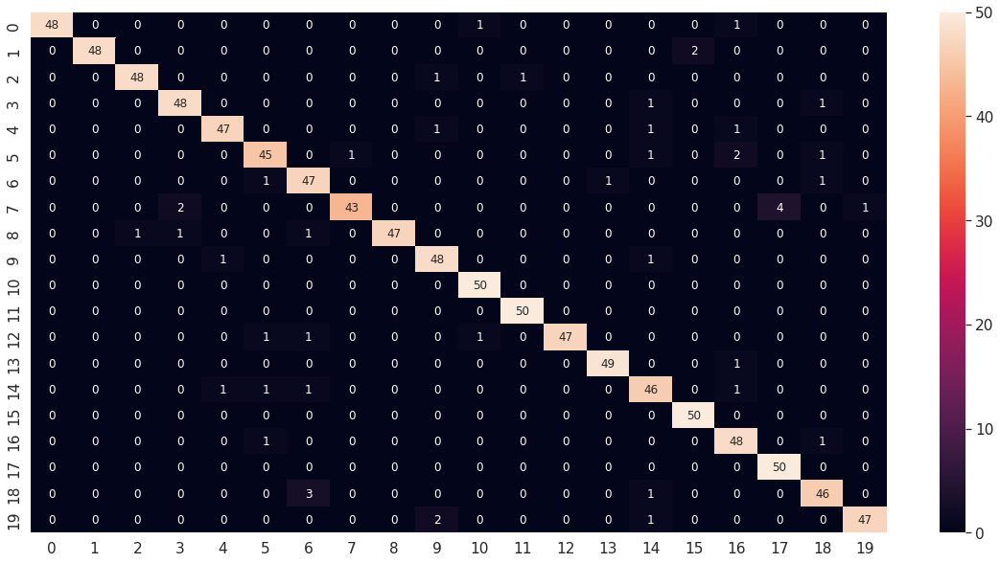

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_9_df_CM = pd.DataFrame(facenet_model_vgg1_9_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_9_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       1.00      0.96      0.98        50
           3       0.98      0.96      0.97        50
           4       0.94      0.96      0.95        50
           5       0.96      0.94      0.95        50
           6       0.92      0.90      0.91        50
           7       0.89      0.94      0.91        50
           8       0.98      0.86      0.91        50
           9       1.00      0.94      0.97        50
          10       0.92      0.96      0.94        50
          11       0.96      1.00      0.98        50
          12       0.98      1.00      0.99        50
          13       1.00      0.94      0.97        50
          14       0.98      0.98      0.98        50
          15       0.88      0.92      0.90        50
          16       0.96      1.00      0.98        50
          17       0.89      0.96      0.92        50
          18       0.93    

#### Modelo 10: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_10 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_10 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_10)
facenet_model_vgg1_10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_10)
facenet_model_vgg1_10.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg1_10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_10.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_10 = facenet_model_vgg1_10.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
70/70 [==============================] - 26s 225ms/step - loss: 1.3629 - accuracy: 0.7425 - val_loss: 0.9017 - val_accuracy: 0.8651
Epoch 2/50
70/70 [==============================] - 14s 195ms/step - loss: 0.5258 - accuracy: 0.9928 - val_loss: 0.7925 - val_accuracy: 0.8960
Epoch 3/50
70/70 [==============================] - 16s 222ms/step - loss: 0.4601 - accuracy: 0.9990 - val_loss: 0.7529 - val_accuracy: 0.9037
Epoch 4/50
70/70 [==============================] - 15s 218ms/step - loss: 0.4358 - accuracy: 0.9986 - val_loss: 0.7300 - val_accuracy: 0.9171
Epoch 5/50
70/70 [==============================] - 14s 195ms/step - loss: 0.4144 - accuracy: 1.0000 - val_loss: 0.7111 - val_accuracy: 0.9210
Epoch 6/50
70/70 [==============================] - 14s 197ms/step - loss: 0.4044 - accuracy: 0.9990 - val_loss: 0.6925 - val_accuracy: 0.9287
Epoch 7/50
70/70 [==============================] - 14s 196ms/step - loss: 0.3892 - accuracy: 0.9995 - val_loss: 0.6860 - val_accuracy: 0.9249

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_10 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_10.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.3408 - accuracy: 0.9440


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


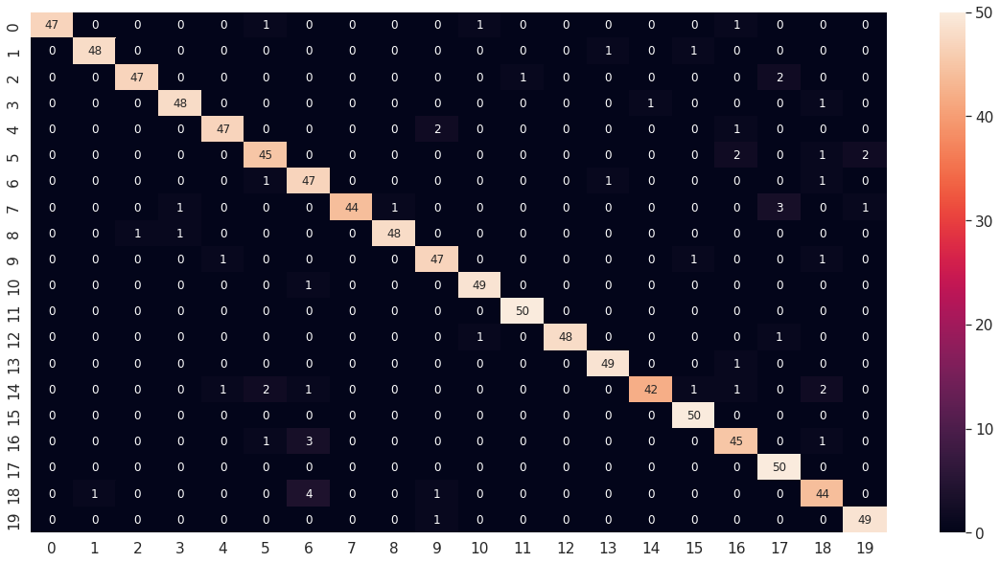

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_10_df_CM = pd.DataFrame(facenet_model_vgg1_10_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_10_report)

              precision    recall  f1-score   support

           1       1.00      0.94      0.97        50
           2       0.98      0.96      0.97        50
           3       0.98      0.94      0.96        50
           4       0.96      0.96      0.96        50
           5       0.96      0.94      0.95        50
           6       0.90      0.90      0.90        50
           7       0.84      0.94      0.89        50
           8       1.00      0.88      0.94        50
           9       0.98      0.96      0.97        50
          10       0.92      0.94      0.93        50
          11       0.96      0.98      0.97        50
          12       0.98      1.00      0.99        50
          13       1.00      0.96      0.98        50
          14       0.96      0.98      0.97        50
          15       0.98      0.84      0.90        50
          16       0.94      1.00      0.97        50
          17       0.88      0.90      0.89        50
          18       0.89    

#### Modelo 11: (BTH = 10, EHS = 50, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_11 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_11 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_11)
facenet_model_vgg1_11 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_11)
facenet_model_vgg1_11.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_11.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_11.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_11 = facenet_model_vgg1_11.fit(new_trainX, new_trainY, batch_size=10, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
208/208 [==============================] - 33s 101ms/step - loss: 0.7060 - accuracy: 0.9330 - val_loss: 1.6082 - val_accuracy: 0.7803
Epoch 2/50
208/208 [==============================] - 21s 101ms/step - loss: 0.4327 - accuracy: 0.9725 - val_loss: 1.0145 - val_accuracy: 0.8651
Epoch 3/50
208/208 [==============================] - 22s 106ms/step - loss: 0.3175 - accuracy: 0.9802 - val_loss: 0.6979 - val_accuracy: 0.8805
Epoch 4/50
208/208 [==============================] - 17s 81ms/step - loss: 0.2074 - accuracy: 0.9899 - val_loss: 0.8278 - val_accuracy: 0.8497
Epoch 5/50
208/208 [==============================] - 19s 93ms/step - loss: 0.1783 - accuracy: 0.9937 - val_loss: 0.5325 - val_accuracy: 0.9075
Epoch 6/50
208/208 [==============================] - 19s 92ms/step - loss: 0.1618 - accuracy: 0.9928 - val_loss: 0.4403 - val_accuracy: 0.9229
Epoch 7/50
208/208 [==============================] - 20s 96ms/step - loss: 0.1232 - accuracy: 0.9986 - val_loss: 0.4245 - val_accura

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_11 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_11.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2654 - accuracy: 0.9550


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


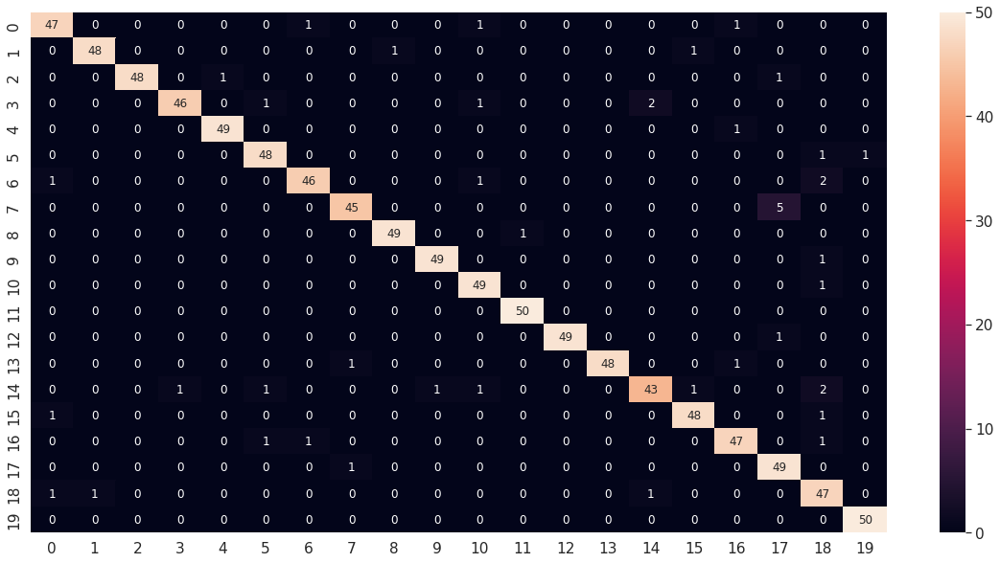

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_11_df_CM = pd.DataFrame(facenet_model_vgg1_11_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_11_report)

              precision    recall  f1-score   support

           1       0.94      0.94      0.94        50
           2       0.98      0.96      0.97        50
           3       1.00      0.96      0.98        50
           4       0.98      0.92      0.95        50
           5       0.98      0.98      0.98        50
           6       0.94      0.96      0.95        50
           7       0.96      0.92      0.94        50
           8       0.96      0.90      0.93        50
           9       0.98      0.98      0.98        50
          10       0.98      0.98      0.98        50
          11       0.92      0.98      0.95        50
          12       0.98      1.00      0.99        50
          13       1.00      0.98      0.99        50
          14       1.00      0.96      0.98        50
          15       0.93      0.86      0.90        50
          16       0.96      0.96      0.96        50
          17       0.94      0.94      0.94        50
          18       0.88    

#### Modelo 12: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.2, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_12 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_12 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_12)
facenet_model_vgg1_12 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_12)
facenet_model_vgg1_12.summary()

Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_12.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_12 = facenet_model_vgg1_12.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
104/104 [==============================] - 28s 169ms/step - loss: 0.9032 - accuracy: 0.8920 - val_loss: 0.7321 - val_accuracy: 0.9191
Epoch 2/60
104/104 [==============================] - 12s 119ms/step - loss: 0.3898 - accuracy: 0.9990 - val_loss: 1.1048 - val_accuracy: 0.8304
Epoch 3/60
104/104 [==============================] - 12s 119ms/step - loss: 0.3404 - accuracy: 0.9947 - val_loss: 0.7840 - val_accuracy: 0.8882
Epoch 4/60
104/104 [==============================] - 16s 156ms/step - loss: 0.2731 - accuracy: 0.9957 - val_loss: 0.6866 - val_accuracy: 0.8979
Epoch 5/60
104/104 [==============================] - 14s 137ms/step - loss: 0.2053 - accuracy: 0.9990 - val_loss: 0.4654 - val_accuracy: 0.9364
Epoch 6/60
104/104 [==============================] - 14s 137ms/step - loss: 0.1676 - accuracy: 0.9986 - val_loss: 0.4054 - val_accuracy: 0.9287
Epoch 7/60
104/104 [==============================] - 16s 150ms/step - loss: 0.1415 - accuracy: 1.0000 - val_loss: 0.3885 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_12 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_12.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2832 - accuracy: 0.9550


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

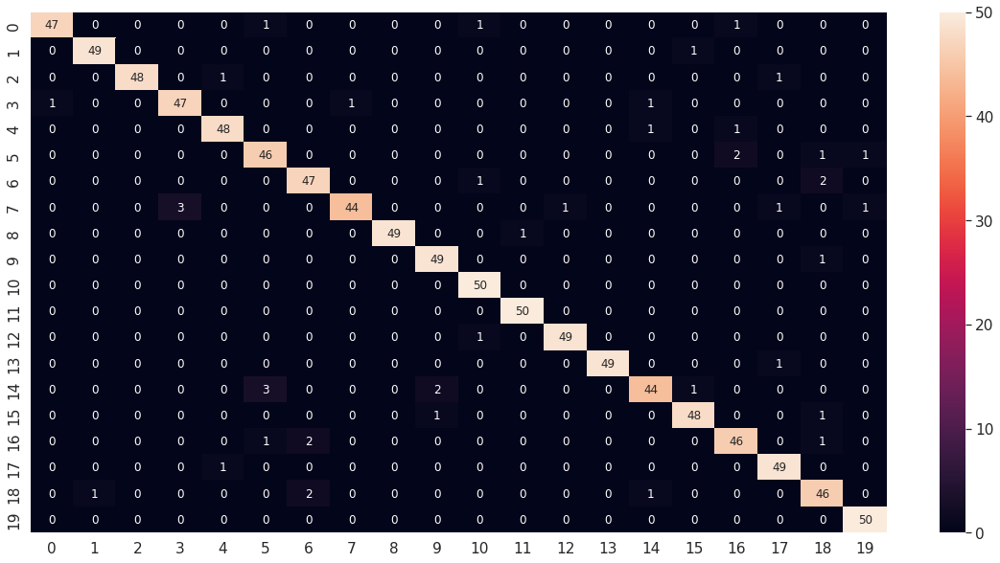

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_12_df_CM = pd.DataFrame(facenet_model_vgg1_12_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_12_report)

              precision    recall  f1-score   support

           1       0.98      0.94      0.96        50
           2       0.98      0.98      0.98        50
           3       1.00      0.96      0.98        50
           4       0.94      0.94      0.94        50
           5       0.96      0.96      0.96        50
           6       0.90      0.92      0.91        50
           7       0.92      0.94      0.93        50
           8       0.98      0.88      0.93        50
           9       1.00      0.98      0.99        50
          10       0.94      0.98      0.96        50
          11       0.94      1.00      0.97        50
          12       0.98      1.00      0.99        50
          13       0.98      0.98      0.98        50
          14       1.00      0.98      0.99        50
          15       0.94      0.88      0.91        50
          16       0.96      0.96      0.96        50
          17       0.92      0.92      0.92        50
          18       0.94    

#### Modelo 13: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.7, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_13 = Dropout(rate=0.7, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_13 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_13)
facenet_model_vgg1_13 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_13)
facenet_model_vgg1_13.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_13.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_13 = facenet_model_vgg1_13.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
52/52 [==============================] - 39s 338ms/step - loss: 4.3863 - accuracy: 0.1022 - val_loss: 3.5384 - val_accuracy: 0.0424
Epoch 2/60
52/52 [==============================] - 10s 199ms/step - loss: 3.7665 - accuracy: 0.1393 - val_loss: 11.7667 - val_accuracy: 0.0443
Epoch 3/60
52/52 [==============================] - 10s 201ms/step - loss: 3.4900 - accuracy: 0.1996 - val_loss: 69.0305 - val_accuracy: 0.0443
Epoch 4/60
52/52 [==============================] - 10s 200ms/step - loss: 2.9285 - accuracy: 0.3076 - val_loss: 6.3077 - val_accuracy: 0.0482
Epoch 5/60
52/52 [==============================] - 11s 203ms/step - loss: 2.8491 - accuracy: 0.3443 - val_loss: 8.3948 - val_accuracy: 0.0405
Epoch 6/60
52/52 [==============================] - 11s 204ms/step - loss: 2.1247 - accuracy: 0.4889 - val_loss: 5.2111 - val_accuracy: 0.0443
Epoch 7/60
52/52 [==============================] - 11s 205ms/step - loss: 1.4457 - accuracy: 0.6625 - val_loss: 4.5336 - val_accuracy: 0.06

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_13 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_13.evaluate(testX, testY)

32/32 [==============================] - 2s 65ms/step - loss: 0.3095 - accuracy: 0.9420


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

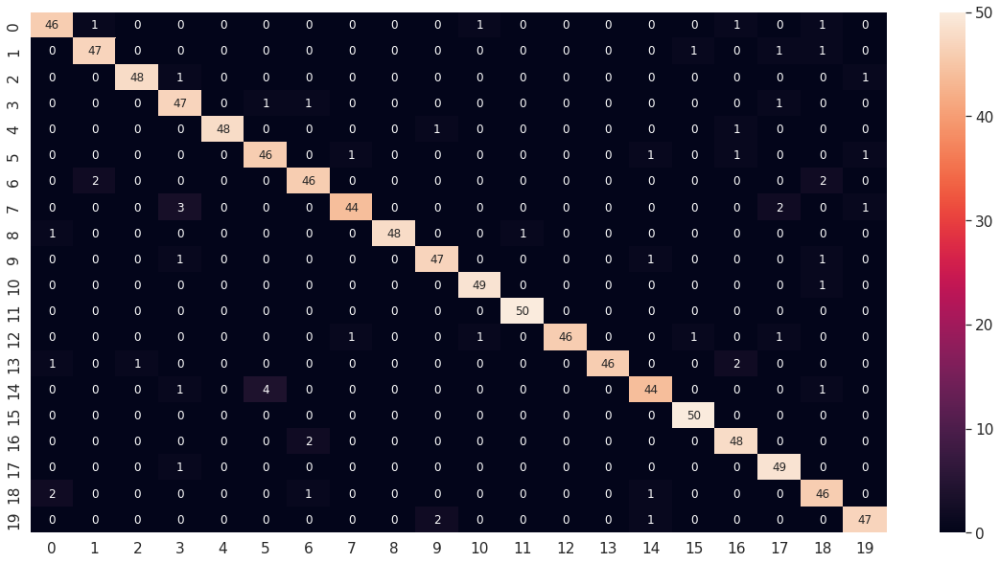

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_13_df_CM = pd.DataFrame(facenet_model_vgg1_13_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_13_report)

              precision    recall  f1-score   support

           1       0.92      0.92      0.92        50
           2       0.94      0.94      0.94        50
           3       0.98      0.96      0.97        50
           4       0.87      0.94      0.90        50
           5       1.00      0.96      0.98        50
           6       0.90      0.92      0.91        50
           7       0.92      0.92      0.92        50
           8       0.96      0.88      0.92        50
           9       1.00      0.96      0.98        50
          10       0.94      0.94      0.94        50
          11       0.96      0.98      0.97        50
          12       0.98      1.00      0.99        50
          13       1.00      0.92      0.96        50
          14       1.00      0.92      0.96        50
          15       0.92      0.88      0.90        50
          16       0.96      1.00      0.98        50
          17       0.91      0.96      0.93        50
          18       0.91    

#### Modelo 14: (BTH = 50, EHS = 50, ValidSplit = 0.2, INI = HeNormal, Dropout=0, REG = L2, OPT = adamax[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_14 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_14 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_14)
facenet_model_vgg1_14 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_14)
facenet_model_vgg1_14.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_14.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_14.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_14 = facenet_model_vgg1_14.fit(new_trainX, new_trainY, batch_size=50, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
42/42 [==============================] - 32s 386ms/step - loss: 0.7164 - accuracy: 0.9262 - val_loss: 3.1077 - val_accuracy: 0.4644
Epoch 2/50
42/42 [==============================] - 13s 306ms/step - loss: 0.4434 - accuracy: 0.9797 - val_loss: 3.0731 - val_accuracy: 0.5125
Epoch 3/50
42/42 [==============================] - 13s 308ms/step - loss: 0.3835 - accuracy: 0.9807 - val_loss: 1.3518 - val_accuracy: 0.7225
Epoch 4/50
42/42 [==============================] - 13s 301ms/step - loss: 0.2995 - accuracy: 0.9937 - val_loss: 1.0686 - val_accuracy: 0.7881
Epoch 5/50
42/42 [==============================] - 12s 292ms/step - loss: 0.2443 - accuracy: 0.9937 - val_loss: 0.7166 - val_accuracy: 0.8690
Epoch 6/50
42/42 [==============================] - 10s 237ms/step - loss: 0.2287 - accuracy: 0.9899 - val_loss: 0.9600 - val_accuracy: 0.7900
Epoch 7/50
42/42 [==============================] - 10s 237ms/step - loss: 0.2004 - accuracy: 0.9932 - val_loss: 0.7258 - val_accuracy: 0.8324

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_14 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_14.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2705 - accuracy: 0.9470


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


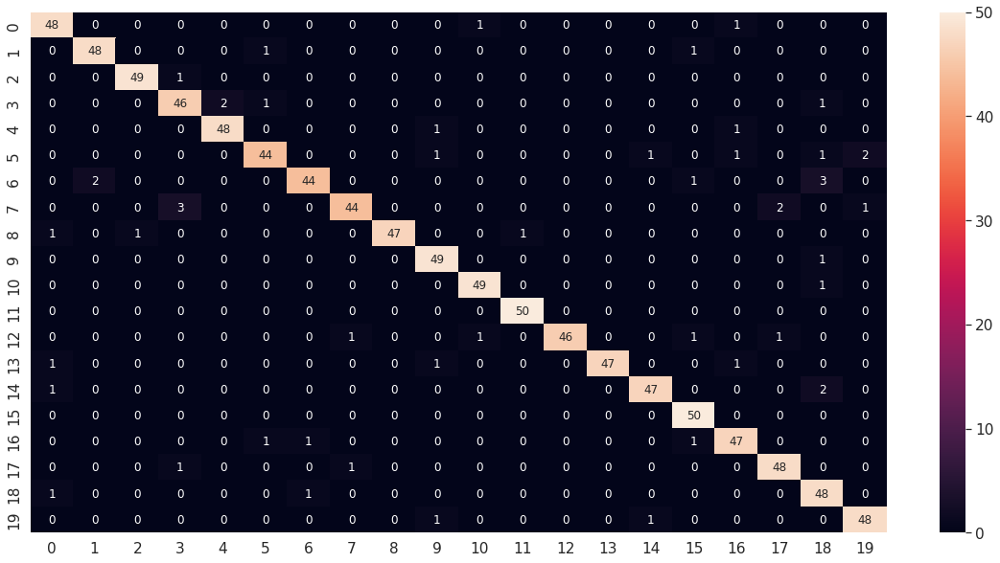

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_14_df_CM = pd.DataFrame(facenet_model_vgg1_14_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_14_report)

              precision    recall  f1-score   support

           1       0.92      0.96      0.94        50
           2       0.96      0.96      0.96        50
           3       0.98      0.98      0.98        50
           4       0.90      0.92      0.91        50
           5       0.96      0.96      0.96        50
           6       0.94      0.88      0.91        50
           7       0.96      0.88      0.92        50
           8       0.96      0.88      0.92        50
           9       1.00      0.94      0.97        50
          10       0.92      0.98      0.95        50
          11       0.96      0.98      0.97        50
          12       0.98      1.00      0.99        50
          13       1.00      0.92      0.96        50
          14       1.00      0.94      0.97        50
          15       0.96      0.94      0.95        50
          16       0.93      1.00      0.96        50
          17       0.92      0.94      0.93        50
          18       0.94    

#### Modelo 15: (BTH = 10, EHS = 50, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg1_15 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg1_15 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg1_15)
facenet_model_vgg1_15 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg1_15)
facenet_model_vgg1_15.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg1_15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_15.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg1_15 = facenet_model_vgg1_15.fit(new_trainX, new_trainY, batch_size=10, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
208/208 [==============================] - 35s 109ms/step - loss: 1.0514 - accuracy: 0.8168 - val_loss: 1.9218 - val_accuracy: 0.6532
Epoch 2/50
208/208 [==============================] - 21s 102ms/step - loss: 0.7178 - accuracy: 0.8954 - val_loss: 1.2172 - val_accuracy: 0.8054
Epoch 3/50
208/208 [==============================] - 20s 97ms/step - loss: 0.4347 - accuracy: 0.9532 - val_loss: 0.9073 - val_accuracy: 0.8285
Epoch 4/50
208/208 [==============================] - 20s 94ms/step - loss: 0.3613 - accuracy: 0.9662 - val_loss: 0.6017 - val_accuracy: 0.8921
Epoch 5/50
208/208 [==============================] - 19s 93ms/step - loss: 0.2944 - accuracy: 0.9759 - val_loss: 0.4987 - val_accuracy: 0.9056
Epoch 6/50
208/208 [==============================] - 19s 90ms/step - loss: 0.2193 - accuracy: 0.9928 - val_loss: 0.4634 - val_accuracy: 0.9133
Epoch 7/50
208/208 [==============================] - 16s 75ms/step - loss: 0.2141 - accuracy: 0.9870 - val_loss: 1.2428 - val_accurac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg1_15 = load_model(path + 'data_reconocimiento1/models_VGG1/facenet_model_VGG1_15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg1_15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg1_15.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.3217 - accuracy: 0.9450


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg1_15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg1_15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 2s 50ms/step


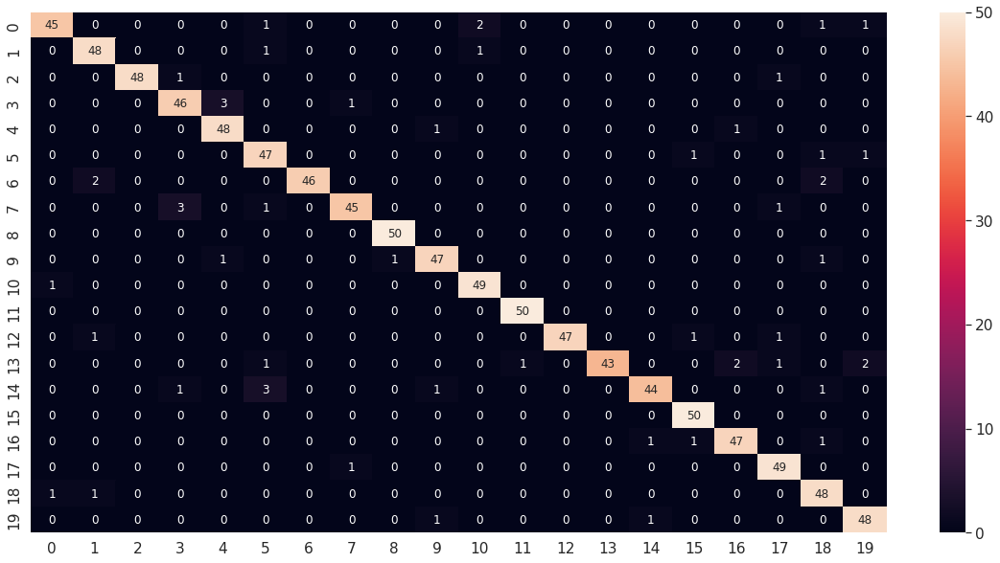

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg1_15_df_CM = pd.DataFrame(facenet_model_vgg1_15_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg1_15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg1_15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg1_15_report)

              precision    recall  f1-score   support

           1       0.96      0.90      0.93        50
           2       0.92      0.96      0.94        50
           3       1.00      0.96      0.98        50
           4       0.90      0.92      0.91        50
           5       0.92      0.96      0.94        50
           6       0.87      0.94      0.90        50
           7       1.00      0.92      0.96        50
           8       0.96      0.90      0.93        50
           9       0.98      1.00      0.99        50
          10       0.94      0.94      0.94        50
          11       0.94      0.98      0.96        50
          12       0.98      1.00      0.99        50
          13       1.00      0.94      0.97        50
          14       1.00      0.86      0.92        50
          15       0.96      0.88      0.92        50
          16       0.94      1.00      0.97        50
          17       0.94      0.94      0.94        50
          18       0.92    

## 8. Modelos con base de datos VGG-Asian para condiciones de etnia

#### Modelo 1: (BTH = 30, EHS = 30, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_1 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_1)
facenet_model_vgg2_1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_1)
facenet_model_vgg2_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_1.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_1 = facenet_model_vgg2_1.fit(new_trainX, new_trainY, batch_size=30, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
72/72 [==============================] - 35s 232ms/step - loss: 2.9207 - accuracy: 0.2665 - val_loss: 4.7823 - val_accuracy: 0.0581
Epoch 2/30
72/72 [==============================] - 12s 160ms/step - loss: 1.9512 - accuracy: 0.5133 - val_loss: 7.1703 - val_accuracy: 0.0543
Epoch 3/30
72/72 [==============================] - 11s 156ms/step - loss: 1.3888 - accuracy: 0.6824 - val_loss: 8.1871 - val_accuracy: 0.0543
Epoch 4/30
72/72 [==============================] - 11s 158ms/step - loss: 1.0464 - accuracy: 0.7667 - val_loss: 6.2480 - val_accuracy: 0.0581
Epoch 5/30
72/72 [==============================] - 11s 160ms/step - loss: 0.7426 - accuracy: 0.8562 - val_loss: 7.1778 - val_accuracy: 0.0543
Epoch 6/30
72/72 [==============================] - 12s 162ms/step - loss: 0.6962 - accuracy: 0.8646 - val_loss: 5.8843 - val_accuracy: 0.0543
Epoch 7/30
72/72 [==============================] - 12s 163ms/step - loss: 0.4693 - accuracy: 0.9344 - val_loss: 5.2850 - val_accuracy: 0.0955

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_1 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_1.evaluate(testX, testY)

32/32 [==============================] - 2s 64ms/step - loss: 0.4554 - accuracy: 0.9010


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 47ms/step


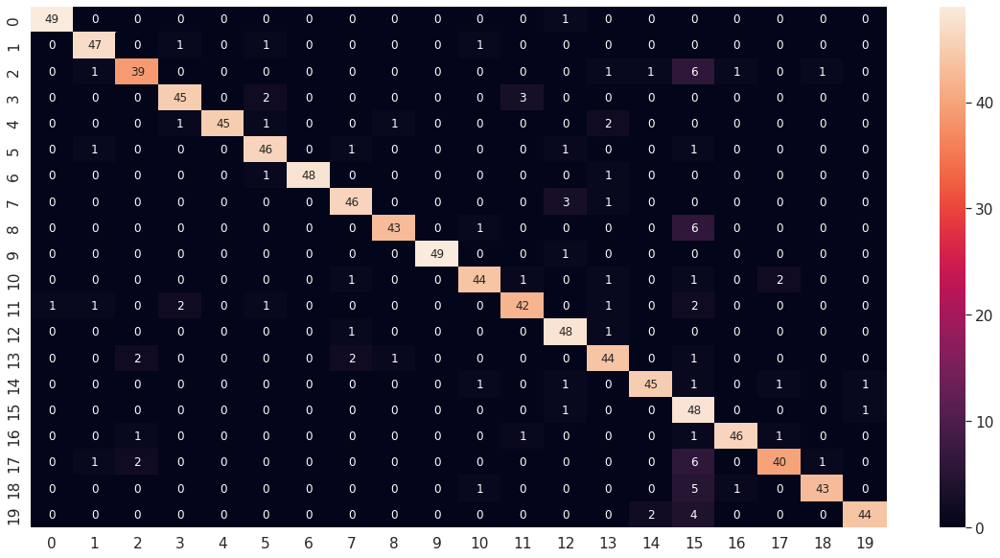

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_1_df_CM = pd.DataFrame(facenet_model_vgg2_1_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_1_report)

              precision    recall  f1-score   support

           1       0.98      0.98      0.98        50
           2       0.92      0.94      0.93        50
           3       0.89      0.78      0.83        50
           4       0.92      0.90      0.91        50
           5       1.00      0.90      0.95        50
           6       0.88      0.92      0.90        50
           7       1.00      0.96      0.98        50
           8       0.90      0.92      0.91        50
           9       0.96      0.86      0.91        50
          10       1.00      0.98      0.99        50
          11       0.92      0.88      0.90        50
          12       0.89      0.84      0.87        50
          13       0.86      0.96      0.91        50
          14       0.85      0.88      0.86        50
          15       0.94      0.90      0.92        50
          16       0.59      0.96      0.73        50
          17       0.96      0.92      0.94        50
          18       0.91    

#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_2 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_2 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_2)
facenet_model_vgg2_2 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_2)
facenet_model_vgg2_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_2.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_2 = facenet_model_vgg2_2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
72/72 [==============================] - 25s 216ms/step - loss: 0.7686 - accuracy: 0.9026 - val_loss: 3.5069 - val_accuracy: 0.3727
Epoch 2/80
72/72 [==============================] - 14s 192ms/step - loss: 0.4641 - accuracy: 0.9696 - val_loss: 1.9102 - val_accuracy: 0.6798
Epoch 3/80
72/72 [==============================] - 14s 190ms/step - loss: 0.3327 - accuracy: 0.9897 - val_loss: 1.3552 - val_accuracy: 0.7247
Epoch 4/80
72/72 [==============================] - 14s 189ms/step - loss: 0.2566 - accuracy: 0.9934 - val_loss: 0.9723 - val_accuracy: 0.7978
Epoch 5/80
72/72 [==============================] - 14s 194ms/step - loss: 0.1965 - accuracy: 0.9986 - val_loss: 0.6424 - val_accuracy: 0.8670
Epoch 6/80
72/72 [==============================] - 12s 160ms/step - loss: 0.2161 - accuracy: 0.9888 - val_loss: 1.2062 - val_accuracy: 0.7172
Epoch 7/80
72/72 [==============================] - 12s 161ms/step - loss: 0.1821 - accuracy: 0.9920 - val_loss: 0.9471 - val_accuracy: 0.7715

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_2 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_2.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.3827 - accuracy: 0.9190


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


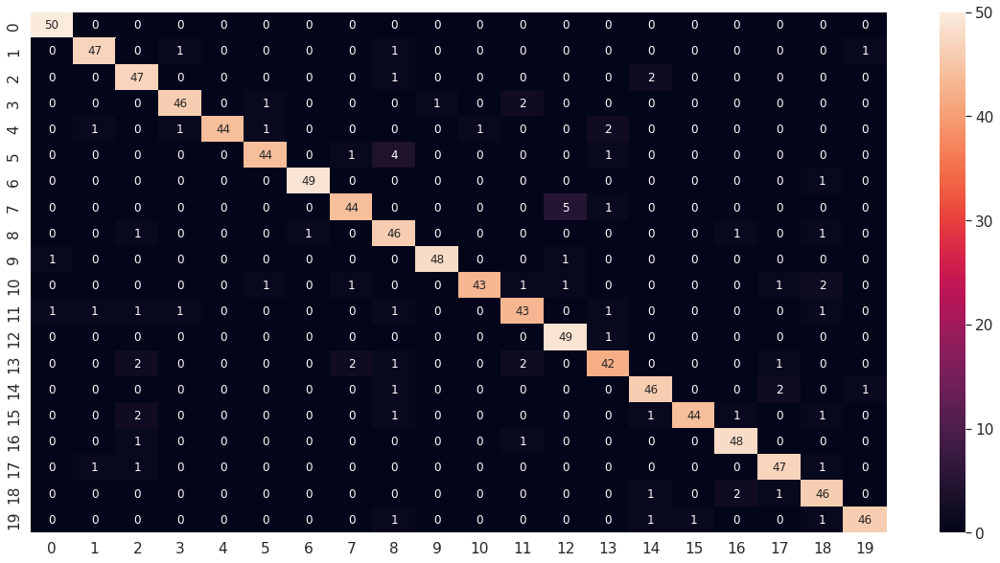

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_2_df_CM = pd.DataFrame(facenet_model_vgg2_2_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_2_report)

              precision    recall  f1-score   support

           1       0.96      1.00      0.98        50
           2       0.94      0.94      0.94        50
           3       0.85      0.94      0.90        50
           4       0.94      0.92      0.93        50
           5       1.00      0.88      0.94        50
           6       0.94      0.88      0.91        50
           7       0.98      0.98      0.98        50
           8       0.92      0.88      0.90        50
           9       0.81      0.92      0.86        50
          10       0.98      0.96      0.97        50
          11       0.98      0.86      0.91        50
          12       0.88      0.86      0.87        50
          13       0.88      0.98      0.92        50
          14       0.88      0.84      0.86        50
          15       0.90      0.92      0.91        50
          16       0.98      0.88      0.93        50
          17       0.92      0.96      0.94        50
          18       0.90    

#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_3 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_3 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_3)
facenet_model_vgg2_3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_3)
facenet_model_vgg2_3.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_3.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_3 = facenet_model_vgg2_3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
72/72 [==============================] - 25s 222ms/step - loss: 0.7806 - accuracy: 0.9171 - val_loss: 0.9363 - val_accuracy: 0.8614
Epoch 2/50
72/72 [==============================] - 14s 193ms/step - loss: 0.3798 - accuracy: 0.9967 - val_loss: 0.9058 - val_accuracy: 0.8464
Epoch 3/50
72/72 [==============================] - 12s 168ms/step - loss: 0.3281 - accuracy: 0.9920 - val_loss: 1.3087 - val_accuracy: 0.7509
Epoch 4/50
72/72 [==============================] - 12s 160ms/step - loss: 0.3015 - accuracy: 0.9869 - val_loss: 1.0186 - val_accuracy: 0.7978
Epoch 5/50
72/72 [==============================] - 15s 213ms/step - loss: 0.2086 - accuracy: 0.9995 - val_loss: 0.6692 - val_accuracy: 0.8652
Epoch 6/50
72/72 [==============================] - 14s 193ms/step - loss: 0.1718 - accuracy: 0.9995 - val_loss: 0.6110 - val_accuracy: 0.8764
Epoch 7/50
72/72 [==============================] - 14s 190ms/step - loss: 0.1485 - accuracy: 0.9995 - val_loss: 0.5725 - val_accuracy: 0.8820

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_3 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_3.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.4675 - accuracy: 0.8940


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

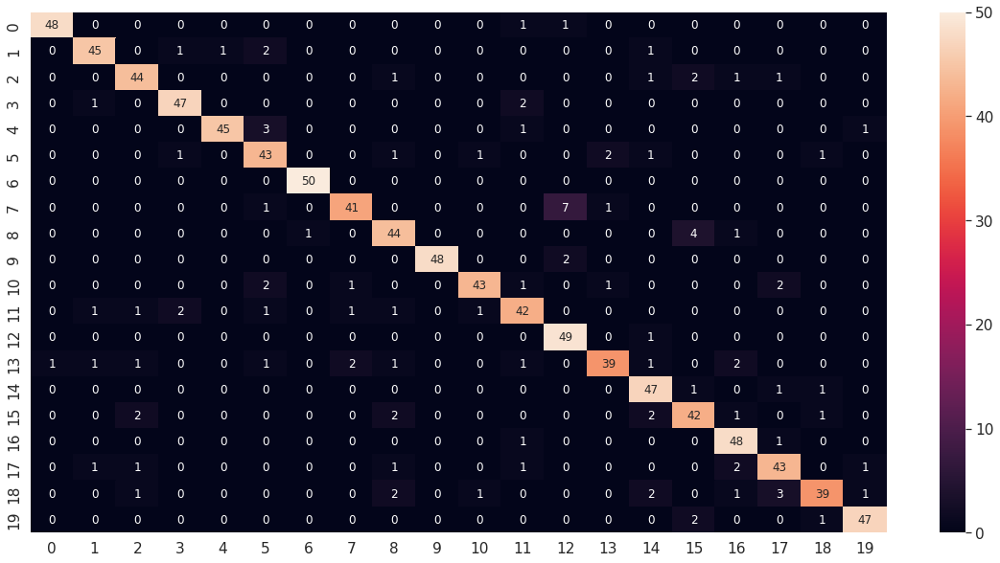

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_3_df_CM = pd.DataFrame(facenet_model_vgg2_3_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_3_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.92      0.90      0.91        50
           3       0.88      0.88      0.88        50
           4       0.92      0.94      0.93        50
           5       0.98      0.90      0.94        50
           6       0.81      0.86      0.83        50
           7       0.98      1.00      0.99        50
           8       0.91      0.82      0.86        50
           9       0.83      0.88      0.85        50
          10       1.00      0.96      0.98        50
          11       0.93      0.86      0.90        50
          12       0.84      0.84      0.84        50
          13       0.83      0.98      0.90        50
          14       0.91      0.78      0.84        50
          15       0.84      0.94      0.89        50
          16       0.82      0.84      0.83        50
          17       0.86      0.96      0.91        50
          18       0.84    

#### Modelo 4: (BTH = 20, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.5 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_4 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_4 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_4)
facenet_model_vgg2_4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_4)
facenet_model_vgg2_4.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_4.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_4 = facenet_model_vgg2_4.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
107/107 [==============================] - 39s 167ms/step - loss: 3.8010 - accuracy: 0.1396 - val_loss: 24.6494 - val_accuracy: 0.0581
Epoch 2/30
107/107 [==============================] - 14s 129ms/step - loss: 3.0443 - accuracy: 0.2604 - val_loss: 4.2915 - val_accuracy: 0.0543
Epoch 3/30
107/107 [==============================] - 12s 113ms/step - loss: 2.5347 - accuracy: 0.3518 - val_loss: 4.9063 - val_accuracy: 0.0543
Epoch 4/30
107/107 [==============================] - 12s 113ms/step - loss: 2.0107 - accuracy: 0.4773 - val_loss: 4.9695 - val_accuracy: 0.0524
Epoch 5/30
107/107 [==============================] - 12s 114ms/step - loss: 1.5484 - accuracy: 0.5995 - val_loss: 4.3170 - val_accuracy: 0.1292
Epoch 6/30
107/107 [==============================] - 17s 155ms/step - loss: 1.2891 - accuracy: 0.6628 - val_loss: 2.5793 - val_accuracy: 0.3577
Epoch 7/30
107/107 [==============================] - 14s 133ms/step - loss: 0.9927 - accuracy: 0.7560 - val_loss: 2.2608 - val_a

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_4 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_4.evaluate(testX, testY)

32/32 [==============================] - 2s 63ms/step - loss: 0.4638 - accuracy: 0.9000


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 49ms/step


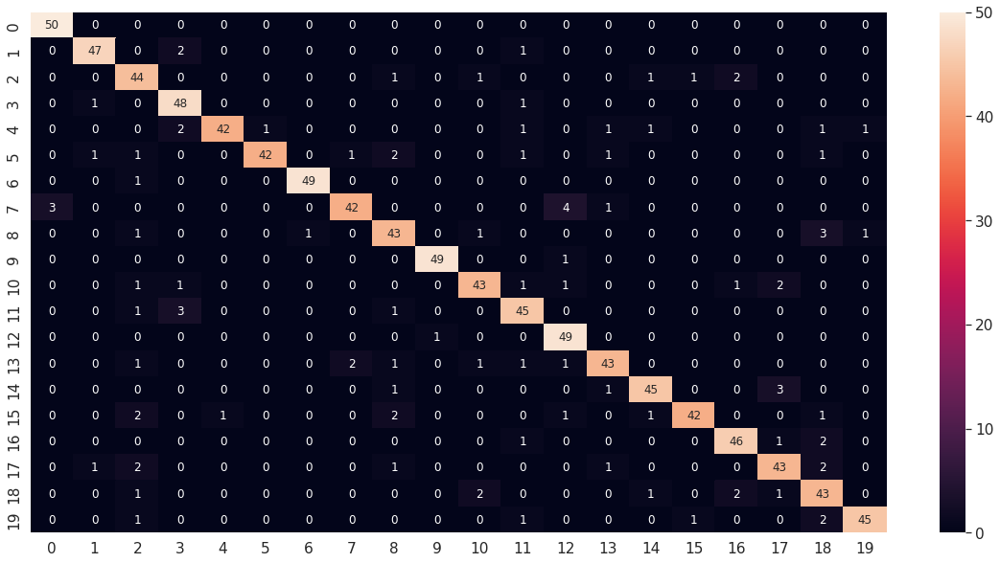

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_4_df_CM = pd.DataFrame(facenet_model_vgg2_4_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_4_report)

              precision    recall  f1-score   support

           1       0.94      1.00      0.97        50
           2       0.94      0.94      0.94        50
           3       0.79      0.88      0.83        50
           4       0.86      0.96      0.91        50
           5       0.98      0.84      0.90        50
           6       0.98      0.84      0.90        50
           7       0.98      0.98      0.98        50
           8       0.93      0.84      0.88        50
           9       0.83      0.86      0.84        50
          10       0.98      0.98      0.98        50
          11       0.90      0.86      0.88        50
          12       0.85      0.90      0.87        50
          13       0.86      0.98      0.92        50
          14       0.90      0.86      0.88        50
          15       0.92      0.90      0.91        50
          16       0.95      0.84      0.89        50
          17       0.90      0.92      0.91        50
          18       0.86    

#### Modelo 5: (BTH = 20, EHS = 60, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_5 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_5)
facenet_model_vgg2_5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_5)
facenet_model_vgg2_5.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_5.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_5 = facenet_model_vgg2_5.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
107/107 [==============================] - 25s 149ms/step - loss: 1.0392 - accuracy: 0.8328 - val_loss: 3.0754 - val_accuracy: 0.5787
Epoch 2/60
107/107 [==============================] - 12s 116ms/step - loss: 0.5025 - accuracy: 0.9616 - val_loss: 4.6048 - val_accuracy: 0.2622
Epoch 3/60
107/107 [==============================] - 16s 153ms/step - loss: 0.4161 - accuracy: 0.9705 - val_loss: 1.1117 - val_accuracy: 0.7978
Epoch 4/60
107/107 [==============================] - 12s 115ms/step - loss: 0.3378 - accuracy: 0.9785 - val_loss: 1.2392 - val_accuracy: 0.7360
Epoch 5/60
107/107 [==============================] - 16s 154ms/step - loss: 0.2712 - accuracy: 0.9845 - val_loss: 1.0972 - val_accuracy: 0.7622
Epoch 6/60
107/107 [==============================] - 16s 154ms/step - loss: 0.2196 - accuracy: 0.9948 - val_loss: 1.0578 - val_accuracy: 0.7884
Epoch 7/60
107/107 [==============================] - 17s 154ms/step - loss: 0.1845 - accuracy: 0.9977 - val_loss: 0.6158 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_5 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_5.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.4138 - accuracy: 0.9170


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


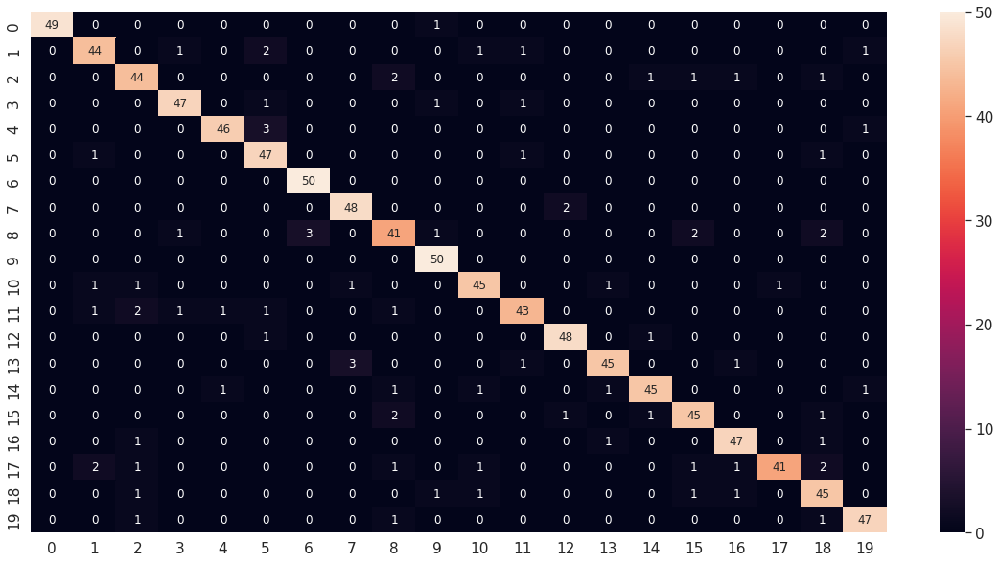

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_5_df_CM = pd.DataFrame(facenet_model_vgg2_5_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_5_report)

              precision    recall  f1-score   support

           1       1.00      0.98      0.99        50
           2       0.90      0.88      0.89        50
           3       0.86      0.88      0.87        50
           4       0.94      0.94      0.94        50
           5       0.96      0.92      0.94        50
           6       0.85      0.94      0.90        50
           7       0.94      1.00      0.97        50
           8       0.92      0.96      0.94        50
           9       0.84      0.82      0.83        50
          10       0.93      1.00      0.96        50
          11       0.92      0.90      0.91        50
          12       0.91      0.86      0.89        50
          13       0.94      0.96      0.95        50
          14       0.94      0.90      0.92        50
          15       0.94      0.90      0.92        50
          16       0.90      0.90      0.90        50
          17       0.92      0.94      0.93        50
          18       0.98    

#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_6 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_6 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_6)
facenet_model_vgg2_6 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_6)
facenet_model_vgg2_6.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_6.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_6 = facenet_model_vgg2_6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
54/54 [==============================] - 26s 271ms/step - loss: 0.8522 - accuracy: 0.9035 - val_loss: 1.0445 - val_accuracy: 0.8371
Epoch 2/60
54/54 [==============================] - 13s 239ms/step - loss: 0.3852 - accuracy: 0.9977 - val_loss: 0.9498 - val_accuracy: 0.8390
Epoch 3/60
54/54 [==============================] - 13s 241ms/step - loss: 0.3291 - accuracy: 0.9986 - val_loss: 0.8837 - val_accuracy: 0.8558
Epoch 4/60
54/54 [==============================] - 11s 202ms/step - loss: 0.2850 - accuracy: 0.9963 - val_loss: 1.1724 - val_accuracy: 0.7547
Epoch 5/60
54/54 [==============================] - 11s 199ms/step - loss: 0.2380 - accuracy: 0.9977 - val_loss: 1.1821 - val_accuracy: 0.7547
Epoch 6/60
54/54 [==============================] - 15s 277ms/step - loss: 0.1958 - accuracy: 0.9986 - val_loss: 0.6538 - val_accuracy: 0.8801
Epoch 7/60
54/54 [==============================] - 11s 199ms/step - loss: 0.1646 - accuracy: 0.9986 - val_loss: 0.6827 - val_accuracy: 0.8633

In [ ]:
2# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_6 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_6.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.3871 - accuracy: 0.9110


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

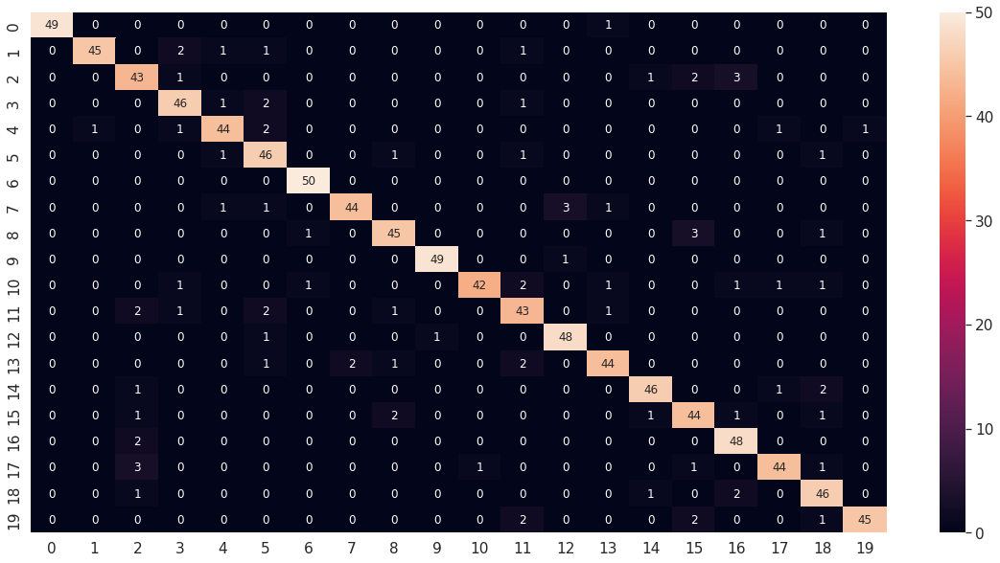

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_6_df_CM = pd.DataFrame(facenet_model_vgg2_6_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_6_report)

              precision    recall  f1-score   support

           1       1.00      0.98      0.99        50
           2       0.98      0.90      0.94        50
           3       0.81      0.86      0.83        50
           4       0.88      0.92      0.90        50
           5       0.92      0.88      0.90        50
           6       0.82      0.92      0.87        50
           7       0.96      1.00      0.98        50
           8       0.96      0.88      0.92        50
           9       0.90      0.90      0.90        50
          10       0.98      0.98      0.98        50
          11       0.98      0.84      0.90        50
          12       0.83      0.86      0.84        50
          13       0.92      0.96      0.94        50
          14       0.92      0.88      0.90        50
          15       0.94      0.92      0.93        50
          16       0.85      0.88      0.86        50
          17       0.87      0.96      0.91        50
          18       0.94    

#### Modelo 7: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_7 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_7 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_7)
facenet_model_vgg2_7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_7)
facenet_model_vgg2_7.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_7.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_7 = facenet_model_vgg2_7.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
72/72 [==============================] - 31s 235ms/step - loss: 1.0685 - accuracy: 0.8323 - val_loss: 1.1102 - val_accuracy: 0.8390
Epoch 2/80
72/72 [==============================] - 12s 161ms/step - loss: 0.4143 - accuracy: 0.9930 - val_loss: 1.7962 - val_accuracy: 0.6816
Epoch 3/80
72/72 [==============================] - 12s 161ms/step - loss: 0.4222 - accuracy: 0.9803 - val_loss: 1.6240 - val_accuracy: 0.6966
Epoch 4/80
72/72 [==============================] - 15s 210ms/step - loss: 0.3435 - accuracy: 0.9925 - val_loss: 0.9009 - val_accuracy: 0.8539
Epoch 5/80
72/72 [==============================] - 14s 190ms/step - loss: 0.2529 - accuracy: 1.0000 - val_loss: 0.8312 - val_accuracy: 0.8521
Epoch 6/80
72/72 [==============================] - 11s 156ms/step - loss: 0.2497 - accuracy: 0.9925 - val_loss: 0.8571 - val_accuracy: 0.8577
Epoch 7/80
72/72 [==============================] - 15s 214ms/step - loss: 0.2010 - accuracy: 0.9972 - val_loss: 0.7740 - val_accuracy: 0.8577

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_7 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_7.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.4983 - accuracy: 0.8950


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 49ms/step


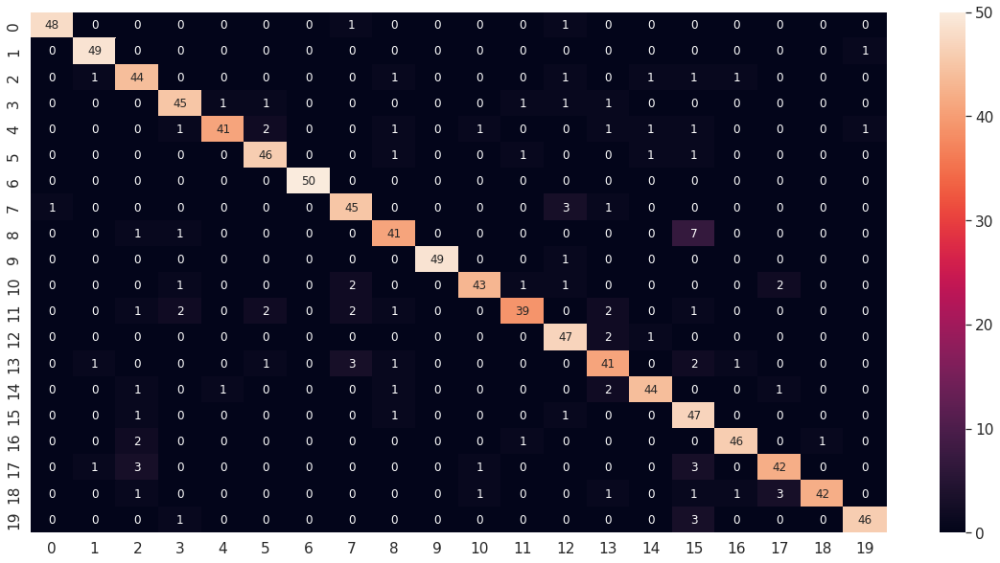

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_7_df_CM = pd.DataFrame(facenet_model_vgg2_7_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_7_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.94      0.98      0.96        50
           3       0.81      0.88      0.85        50
           4       0.88      0.90      0.89        50
           5       0.95      0.82      0.88        50
           6       0.88      0.92      0.90        50
           7       1.00      1.00      1.00        50
           8       0.85      0.90      0.87        50
           9       0.85      0.82      0.84        50
          10       1.00      0.98      0.99        50
          11       0.93      0.86      0.90        50
          12       0.91      0.78      0.84        50
          13       0.84      0.94      0.89        50
          14       0.80      0.82      0.81        50
          15       0.92      0.88      0.90        50
          16       0.70      0.94      0.80        50
          17       0.94      0.92      0.93        50
          18       0.88    

#### Modelo 8: (BTH = 20, EHS = 80, ValidSplit = 0.2, Dropout = 0,2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_8 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_8 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_8)
facenet_model_vgg2_8 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_8)
facenet_model_vgg2_8.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg2_8.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_8.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_8 = facenet_model_vgg2_8.fit(new_trainX, new_trainY, batch_size=20, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
107/107 [==============================] - 27s 167ms/step - loss: 0.2471 - accuracy: 0.9995 - val_loss: 0.7136 - val_accuracy: 0.8839
Epoch 2/80
107/107 [==============================] - 17s 155ms/step - loss: 0.1633 - accuracy: 1.0000 - val_loss: 0.6491 - val_accuracy: 0.8839
Epoch 3/80
107/107 [==============================] - 17s 157ms/step - loss: 0.1338 - accuracy: 1.0000 - val_loss: 0.6253 - val_accuracy: 0.8876
Epoch 4/80
107/107 [==============================] - 17s 157ms/step - loss: 0.1213 - accuracy: 0.9995 - val_loss: 0.5977 - val_accuracy: 0.8933
Epoch 5/80
107/107 [==============================] - 17s 158ms/step - loss: 0.1114 - accuracy: 1.0000 - val_loss: 0.5909 - val_accuracy: 0.8914
Epoch 6/80
107/107 [==============================] - 17s 157ms/step - loss: 0.1063 - accuracy: 1.0000 - val_loss: 0.5726 - val_accuracy: 0.8970
Epoch 7/80
107/107 [==============================] - 17s 156ms/step - loss: 0.1031 - accuracy: 1.0000 - val_loss: 0.5680 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_8 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_8.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.4616 - accuracy: 0.9110


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

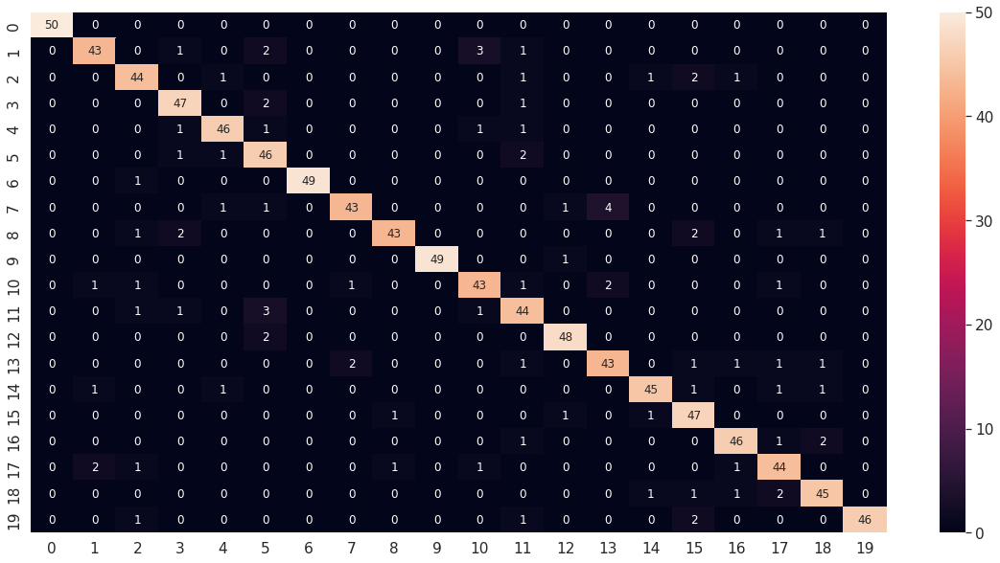

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_8_df_CM = pd.DataFrame(facenet_model_vgg2_8_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_8_report)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00        50
           2       0.91      0.86      0.89        50
           3       0.88      0.88      0.88        50
           4       0.89      0.94      0.91        50
           5       0.92      0.92      0.92        50
           6       0.81      0.92      0.86        50
           7       1.00      0.98      0.99        50
           8       0.93      0.86      0.90        50
           9       0.96      0.86      0.91        50
          10       1.00      0.98      0.99        50
          11       0.88      0.86      0.87        50
          12       0.81      0.88      0.85        50
          13       0.94      0.96      0.95        50
          14       0.88      0.86      0.87        50
          15       0.94      0.90      0.92        50
          16       0.84      0.94      0.89        50
          17       0.92      0.92      0.92        50
          18       0.86    

#### Modelo 9: (BTH = 50, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_9 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_9 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_9)
facenet_model_vgg2_9 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_9)
facenet_model_vgg2_9.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_9.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_9 = facenet_model_vgg2_9.fit(new_trainX, new_trainY, batch_size=50, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
43/43 [==============================] - 32s 396ms/step - loss: 0.8832 - accuracy: 0.8941 - val_loss: 1.0175 - val_accuracy: 0.8539
Epoch 2/60
43/43 [==============================] - 10s 236ms/step - loss: 0.4141 - accuracy: 0.9967 - val_loss: 1.1497 - val_accuracy: 0.8296
Epoch 3/60
43/43 [==============================] - 10s 239ms/step - loss: 0.3817 - accuracy: 0.9944 - val_loss: 1.3058 - val_accuracy: 0.7978
Epoch 4/60
43/43 [==============================] - 10s 238ms/step - loss: 0.3250 - accuracy: 0.9977 - val_loss: 1.2402 - val_accuracy: 0.8052
Epoch 5/60
43/43 [==============================] - 15s 350ms/step - loss: 0.2716 - accuracy: 1.0000 - val_loss: 0.8484 - val_accuracy: 0.8633
Epoch 6/60
43/43 [==============================] - 10s 235ms/step - loss: 0.2382 - accuracy: 0.9986 - val_loss: 1.4622 - val_accuracy: 0.7566
Epoch 7/60
43/43 [==============================] - 10s 234ms/step - loss: 0.2149 - accuracy: 0.9963 - val_loss: 1.4360 - val_accuracy: 0.7172

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_9 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_9.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.5049 - accuracy: 0.8990


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

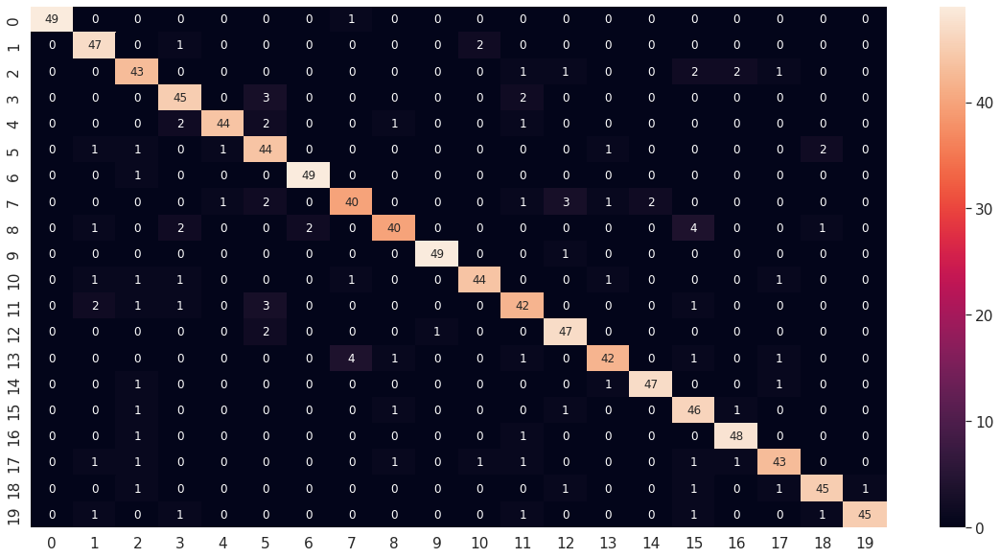

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_9_df_CM = pd.DataFrame(facenet_model_vgg2_9_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_9_report)

              precision    recall  f1-score   support

           1       1.00      0.98      0.99        50
           2       0.87      0.94      0.90        50
           3       0.83      0.86      0.84        50
           4       0.85      0.90      0.87        50
           5       0.96      0.88      0.92        50
           6       0.79      0.88      0.83        50
           7       0.96      0.98      0.97        50
           8       0.87      0.80      0.83        50
           9       0.91      0.80      0.85        50
          10       0.98      0.98      0.98        50
          11       0.94      0.88      0.91        50
          12       0.82      0.84      0.83        50
          13       0.87      0.94      0.90        50
          14       0.91      0.84      0.87        50
          15       0.96      0.94      0.95        50
          16       0.81      0.92      0.86        50
          17       0.92      0.96      0.94        50
          18       0.90    

#### Modelo 10: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_10 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_10 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_10)
facenet_model_vgg2_10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_10)
facenet_model_vgg2_10.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg2_10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_10.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_10 = facenet_model_vgg2_10.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
72/72 [==============================] - 27s 219ms/step - loss: 1.8812 - accuracy: 0.6141 - val_loss: 1.2367 - val_accuracy: 0.8221
Epoch 2/50
72/72 [==============================] - 14s 190ms/step - loss: 0.5956 - accuracy: 0.9756 - val_loss: 1.0461 - val_accuracy: 0.8521
Epoch 3/50
72/72 [==============================] - 16s 220ms/step - loss: 0.4933 - accuracy: 0.9939 - val_loss: 1.0036 - val_accuracy: 0.8633
Epoch 4/50
72/72 [==============================] - 16s 219ms/step - loss: 0.4559 - accuracy: 0.9981 - val_loss: 0.9919 - val_accuracy: 0.8727
Epoch 5/50
72/72 [==============================] - 11s 159ms/step - loss: 0.4354 - accuracy: 0.9991 - val_loss: 0.9940 - val_accuracy: 0.8858
Epoch 6/50
72/72 [==============================] - 11s 159ms/step - loss: 0.4164 - accuracy: 0.9986 - val_loss: 0.9930 - val_accuracy: 0.8876
Epoch 7/50
72/72 [==============================] - 11s 158ms/step - loss: 0.4015 - accuracy: 1.0000 - val_loss: 1.0004 - val_accuracy: 0.8801

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_10 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_10.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.6091 - accuracy: 0.8910


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

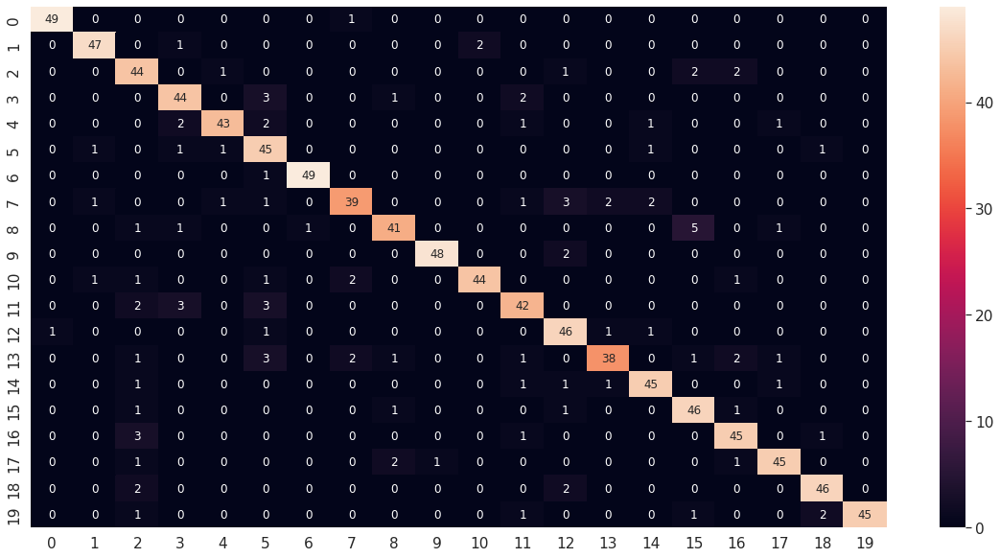

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_10_df_CM = pd.DataFrame(facenet_model_vgg2_10_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_10_report)

              precision    recall  f1-score   support

           1       0.98      0.98      0.98        50
           2       0.94      0.94      0.94        50
           3       0.76      0.88      0.81        50
           4       0.85      0.88      0.86        50
           5       0.93      0.86      0.90        50
           6       0.75      0.90      0.82        50
           7       0.98      0.98      0.98        50
           8       0.89      0.78      0.83        50
           9       0.89      0.82      0.85        50
          10       0.98      0.96      0.97        50
          11       0.96      0.88      0.92        50
          12       0.84      0.84      0.84        50
          13       0.82      0.92      0.87        50
          14       0.90      0.76      0.83        50
          15       0.90      0.90      0.90        50
          16       0.84      0.92      0.88        50
          17       0.87      0.90      0.88        50
          18       0.92    

#### Modelo 11: (BTH = 10, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_11 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_11 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_11)
facenet_model_vgg2_11 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_11)
facenet_model_vgg2_11.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg2_11.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_11.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_11 = facenet_model_vgg2_11.fit(new_trainX, new_trainY, batch_size=10, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
214/214 [==============================] - 33s 101ms/step - loss: 0.7918 - accuracy: 0.9269 - val_loss: 0.9690 - val_accuracy: 0.8801
Epoch 2/60
214/214 [==============================] - 17s 80ms/step - loss: 0.4414 - accuracy: 0.9977 - val_loss: 0.9840 - val_accuracy: 0.8801
Epoch 3/60
214/214 [==============================] - 21s 97ms/step - loss: 0.3931 - accuracy: 0.9995 - val_loss: 0.9644 - val_accuracy: 0.8839
Epoch 4/60
214/214 [==============================] - 21s 98ms/step - loss: 0.3655 - accuracy: 0.9977 - val_loss: 0.9475 - val_accuracy: 0.8858
Epoch 5/60
214/214 [==============================] - 21s 98ms/step - loss: 0.3266 - accuracy: 1.0000 - val_loss: 0.9206 - val_accuracy: 0.8895
Epoch 6/60
214/214 [==============================] - 21s 99ms/step - loss: 0.2968 - accuracy: 0.9995 - val_loss: 0.8867 - val_accuracy: 0.8876
Epoch 7/60
214/214 [==============================] - 21s 98ms/step - loss: 0.2629 - accuracy: 1.0000 - val_loss: 0.8432 - val_accuracy

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_11 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_11.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.5339 - accuracy: 0.9120


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 49ms/step


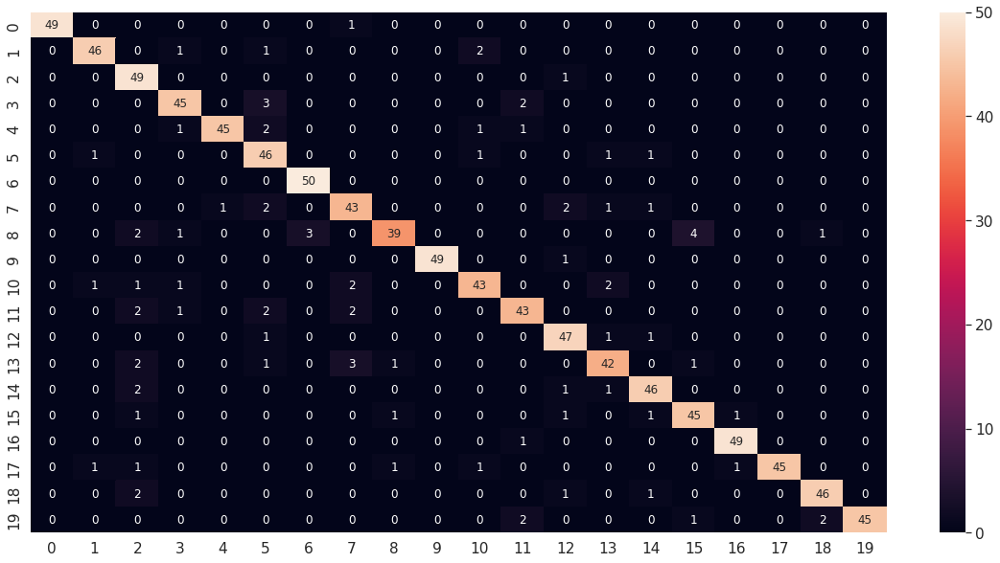

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_11_df_CM = pd.DataFrame(facenet_model_vgg2_11_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_11_report)

              precision    recall  f1-score   support

           1       1.00      0.98      0.99        50
           2       0.94      0.92      0.93        50
           3       0.79      0.98      0.87        50
           4       0.90      0.90      0.90        50
           5       0.98      0.90      0.94        50
           6       0.79      0.92      0.85        50
           7       0.94      1.00      0.97        50
           8       0.84      0.86      0.85        50
           9       0.93      0.78      0.85        50
          10       1.00      0.98      0.99        50
          11       0.90      0.86      0.88        50
          12       0.88      0.86      0.87        50
          13       0.87      0.94      0.90        50
          14       0.88      0.84      0.86        50
          15       0.90      0.92      0.91        50
          16       0.88      0.90      0.89        50
          17       0.96      0.98      0.97        50
          18       1.00    

#### Modelo 12: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_12 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_12 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_12)
facenet_model_vgg2_12 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_12)
facenet_model_vgg2_12.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_12.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_12 = facenet_model_vgg2_12.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
107/107 [==============================] - 41s 172ms/step - loss: 3.8227 - accuracy: 0.1358 - val_loss: 3.5885 - val_accuracy: 0.0487
Epoch 2/60
107/107 [==============================] - 13s 116ms/step - loss: 3.2038 - accuracy: 0.2159 - val_loss: 1651.2887 - val_accuracy: 0.0412
Epoch 3/60
107/107 [==============================] - 13s 120ms/step - loss: 2.6133 - accuracy: 0.3101 - val_loss: 33.0821 - val_accuracy: 0.0468
Epoch 4/60
107/107 [==============================] - 13s 120ms/step - loss: 2.1761 - accuracy: 0.4248 - val_loss: 5.9876 - val_accuracy: 0.0599
Epoch 5/60
107/107 [==============================] - 12s 116ms/step - loss: 1.7103 - accuracy: 0.5475 - val_loss: 4.2232 - val_accuracy: 0.1105
Epoch 6/60
107/107 [==============================] - 16s 151ms/step - loss: 1.5084 - accuracy: 0.5972 - val_loss: 3.5616 - val_accuracy: 0.1517
Epoch 7/60
107/107 [==============================] - 16s 149ms/step - loss: 1.1324 - accuracy: 0.7021 - val_loss: 2.4326 - va

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_12 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_12.evaluate(testX, testY)

32/32 [==============================] - 2s 64ms/step - loss: 0.4185 - accuracy: 0.9060


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

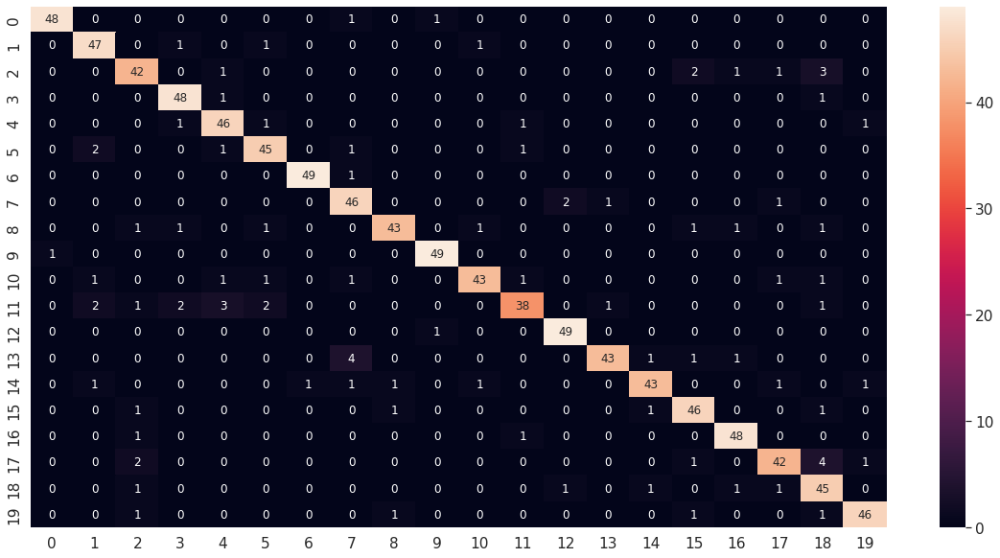

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_12_df_CM = pd.DataFrame(facenet_model_vgg2_12_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_12_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.89      0.94      0.91        50
           3       0.84      0.84      0.84        50
           4       0.91      0.96      0.93        50
           5       0.87      0.92      0.89        50
           6       0.88      0.90      0.89        50
           7       0.98      0.98      0.98        50
           8       0.84      0.92      0.88        50
           9       0.93      0.86      0.90        50
          10       0.96      0.98      0.97        50
          11       0.93      0.86      0.90        50
          12       0.90      0.76      0.83        50
          13       0.94      0.98      0.96        50
          14       0.96      0.86      0.91        50
          15       0.93      0.86      0.90        50
          16       0.88      0.92      0.90        50
          17       0.92      0.96      0.94        50
          18       0.89    

#### Modelo 13: (BTH = 30, EHS = 100, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_13 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_13 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_13)
facenet_model_vgg2_13 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_13)
facenet_model_vgg2_13.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_13.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_13 = facenet_model_vgg2_13.fit(new_trainX, new_trainY, batch_size=30, epochs=100, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/100
72/72 [==============================] - 39s 246ms/step - loss: 2.8236 - accuracy: 0.3110 - val_loss: 4.9552 - val_accuracy: 0.0543
Epoch 2/100
72/72 [==============================] - 12s 170ms/step - loss: 1.8545 - accuracy: 0.5475 - val_loss: 5.6692 - val_accuracy: 0.0543
Epoch 3/100
72/72 [==============================] - 12s 167ms/step - loss: 1.4788 - accuracy: 0.6585 - val_loss: 5.9358 - val_accuracy: 0.0543
Epoch 4/100
72/72 [==============================] - 12s 167ms/step - loss: 1.0846 - accuracy: 0.7504 - val_loss: 5.7733 - val_accuracy: 0.0543
Epoch 5/100
72/72 [==============================] - 12s 165ms/step - loss: 0.8377 - accuracy: 0.8225 - val_loss: 5.8645 - val_accuracy: 0.0562
Epoch 6/100
72/72 [==============================] - 12s 163ms/step - loss: 0.6515 - accuracy: 0.8754 - val_loss: 5.2485 - val_accuracy: 0.0749
Epoch 7/100
72/72 [==============================] - 16s 226ms/step - loss: 0.4394 - accuracy: 0.9546 - val_loss: 4.1664 - val_accuracy:

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_13 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_13.evaluate(testX, testY)

32/32 [==============================] - 2s 68ms/step - loss: 0.3963 - accuracy: 0.9090


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


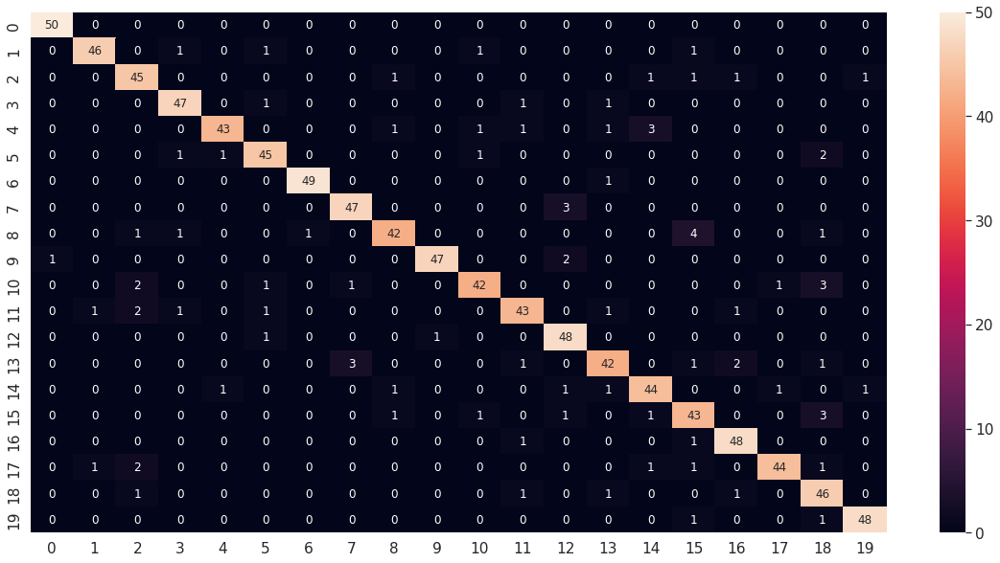

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_13_df_CM = pd.DataFrame(facenet_model_vgg2_13_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_13_report)

              precision    recall  f1-score   support

           1       0.98      1.00      0.99        50
           2       0.96      0.92      0.94        50
           3       0.85      0.90      0.87        50
           4       0.92      0.94      0.93        50
           5       0.96      0.86      0.91        50
           6       0.90      0.90      0.90        50
           7       0.98      0.98      0.98        50
           8       0.92      0.94      0.93        50
           9       0.91      0.84      0.87        50
          10       0.98      0.94      0.96        50
          11       0.91      0.84      0.87        50
          12       0.90      0.86      0.88        50
          13       0.87      0.96      0.91        50
          14       0.88      0.84      0.86        50
          15       0.88      0.88      0.88        50
          16       0.81      0.86      0.83        50
          17       0.91      0.96      0.93        50
          18       0.96    

#### Modelo 14: (BTH = 10, EHS = 80, ValidSplit = 0.2, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])


In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_14 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_14 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_14)
facenet_model_vgg2_14 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_14)
facenet_model_vgg2_14.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_14.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_14.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_14 = facenet_model_vgg2_14.fit(new_trainX, new_trainY, batch_size=10, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
214/214 [==============================] - 33s 100ms/step - loss: 0.7883 - accuracy: 0.9143 - val_loss: 1.8240 - val_accuracy: 0.6948
Epoch 2/80
214/214 [==============================] - 22s 101ms/step - loss: 0.4319 - accuracy: 0.9724 - val_loss: 1.2141 - val_accuracy: 0.7865
Epoch 3/80
214/214 [==============================] - 19s 88ms/step - loss: 0.3276 - accuracy: 0.9714 - val_loss: 1.2809 - val_accuracy: 0.7453
Epoch 4/80
214/214 [==============================] - 21s 98ms/step - loss: 0.2496 - accuracy: 0.9827 - val_loss: 0.8717 - val_accuracy: 0.8315
Epoch 5/80
214/214 [==============================] - 17s 78ms/step - loss: 0.2011 - accuracy: 0.9902 - val_loss: 0.8751 - val_accuracy: 0.8258
Epoch 6/80
214/214 [==============================] - 17s 78ms/step - loss: 0.1593 - accuracy: 0.9939 - val_loss: 0.8805 - val_accuracy: 0.8071
Epoch 7/80
214/214 [==============================] - 21s 98ms/step - loss: 0.1671 - accuracy: 0.9897 - val_loss: 0.7216 - val_accurac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_14 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_14.evaluate(testX, testY)

32/32 [==============================] - 2s 53ms/step - loss: 0.4619 - accuracy: 0.9050


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

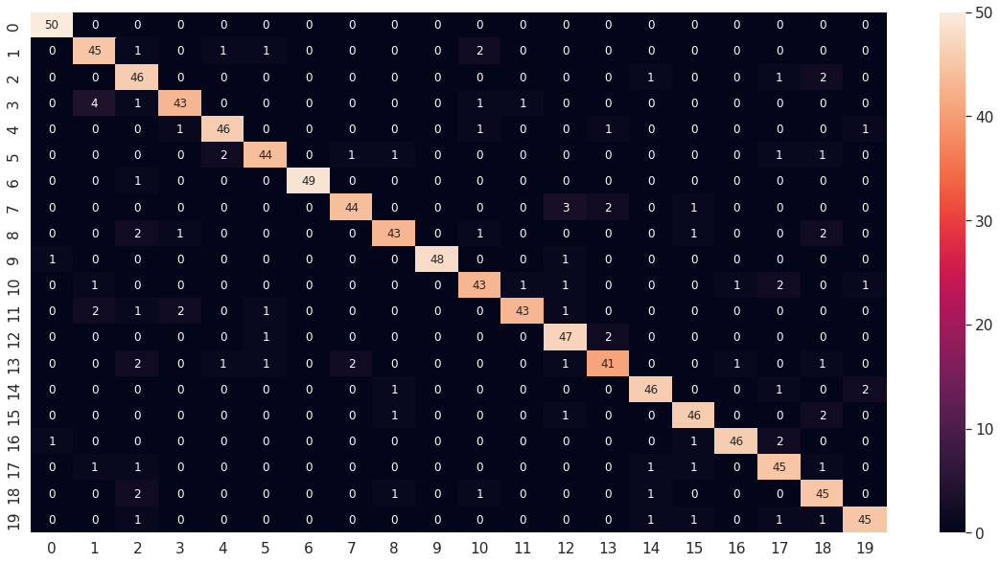

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_14_df_CM = pd.DataFrame(facenet_model_vgg2_14_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_14_report)

              precision    recall  f1-score   support

           1       0.96      1.00      0.98        50
           2       0.85      0.90      0.87        50
           3       0.79      0.92      0.85        50
           4       0.91      0.86      0.89        50
           5       0.92      0.92      0.92        50
           6       0.92      0.88      0.90        50
           7       1.00      0.98      0.99        50
           8       0.94      0.88      0.91        50
           9       0.91      0.86      0.89        50
          10       1.00      0.96      0.98        50
          11       0.88      0.86      0.87        50
          12       0.96      0.86      0.91        50
          13       0.85      0.94      0.90        50
          14       0.89      0.82      0.85        50
          15       0.92      0.92      0.92        50
          16       0.90      0.92      0.91        50
          17       0.96      0.92      0.94        50
          18       0.85    

#### Modelo 15: (BTH = 20, EHS = 80, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg2_15 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg2_15 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg2_15)
facenet_model_vgg2_15 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg2_15)
facenet_model_vgg2_15.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg2_15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_15.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg2_15 = facenet_model_vgg2_15.fit(new_trainX, new_trainY, batch_size=20, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
107/107 [==============================] - 30s 176ms/step - loss: 1.2443 - accuracy: 0.7953 - val_loss: 1.0525 - val_accuracy: 0.8390
Epoch 2/80
107/107 [==============================] - 15s 141ms/step - loss: 0.4262 - accuracy: 0.9972 - val_loss: 1.0455 - val_accuracy: 0.8596
Epoch 3/80
107/107 [==============================] - 15s 141ms/step - loss: 0.3624 - accuracy: 0.9977 - val_loss: 0.9487 - val_accuracy: 0.8652
Epoch 4/80
107/107 [==============================] - 15s 141ms/step - loss: 0.3052 - accuracy: 0.9981 - val_loss: 0.8868 - val_accuracy: 0.8633
Epoch 5/80
107/107 [==============================] - 15s 138ms/step - loss: 0.2560 - accuracy: 0.9986 - val_loss: 0.8262 - val_accuracy: 0.8689
Epoch 6/80
107/107 [==============================] - 15s 141ms/step - loss: 0.2093 - accuracy: 1.0000 - val_loss: 0.6455 - val_accuracy: 0.8951
Epoch 7/80
107/107 [==============================] - 15s 140ms/step - loss: 0.1812 - accuracy: 1.0000 - val_loss: 0.5872 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg2_15 = load_model(path + 'data_reconocimiento1/models_VGG2/facenet_model_VGG2_15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg2_15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg2_15.evaluate(testX, testY)

32/32 [==============================] - 2s 53ms/step - loss: 0.4322 - accuracy: 0.9180


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg2_15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg2_15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

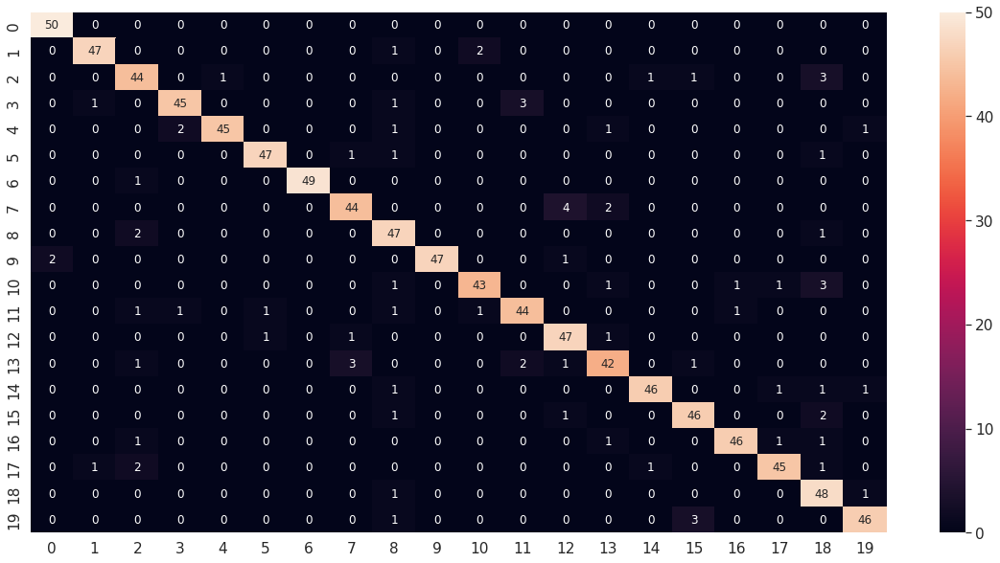

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg2_15_df_CM = pd.DataFrame(facenet_model_vgg2_15_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg2_15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg2_15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg2_15_report)

              precision    recall  f1-score   support

           1       0.96      1.00      0.98        50
           2       0.96      0.94      0.95        50
           3       0.85      0.88      0.86        50
           4       0.94      0.90      0.92        50
           5       0.98      0.90      0.94        50
           6       0.96      0.94      0.95        50
           7       1.00      0.98      0.99        50
           8       0.90      0.88      0.89        50
           9       0.82      0.94      0.88        50
          10       1.00      0.94      0.97        50
          11       0.93      0.86      0.90        50
          12       0.90      0.88      0.89        50
          13       0.87      0.94      0.90        50
          14       0.88      0.84      0.86        50
          15       0.96      0.92      0.94        50
          16       0.90      0.92      0.91        50
          17       0.96      0.92      0.94        50
          18       0.94    

## 9. Modelos con base de datos VGG-Latin para condiciones de etnia

#### Modelo 1: (BTH = 30, EHS = 30, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_1 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_1)
facenet_model_vgg3_1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_1)
facenet_model_vgg3_1.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_1.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_1 = facenet_model_vgg3_1.fit(new_trainX, new_trainY, batch_size=30, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
74/74 [==============================] - 28s 240ms/step - loss: 2.5932 - accuracy: 0.3452 - val_loss: 2.0198 - val_accuracy: 0.4945
Epoch 2/30
74/74 [==============================] - 14s 194ms/step - loss: 1.2917 - accuracy: 0.7385 - val_loss: 1.5370 - val_accuracy: 0.6655
Epoch 3/30
74/74 [==============================] - 14s 192ms/step - loss: 0.7303 - accuracy: 0.9186 - val_loss: 1.2245 - val_accuracy: 0.7600
Epoch 4/30
74/74 [==============================] - 14s 191ms/step - loss: 0.4887 - accuracy: 0.9750 - val_loss: 0.9876 - val_accuracy: 0.8164
Epoch 5/30
74/74 [==============================] - 14s 187ms/step - loss: 0.3851 - accuracy: 0.9936 - val_loss: 0.8643 - val_accuracy: 0.8509
Epoch 6/30
74/74 [==============================] - 14s 187ms/step - loss: 0.3243 - accuracy: 0.9977 - val_loss: 0.8110 - val_accuracy: 0.8582
Epoch 7/30
74/74 [==============================] - 14s 196ms/step - loss: 0.2848 - accuracy: 0.9986 - val_loss: 0.7317 - val_accuracy: 0.8691

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_1 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_1.evaluate(testX, testY)

32/32 [==============================] - 2s 53ms/step - loss: 0.4108 - accuracy: 0.9120


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


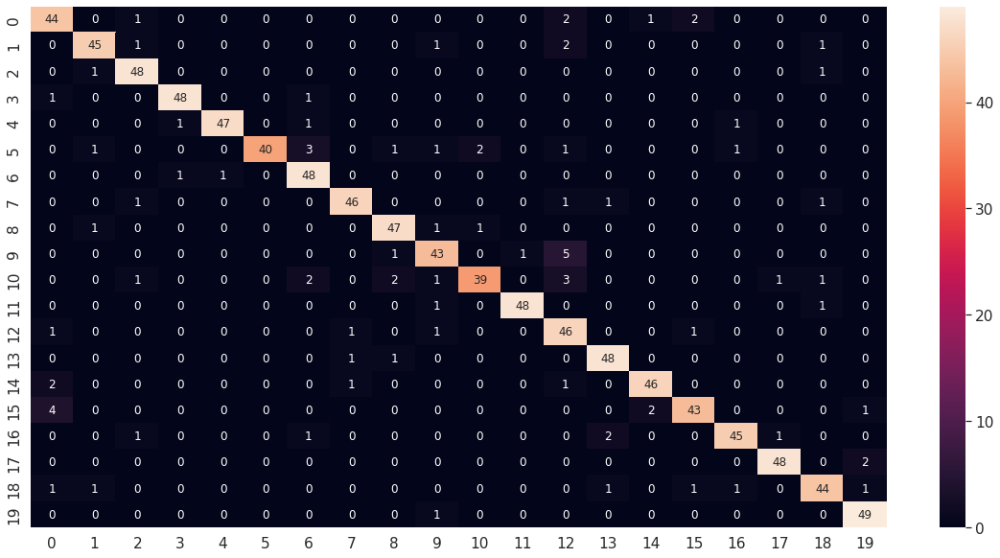

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_1_df_CM = pd.DataFrame(facenet_model_vgg3_1_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show() 

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_1_report)

              precision    recall  f1-score   support

           1       0.83      0.88      0.85        50
           2       0.92      0.90      0.91        50
           3       0.91      0.96      0.93        50
           4       0.96      0.96      0.96        50
           5       0.98      0.94      0.96        50
           6       1.00      0.80      0.89        50
           7       0.86      0.96      0.91        50
           8       0.94      0.92      0.93        50
           9       0.90      0.94      0.92        50
          10       0.86      0.86      0.86        50
          11       0.93      0.78      0.85        50
          12       0.98      0.96      0.97        50
          13       0.75      0.92      0.83        50
          14       0.92      0.96      0.94        50
          15       0.94      0.92      0.93        50
          16       0.91      0.86      0.89        50
          17       0.94      0.90      0.92        50
          18       0.96    

#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_2 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_2 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_2)
facenet_model_vgg3_2 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_2)
facenet_model_vgg3_2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_2.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_2 = facenet_model_vgg3_2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
74/74 [==============================] - 38s 230ms/step - loss: 2.6070 - accuracy: 0.3770 - val_loss: 6.2834 - val_accuracy: 0.0582
Epoch 2/80
74/74 [==============================] - 12s 156ms/step - loss: 1.2964 - accuracy: 0.7067 - val_loss: 7.4898 - val_accuracy: 0.0582
Epoch 3/80
74/74 [==============================] - 12s 157ms/step - loss: 0.8333 - accuracy: 0.8427 - val_loss: 9.5682 - val_accuracy: 0.0582
Epoch 4/80
74/74 [==============================] - 12s 159ms/step - loss: 0.5477 - accuracy: 0.9291 - val_loss: 8.7473 - val_accuracy: 0.0582
Epoch 5/80
74/74 [==============================] - 16s 212ms/step - loss: 0.3938 - accuracy: 0.9695 - val_loss: 6.2595 - val_accuracy: 0.0782
Epoch 6/80
74/74 [==============================] - 14s 195ms/step - loss: 0.3428 - accuracy: 0.9800 - val_loss: 5.5162 - val_accuracy: 0.0909
Epoch 7/80
74/74 [==============================] - 14s 192ms/step - loss: 0.2770 - accuracy: 0.9923 - val_loss: 3.5005 - val_accuracy: 0.1273

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_2 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_2.evaluate(testX, testY)

32/32 [==============================] - 2s 66ms/step - loss: 0.1854 - accuracy: 0.9770


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

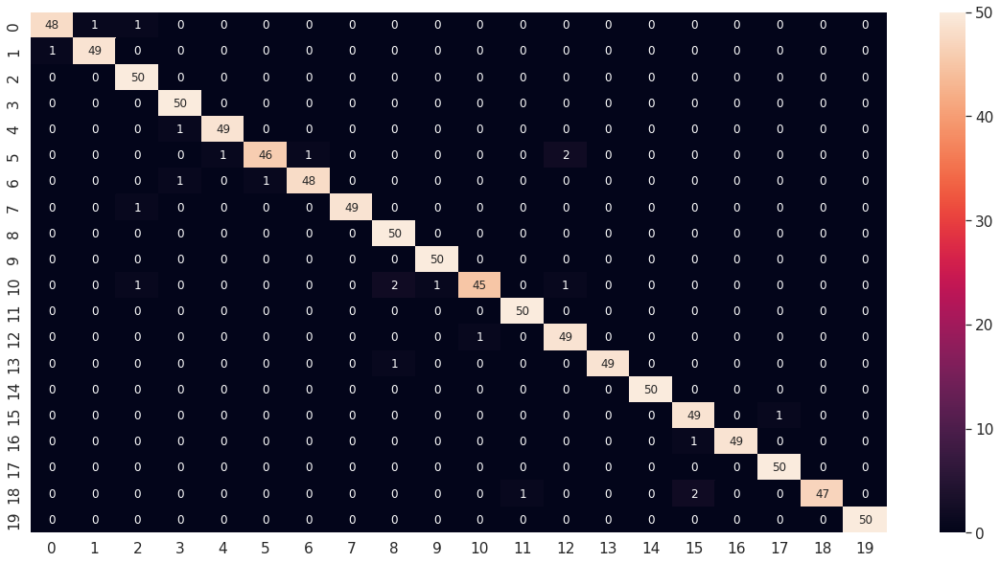

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_2_df_CM = pd.DataFrame(facenet_model_vgg3_2_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_2_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.98      0.98      0.98        50
           3       0.94      1.00      0.97        50
           4       0.96      1.00      0.98        50
           5       0.98      0.98      0.98        50
           6       0.98      0.92      0.95        50
           7       0.98      0.96      0.97        50
           8       1.00      0.98      0.99        50
           9       0.94      1.00      0.97        50
          10       0.98      1.00      0.99        50
          11       0.98      0.90      0.94        50
          12       0.98      1.00      0.99        50
          13       0.94      0.98      0.96        50
          14       1.00      0.98      0.99        50
          15       1.00      1.00      1.00        50
          16       0.94      0.98      0.96        50
          17       1.00      0.98      0.99        50
          18       0.98    

#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_3 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_3 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_3)
facenet_model_vgg3_3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_3)
facenet_model_vgg3_3.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_3.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_3 = facenet_model_vgg3_3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
74/74 [==============================] - 25s 213ms/step - loss: 0.6237 - accuracy: 0.9513 - val_loss: 0.9113 - val_accuracy: 0.8527
Epoch 2/50
74/74 [==============================] - 14s 193ms/step - loss: 0.3604 - accuracy: 0.9936 - val_loss: 0.7047 - val_accuracy: 0.8945
Epoch 3/50
74/74 [==============================] - 13s 169ms/step - loss: 0.2999 - accuracy: 0.9905 - val_loss: 1.3612 - val_accuracy: 0.7000
Epoch 4/50
74/74 [==============================] - 16s 212ms/step - loss: 0.2574 - accuracy: 0.9864 - val_loss: 0.5829 - val_accuracy: 0.8745
Epoch 5/50
74/74 [==============================] - 14s 189ms/step - loss: 0.1843 - accuracy: 0.9964 - val_loss: 0.5651 - val_accuracy: 0.8982
Epoch 6/50
74/74 [==============================] - 17s 226ms/step - loss: 0.1435 - accuracy: 0.9982 - val_loss: 0.3508 - val_accuracy: 0.9327
Epoch 7/50
74/74 [==============================] - 12s 164ms/step - loss: 0.1261 - accuracy: 0.9982 - val_loss: 0.3530 - val_accuracy: 0.9400

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_3 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_3.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.1834 - accuracy: 0.9740


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


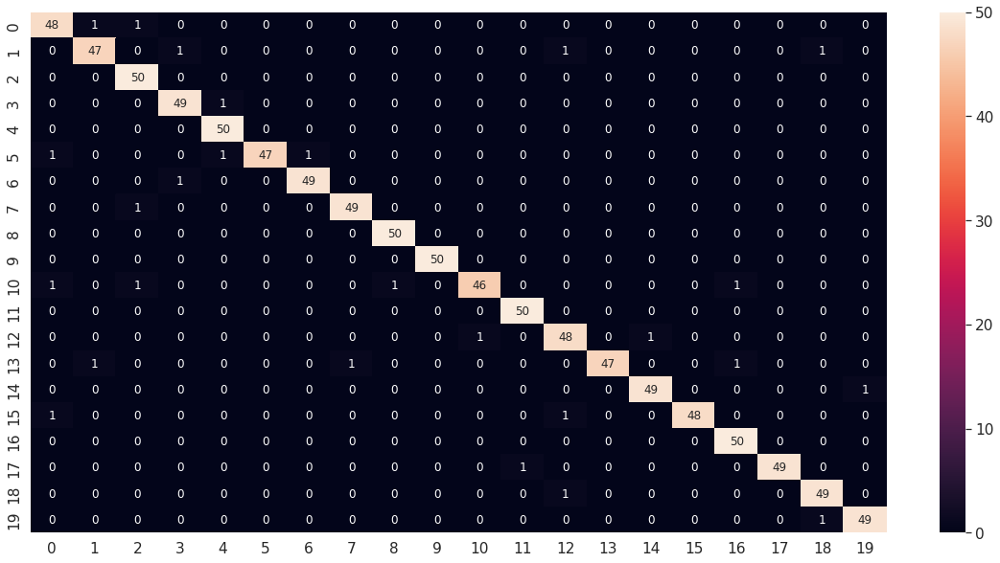

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_3_df_CM = pd.DataFrame(facenet_model_vgg3_3_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_3_report)

              precision    recall  f1-score   support

           1       0.94      0.96      0.95        50
           2       0.96      0.94      0.95        50
           3       0.94      1.00      0.97        50
           4       0.96      0.98      0.97        50
           5       0.96      1.00      0.98        50
           6       1.00      0.94      0.97        50
           7       0.98      0.98      0.98        50
           8       0.98      0.98      0.98        50
           9       0.98      1.00      0.99        50
          10       1.00      1.00      1.00        50
          11       0.98      0.92      0.95        50
          12       0.98      1.00      0.99        50
          13       0.94      0.96      0.95        50
          14       1.00      0.94      0.97        50
          15       0.98      0.98      0.98        50
          16       1.00      0.96      0.98        50
          17       0.96      1.00      0.98        50
          18       1.00    

#### Modelo 4: (BTH = 20, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.5 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_4 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_4 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_4)
facenet_model_vgg3_4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_4)
facenet_model_vgg3_4.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_4.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_4 = facenet_model_vgg3_4.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
110/110 [==============================] - 29s 168ms/step - loss: 1.1006 - accuracy: 0.8354 - val_loss: 0.9404 - val_accuracy: 0.8655
Epoch 2/30
110/110 [==============================] - 15s 140ms/step - loss: 0.4351 - accuracy: 0.9914 - val_loss: 0.7308 - val_accuracy: 0.8964
Epoch 3/30
110/110 [==============================] - 15s 139ms/step - loss: 0.3475 - accuracy: 0.9923 - val_loss: 0.6674 - val_accuracy: 0.8964
Epoch 4/30
110/110 [==============================] - 13s 117ms/step - loss: 0.3406 - accuracy: 0.9850 - val_loss: 0.8050 - val_accuracy: 0.8655
Epoch 5/30
110/110 [==============================] - 17s 151ms/step - loss: 0.2497 - accuracy: 0.9945 - val_loss: 0.5044 - val_accuracy: 0.9218
Epoch 6/30
110/110 [==============================] - 15s 134ms/step - loss: 0.1916 - accuracy: 1.0000 - val_loss: 0.3240 - val_accuracy: 0.9636
Epoch 7/30
110/110 [==============================] - 13s 121ms/step - loss: 0.1625 - accuracy: 0.9991 - val_loss: 0.3422 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_4 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_4.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2120 - accuracy: 0.9660


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


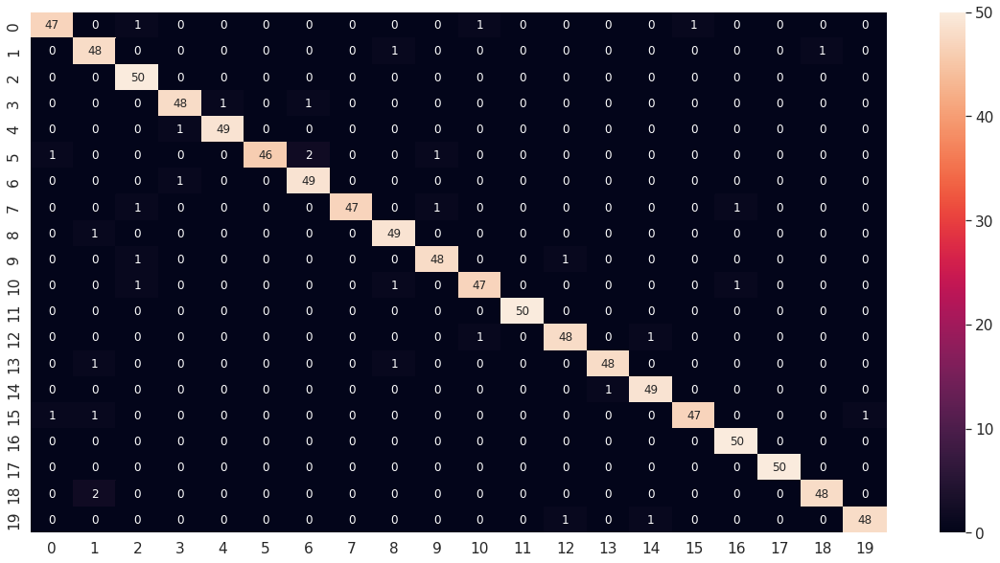

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_4_df_CM = pd.DataFrame(facenet_model_vgg3_4_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_4_report)

              precision    recall  f1-score   support

           1       0.96      0.94      0.95        50
           2       0.91      0.96      0.93        50
           3       0.93      1.00      0.96        50
           4       0.96      0.96      0.96        50
           5       0.98      0.98      0.98        50
           6       1.00      0.92      0.96        50
           7       0.94      0.98      0.96        50
           8       1.00      0.94      0.97        50
           9       0.94      0.98      0.96        50
          10       0.96      0.96      0.96        50
          11       0.96      0.94      0.95        50
          12       1.00      1.00      1.00        50
          13       0.96      0.96      0.96        50
          14       0.98      0.96      0.97        50
          15       0.96      0.98      0.97        50
          16       0.98      0.94      0.96        50
          17       0.96      1.00      0.98        50
          18       1.00    

#### Modelo 5: (BTH = 20, EHS = 80, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_5 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_5)
facenet_model_vgg3_5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_5)
facenet_model_vgg3_5.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_5.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_5 = facenet_model_vgg3_5.fit(new_trainX, new_trainY, batch_size=20, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
110/110 [==============================] - 28s 151ms/step - loss: 1.0320 - accuracy: 0.8472 - val_loss: 0.6813 - val_accuracy: 0.9291
Epoch 2/80
110/110 [==============================] - 13s 117ms/step - loss: 0.4220 - accuracy: 0.9927 - val_loss: 0.9881 - val_accuracy: 0.8582
Epoch 3/80
110/110 [==============================] - 17s 155ms/step - loss: 0.3539 - accuracy: 0.9936 - val_loss: 0.5578 - val_accuracy: 0.9273
Epoch 4/80
110/110 [==============================] - 15s 136ms/step - loss: 0.2681 - accuracy: 1.0000 - val_loss: 0.5100 - val_accuracy: 0.9400
Epoch 5/80
110/110 [==============================] - 15s 133ms/step - loss: 0.2251 - accuracy: 0.9986 - val_loss: 0.4257 - val_accuracy: 0.9436
Epoch 6/80
110/110 [==============================] - 15s 135ms/step - loss: 0.1788 - accuracy: 1.0000 - val_loss: 0.3570 - val_accuracy: 0.9473
Epoch 7/80
110/110 [==============================] - 15s 137ms/step - loss: 0.1541 - accuracy: 1.0000 - val_loss: 0.3235 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_5 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_5.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2180 - accuracy: 0.9630


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

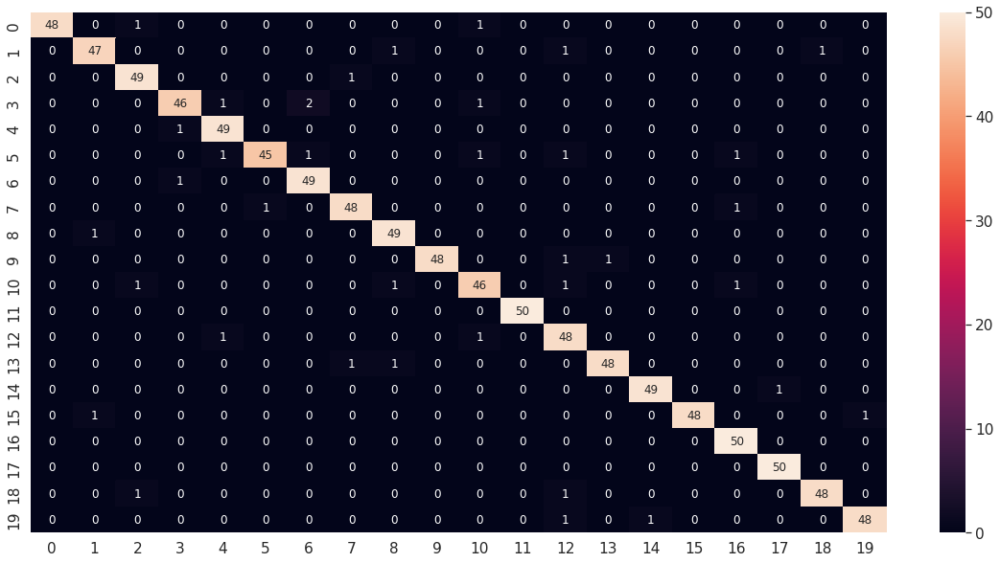

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_5_df_CM = pd.DataFrame(facenet_model_vgg3_5_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_5_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       0.96      0.94      0.95        50
           3       0.94      0.98      0.96        50
           4       0.96      0.92      0.94        50
           5       0.94      0.98      0.96        50
           6       0.98      0.90      0.94        50
           7       0.94      0.98      0.96        50
           8       0.96      0.96      0.96        50
           9       0.94      0.98      0.96        50
          10       1.00      0.96      0.98        50
          11       0.92      0.92      0.92        50
          12       1.00      1.00      1.00        50
          13       0.89      0.96      0.92        50
          14       0.98      0.96      0.97        50
          15       0.98      0.98      0.98        50
          16       1.00      0.96      0.98        50
          17       0.94      1.00      0.97        50
          18       0.98    

#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_6 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_6 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_6)
facenet_model_vgg3_6 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_6)
facenet_model_vgg3_6.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_6.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_6 = facenet_model_vgg3_6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
55/55 [==============================] - 29s 301ms/step - loss: 1.1360 - accuracy: 0.8408 - val_loss: 0.6943 - val_accuracy: 0.9327
Epoch 2/60
55/55 [==============================] - 13s 234ms/step - loss: 0.4171 - accuracy: 0.9986 - val_loss: 0.6410 - val_accuracy: 0.9364
Epoch 3/60
55/55 [==============================] - 13s 232ms/step - loss: 0.3590 - accuracy: 1.0000 - val_loss: 0.5765 - val_accuracy: 0.9436
Epoch 4/60
55/55 [==============================] - 13s 233ms/step - loss: 0.3092 - accuracy: 1.0000 - val_loss: 0.5119 - val_accuracy: 0.9436
Epoch 5/60
55/55 [==============================] - 13s 236ms/step - loss: 0.2645 - accuracy: 1.0000 - val_loss: 0.4592 - val_accuracy: 0.9436
Epoch 6/60
55/55 [==============================] - 13s 243ms/step - loss: 0.2256 - accuracy: 1.0000 - val_loss: 0.4127 - val_accuracy: 0.9491
Epoch 7/60
55/55 [==============================] - 13s 235ms/step - loss: 0.1943 - accuracy: 1.0000 - val_loss: 0.3677 - val_accuracy: 0.9545

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_6 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_6.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2356 - accuracy: 0.9630


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

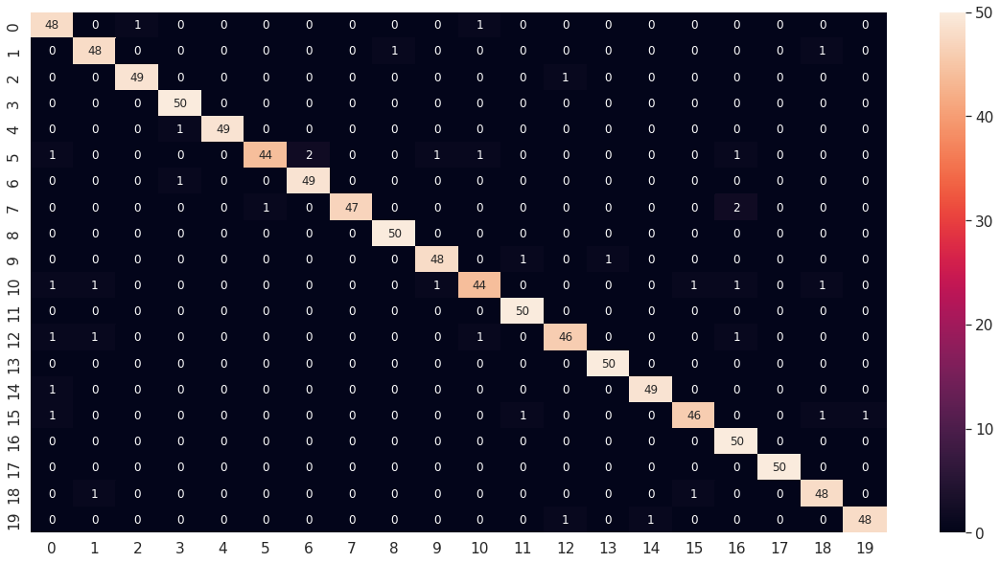

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_6_df_CM = pd.DataFrame(facenet_model_vgg3_6_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_6_report)

              precision    recall  f1-score   support

           1       0.91      0.96      0.93        50
           2       0.94      0.96      0.95        50
           3       0.98      0.98      0.98        50
           4       0.96      1.00      0.98        50
           5       1.00      0.98      0.99        50
           6       0.98      0.88      0.93        50
           7       0.96      0.98      0.97        50
           8       1.00      0.94      0.97        50
           9       0.98      1.00      0.99        50
          10       0.96      0.96      0.96        50
          11       0.94      0.88      0.91        50
          12       0.96      1.00      0.98        50
          13       0.96      0.92      0.94        50
          14       0.98      1.00      0.99        50
          15       0.98      0.98      0.98        50
          16       0.96      0.92      0.94        50
          17       0.91      1.00      0.95        50
          18       1.00    

#### Modelo 7: (BTH = 30, EHS = 100, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_7 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_7 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_7)
facenet_model_vgg3_7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_7)
facenet_model_vgg3_7.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_7.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_7 = facenet_model_vgg3_7.fit(new_trainX, new_trainY, batch_size=30, epochs=100, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/100
74/74 [==============================] - 30s 229ms/step - loss: 0.8861 - accuracy: 0.9013 - val_loss: 0.6473 - val_accuracy: 0.9400
Epoch 2/100
74/74 [==============================] - 14s 195ms/step - loss: 0.3873 - accuracy: 1.0000 - val_loss: 0.5436 - val_accuracy: 0.9491
Epoch 3/100
74/74 [==============================] - 15s 198ms/step - loss: 0.3149 - accuracy: 1.0000 - val_loss: 0.4577 - val_accuracy: 0.9582
Epoch 4/100
74/74 [==============================] - 14s 191ms/step - loss: 0.2536 - accuracy: 1.0000 - val_loss: 0.3967 - val_accuracy: 0.9564
Epoch 5/100
74/74 [==============================] - 14s 192ms/step - loss: 0.2048 - accuracy: 1.0000 - val_loss: 0.3547 - val_accuracy: 0.9582
Epoch 6/100
74/74 [==============================] - 14s 192ms/step - loss: 0.1687 - accuracy: 1.0000 - val_loss: 0.3239 - val_accuracy: 0.9582
Epoch 7/100
74/74 [==============================] - 14s 193ms/step - loss: 0.1434 - accuracy: 1.0000 - val_loss: 0.3047 - val_accuracy:

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_7 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_7.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2610 - accuracy: 0.9590


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 2s 52ms/step


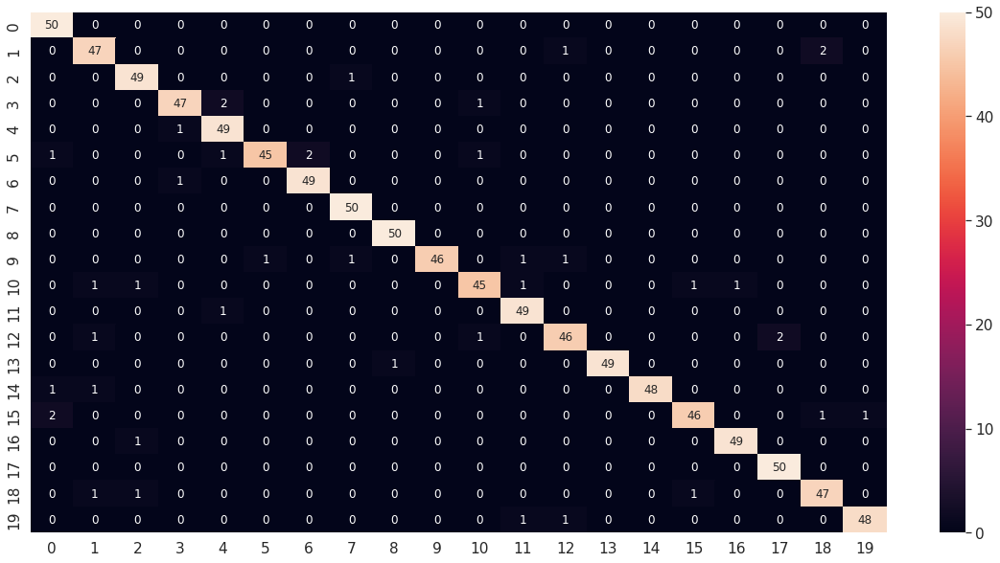

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_7_df_CM = pd.DataFrame(facenet_model_vgg3_7_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_7_report)

              precision    recall  f1-score   support

           1       0.93      1.00      0.96        50
           2       0.92      0.94      0.93        50
           3       0.94      0.98      0.96        50
           4       0.96      0.94      0.95        50
           5       0.92      0.98      0.95        50
           6       0.98      0.90      0.94        50
           7       0.96      0.98      0.97        50
           8       0.96      1.00      0.98        50
           9       0.98      1.00      0.99        50
          10       1.00      0.92      0.96        50
          11       0.94      0.90      0.92        50
          12       0.94      0.98      0.96        50
          13       0.94      0.92      0.93        50
          14       1.00      0.98      0.99        50
          15       1.00      0.96      0.98        50
          16       0.96      0.92      0.94        50
          17       0.98      0.98      0.98        50
          18       0.96    

#### Modelo 8: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_8 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_8 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_8)
facenet_model_vgg3_8 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_8)
facenet_model_vgg3_8.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg3_8.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_8.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_8 = facenet_model_vgg3_8.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
110/110 [==============================] - 28s 160ms/step - loss: 1.1140 - accuracy: 0.8654 - val_loss: 0.7138 - val_accuracy: 0.9418
Epoch 2/60
110/110 [==============================] - 19s 170ms/step - loss: 0.4719 - accuracy: 0.9995 - val_loss: 0.6369 - val_accuracy: 0.9436
Epoch 3/60
110/110 [==============================] - 18s 163ms/step - loss: 0.4326 - accuracy: 1.0000 - val_loss: 0.6053 - val_accuracy: 0.9473
Epoch 4/60
110/110 [==============================] - 16s 146ms/step - loss: 0.4061 - accuracy: 1.0000 - val_loss: 0.5807 - val_accuracy: 0.9491
Epoch 5/60
110/110 [==============================] - 16s 147ms/step - loss: 0.3834 - accuracy: 1.0000 - val_loss: 0.5635 - val_accuracy: 0.9491
Epoch 6/60
110/110 [==============================] - 17s 159ms/step - loss: 0.3630 - accuracy: 1.0000 - val_loss: 0.5441 - val_accuracy: 0.9491
Epoch 7/60
110/110 [==============================] - 16s 141ms/step - loss: 0.3428 - accuracy: 1.0000 - val_loss: 0.5279 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_8 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_8.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2402 - accuracy: 0.9610


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

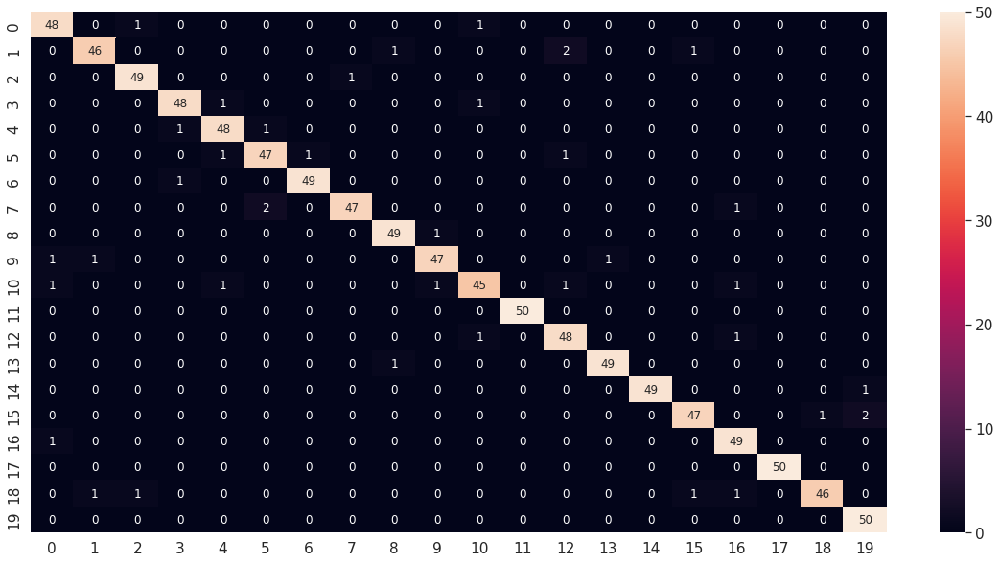

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_8_df_CM = pd.DataFrame(facenet_model_vgg3_8_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_8_report)

              precision    recall  f1-score   support

           1       0.94      0.96      0.95        50
           2       0.96      0.92      0.94        50
           3       0.96      0.98      0.97        50
           4       0.96      0.96      0.96        50
           5       0.94      0.96      0.95        50
           6       0.94      0.94      0.94        50
           7       0.98      0.98      0.98        50
           8       0.98      0.94      0.96        50
           9       0.96      0.98      0.97        50
          10       0.96      0.94      0.95        50
          11       0.94      0.90      0.92        50
          12       1.00      1.00      1.00        50
          13       0.92      0.96      0.94        50
          14       0.98      0.98      0.98        50
          15       1.00      0.98      0.99        50
          16       0.96      0.94      0.95        50
          17       0.92      0.98      0.95        50
          18       1.00    

#### Modelo 9: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_9 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_9 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_9)
facenet_model_vgg3_9 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_9)
facenet_model_vgg3_9.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_9.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_9 = facenet_model_vgg3_9.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
110/110 [==============================] - 28s 157ms/step - loss: 1.0924 - accuracy: 0.8367 - val_loss: 0.6737 - val_accuracy: 0.9382
Epoch 2/60
110/110 [==============================] - 13s 120ms/step - loss: 0.4512 - accuracy: 0.9927 - val_loss: 0.7478 - val_accuracy: 0.9309
Epoch 3/60
110/110 [==============================] - 18s 160ms/step - loss: 0.3478 - accuracy: 1.0000 - val_loss: 0.5729 - val_accuracy: 0.9491
Epoch 4/60
110/110 [==============================] - 18s 162ms/step - loss: 0.2864 - accuracy: 1.0000 - val_loss: 0.4988 - val_accuracy: 0.9473
Epoch 5/60
110/110 [==============================] - 16s 141ms/step - loss: 0.2364 - accuracy: 1.0000 - val_loss: 0.4371 - val_accuracy: 0.9491
Epoch 6/60
110/110 [==============================] - 16s 141ms/step - loss: 0.1957 - accuracy: 1.0000 - val_loss: 0.3913 - val_accuracy: 0.9509
Epoch 7/60
110/110 [==============================] - 13s 121ms/step - loss: 0.1672 - accuracy: 1.0000 - val_loss: 0.4051 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_9 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_9.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2580 - accuracy: 0.9600


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


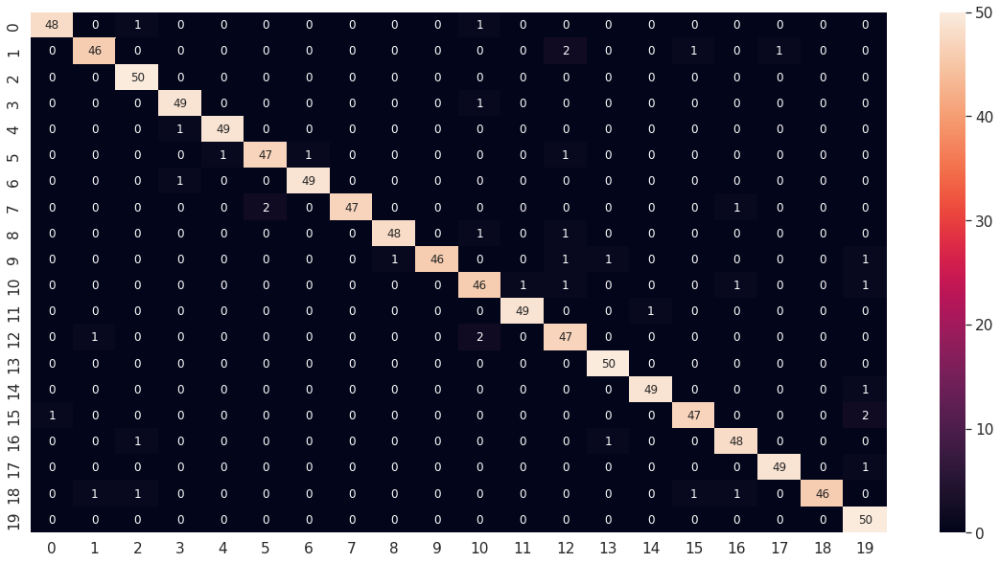

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_9_df_CM = pd.DataFrame(facenet_model_vgg3_9_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_9_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.96      0.92      0.94        50
           3       0.94      1.00      0.97        50
           4       0.96      0.98      0.97        50
           5       0.98      0.98      0.98        50
           6       0.96      0.94      0.95        50
           7       0.98      0.98      0.98        50
           8       1.00      0.94      0.97        50
           9       0.98      0.96      0.97        50
          10       1.00      0.92      0.96        50
          11       0.90      0.92      0.91        50
          12       0.98      0.98      0.98        50
          13       0.89      0.94      0.91        50
          14       0.96      1.00      0.98        50
          15       0.98      0.98      0.98        50
          16       0.96      0.94      0.95        50
          17       0.94      0.96      0.95        50
          18       0.98    

#### Modelo 10: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_10 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_10 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_10)
facenet_model_vgg3_10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_10)
facenet_model_vgg3_10.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg3_10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_10.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_10 = facenet_model_vgg3_10.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
74/74 [==============================] - 36s 225ms/step - loss: 3.0607 - accuracy: 0.2769 - val_loss: 3.9929 - val_accuracy: 0.0673
Epoch 2/50
74/74 [==============================] - 11s 153ms/step - loss: 1.7492 - accuracy: 0.5971 - val_loss: 4.3183 - val_accuracy: 0.0582
Epoch 3/50
74/74 [==============================] - 11s 153ms/step - loss: 1.0585 - accuracy: 0.8017 - val_loss: 5.4045 - val_accuracy: 0.0582
Epoch 4/50
74/74 [==============================] - 11s 152ms/step - loss: 0.6680 - accuracy: 0.9200 - val_loss: 5.3007 - val_accuracy: 0.0582
Epoch 5/50
74/74 [==============================] - 11s 152ms/step - loss: 0.5047 - accuracy: 0.9663 - val_loss: 5.7449 - val_accuracy: 0.0691
Epoch 6/50
74/74 [==============================] - 11s 153ms/step - loss: 0.4548 - accuracy: 0.9768 - val_loss: 5.7573 - val_accuracy: 0.0636
Epoch 7/50
74/74 [==============================] - 11s 154ms/step - loss: 0.4081 - accuracy: 0.9914 - val_loss: 6.6559 - val_accuracy: 0.0673

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_10 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_10.evaluate(testX, testY)

32/32 [==============================] - 2s 69ms/step - loss: 0.3242 - accuracy: 0.9420


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

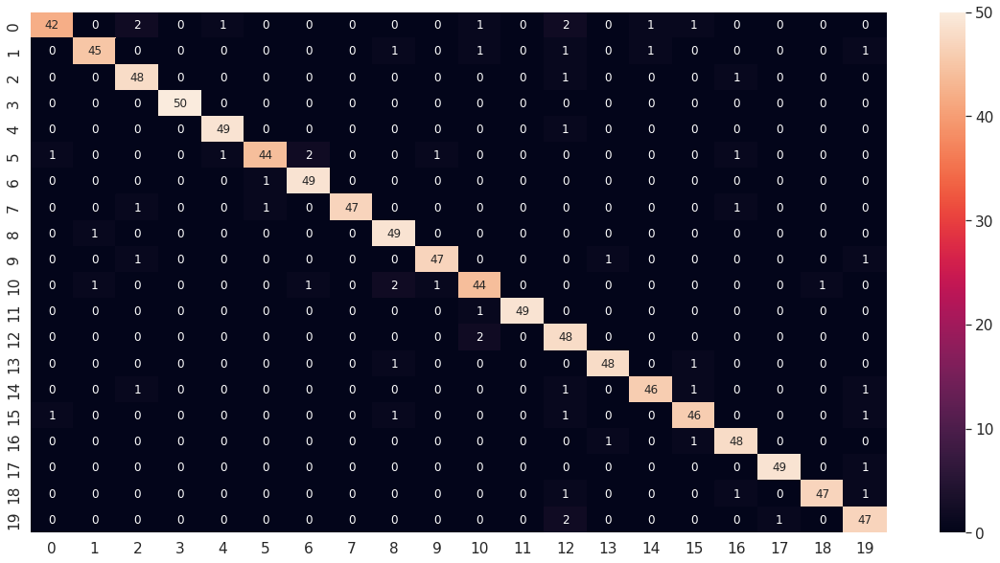

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_10_df_CM = pd.DataFrame(facenet_model_vgg3_10_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_10_report)

              precision    recall  f1-score   support

           1       0.95      0.84      0.89        50
           2       0.96      0.90      0.93        50
           3       0.91      0.96      0.93        50
           4       1.00      1.00      1.00        50
           5       0.96      0.98      0.97        50
           6       0.96      0.88      0.92        50
           7       0.94      0.98      0.96        50
           8       1.00      0.94      0.97        50
           9       0.91      0.98      0.94        50
          10       0.96      0.94      0.95        50
          11       0.90      0.88      0.89        50
          12       1.00      0.98      0.99        50
          13       0.83      0.96      0.89        50
          14       0.96      0.96      0.96        50
          15       0.96      0.92      0.94        50
          16       0.92      0.92      0.92        50
          17       0.92      0.96      0.94        50
          18       0.98    

#### Modelo 11: (BTH = 10, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_11 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_11 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_11)
facenet_model_vgg3_11 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_11)
facenet_model_vgg3_11.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg3_11.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_11.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_11 = facenet_model_vgg3_11.fit(new_trainX, new_trainY, batch_size=10, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
220/220 [==============================] - 32s 96ms/step - loss: 1.0434 - accuracy: 0.8204 - val_loss: 1.4106 - val_accuracy: 0.7218
Epoch 2/60
220/220 [==============================] - 21s 97ms/step - loss: 0.5116 - accuracy: 0.9700 - val_loss: 1.0946 - val_accuracy: 0.8127
Epoch 3/60
220/220 [==============================] - 22s 99ms/step - loss: 0.4378 - accuracy: 0.9804 - val_loss: 0.8170 - val_accuracy: 0.8455
Epoch 4/60
220/220 [==============================] - 17s 79ms/step - loss: 0.4046 - accuracy: 0.9800 - val_loss: 0.8193 - val_accuracy: 0.8509
Epoch 5/60
220/220 [==============================] - 17s 78ms/step - loss: 0.3756 - accuracy: 0.9859 - val_loss: 1.0282 - val_accuracy: 0.8091
Epoch 6/60
220/220 [==============================] - 20s 92ms/step - loss: 0.3376 - accuracy: 0.9900 - val_loss: 0.8136 - val_accuracy: 0.8582
Epoch 7/60
220/220 [==============================] - 20s 89ms/step - loss: 0.3126 - accuracy: 0.9909 - val_loss: 0.7032 - val_accuracy:

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_11 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_11.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2364 - accuracy: 0.9560


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

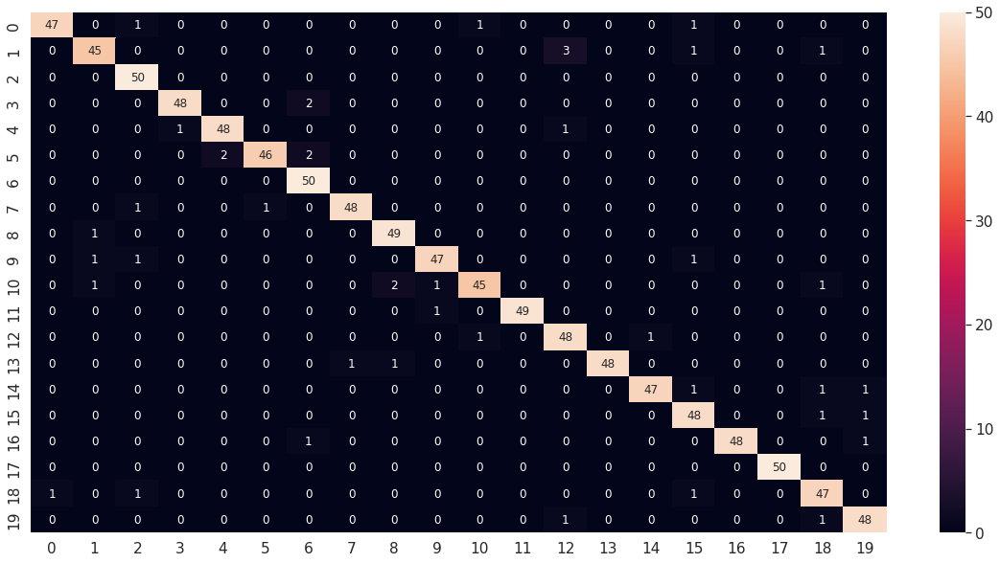

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_11_df_CM = pd.DataFrame(facenet_model_vgg3_11_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_11_report)

              precision    recall  f1-score   support

           1       0.98      0.94      0.96        50
           2       0.94      0.90      0.92        50
           3       0.93      1.00      0.96        50
           4       0.98      0.96      0.97        50
           5       0.96      0.96      0.96        50
           6       0.98      0.92      0.95        50
           7       0.91      1.00      0.95        50
           8       0.98      0.96      0.97        50
           9       0.94      0.98      0.96        50
          10       0.96      0.94      0.95        50
          11       0.96      0.90      0.93        50
          12       1.00      0.98      0.99        50
          13       0.91      0.96      0.93        50
          14       1.00      0.96      0.98        50
          15       0.98      0.94      0.96        50
          16       0.91      0.96      0.93        50
          17       1.00      0.96      0.98        50
          18       1.00    

#### Modelo 12: (BTH = 30, EHS = 100, ValidSplit = 0.2, Dropout = 0, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_12 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_12 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_12)
facenet_model_vgg3_12 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_12)
facenet_model_vgg3_12.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_12.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_12 = facenet_model_vgg3_12.fit(new_trainX, new_trainY, batch_size=30, epochs=100, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/100
74/74 [==============================] - 29s 217ms/step - loss: 0.8204 - accuracy: 0.8972 - val_loss: 7.8226 - val_accuracy: 0.0582
Epoch 2/100
74/74 [==============================] - 15s 202ms/step - loss: 0.4758 - accuracy: 0.9595 - val_loss: 2.0723 - val_accuracy: 0.6000
Epoch 3/100
74/74 [==============================] - 12s 163ms/step - loss: 0.4100 - accuracy: 0.9613 - val_loss: 2.2252 - val_accuracy: 0.5691
Epoch 4/100
74/74 [==============================] - 15s 210ms/step - loss: 0.3161 - accuracy: 0.9786 - val_loss: 0.8802 - val_accuracy: 0.8182
Epoch 5/100
74/74 [==============================] - 12s 160ms/step - loss: 0.2564 - accuracy: 0.9850 - val_loss: 0.9561 - val_accuracy: 0.8000
Epoch 6/100
74/74 [==============================] - 12s 160ms/step - loss: 0.1984 - accuracy: 0.9909 - val_loss: 1.5317 - val_accuracy: 0.6618
Epoch 7/100
74/74 [==============================] - 15s 206ms/step - loss: 0.1800 - accuracy: 0.9918 - val_loss: 0.5120 - val_accuracy:

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_12 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_12.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2412 - accuracy: 0.9580


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

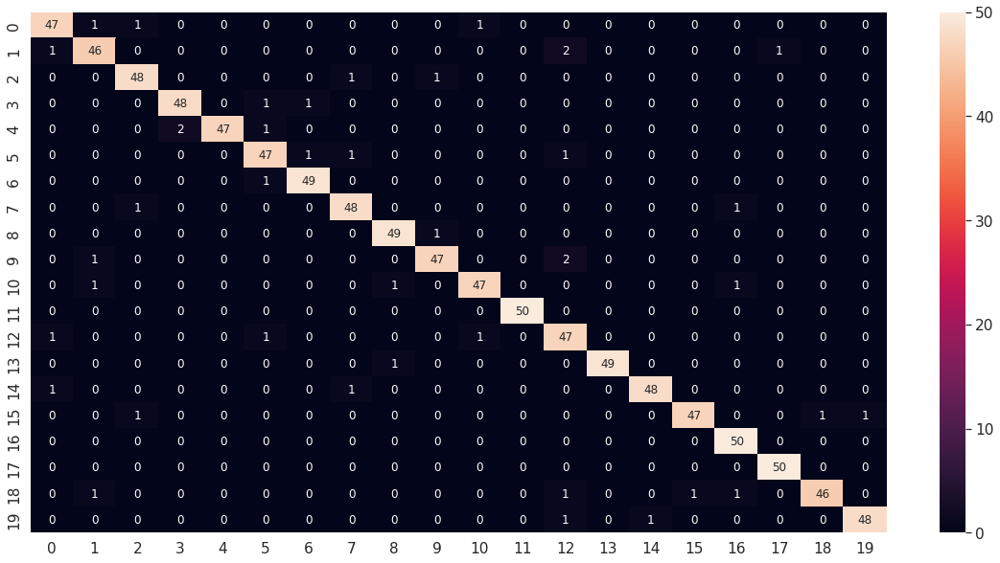

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_12_df_CM = pd.DataFrame(facenet_model_vgg3_12_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_12_report)

              precision    recall  f1-score   support

           1       0.94      0.94      0.94        50
           2       0.92      0.92      0.92        50
           3       0.94      0.96      0.95        50
           4       0.96      0.96      0.96        50
           5       1.00      0.94      0.97        50
           6       0.92      0.94      0.93        50
           7       0.96      0.98      0.97        50
           8       0.94      0.96      0.95        50
           9       0.96      0.98      0.97        50
          10       0.96      0.94      0.95        50
          11       0.96      0.94      0.95        50
          12       1.00      1.00      1.00        50
          13       0.87      0.94      0.90        50
          14       1.00      0.98      0.99        50
          15       0.98      0.96      0.97        50
          16       0.98      0.94      0.96        50
          17       0.94      1.00      0.97        50
          18       0.98    

#### Modelo 13: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_13 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_13 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_13)
facenet_model_vgg3_13 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_13)
facenet_model_vgg3_13.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_13.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_13 = facenet_model_vgg3_13.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
55/55 [==============================] - 37s 317ms/step - loss: 3.8613 - accuracy: 0.1401 - val_loss: 4.3432 - val_accuracy: 0.0400
Epoch 2/60
55/55 [==============================] - 11s 200ms/step - loss: 2.8696 - accuracy: 0.3074 - val_loss: 6.0667 - val_accuracy: 0.0491
Epoch 3/60
55/55 [==============================] - 11s 205ms/step - loss: 2.0151 - accuracy: 0.5184 - val_loss: 7.8889 - val_accuracy: 0.0327
Epoch 4/60
55/55 [==============================] - 11s 207ms/step - loss: 1.2583 - accuracy: 0.7171 - val_loss: 6.6098 - val_accuracy: 0.0545
Epoch 5/60
55/55 [==============================] - 11s 208ms/step - loss: 0.9510 - accuracy: 0.8063 - val_loss: 5.9520 - val_accuracy: 0.0655
Epoch 6/60
55/55 [==============================] - 11s 209ms/step - loss: 0.6307 - accuracy: 0.8986 - val_loss: 5.9642 - val_accuracy: 0.0727
Epoch 7/60
55/55 [==============================] - 11s 206ms/step - loss: 0.4604 - accuracy: 0.9504 - val_loss: 5.2216 - val_accuracy: 0.0691

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_13 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_13.evaluate(testX, testY)

32/32 [==============================] - 2s 66ms/step - loss: 0.2126 - accuracy: 0.9690


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

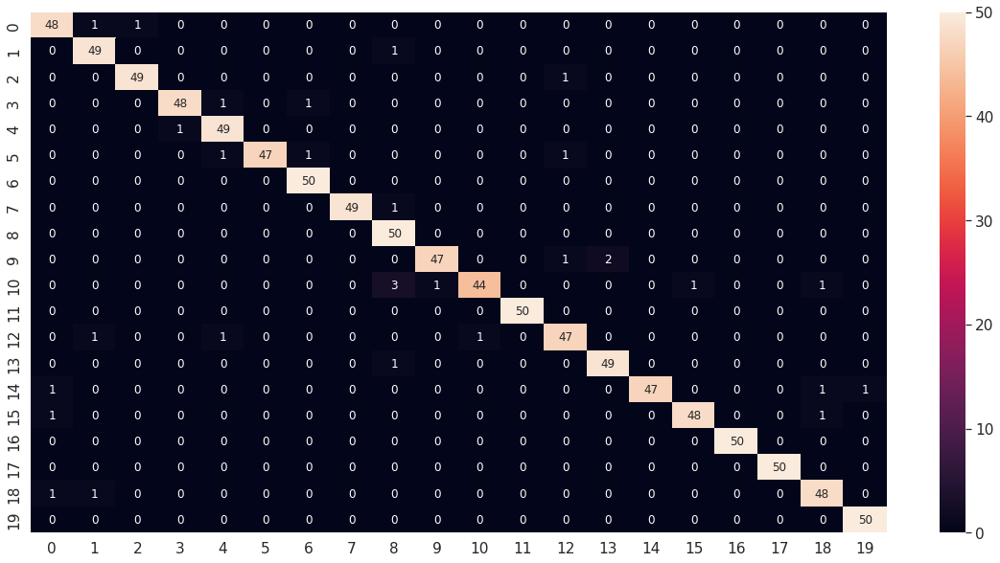

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_13_df_CM = pd.DataFrame(facenet_model_vgg3_13_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_13_report)

              precision    recall  f1-score   support

           1       0.94      0.96      0.95        50
           2       0.94      0.98      0.96        50
           3       0.98      0.98      0.98        50
           4       0.98      0.96      0.97        50
           5       0.94      0.98      0.96        50
           6       1.00      0.94      0.97        50
           7       0.96      1.00      0.98        50
           8       1.00      0.98      0.99        50
           9       0.89      1.00      0.94        50
          10       0.98      0.94      0.96        50
          11       0.98      0.88      0.93        50
          12       1.00      1.00      1.00        50
          13       0.94      0.94      0.94        50
          14       0.96      0.98      0.97        50
          15       1.00      0.94      0.97        50
          16       0.98      0.96      0.97        50
          17       1.00      1.00      1.00        50
          18       1.00    

#### Modelo 14: (BTH = 50, EHS = 50, ValidSplit = 0.2, INI = HeNormal, Dropout=0, REG = L2, OPT = adamax[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_14 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_14 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_14)
facenet_model_vgg3_14 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_14)
facenet_model_vgg3_14.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg3_14.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_14.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_14 = facenet_model_vgg3_14.fit(new_trainX, new_trainY, batch_size=50, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
44/44 [==============================] - 29s 394ms/step - loss: 0.7196 - accuracy: 0.9422 - val_loss: 0.7365 - val_accuracy: 0.9145
Epoch 2/50
44/44 [==============================] - 13s 293ms/step - loss: 0.4154 - accuracy: 0.9995 - val_loss: 0.6372 - val_accuracy: 0.9364
Epoch 3/50
44/44 [==============================] - 13s 291ms/step - loss: 0.3964 - accuracy: 1.0000 - val_loss: 0.5923 - val_accuracy: 0.9473
Epoch 4/50
44/44 [==============================] - 13s 292ms/step - loss: 0.3806 - accuracy: 1.0000 - val_loss: 0.5576 - val_accuracy: 0.9491
Epoch 5/50
44/44 [==============================] - 12s 281ms/step - loss: 0.3661 - accuracy: 1.0000 - val_loss: 0.5290 - val_accuracy: 0.9527
Epoch 6/50
44/44 [==============================] - 13s 289ms/step - loss: 0.3525 - accuracy: 1.0000 - val_loss: 0.5064 - val_accuracy: 0.9509
Epoch 7/50
44/44 [==============================] - 13s 286ms/step - loss: 0.3388 - accuracy: 1.0000 - val_loss: 0.4894 - val_accuracy: 0.9545

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_14 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_14.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2011 - accuracy: 0.9660


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 48ms/step


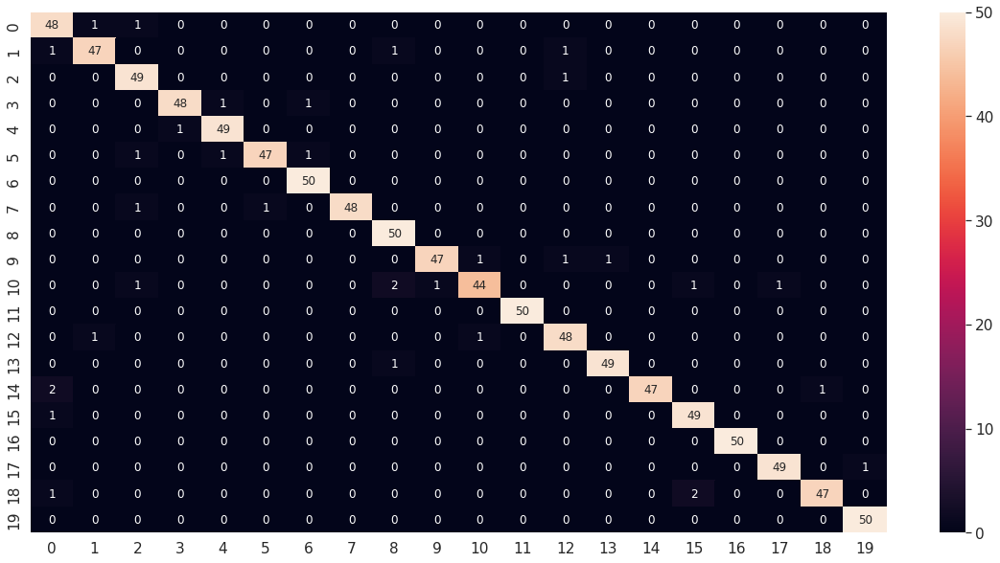

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_14_df_CM = pd.DataFrame(facenet_model_vgg3_14_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_14_report)

              precision    recall  f1-score   support

           1       0.91      0.96      0.93        50
           2       0.96      0.94      0.95        50
           3       0.92      0.98      0.95        50
           4       0.98      0.96      0.97        50
           5       0.96      0.98      0.97        50
           6       0.98      0.94      0.96        50
           7       0.96      1.00      0.98        50
           8       1.00      0.96      0.98        50
           9       0.93      1.00      0.96        50
          10       0.98      0.94      0.96        50
          11       0.96      0.88      0.92        50
          12       1.00      1.00      1.00        50
          13       0.94      0.96      0.95        50
          14       0.98      0.98      0.98        50
          15       1.00      0.94      0.97        50
          16       0.94      0.98      0.96        50
          17       1.00      1.00      1.00        50
          18       0.98    

#### Modelo 15: (BTH = 50, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg3_15 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg3_15 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg3_15)
facenet_model_vgg3_15 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg3_15)
facenet_model_vgg3_15.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg3_15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_15.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg3_15 = facenet_model_vgg3_15.fit(new_trainX, new_trainY, batch_size=50, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
44/44 [==============================] - 23s 313ms/step - loss: 0.9008 - accuracy: 0.8945 - val_loss: 1.7704 - val_accuracy: 0.7618
Epoch 2/60
44/44 [==============================] - 10s 227ms/step - loss: 0.4553 - accuracy: 0.9795 - val_loss: 1.7782 - val_accuracy: 0.7364
Epoch 3/60
44/44 [==============================] - 12s 276ms/step - loss: 0.4060 - accuracy: 0.9809 - val_loss: 1.2870 - val_accuracy: 0.7945
Epoch 4/60
44/44 [==============================] - 12s 275ms/step - loss: 0.3239 - accuracy: 0.9932 - val_loss: 1.0326 - val_accuracy: 0.8218
Epoch 5/60
44/44 [==============================] - 12s 283ms/step - loss: 0.2576 - accuracy: 0.9995 - val_loss: 0.6133 - val_accuracy: 0.9073
Epoch 6/60
44/44 [==============================] - 12s 278ms/step - loss: 0.2178 - accuracy: 1.0000 - val_loss: 0.5017 - val_accuracy: 0.9127
Epoch 7/60
44/44 [==============================] - 12s 278ms/step - loss: 0.1866 - accuracy: 1.0000 - val_loss: 0.4113 - val_accuracy: 0.9364

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg3_15 = load_model(path + 'data_reconocimiento1/models_VGG3/facenet_model_VGG3_15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg3_15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg3_15.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2250 - accuracy: 0.9610


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg3_15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg3_15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

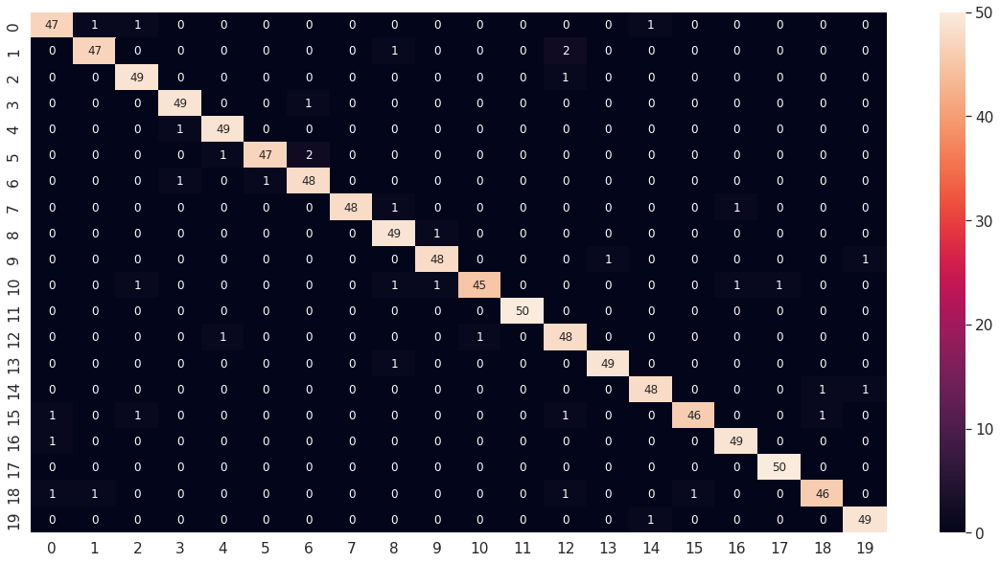

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg3_15_df_CM = pd.DataFrame(facenet_model_vgg3_15_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg3_15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg3_15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg3_15_report)

              precision    recall  f1-score   support

           1       0.94      0.94      0.94        50
           2       0.96      0.94      0.95        50
           3       0.94      0.98      0.96        50
           4       0.96      0.98      0.97        50
           5       0.96      0.98      0.97        50
           6       0.98      0.94      0.96        50
           7       0.94      0.96      0.95        50
           8       1.00      0.96      0.98        50
           9       0.92      0.98      0.95        50
          10       0.96      0.96      0.96        50
          11       0.98      0.90      0.94        50
          12       1.00      1.00      1.00        50
          13       0.91      0.96      0.93        50
          14       0.98      0.98      0.98        50
          15       0.96      0.96      0.96        50
          16       0.98      0.92      0.95        50
          17       0.96      0.98      0.97        50
          18       0.98    

## 10. Modelos con base de datos VGG-Indian para condiciones de etnia

#### Modelo 1: (BTH = 30, EHS = 30, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_1 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_1 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_1)
facenet_model_vgg4_1 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_1)
facenet_model_vgg4_1.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_1.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_1.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_1 = facenet_model_vgg4_1.fit(new_trainX, new_trainY, batch_size=30, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
72/72 [==============================] - 31s 246ms/step - loss: 1.8066 - accuracy: 0.5835 - val_loss: 1.9152 - val_accuracy: 0.5704
Epoch 2/30
72/72 [==============================] - 14s 195ms/step - loss: 0.7486 - accuracy: 0.8896 - val_loss: 1.6678 - val_accuracy: 0.6204
Epoch 3/30
72/72 [==============================] - 14s 192ms/step - loss: 0.5579 - accuracy: 0.9286 - val_loss: 1.1909 - val_accuracy: 0.7241
Epoch 4/30
72/72 [==============================] - 14s 191ms/step - loss: 0.4208 - accuracy: 0.9638 - val_loss: 1.1656 - val_accuracy: 0.7556
Epoch 5/30
72/72 [==============================] - 14s 191ms/step - loss: 0.3021 - accuracy: 0.9926 - val_loss: 0.5790 - val_accuracy: 0.8963
Epoch 6/30
72/72 [==============================] - 12s 161ms/step - loss: 0.2534 - accuracy: 0.9944 - val_loss: 0.5822 - val_accuracy: 0.8963
Epoch 7/30
72/72 [==============================] - 14s 193ms/step - loss: 0.2131 - accuracy: 0.9977 - val_loss: 0.4402 - val_accuracy: 0.9333

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_1 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_1.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_1.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_1.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2179 - accuracy: 0.9630


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_1.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_1_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


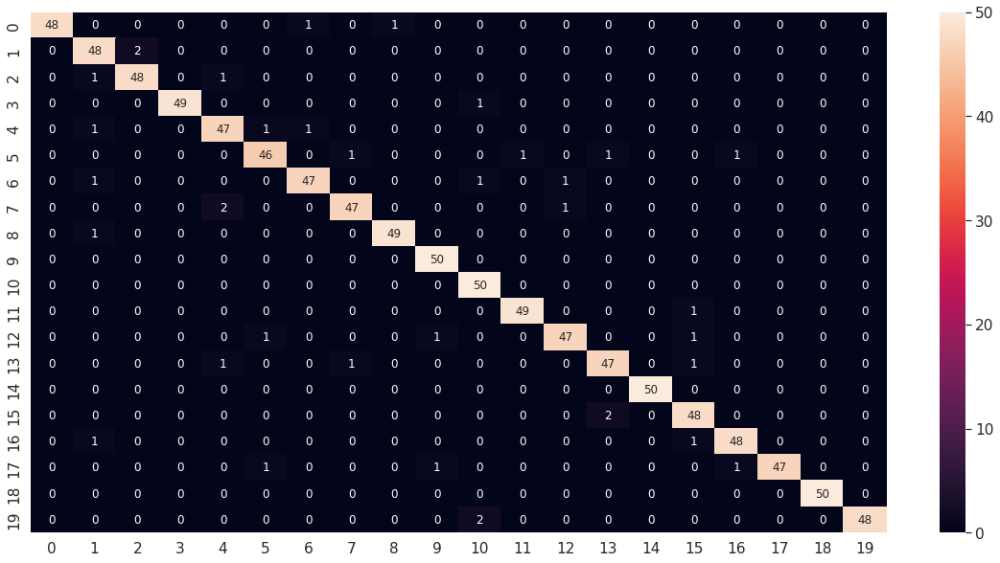

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_1_df_CM = pd.DataFrame(facenet_model_vgg4_1_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_1_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_1_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_1_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       0.91      0.96      0.93        50
           3       0.96      0.96      0.96        50
           4       1.00      0.98      0.99        50
           5       0.92      0.94      0.93        50
           6       0.94      0.92      0.93        50
           7       0.96      0.94      0.95        50
           8       0.96      0.94      0.95        50
           9       0.98      0.98      0.98        50
          10       0.96      1.00      0.98        50
          11       0.93      1.00      0.96        50
          12       0.98      0.98      0.98        50
          13       0.96      0.94      0.95        50
          14       0.94      0.94      0.94        50
          15       1.00      1.00      1.00        50
          16       0.92      0.96      0.94        50
          17       0.96      0.96      0.96        50
          18       1.00    

#### Modelo 2: (BTH = 30, EHS = 80, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_2 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_2 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_2)
facenet_model_vgg4_2 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_2)
facenet_model_vgg4_2.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_2.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_2.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_2 = facenet_model_vgg4_2.fit(new_trainX, new_trainY, batch_size=30, epochs=80, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/80
72/72 [==============================] - 25s 221ms/step - loss: 0.6736 - accuracy: 0.9332 - val_loss: 2.2196 - val_accuracy: 0.6556
Epoch 2/80
72/72 [==============================] - 14s 197ms/step - loss: 0.3885 - accuracy: 0.9842 - val_loss: 0.7955 - val_accuracy: 0.8630
Epoch 3/80
72/72 [==============================] - 14s 193ms/step - loss: 0.2990 - accuracy: 0.9926 - val_loss: 0.5916 - val_accuracy: 0.9093
Epoch 4/80
72/72 [==============================] - 14s 197ms/step - loss: 0.2312 - accuracy: 0.9944 - val_loss: 0.5605 - val_accuracy: 0.8963
Epoch 5/80
72/72 [==============================] - 12s 163ms/step - loss: 0.2255 - accuracy: 0.9856 - val_loss: 0.7485 - val_accuracy: 0.8500
Epoch 6/80
72/72 [==============================] - 12s 169ms/step - loss: 0.1687 - accuracy: 0.9954 - val_loss: 0.5793 - val_accuracy: 0.8741
Epoch 7/80
72/72 [==============================] - 12s 164ms/step - loss: 0.1412 - accuracy: 0.9958 - val_loss: 0.7494 - val_accuracy: 0.8407

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_2 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_2.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_2.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_2.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2237 - accuracy: 0.9650


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_2.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_2_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

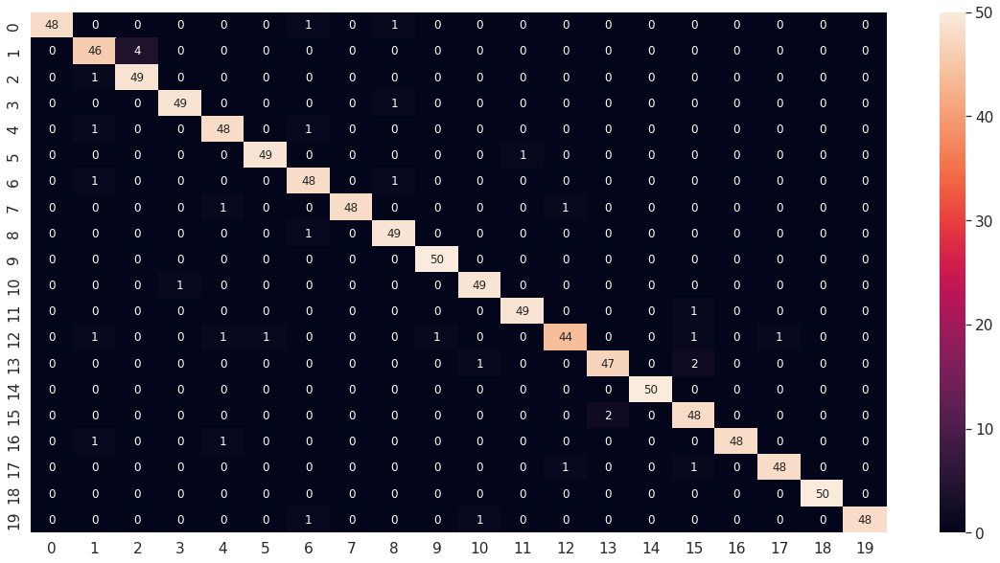

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_2_df_CM = pd.DataFrame(facenet_model_vgg4_2_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_2_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_2_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_2_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       0.90      0.92      0.91        50
           3       0.92      0.98      0.95        50
           4       0.98      0.98      0.98        50
           5       0.94      0.96      0.95        50
           6       0.98      0.98      0.98        50
           7       0.92      0.96      0.94        50
           8       1.00      0.96      0.98        50
           9       0.94      0.98      0.96        50
          10       0.98      1.00      0.99        50
          11       0.96      0.98      0.97        50
          12       0.98      0.98      0.98        50
          13       0.96      0.88      0.92        50
          14       0.96      0.94      0.95        50
          15       1.00      1.00      1.00        50
          16       0.91      0.96      0.93        50
          17       1.00      0.96      0.98        50
          18       0.98    

#### Modelo 3: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout=0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_3 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_3 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_3)
facenet_model_vgg4_3 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_3)
facenet_model_vgg4_3.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_3.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_3.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_3 = facenet_model_vgg4_3.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
72/72 [==============================] - 25s 223ms/step - loss: 0.7439 - accuracy: 0.9267 - val_loss: 0.8056 - val_accuracy: 0.8944
Epoch 2/50
72/72 [==============================] - 14s 195ms/step - loss: 0.3636 - accuracy: 0.9995 - val_loss: 0.7467 - val_accuracy: 0.8963
Epoch 3/50
72/72 [==============================] - 14s 195ms/step - loss: 0.3423 - accuracy: 0.9884 - val_loss: 0.7164 - val_accuracy: 0.8963
Epoch 4/50
72/72 [==============================] - 12s 166ms/step - loss: 0.3048 - accuracy: 0.9782 - val_loss: 0.8957 - val_accuracy: 0.8315
Epoch 5/50
72/72 [==============================] - 14s 192ms/step - loss: 0.2119 - accuracy: 0.9926 - val_loss: 0.4983 - val_accuracy: 0.9185
Epoch 6/50
72/72 [==============================] - 14s 191ms/step - loss: 0.1600 - accuracy: 0.9995 - val_loss: 0.3359 - val_accuracy: 0.9537
Epoch 7/50
72/72 [==============================] - 12s 163ms/step - loss: 0.1359 - accuracy: 0.9981 - val_loss: 0.4709 - val_accuracy: 0.9111

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_3 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_3.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_3.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_3.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.2366 - accuracy: 0.9620


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_3.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_3_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


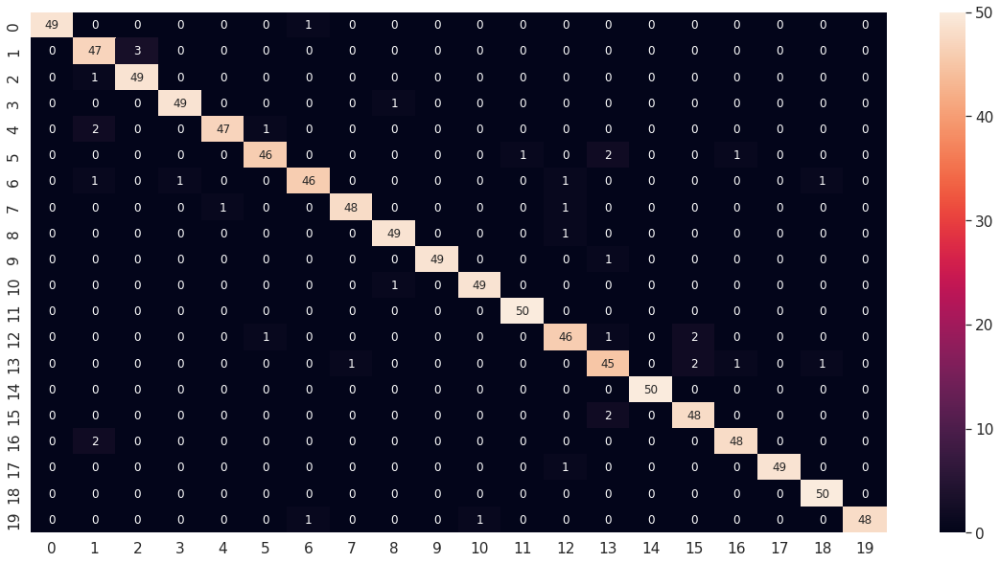

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_3_df_CM = pd.DataFrame(facenet_model_vgg4_3_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_3_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_3_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_3_report)

              precision    recall  f1-score   support

           1       1.00      0.98      0.99        50
           2       0.89      0.94      0.91        50
           3       0.94      0.98      0.96        50
           4       0.98      0.98      0.98        50
           5       0.98      0.94      0.96        50
           6       0.96      0.92      0.94        50
           7       0.96      0.92      0.94        50
           8       0.98      0.96      0.97        50
           9       0.96      0.98      0.97        50
          10       1.00      0.98      0.99        50
          11       0.98      0.98      0.98        50
          12       0.98      1.00      0.99        50
          13       0.92      0.92      0.92        50
          14       0.88      0.90      0.89        50
          15       1.00      1.00      1.00        50
          16       0.92      0.96      0.94        50
          17       0.96      0.96      0.96        50
          18       1.00    

#### Modelo 4: (BTH = 20, EHS = 30, ValidSplit = 0.2, INI = HeNormal, Dropout=0.5 REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_4 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_4 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_4)
facenet_model_vgg4_4 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_4)
facenet_model_vgg4_4.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_4.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_4.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_4 = facenet_model_vgg4_4.fit(new_trainX, new_trainY, batch_size=20, epochs=30, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/30
108/108 [==============================] - 28s 163ms/step - loss: 0.9657 - accuracy: 0.8669 - val_loss: 0.7407 - val_accuracy: 0.9222
Epoch 2/30
108/108 [==============================] - 14s 133ms/step - loss: 0.4328 - accuracy: 0.9870 - val_loss: 0.6038 - val_accuracy: 0.9333
Epoch 3/30
108/108 [==============================] - 13s 117ms/step - loss: 0.3548 - accuracy: 0.9875 - val_loss: 1.0558 - val_accuracy: 0.8593
Epoch 4/30
108/108 [==============================] - 15s 136ms/step - loss: 0.3409 - accuracy: 0.9787 - val_loss: 0.5233 - val_accuracy: 0.9296
Epoch 5/30
108/108 [==============================] - 15s 134ms/step - loss: 0.2204 - accuracy: 0.9986 - val_loss: 0.3848 - val_accuracy: 0.9481
Epoch 6/30
108/108 [==============================] - 15s 136ms/step - loss: 0.1792 - accuracy: 1.0000 - val_loss: 0.3125 - val_accuracy: 0.9556
Epoch 7/30
108/108 [==============================] - 14s 132ms/step - loss: 0.1541 - accuracy: 1.0000 - val_loss: 0.2691 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_4 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_4.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_4.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_4.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2329 - accuracy: 0.9640


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_4.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_4_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

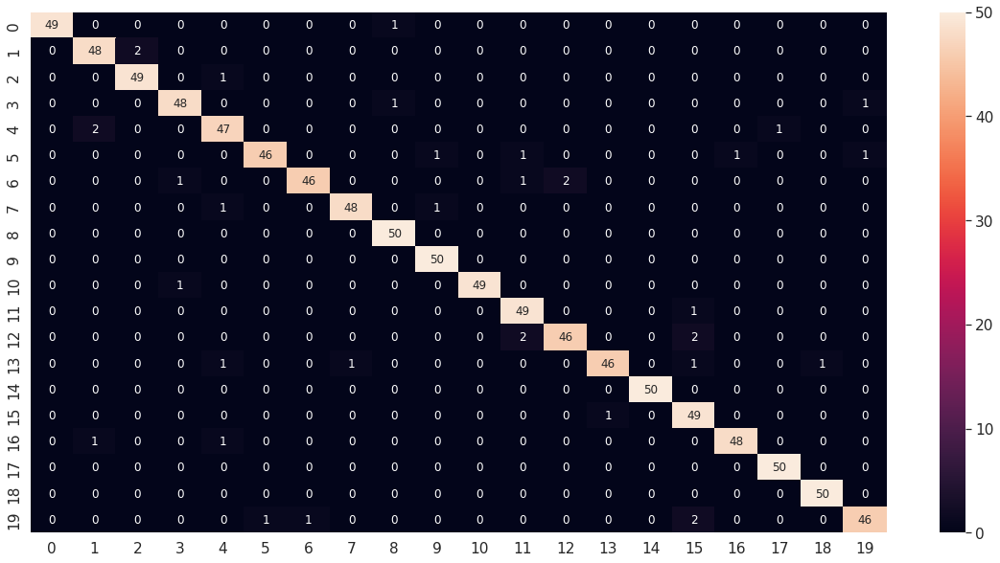

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_4_df_CM = pd.DataFrame(facenet_model_vgg4_4_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_4_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_4_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_4_report)

              precision    recall  f1-score   support

           1       1.00      0.98      0.99        50
           2       0.94      0.96      0.95        50
           3       0.96      0.98      0.97        50
           4       0.96      0.96      0.96        50
           5       0.92      0.94      0.93        50
           6       0.98      0.92      0.95        50
           7       0.98      0.92      0.95        50
           8       0.98      0.96      0.97        50
           9       0.96      1.00      0.98        50
          10       0.96      1.00      0.98        50
          11       1.00      0.98      0.99        50
          12       0.92      0.98      0.95        50
          13       0.96      0.92      0.94        50
          14       0.98      0.92      0.95        50
          15       1.00      1.00      1.00        50
          16       0.89      0.98      0.93        50
          17       0.98      0.96      0.97        50
          18       0.98    

#### Modelo 5: (BTH = 20, EHS = 60, ValidSplit = 0.2, INI = HeNormal, REG = L2, Dropout=0.2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_5 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_5 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_5)
facenet_model_vgg4_5 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_5)
facenet_model_vgg4_5.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_5.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_5.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_5 = facenet_model_vgg4_5.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
108/108 [==============================] - 38s 162ms/step - loss: 4.0329 - accuracy: 0.0756 - val_loss: 3.4855 - val_accuracy: 0.0574
Epoch 2/60
108/108 [==============================] - 12s 115ms/step - loss: 3.5196 - accuracy: 0.1368 - val_loss: 1556.0413 - val_accuracy: 0.0333
Epoch 3/60
108/108 [==============================] - 12s 115ms/step - loss: 3.2233 - accuracy: 0.1827 - val_loss: 77.1147 - val_accuracy: 0.0389
Epoch 4/60
108/108 [==============================] - 17s 156ms/step - loss: 2.6079 - accuracy: 0.3071 - val_loss: 3.1615 - val_accuracy: 0.1370
Epoch 5/60
108/108 [==============================] - 13s 116ms/step - loss: 1.9572 - accuracy: 0.4819 - val_loss: 3.7959 - val_accuracy: 0.1426
Epoch 6/60
108/108 [==============================] - 13s 116ms/step - loss: 1.5091 - accuracy: 0.6011 - val_loss: 4.2871 - val_accuracy: 0.2333
Epoch 7/60
108/108 [==============================] - 17s 155ms/step - loss: 1.1651 - accuracy: 0.7013 - val_loss: 2.6869 - va

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_5 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_5.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_5.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_5.evaluate(testX, testY)

32/32 [==============================] - 2s 55ms/step - loss: 0.3089 - accuracy: 0.9410


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_5.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_5_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


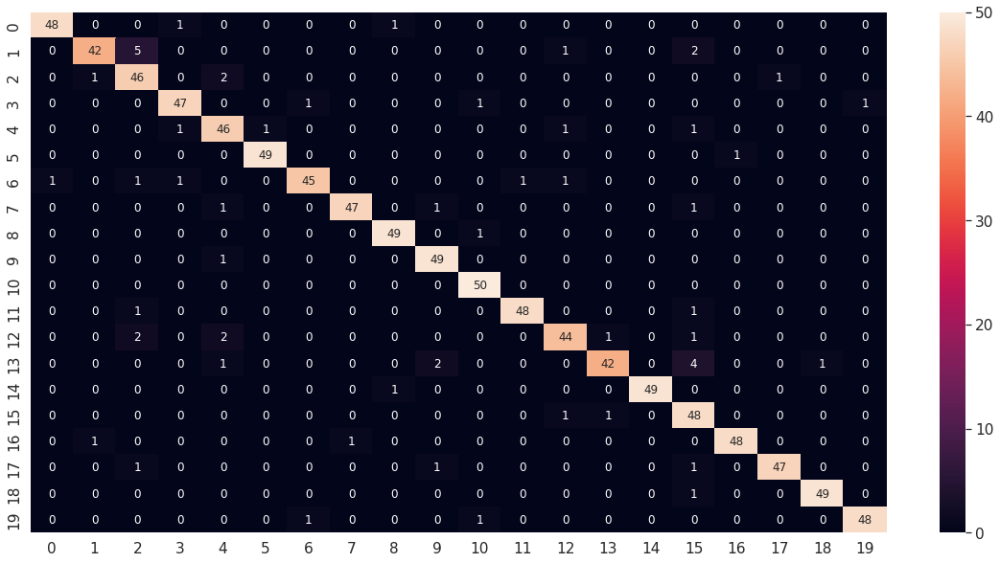

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_5_df_CM = pd.DataFrame(facenet_model_vgg4_5_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_5_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_5_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_5_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.95      0.84      0.89        50
           3       0.82      0.92      0.87        50
           4       0.94      0.94      0.94        50
           5       0.87      0.92      0.89        50
           6       0.98      0.98      0.98        50
           7       0.96      0.90      0.93        50
           8       0.98      0.94      0.96        50
           9       0.96      0.98      0.97        50
          10       0.92      0.98      0.95        50
          11       0.94      1.00      0.97        50
          12       0.98      0.96      0.97        50
          13       0.92      0.88      0.90        50
          14       0.95      0.84      0.89        50
          15       1.00      0.98      0.99        50
          16       0.80      0.96      0.87        50
          17       0.98      0.96      0.97        50
          18       0.98    

#### Modelo 6: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_6 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_6 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_6)
facenet_model_vgg4_6 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_6)
facenet_model_vgg4_6.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_6.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_6.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_6 = facenet_model_vgg4_6.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
54/54 [==============================] - 38s 310ms/step - loss: 2.8795 - accuracy: 0.2950 - val_loss: 4.1761 - val_accuracy: 0.0519
Epoch 2/60
54/54 [==============================] - 10s 189ms/step - loss: 1.5538 - accuracy: 0.6252 - val_loss: 5.9542 - val_accuracy: 0.0611
Epoch 3/60
54/54 [==============================] - 10s 190ms/step - loss: 0.9505 - accuracy: 0.8186 - val_loss: 6.4715 - val_accuracy: 0.0463
Epoch 4/60
54/54 [==============================] - 10s 191ms/step - loss: 0.6348 - accuracy: 0.9091 - val_loss: 4.9486 - val_accuracy: 0.0389
Epoch 5/60
54/54 [==============================] - 10s 191ms/step - loss: 0.4527 - accuracy: 0.9638 - val_loss: 5.4373 - val_accuracy: 0.0444
Epoch 6/60
54/54 [==============================] - 10s 192ms/step - loss: 0.3417 - accuracy: 0.9879 - val_loss: 5.2480 - val_accuracy: 0.0407
Epoch 7/60
54/54 [==============================] - 10s 193ms/step - loss: 0.2948 - accuracy: 0.9912 - val_loss: 4.7620 - val_accuracy: 0.0556

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_6 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_6.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_6.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_6.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2369 - accuracy: 0.9610


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_6.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_6_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

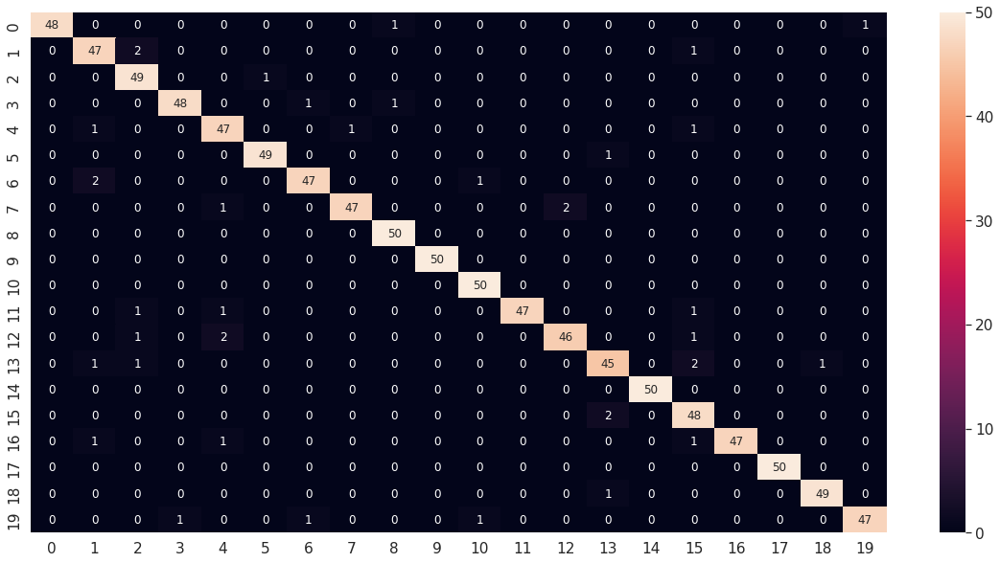

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_6_df_CM = pd.DataFrame(facenet_model_vgg4_6_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_6_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_6_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_6_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       0.90      0.94      0.92        50
           3       0.91      0.98      0.94        50
           4       0.98      0.96      0.97        50
           5       0.90      0.94      0.92        50
           6       0.98      0.98      0.98        50
           7       0.96      0.94      0.95        50
           8       0.98      0.94      0.96        50
           9       0.96      1.00      0.98        50
          10       1.00      1.00      1.00        50
          11       0.96      1.00      0.98        50
          12       1.00      0.94      0.97        50
          13       0.96      0.92      0.94        50
          14       0.92      0.90      0.91        50
          15       1.00      1.00      1.00        50
          16       0.87      0.96      0.91        50
          17       1.00      0.94      0.97        50
          18       1.00    

#### Modelo 7: (BTH = 30, EHS = 50, ValidSplit = 0.2, Dropout = 0.2, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_7 = Dropout(rate=0.2, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_7 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_7)
facenet_model_vgg4_7 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_7)
facenet_model_vgg4_7.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_7.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_7.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_7 = facenet_model_vgg4_7.fit(new_trainX, new_trainY, batch_size=30, epochs=50, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/50
72/72 [==============================] - 28s 227ms/step - loss: 0.9355 - accuracy: 0.8544 - val_loss: 2.9227 - val_accuracy: 0.5000
Epoch 2/50
72/72 [==============================] - 11s 154ms/step - loss: 0.6200 - accuracy: 0.9239 - val_loss: 3.5353 - val_accuracy: 0.4685
Epoch 3/50
72/72 [==============================] - 16s 217ms/step - loss: 0.4273 - accuracy: 0.9689 - val_loss: 1.9080 - val_accuracy: 0.6500
Epoch 4/50
72/72 [==============================] - 13s 184ms/step - loss: 0.3372 - accuracy: 0.9819 - val_loss: 1.5485 - val_accuracy: 0.6852
Epoch 5/50
72/72 [==============================] - 13s 182ms/step - loss: 0.2552 - accuracy: 0.9926 - val_loss: 1.1222 - val_accuracy: 0.7741
Epoch 6/50
72/72 [==============================] - 13s 180ms/step - loss: 0.2028 - accuracy: 0.9986 - val_loss: 0.3583 - val_accuracy: 0.9407
Epoch 7/50
72/72 [==============================] - 13s 180ms/step - loss: 0.1616 - accuracy: 1.0000 - val_loss: 0.2763 - val_accuracy: 0.9685

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_7 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_7.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_7.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_7.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2317 - accuracy: 0.9610


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_7.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_7_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 4s 51ms/step


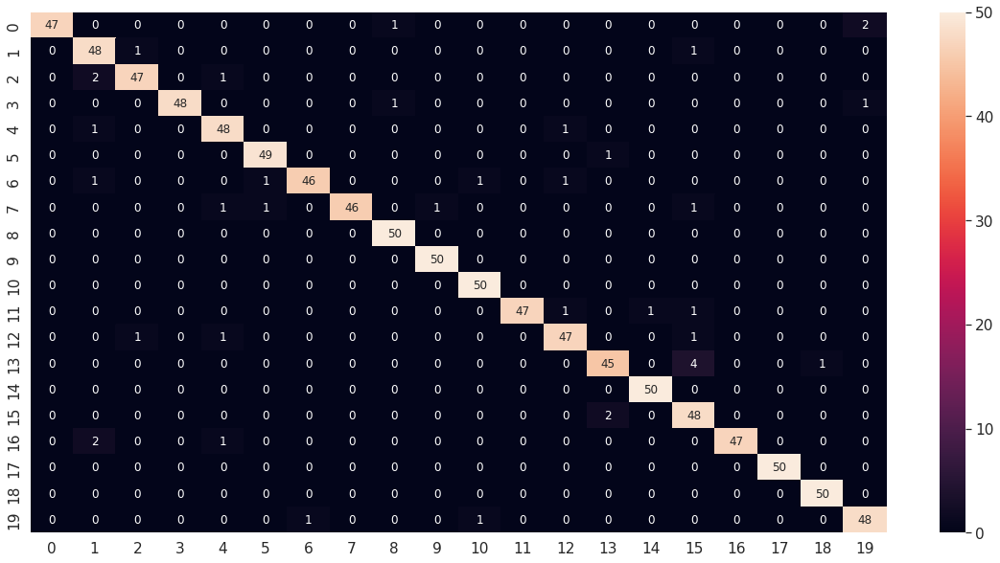

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_7_df_CM = pd.DataFrame(facenet_model_vgg4_7_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_7_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_7_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_7_report)

              precision    recall  f1-score   support

           1       1.00      0.94      0.97        50
           2       0.89      0.96      0.92        50
           3       0.96      0.94      0.95        50
           4       1.00      0.96      0.98        50
           5       0.92      0.96      0.94        50
           6       0.96      0.98      0.97        50
           7       0.98      0.92      0.95        50
           8       1.00      0.92      0.96        50
           9       0.96      1.00      0.98        50
          10       0.98      1.00      0.99        50
          11       0.96      1.00      0.98        50
          12       1.00      0.94      0.97        50
          13       0.94      0.94      0.94        50
          14       0.94      0.90      0.92        50
          15       0.98      1.00      0.99        50
          16       0.86      0.96      0.91        50
          17       1.00      0.94      0.97        50
          18       1.00    

#### Modelo 8: (BTH = 20, EHS = 60, ValidSplit = 0.2, Dropout = , INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_8 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_8 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_8)
facenet_model_vgg4_8 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_8)
facenet_model_vgg4_8.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg4_8.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_8.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_8 = facenet_model_vgg4_8.fit(new_trainX, new_trainY, batch_size=20, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
108/108 [==============================] - 28s 165ms/step - loss: 0.7119 - accuracy: 0.9406 - val_loss: 0.6255 - val_accuracy: 0.9426
Epoch 2/60
108/108 [==============================] - 15s 134ms/step - loss: 0.4190 - accuracy: 0.9991 - val_loss: 0.5393 - val_accuracy: 0.9574
Epoch 3/60
108/108 [==============================] - 15s 134ms/step - loss: 0.3930 - accuracy: 0.9995 - val_loss: 0.5094 - val_accuracy: 0.9630
Epoch 4/60
108/108 [==============================] - 15s 135ms/step - loss: 0.3682 - accuracy: 0.9995 - val_loss: 0.4682 - val_accuracy: 0.9648
Epoch 5/60
108/108 [==============================] - 15s 136ms/step - loss: 0.3424 - accuracy: 1.0000 - val_loss: 0.4393 - val_accuracy: 0.9722
Epoch 6/60
108/108 [==============================] - 15s 134ms/step - loss: 0.3192 - accuracy: 1.0000 - val_loss: 0.4252 - val_accuracy: 0.9648
Epoch 7/60
108/108 [==============================] - 12s 115ms/step - loss: 0.2986 - accuracy: 0.9991 - val_loss: 0.4321 - val_ac

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_8 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_8.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_8.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_8.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2318 - accuracy: 0.9660


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_8.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_8_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

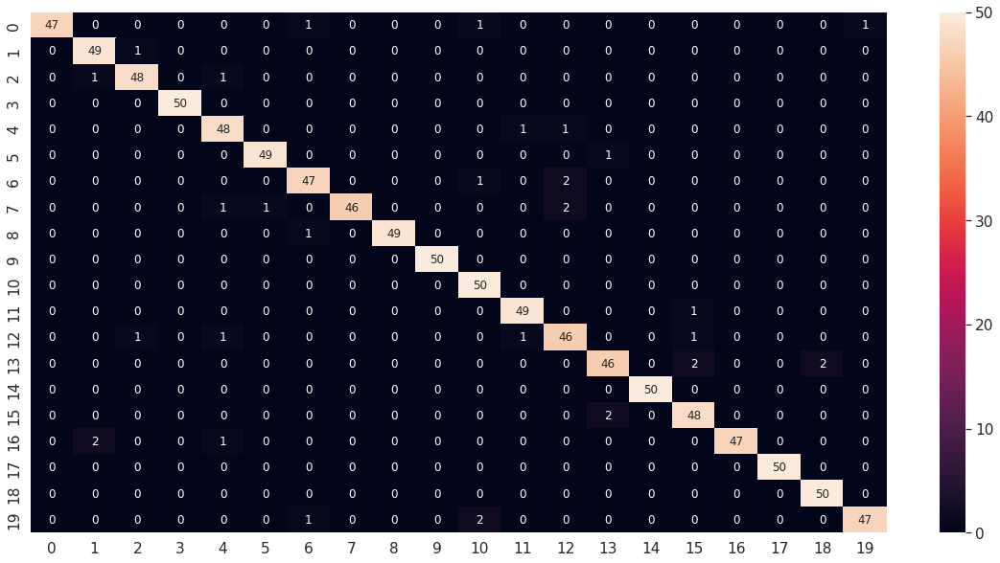

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_8_df_CM = pd.DataFrame(facenet_model_vgg4_8_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_8_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_8_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_8_report)

              precision    recall  f1-score   support

           1       1.00      0.94      0.97        50
           2       0.94      0.98      0.96        50
           3       0.96      0.96      0.96        50
           4       1.00      1.00      1.00        50
           5       0.92      0.96      0.94        50
           6       0.98      0.98      0.98        50
           7       0.94      0.94      0.94        50
           8       1.00      0.92      0.96        50
           9       1.00      0.98      0.99        50
          10       1.00      1.00      1.00        50
          11       0.93      1.00      0.96        50
          12       0.96      0.98      0.97        50
          13       0.90      0.92      0.91        50
          14       0.94      0.92      0.93        50
          15       1.00      1.00      1.00        50
          16       0.92      0.96      0.94        50
          17       1.00      0.94      0.97        50
          18       1.00    

#### Modelo 9: (BTH = 20, EHS = 100, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_9 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_9 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_9)
facenet_model_vgg4_9 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_9)
facenet_model_vgg4_9.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)     
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_9.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_9.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_9 = facenet_model_vgg4_9.fit(new_trainX, new_trainY, batch_size=20, epochs=100, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/100
108/108 [==============================] - 26s 150ms/step - loss: 0.6550 - accuracy: 0.9420 - val_loss: 1.4133 - val_accuracy: 0.7833
Epoch 2/100
108/108 [==============================] - 14s 133ms/step - loss: 0.3956 - accuracy: 0.9768 - val_loss: 1.3316 - val_accuracy: 0.7815
Epoch 3/100
108/108 [==============================] - 15s 135ms/step - loss: 0.3305 - accuracy: 0.9731 - val_loss: 1.1396 - val_accuracy: 0.7685
Epoch 4/100
108/108 [==============================] - 15s 137ms/step - loss: 0.2595 - accuracy: 0.9777 - val_loss: 0.6676 - val_accuracy: 0.8722
Epoch 5/100
108/108 [==============================] - 15s 134ms/step - loss: 0.1832 - accuracy: 0.9917 - val_loss: 0.6148 - val_accuracy: 0.8796
Epoch 6/100
108/108 [==============================] - 13s 116ms/step - loss: 0.1747 - accuracy: 0.9889 - val_loss: 0.7576 - val_accuracy: 0.8426
Epoch 7/100
108/108 [==============================] - 13s 116ms/step - loss: 0.1574 - accuracy: 0.9912 - val_loss: 0.6977 -

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_9 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_9.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_9.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_9.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2700 - accuracy: 0.9580


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_9.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_9_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


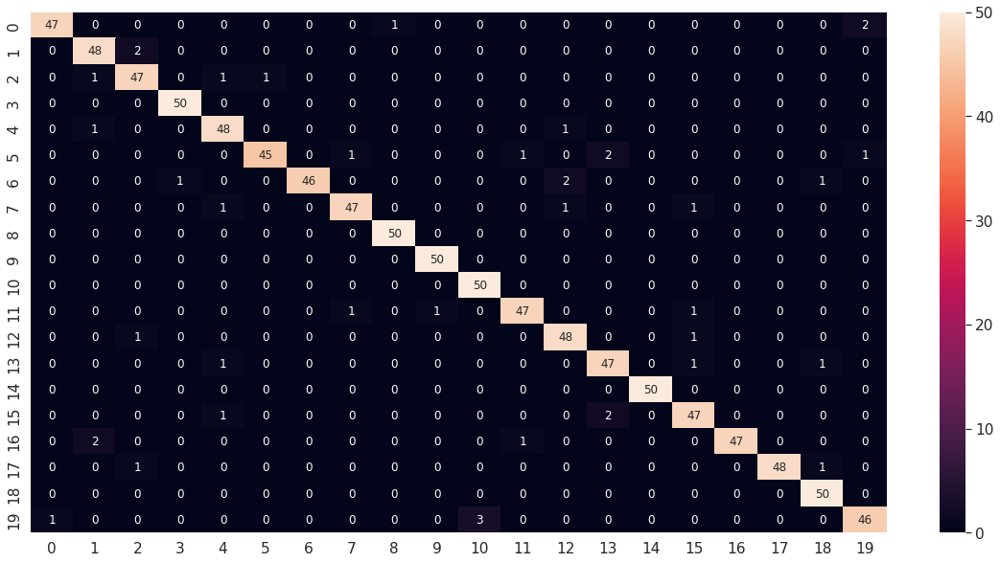

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_9_df_CM = pd.DataFrame(facenet_model_vgg4_9_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_9_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_9_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_9_report)

              precision    recall  f1-score   support

           1       0.98      0.94      0.96        50
           2       0.92      0.96      0.94        50
           3       0.92      0.94      0.93        50
           4       0.98      1.00      0.99        50
           5       0.92      0.96      0.94        50
           6       0.98      0.90      0.94        50
           7       1.00      0.92      0.96        50
           8       0.96      0.94      0.95        50
           9       0.98      1.00      0.99        50
          10       0.98      1.00      0.99        50
          11       0.94      1.00      0.97        50
          12       0.96      0.94      0.95        50
          13       0.92      0.96      0.94        50
          14       0.92      0.94      0.93        50
          15       1.00      1.00      1.00        50
          16       0.92      0.94      0.93        50
          17       1.00      0.94      0.97        50
          18       1.00    

#### Modelo 10: (BTH = 30, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_10 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_10 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_10)
facenet_model_vgg4_10 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_10)
facenet_model_vgg4_10.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index) 
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg4_10.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_10.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_10 = facenet_model_vgg4_10.fit(new_trainX, new_trainY, batch_size=30, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
72/72 [==============================] - 26s 215ms/step - loss: 1.5315 - accuracy: 0.7124 - val_loss: 0.8904 - val_accuracy: 0.8944
Epoch 2/60
72/72 [==============================] - 14s 191ms/step - loss: 0.5710 - accuracy: 0.9838 - val_loss: 0.6704 - val_accuracy: 0.9333
Epoch 3/60
72/72 [==============================] - 13s 187ms/step - loss: 0.4917 - accuracy: 0.9944 - val_loss: 0.6365 - val_accuracy: 0.9444
Epoch 4/60
72/72 [==============================] - 14s 187ms/step - loss: 0.4508 - accuracy: 0.9972 - val_loss: 0.6028 - val_accuracy: 0.9463
Epoch 5/60
72/72 [==============================] - 13s 185ms/step - loss: 0.4278 - accuracy: 1.0000 - val_loss: 0.5928 - val_accuracy: 0.9481
Epoch 6/60
72/72 [==============================] - 13s 186ms/step - loss: 0.4156 - accuracy: 1.0000 - val_loss: 0.5800 - val_accuracy: 0.9500
Epoch 7/60
72/72 [==============================] - 13s 186ms/step - loss: 0.4006 - accuracy: 0.9995 - val_loss: 0.5594 - val_accuracy: 0.9593

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_10 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_10.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_10.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_10.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.3002 - accuracy: 0.9570


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_10.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_10_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

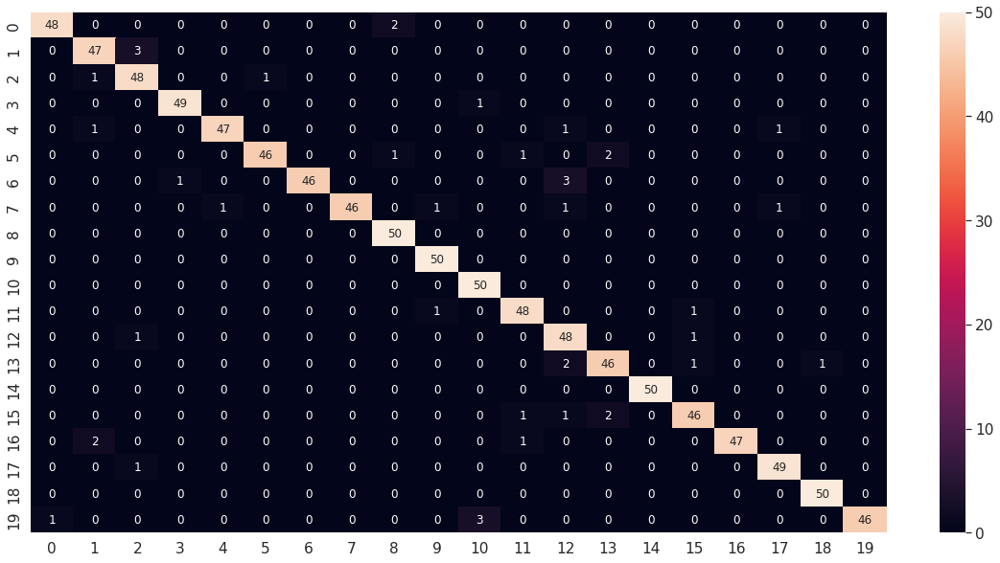

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_10_df_CM = pd.DataFrame(facenet_model_vgg4_10_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_10_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_10_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_10_report)

              precision    recall  f1-score   support

           1       0.98      0.96      0.97        50
           2       0.92      0.94      0.93        50
           3       0.91      0.96      0.93        50
           4       0.98      0.98      0.98        50
           5       0.98      0.94      0.96        50
           6       0.98      0.92      0.95        50
           7       1.00      0.92      0.96        50
           8       1.00      0.92      0.96        50
           9       0.94      1.00      0.97        50
          10       0.96      1.00      0.98        50
          11       0.93      1.00      0.96        50
          12       0.94      0.96      0.95        50
          13       0.86      0.96      0.91        50
          14       0.92      0.92      0.92        50
          15       1.00      1.00      1.00        50
          16       0.94      0.92      0.93        50
          17       1.00      0.94      0.97        50
          18       0.96    

#### Modelo 11: (BTH = 10, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adamax[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_11 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_11 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_11)
facenet_model_vgg4_11 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_11)
facenet_model_vgg4_11.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                              

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg4_11.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_11.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_11 = facenet_model_vgg4_11.fit(new_trainX, new_trainY, batch_size=10, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
216/216 [==============================] - 42s 99ms/step - loss: 2.8667 - accuracy: 0.2955 - val_loss: 5.4245 - val_accuracy: 0.0333
Epoch 2/60
216/216 [==============================] - 17s 77ms/step - loss: 1.5205 - accuracy: 0.6405 - val_loss: 9.1530 - val_accuracy: 0.0333
Epoch 3/60
216/216 [==============================] - 21s 97ms/step - loss: 0.8994 - accuracy: 0.8391 - val_loss: 4.8855 - val_accuracy: 0.1111
Epoch 4/60
216/216 [==============================] - 21s 98ms/step - loss: 0.6071 - accuracy: 0.9314 - val_loss: 2.7483 - val_accuracy: 0.3981
Epoch 5/60
216/216 [==============================] - 22s 101ms/step - loss: 0.4878 - accuracy: 0.9610 - val_loss: 0.9864 - val_accuracy: 0.7759
Epoch 6/60
216/216 [==============================] - 17s 79ms/step - loss: 0.4205 - accuracy: 0.9740 - val_loss: 1.0271 - val_accuracy: 0.7778
Epoch 7/60
216/216 [==============================] - 20s 94ms/step - loss: 0.3796 - accuracy: 0.9833 - val_loss: 0.8326 - val_accuracy

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_11 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_11.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_11.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_11.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2453 - accuracy: 0.9580


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_11.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_11_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_11_df_CM = pd.DataFrame(facenet_model_vgg4_11_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_11_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_11_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_11_report)

              precision    recall  f1-score   support

           1       0.98      0.94      0.96        50
           2       0.84      0.98      0.91        50
           3       0.96      0.92      0.94        50
           4       0.98      0.98      0.98        50
           5       0.94      0.96      0.95        50
           6       0.94      0.94      0.94        50
           7       0.94      0.92      0.93        50
           8       0.96      0.96      0.96        50
           9       0.96      1.00      0.98        50
          10       1.00      1.00      1.00        50
          11       0.98      0.96      0.97        50
          12       0.91      0.96      0.93        50
          13       0.98      0.90      0.94        50
          14       0.98      0.94      0.96        50
          15       1.00      1.00      1.00        50
          16       0.94      0.96      0.95        50
          17       0.96      0.94      0.95        50
          18       0.98    

#### Modelo 12: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0, INI = HeNoraml, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_12 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_12 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_12)
facenet_model_vgg4_12 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_12)
facenet_model_vgg4_12.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_12.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_12.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_12 = facenet_model_vgg4_12.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
54/54 [==============================] - 29s 323ms/step - loss: 0.7653 - accuracy: 0.9193 - val_loss: 2.3369 - val_accuracy: 0.5796
Epoch 2/60
54/54 [==============================] - 13s 244ms/step - loss: 0.4933 - accuracy: 0.9671 - val_loss: 2.3305 - val_accuracy: 0.5630
Epoch 3/60
54/54 [==============================] - 11s 207ms/step - loss: 0.3587 - accuracy: 0.9907 - val_loss: 4.6024 - val_accuracy: 0.4056
Epoch 4/60
54/54 [==============================] - 11s 207ms/step - loss: 0.2996 - accuracy: 0.9893 - val_loss: 2.3948 - val_accuracy: 0.5944
Epoch 5/60
54/54 [==============================] - 15s 280ms/step - loss: 0.2426 - accuracy: 0.9930 - val_loss: 0.6500 - val_accuracy: 0.8630
Epoch 6/60
54/54 [==============================] - 13s 237ms/step - loss: 0.1974 - accuracy: 0.9972 - val_loss: 0.5481 - val_accuracy: 0.9019
Epoch 7/60
54/54 [==============================] - 13s 237ms/step - loss: 0.1505 - accuracy: 1.0000 - val_loss: 0.3122 - val_accuracy: 0.9556

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_12 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_12.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_12.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_12.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2437 - accuracy: 0.9620


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_12.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_12_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

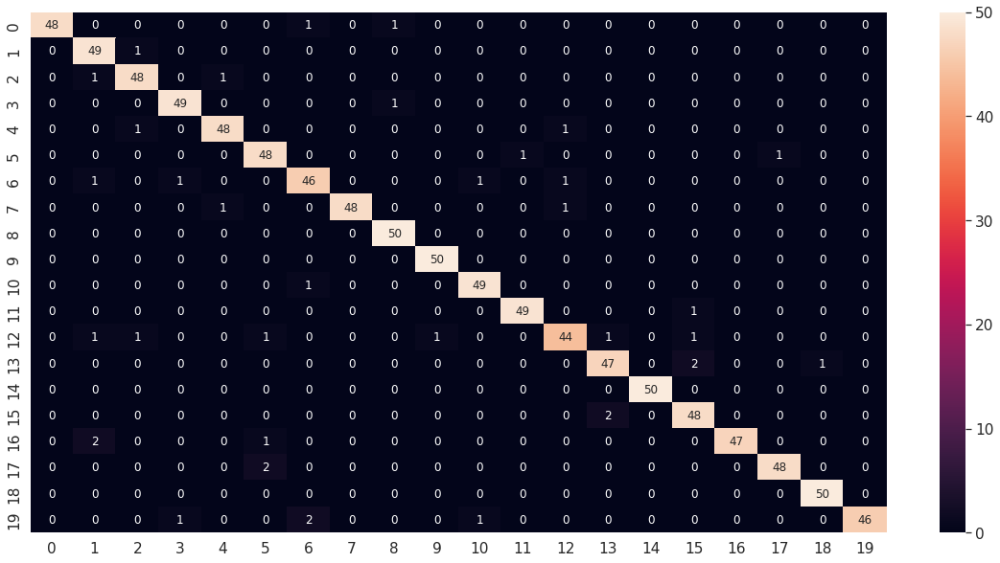

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_12_df_CM = pd.DataFrame(facenet_model_vgg4_12_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_12_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_12_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_12_report)

              precision    recall  f1-score   support

           1       1.00      0.96      0.98        50
           2       0.91      0.98      0.94        50
           3       0.94      0.96      0.95        50
           4       0.96      0.98      0.97        50
           5       0.96      0.96      0.96        50
           6       0.92      0.96      0.94        50
           7       0.92      0.92      0.92        50
           8       1.00      0.96      0.98        50
           9       0.96      1.00      0.98        50
          10       0.98      1.00      0.99        50
          11       0.96      0.98      0.97        50
          12       0.98      0.98      0.98        50
          13       0.94      0.88      0.91        50
          14       0.94      0.94      0.94        50
          15       1.00      1.00      1.00        50
          16       0.92      0.96      0.94        50
          17       1.00      0.94      0.97        50
          18       0.98    

#### Modelo 13: (BTH = 40, EHS = 60, ValidSplit = 0.2, Dropout = 0.5, INI = HeNormal, Dropout=0.2, REG = L2, OPT = adam[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_13 = Dropout(rate=0.5, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_13 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_13)
facenet_model_vgg4_13 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_13)
facenet_model_vgg4_13.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)   
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_13.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_13.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_13 = facenet_model_vgg4_13.fit(new_trainX, new_trainY, batch_size=40, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
54/54 [==============================] - 27s 278ms/step - loss: 0.9633 - accuracy: 0.8664 - val_loss: 5.5090 - val_accuracy: 0.3370
Epoch 2/60
54/54 [==============================] - 13s 243ms/step - loss: 0.5327 - accuracy: 0.9638 - val_loss: 2.0308 - val_accuracy: 0.6537
Epoch 3/60
54/54 [==============================] - 13s 243ms/step - loss: 0.3831 - accuracy: 0.9921 - val_loss: 0.9775 - val_accuracy: 0.8426
Epoch 4/60
54/54 [==============================] - 11s 208ms/step - loss: 0.4303 - accuracy: 0.9689 - val_loss: 2.3707 - val_accuracy: 0.5778
Epoch 5/60
54/54 [==============================] - 11s 206ms/step - loss: 0.3939 - accuracy: 0.9675 - val_loss: 2.0758 - val_accuracy: 0.5815
Epoch 6/60
54/54 [==============================] - 11s 204ms/step - loss: 0.3064 - accuracy: 0.9838 - val_loss: 1.0544 - val_accuracy: 0.7981
Epoch 7/60
54/54 [==============================] - 15s 284ms/step - loss: 0.2164 - accuracy: 0.9981 - val_loss: 0.5856 - val_accuracy: 0.8833

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_13 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_13.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_13.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_13.evaluate(testX, testY)

32/32 [==============================] - 2s 52ms/step - loss: 0.2435 - accuracy: 0.9600


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_13.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_13_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 51ms/step


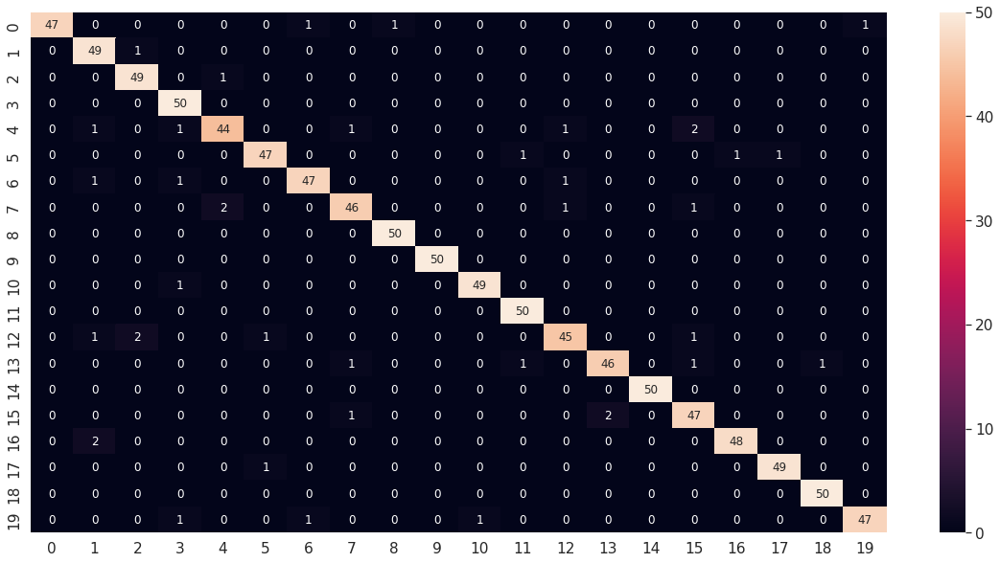

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_13_df_CM = pd.DataFrame(facenet_model_vgg4_13_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_13_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_13_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_13_report)

              precision    recall  f1-score   support

           1       1.00      0.94      0.97        50
           2       0.91      0.98      0.94        50
           3       0.94      0.98      0.96        50
           4       0.93      1.00      0.96        50
           5       0.94      0.88      0.91        50
           6       0.96      0.94      0.95        50
           7       0.96      0.94      0.95        50
           8       0.94      0.92      0.93        50
           9       0.98      1.00      0.99        50
          10       1.00      1.00      1.00        50
          11       0.98      0.98      0.98        50
          12       0.96      1.00      0.98        50
          13       0.94      0.90      0.92        50
          14       0.96      0.92      0.94        50
          15       1.00      1.00      1.00        50
          16       0.90      0.94      0.92        50
          17       0.98      0.96      0.97        50
          18       0.98    

#### Modelo 14: (BTH = 50, EHS = 60, ValidSplit = 0.2, INI = HeNormal, Dropout=0, REG = L2, OPT = adamax[0.001])






In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_14 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_14 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_14)
facenet_model_vgg4_14 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_14)
facenet_model_vgg4_14.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)    
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adamax=Adamax(learning_rate=0.001)
facenet_model_vgg4_14.compile(optimizer=adamax, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_14.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_14 = facenet_model_vgg4_14.fit(new_trainX, new_trainY, batch_size=50, epochs=60, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/60
44/44 [==============================] - 31s 329ms/step - loss: 0.8767 - accuracy: 0.9063 - val_loss: 0.7149 - val_accuracy: 0.9241
Epoch 2/60
44/44 [==============================] - 13s 286ms/step - loss: 0.4471 - accuracy: 1.0000 - val_loss: 0.6502 - val_accuracy: 0.9352
Epoch 3/60
44/44 [==============================] - 13s 289ms/step - loss: 0.4334 - accuracy: 0.9991 - val_loss: 0.6020 - val_accuracy: 0.9481
Epoch 4/60
44/44 [==============================] - 13s 299ms/step - loss: 0.4167 - accuracy: 1.0000 - val_loss: 0.5637 - val_accuracy: 0.9574
Epoch 5/60
44/44 [==============================] - 13s 285ms/step - loss: 0.4049 - accuracy: 0.9995 - val_loss: 0.5536 - val_accuracy: 0.9574
Epoch 6/60
44/44 [==============================] - 10s 237ms/step - loss: 0.3946 - accuracy: 0.9995 - val_loss: 0.5542 - val_accuracy: 0.9556
Epoch 7/60
44/44 [==============================] - 12s 284ms/step - loss: 0.3811 - accuracy: 1.0000 - val_loss: 0.5351 - val_accuracy: 0.9593

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_14 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_14.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_14.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_14.evaluate(testX, testY)

32/32 [==============================] - 2s 51ms/step - loss: 0.2956 - accuracy: 0.9460


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_14.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_14_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 50ms/step


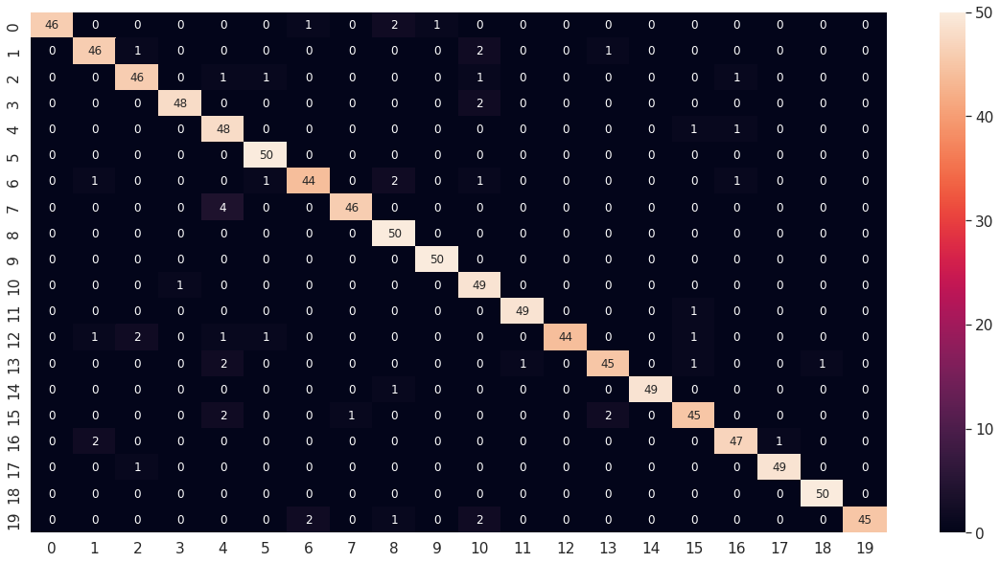

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_14_df_CM = pd.DataFrame(facenet_model_vgg4_14_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_14_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_14_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_14_report)

              precision    recall  f1-score   support

           1       1.00      0.92      0.96        50
           2       0.92      0.92      0.92        50
           3       0.92      0.92      0.92        50
           4       0.98      0.96      0.97        50
           5       0.83      0.96      0.89        50
           6       0.94      1.00      0.97        50
           7       0.94      0.88      0.91        50
           8       0.98      0.92      0.95        50
           9       0.89      1.00      0.94        50
          10       0.98      1.00      0.99        50
          11       0.86      0.98      0.92        50
          12       0.98      0.98      0.98        50
          13       1.00      0.88      0.94        50
          14       0.94      0.90      0.92        50
          15       1.00      0.98      0.99        50
          16       0.92      0.90      0.91        50
          17       0.94      0.94      0.94        50
          18       0.98    

#### Modelo 15: (BTH = 30, EHS = 100, ValidSplit = 0.2, Dropout = 0, INI = HeNormal, REG = L2, OPT = adam[0.001])

In [ ]:
# Construcción del clasificador
initializer = tf.keras.initializers.HeNormal()
reg = tf.keras.regularizers.L2()

facenet_model_vgg4_15 = Dropout(rate=0, name='D0')(facenet_model.get_layer('Bottleneck_BatchNorm').get_output_at(node_index=0))
facenet_model_vgg4_15 = Dense(21, kernel_initializer=initializer, kernel_regularizer=reg, activation='softmax', name='Class')(facenet_model_vgg4_15)
facenet_model_vgg4_15 = keras.Model(facenet_model.get_layer('input_1').get_output_at(node_index=0), facenet_model_vgg4_15)
facenet_model_vgg4_15.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, 79, 79, 32)   864         ['input_1[0][0]']                
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, 79, 79, 32)  96          ['Conv2d_1a_3x3[0][0]']          
 Normalization)                                                                                   
                                                                                            

In [ ]:
# Hacer shuffle a los datos de entrenamiento
index = [i for i in range(len(trainY))]    
random.Random(10).shuffle(index)  
new_trainX = trainX[index]  
new_trainY = trainY[index] 

In [ ]:
# Compilación del modelo
adam=Adam(learning_rate=0.001)
facenet_model_vgg4_15.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# Entrenamiento del modelo, con un chekpoint para guardar los hiperparametros que consiguen los mejores resultados en el set de validación
checkpointer = ModelCheckpoint(filepath=path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_15.h5', monitor="val_loss", save_best_only=True)
hist_model_vgg4_15 = facenet_model_vgg4_15.fit(new_trainX, new_trainY, batch_size=30, epochs=100, shuffle=True, validation_split=0.2, callbacks=[checkpointer])

Epoch 1/100
72/72 [==============================] - 29s 239ms/step - loss: 0.6862 - accuracy: 0.9281 - val_loss: 2.2150 - val_accuracy: 0.6426
Epoch 2/100
72/72 [==============================] - 14s 192ms/step - loss: 0.4438 - accuracy: 0.9685 - val_loss: 1.5431 - val_accuracy: 0.7130
Epoch 3/100
72/72 [==============================] - 14s 193ms/step - loss: 0.3170 - accuracy: 0.9861 - val_loss: 0.8536 - val_accuracy: 0.8537
Epoch 4/100
72/72 [==============================] - 12s 163ms/step - loss: 0.2885 - accuracy: 0.9768 - val_loss: 0.9521 - val_accuracy: 0.8222
Epoch 5/100
72/72 [==============================] - 12s 162ms/step - loss: 0.2466 - accuracy: 0.9805 - val_loss: 1.2556 - val_accuracy: 0.7204
Epoch 6/100
72/72 [==============================] - 14s 192ms/step - loss: 0.2006 - accuracy: 0.9870 - val_loss: 0.6416 - val_accuracy: 0.8611
Epoch 7/100
72/72 [==============================] - 12s 161ms/step - loss: 0.1707 - accuracy: 0.9903 - val_loss: 0.6893 - val_accuracy:

In [ ]:
# Carga del modelo obtenido durante el entrenamiento, evaluación del modelo con trainX, testX y generamos las predicciones a partir del testX
load_facenet_model_vgg4_15 = load_model(path + 'data_reconocimiento1/models_VGG4/facenet_model_VGG4_15.h5')

# Evaluación del modelo
train_loss, train_acc = load_facenet_model_vgg4_15.evaluate(trainX, trainY)
test_loss, test_acc = load_facenet_model_vgg4_15.evaluate(testX, testY)

32/32 [==============================] - 2s 50ms/step - loss: 0.2427 - accuracy: 0.9580


In [ ]:
# Matriz de confusión usando Scikit Learn
predY = load_facenet_model_vgg4_15.predict(testX)  
predictedY = np.argmax(predY, axis=1)  #revisar el bias adecuado

#Creamos la matriz de confusión
facenet_model_vgg4_15_CM = confusion_matrix(np.argmax(testY, axis=1), predictedY)

32/32 [==============================] - 3s 49ms/step


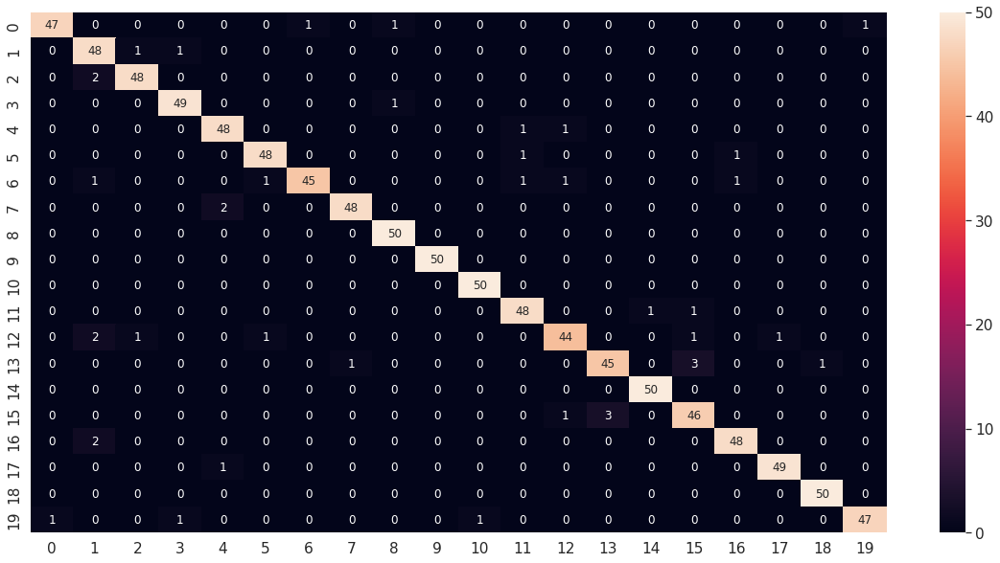

In [ ]:
# Visualizamos la matriz de confusión
facenet_model_vgg4_15_df_CM = pd.DataFrame(facenet_model_vgg4_15_CM, range(20), range(20))  
plt.figure(figsize = (20,10))  
seaborn.set(font_scale=1.4) #for label size  
seaborn.heatmap(facenet_model_vgg4_15_df_CM, annot=True, annot_kws={"size": 12}) # font size  
plt.show()  

In [ ]:
# Resumen de clasificación
facenet_model_vgg4_15_report = classification_report(np.argmax(testY, axis=1), predictedY)  
print(facenet_model_vgg4_15_report)

              precision    recall  f1-score   support

           1       0.98      0.94      0.96        50
           2       0.87      0.96      0.91        50
           3       0.96      0.96      0.96        50
           4       0.96      0.98      0.97        50
           5       0.94      0.96      0.95        50
           6       0.96      0.96      0.96        50
           7       0.98      0.90      0.94        50
           8       0.98      0.96      0.97        50
           9       0.96      1.00      0.98        50
          10       1.00      1.00      1.00        50
          11       0.98      1.00      0.99        50
          12       0.94      0.96      0.95        50
          13       0.94      0.88      0.91        50
          14       0.94      0.90      0.92        50
          15       0.98      1.00      0.99        50
          16       0.90      0.92      0.91        50
          17       0.96      0.96      0.96        50
          18       0.98    